# CODEX analyses

In this notebook we demonstrate how mosna can be used to analyze spatiallly resolved omics data.  
The data used is from the publication by [Phillips et al., Nature Comm., 2023](https://doi.org/10.1038/s41467-021-26974-6) "Immune cell topography predicts response to PD-1 blockade in cutaneous T cell lymphoma".  
Here 70 Tumor MicroArray spots from 14 advanced Cutaneous T cell lymphomas (CTCL) patients enrolled in a pembrolizumab clinical trial were processed with the [CODEX](https://doi.org/10.1016/j.cell.2020.07.005) method to produce maps of numerous proteins and study the relationship between cell types in tumors with respect to immunotherapy.  

## Imports and data loading

In [5]:
# ! pip install composition_stats lifelines xgboost hdbscan
! pip install pycave

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for pycave from https://files.pythonhosted.org/packages/e2/33/bef35acf9ac9bc02271518efec5c5dc51b01045e739c910997e377ef5cb2/pycave-3.0.1-py3-none-any.whl.metadata
  Obtaining dependency information for pytorch-lightning<1.5.0,>=1.4.9 from https://files.pythonhosted.org/packages/84/d3/5a82fe0267d33a12cc4ed07b1b1398f139d78fa20ed4e1cd61fc1f920176/pytorch_lightning-1.4.9-py3-none-any.whl.metadata
INFO: pip is looking at multiple versions of pycave to determine which version is compatible with other requirements. This could take a while.
  Obtaining dependency information for pycave from https://files.pythonhosted.org/packages/ea/dd/befd53a7670122ca585f7c601b66ac27aff5bb025364ecb2d1a2e4dc5f90/pycave-3.0.0-py3-none-any.whl.metadata
  Obtaining dependency information for pycave from https://files.pythonhosted.org/packages/2a/3b/6e5607431e031b102bf4ca782ed03c9dcf5ab16fa884e65e1abbff6

ERROR: Cannot install pycave==1.0.5, pycave==1.0.6, pycave==1.1.2, pycave==1.2.0, pycave==2.0.0, pycave==2.0.1, pycave==2.0.2, pycave==2.0.3, pycave==2.0.4, pycave==2.0.5, pycave==3.0.0 and pycave==3.0.1 because these package versions have conflicting dependencies.
ERROR: ResolutionImpossible: for help visit https://pip.pypa.io/en/latest/topics/dependency-resolution/#dealing-with-dependency-conflicts


In [29]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer
import sys
from tysserand import tysserand as ty


mosna_path =  '../../mosna/'
sys.path.append(mosna_path)
import mosna # scanorama disabled

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

In [30]:
# If need to reload modules after their modification
from importlib import reload
ty = reload(ty)
mosna = reload(mosna)

In [31]:
RUN_LONG = False

### Objects data

Load files that contains all the detected objects (the cells) across all samples and clinical data.  
Data is available from the editor, for convenience it is avaible here too:  
https://drive.google.com/drive/folders/1At8G89p4xFDm5OkLB-CRqsbWUoeLEjWZ?usp=sharing

In [25]:
"../../data/raw/CODEX_CTCL/"
objects_path

WindowsPath('../../data/raw/CODEX_CTCL/41467_2021_26974_MOESM3_ESM_-_Objects.xlsx')

In [53]:
data_dir = Path("../../data/raw/CODEX_CTCL/")

# objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.xlsx"
# obj = pd.read_excel(objects_path, skiprows=2)
objects_path =  "C:/Project/mosna_benchmark/data/raw/CODEX_CTCL/41467_2021_26974_MOESM3_ESM_-_Objects.csv"
obj = pd.read_csv(objects_path, sep=';')
# for latter use
obj.to_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")

obj

,Count,EventCount,Index in File,ClusterID,FileName,ClusterName,Spots,Patients,Groups,FOXP3,...,PD-1+CD8+,CD4+Tcells,PD-1+tumor,CD8+Tcells,Ki67+CD4+,Ki-67+Tregs,ICOS+Tregs,IDO+Tregs,Ki67+tumor,original_index
0,0,1,60,33987,reg001,B cells,1,1,1,"0,69240272",...,0,0,0,0,0,0,0,0,0,0
1,1,1,94,33987,reg001,B cells,1,1,1,"8,09474659",...,0,0,0,0,0,0,0,0,0,1
2,2,1,198,33987,reg001,B cells,1,1,1,"4,110388756",...,0,0,0,0,0,0,0,0,0,2
3,3,1,284,33987,reg001,B cells,1,1,1,0,...,0,0,0,0,0,0,0,0,0,3
4,4,1,298,33987,reg001,B cells,1,1,1,"2,937673092",...,0,0,0,0,0,0,0,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117165,116917,1,633,33981,reg066,vasculature,66,14,4,"84,26971436",...,0,0,0,0,0,0,0,0,0,116917
117166,116918,1,677,33981,reg066,vasculature,66,14,4,"56,42594528",...,0,0,0,0,0,0,0,0,0,116918
117167,116919,1,681,33981,reg066,vasculature,66,14,4,"63,15209198",...,0,0,0,0,0,0,0,0,0,116919
117168,116920,1,705,33981,reg066,vasculature,66,14,4,"66,87330627",...,0,0,0,0,0,0,0,0,0,116920


In [55]:
# sample_cols = obj.columns[:10]
obj.rename(columns={'X': 'x', 'Y': 'y', 'Z':'z', 'ClusterName': 'cell type'}, inplace=True)
patient_col = 'Patients'
sample_col = 'FileName'
group_col = 'Groups'
pos_cols = ['x', 'y']
pheno_col = 'cell type'  # unique columns with all cell types
sample_cols = [sample_col, pheno_col, patient_col, 'Spots' ,group_col]
marker_cols = obj.columns[9:67]
marker_cols = [x for x in marker_cols if x != 'HOECHST1:Cyc_1_ch_1']
# pos_cols = obj.columns[69:76]
# slices are 5µm thick, so data is pseudo-2D, including z leads to spatial networks reconstruction artifacts
cell_type_cols = list(obj.columns[75:96]) # one-hot encoded cell types
marker_posit_cols = list(obj.columns[100:-1])
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + marker_posit_cols
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols
nb_clusters = obj[pheno_col].unique().size
nb_clusters

21

In [56]:
with pd.option_context('display.max_rows', 40):
    print(obj[pheno_col].value_counts())

cell type
tumor cells                     38499
epithelium                      18182
macrophages (M1>M2)             13800
stroma                          11210
Tregs                            7733
vasculature                      5404
CD8+ T cells                     5350
macrophages (M1=M2)              4426
B cells                          2205
macrophages (M2>M1)              1859
Langerhans cells                 1744
CD4+ T cells                     1647
tumor cells, intraepithelial     1316
lymphatics                        783
plasma cells                      725
mast cells                        619
nerves                            572
neutrophils                       430
IDO+ stromal cells                237
CLA+ leukocytes                   218
DCs, CD11c+                       211
Name: count, dtype: int64


In [57]:
obj.shape

(117170, 121)

In [58]:
# Select only pre-treatment samples
obj = obj.loc[obj[group_col] < 3, :]
obj.index = np.arange(len(obj))
obj[group_col].unique()

array([1, 2], dtype=int64)

In [59]:
# Show number of cells per sample
pd.set_option('display.max_rows', 500)
obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count()

Count
Patients Groups Spots FileName       
1        1      1     reg001     1301
                2     reg002     2324
2        1      5     reg005      112
                6     reg006      603
3        2      9     reg009     2334
                10    reg010     1970
4        2      13    reg013     1765
                14    reg014     1270
5        1      17    reg017      558
                18    reg018      458
6        2      21    reg021     2483
                22    reg022     2325
7        2      25    reg025      144
                26    reg026      257
8        2      29    reg029     1916
                30    reg030     1909
                31    reg031     1102
9        1      35    reg035     2053
                36    reg036      618
10       1      39    reg039     1225
                40    reg040     1317
11       1      41    reg041     1105
                42    reg042      385
12       2      45    reg045     1914
                46    reg046      808
13       1      51    reg051     1082
                52    reg052     1707
14       2      57    reg057     1166
                58    reg058     1854

In [60]:
pd.set_option('display.max_rows', 10)

### Response status pre/post treatment

In [61]:
code_groups = {
  1: 'Responder, pre-treatment',
  2: 'Non-responder, pre-treatment',
  3: 'Responder, post-treatment',
  4: 'Non-responder, post-treatment',
} 

In [66]:
status_path = data_dir / "41467_2021_26974_MOESM5_ESM - Patients_spots_conditons.xlsx"
status_path =  "C:/Project/mosna_benchmark/data/raw/CODEX_CTCL/41467_2021_26974_MOESM5_ESM - Patients_spots_conditons.csv"
# status = pd.read_excel(status_path, skiprows=2, usecols=[patient_col, group_col, 'Spots'])
status = pd.read_csv(status_path, sep =';', usecols=[patient_col, group_col, 'Spots'])
# samples 5, 25, 36, 37, 40, 44 are missing
# now inferred from updated data at https://static-content.springer.com/esm/art%3A10.1038%2Fs41467-021-26974-6/MediaObjects/41467_2021_26974_MOESM1_ESM.pdf
updated_data = [
    [2, 1, 5],
    [7, 2, 25],
    [9, 1, 36],
    [9, 3, 37],
    [10, 1, 40],
    [11, 3, 44],
    ]
status = pd.concat([status, pd.DataFrame(updated_data, columns=status.columns)], axis=0)

status[sample_col] = status['Spots'].apply(lambda x: f'reg{x:03}')
# pd.set_option('display.max_rows', 100)

if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'
status.sort_values('Spots')

,Patients,Groups,Spots
id,,,
reg001,1,1,1
reg002,1,1,2
reg003,1,3,3
reg004,1,3,4
reg005,2,1,5
...,...,...,...
reg066,14,4,66
reg067,9,3,67
reg068,9,3,68


In [67]:
# Status has too many missing values
# we make a status dataframe from the objects dataframe
status = obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count().reset_index()
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'

# Drop sample with too few cells
net_size_threshold = 300
net_size_threshold = 0    # no filtering
status = status.loc[status['Count'] >= net_size_threshold, :]
# status.drop(columns=['Count'], inplace=True)

# update the `object` dataframe
uniq_filenames = set(status.index)
obj = obj.query("FileName in @uniq_filenames")

pd.set_option('display.max_rows', 100)
status

,Patients,Groups,Spots,Count
id,,,,
reg001,1,1,1,1301
reg002,1,1,2,2324
reg005,2,1,5,112
reg006,2,1,6,603
reg009,3,2,9,2334
reg010,3,2,10,1970
reg013,4,2,13,1765
reg014,4,2,14,1270
reg017,5,1,17,558


### Survival data

In [73]:
data_dir = Path('C:/Project/mosna_benchmark/data/raw/CODEX_CTCL/')

In [77]:
survival_path = data_dir / "cohort_response.ods"
surv = pd.read_excel(survival_path)
surv.index = surv['Patient ID']
surv.drop(columns=['Patient ID'], inplace=True)
surv.index.name = patient_col
surv

,Age at screening (years),Gender,Diagnosis,Disease Stage,Prior therapies,Response status,Biopsy timepoints,CO2 (weeks),Response / progression time (weeks),EOT time (weeks),Death time (weeks),Follow-up time (weeks)
Patients,,,,,,,,,,,,
1,76.14,Male,MF,IIIA,3,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,142
2,60.59,Male,MF,IIIB,4,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,151
3,52.01,Male,SS,IVA,3,Non-responder,"Pre, EOT",NaN,NaN,98.0,98.0,98
4,85.14,Female,SS,IVA,4,Non-responder,"Pre, EOT",NaN,NaN,104.0,142.0,142
5,75.24,Male,MF,IIB,6,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,103
6,46.74,Male,MF,IVA,9,Non-responder,"Pre, CO2, EOT",3.0,NaN,25.0,NaN,25
7,46.71,Female,MF,IIIB,3,Non-responder,"Pre, EOT",NaN,NaN,9.0,NaN,9
8,67.44,Male,SS,IIIB,1,Non-responder,"Pre, EOT",NaN,NaN,104.0,121.0,121
9,77.65,Female,SS,IVA,6,Responder,"Pre, CO2, EOT",3.0,NaN,71.0,NaN,71


## Spatial networks reconstruction

### Load samples of one patient

We will have a look at the spatial networks of the 2 samples pre-treatment of the first patient to check they seem "correct", i.e. not over nor under connected.

In [83]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import anndata as ad
import os
import joblib
import itertools
from scipy.spatial import Voronoi
from sklearn.neighbors import BallTree
import pynndescent
from skimage import morphology, feature, measure, segmentation, filters, color
from scipy import ndimage as ndi
from scipy.sparse import csr_matrix
import cv2 as cv
import napari
import dask
from dask.distributed import Client, LocalCluster

def make_simple_coords():
    """
    Makes really simple coordinates to illustrate network construction methods.

    Returns
    -------
    coords : ndarray
        Array with 1st and 2nd column corresponding to x and y coordinates.
    """
    
    x = np.array([144, 124, 97, 165, 114, 60, 165, 0, 76, 50, 147])
    y = np.array([ 0, 3, 21, 28, 34, 38, 51, 54, 58, 56, 61])
    coords = np.vstack((x,y)).T
    return coords

def make_random_nodes(size=100, ndim=2, expand=True):
    """
    Make a random set of nodes

    Parameters
    ----------
    size : int, optional
        Number of nodes. The default is 100.
    ndim : int, optional
        Number of dimensions. The default is 2.
    expand : bool, optional
        If True, positions are multiplied by size**(1/ndim) in order to have a 
        consistent spacing across various `size` and `ndim` values. 
        The default is True.

    Returns
    -------
    coords : ndarray
        Coordinates of the set of nodes.
    """
    
    coords = np.random.random(size=size*ndim).reshape((-1,ndim))
    if expand:
        coords = coords * size**(1/ndim)
    return coords

def make_random_tiles(sx=500, sy=500, sz=0, nb=50, noise_sigma=None,
                      regular=True, double_pattern_y=False, double_pattern_z=False, 
                      assym_y=True, assym_z=True, return_image=False):
    """
    Build contacting areas similar to cell segmentation in tissues.

    Parameters
    ----------
    sx : int, optional
        Size of the image on the x axis. The default is 500.
    sy : int, optional
        Size of the image on the y axis. The default is 500.
    sz : int, optional
        Size of the image on the z axis. The default is 0, which
        implies generating a 2D image.
    nb : int, optional
        Related to the number of points, but not equal. The default is 50.
    noise_sigma : None or float, optional
        If float, a gaussian noise is added to seeds positions.
    regular : bool, optional
        If True points are on a regular lattice, else they are randomly located. 
        The default is True.
    double_pattern : bool, optional
        If True the regular lattice has more points. The default is False.
    assym_y : bool, optional
        If True the frenquency of seeds is twice higher on the y-axis. The default is True.
    return_image : bool, optional
        If True the image of seed points is also returned. The default is False.

    Returns
    -------
    coords : ndarray
        Coordinates of the set of nodes.
    masks : ndarray
        Detected areas coded by a unique integer.
        
    Examples
    --------
    >>> coords, masks, image = make_random_tiles(double_pattern=True, return_image=True)
    >>> showim(image)
    >>> label_cmap = mpl.colormaps.get_cmap('Set2')(range(8))
    >>> showim(color.label2rgb(masks, bg_label=0, colors=label_cmap), origin='lower')

    """
    
    if sz == 0:
        image = np.zeros((sy, sx))
        # to overcome an issue with odd nb:
        nb = int(np.ceil(nb / 2) * 2)
        
        if regular:
            x = np.linspace(start=0, stop=sx-1, num=nb, dtype=int)
            x = np.hstack((x[::2], x[1::2]))
            if assym_y:
                nb = nb*2
            y = np.linspace(start=0, stop=sy-1, num=nb, dtype=int)
            if double_pattern_y:
                y = np.hstack((y[::2], y[1::2]))
            x_id = np.tile(x, y.size//2)
            y_id = np.repeat(y, x.size//2)
        else:
            x_id = np.random.randint(sx, size=nb)
            y_id = np.random.randint(sy, size=nb)
            
        if noise_sigma is not None:
            x_id = x_id + np.random.normal(loc=0.0, scale=noise_sigma, size=x_id.size)
            x_id[x_id<0] = 0
            x_id[x_id>sx-1] = sx-1
            x_id = np.round(x_id).astype(int)
            y_id = y_id + np.random.normal(loc=0.0, scale=noise_sigma, size=y_id.size)
            y_id[y_id<0] = 0
            y_id[y_id>sy-1] = sy-1
            y_id = np.round(y_id).astype(int)
            
        coords = np.vstack((x_id, y_id)).T
        image[y_id, x_id] = 1
        masks = segmentation.watershed(-image)
    else:
        # make 3D simulation
        image = np.zeros((sz, sy, sx))
        # to overcome an issue with odd nb:
        nb = int(np.ceil(nb / 2) * 2)
        
        if regular:
            x = np.linspace(start=0, stop=sx-1, num=nb, dtype=int)
            x = np.hstack((x[::2], x[1::2]))
            if assym_y:
                nb_y = nb*2
            y = np.linspace(start=0, stop=sy-1, num=nb_y, dtype=int)
            if assym_z:
                nb_z = nb*2
            z = np.linspace(start=0, stop=sz-1, num=nb_z, dtype=int)
            if double_pattern_y:
                y = np.hstack((y[::2], y[1::2]))
            if double_pattern_z:
                z = np.hstack((z[::2], z[1::2]))
            x_id = np.tile(x, y.size//2)
            y_id = np.repeat(y, x.size//2)
            z_id = np.repeat(z, x.size//2)
        else:
            x_id = np.random.randint(sx, size=nb)
            y_id = np.random.randint(sy, size=nb)
            z_id = np.random.randint(sz, size=nb)
            
        if noise_sigma is None:
            print("For 3D simulations noise_sigma needs to be > 0")
            print("Setting noise_sigma to 1")
            noise_sigma = 1
        # x
        x_id = x_id + np.random.normal(loc=0.0, scale=noise_sigma, size=x_id.size)
        x_id[x_id<0] = 0
        x_id[x_id>sx-1] = sx-1
        x_id = np.round(x_id).astype(int)
        # y
        y_id = y_id + np.random.normal(loc=0.0, scale=noise_sigma, size=y_id.size)
        y_id[y_id<0] = 0
        y_id[y_id>sy-1] = sy-1
        y_id = np.round(y_id).astype(int)
        # z
        z_id = z_id + np.random.normal(loc=0.0, scale=noise_sigma, size=z_id.size)
        z_id[z_id<0] = 0
        z_id[z_id>sz-1] = sz-1
        z_id = np.round(z_id).astype(int)
            
        coords = np.vstack((x_id, y_id, z_id)).T
        image[z_id, y_id, x_id] = 1
        masks = segmentation.watershed(-image)

    if return_image:
        return coords, masks, image
    else:
        return coords, masks

def remove_duplicate_pairs(pairs):
    """
    Remove redundant rows in a 2D array.
    
    Parameters
    ----------
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.

    Returns
    -------
    uniq_pairs : ndarray
        Array of unique pairs, the content of each row is sorted.
    
    Example
    -------
    >>> pairs = [[4, 3],
                 [1, 2],
                 [3, 4],
                 [2, 1]]
    >>> remove_duplicate_pairs(pairs)
    array([[1, 2],
           [3, 4]])
    """
    
    uniq_pairs = np.unique(np.sort(pairs, axis=1), axis=0)
    return uniq_pairs

def distance_neighbors(coords, pairs):
    """
    Compute all distances between neighbors in a network.
    
    Parameters
    ----------
    coords : dataframe
        Coordinates of points where columns are 'x', 'y', ...
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.

    Returns
    -------
    distances : array
        Distances between each pair of neighbors.
    """
    
    # source nodes coordinates
    c0 = coords[pairs[:,0]]
    # target nodes coordinates
    c1 = coords[pairs[:,1]]
    distances = (c0 - c1)**2
    distances = np.sqrt(distances.sum(axis=1))
    return distances

def find_trim_dist(dist, method='percentile_size', nb_nodes=None, perc=99):
    """
    Find the distance threshold to eliminate reconstructed edges in a network.

    Parameters
    ----------
    dist : array
        Distances between pairs of nodes.
    method : str, optional
        Method used to compute the threshold. The default is 'percentile_size'.
        This methods defines an optimal percentile value of distances above which
        edges are discarded.
    nb_nodes : int , optional
        The number of nodes in the network used by the 'percentile_size' method.
    perc : int or float, optional
        The percentile of distances used as the threshold. The default is 99.

    Returns
    -------
    dist_thresh : float
        Threshold distance.
    """
    if method == 'percentile_size':
        prop_edges = 4 / nb_nodes**(0.5)
        perc = 100 * (1 - prop_edges * 0.5)
        dist_thresh = np.percentile(dist, perc)
            
    elif method == 'percentile':
        dist_thresh = np.percentile(dist, perc)
        
    return dist_thresh

def build_delaunay(
    coords, 
    node_adaptive_trimming=True, 
    n_edges=3, 
    trim_dist_ratio=2,
    min_dist=0, 
    trim_dist=False, 
    perc=99, 
    return_dist=False):
    """
    Reconstruct edges between nodes by Delaunay triangulation.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    node_adaptive_trimming : bool
        Method to trim edges with a distance threshold adapted for each node.
        For each node, the distance threshold is defined as the Nth smallest
        edge length x `trim_dist_ratio`. Edges with length above this threshold
        and a minimum distance `min_dist` are discarded.
    n_edges : int
        The Nth smallest edge used to compute the trimming distance.
    trim_dist_ratio : float
        Ratio between the distance threshold and the Nth smallest distance.
    min_dist : float
        Minimum distance threshold used witht the node adaptive trimming method.
    trim_dist : str or float, optional
        Method or distance used to delete reconstructed edges. 
        Use 'percentile_size' to adapt this distance to the number of nodes.
    perc : int or float, optional
        The percentile of distances used as the threshold. The default is 99.
    return_dist : bool, optional
        Whether distances are returned, usefull to try sevral trimming methods and parameters. 
        The default is False.
    
    Examples
    --------
    >>> coords = make_simple_coords()
    >>> pairs = build_delaunay(coords, trim_dist=False)

    Returns
    -------
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.
    """

    # pairs of indices of neighbors
    pairs = Voronoi(coords).ridge_points

    if node_adaptive_trimming:
        dist = distance_neighbors(coords, pairs)
        for node_id in range(len(coords)):
            select_src = np.where(pairs[:, 0] == node_id)[0]
            select_trg = np.where(pairs[:, 1] == node_id)[0]
            pairs_ids = np.hstack([select_src, select_trg]) # array of indices, not a boolean vector
            node_distances = dist[pairs_ids]
            if len(node_distances) > n_edges:
                # use the Nth smallest edge to compute the distance threshold
                thresh_dist = np.sort(node_distances)[n_edges-1] * trim_dist_ratio
                # filter distances above threshold and above minimum edge length
                discard = np.logical_and(node_distances > thresh_dist, node_distances > min_dist)
                discard_ids = pairs_ids[discard]
                pairs = np.delete(pairs, discard_ids, axis=0)
                dist = np.delete(dist, discard_ids)

    if trim_dist is not False:  # can be str or float
        # remove edges with length above threshold distance
        dist = distance_neighbors(coords, pairs)
        if not isinstance(trim_dist, (int, float)):
            trim_dist = find_trim_dist(dist=dist, method=trim_dist, nb_nodes=coords.shape[0], perc=perc)
        pairs = pairs[dist < trim_dist, :]
    return pairs

def pairs_from_knn(ind):
    """
    Convert a matrix of Neirest Neighbors indices into 
    a matrix of unique pairs of neighbors

    Parameters
    ----------
    ind : ndarray
        The (n_objects x n_neighbors) matrix of neighbors indices.

    Returns
    -------
    pairs : ndarray
        The (n_pairs x 2) matrix of neighbors indices.
    """
    
    NN = ind.shape[1]
    source_nodes = np.repeat(ind[:,0], NN-1).reshape(-1,1)
    target_nodes = ind[:,1:].reshape(-1,1)
    pairs = np.hstack((source_nodes, target_nodes))
    pairs = remove_duplicate_pairs(pairs)
    return pairs

def build_knn(coords, k=6, approximate=True, metric='euclidean', n_jobs=-1, **kwargs):
    """
    Reconstruct edges between nodes by k-nearest neighbors (knn) method.
    An edge is drawn between each node and its k nearest neighbors.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    k : int, optional
        Number of nearest neighbors. The default is 6.
    approximate : bool, True
        Whether fast appriximation is authorized for networks >= 3000 nodes.
    metric: string or callable (optional, default='euclidean')
        The metric to use for computing nearest neighbors.
        See pynndescent documentation.
    n_jobs: int or None, optional (default=-1)
        The number of parallel jobs to run for neighbors index construction.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors.
    
    Examples
    --------
    >>> coords = make_simple_coords()
    >>> pairs = build_knn(coords)

    Returns
    -------
    pairs : ndarray
        The (n_pairs x 2) matrix of neighbors indices.
    """
    
    if len(coords) < 3000 or not approximate:
        tree = BallTree(coords, **kwargs)
        _, neighbors = tree.query(coords, k=k+1) # the first k is "oneself"
    else:
        n_index = min(k, len(coords))
        # JIT warmup with small fake network
        warmup_coords = np.random.random(size=(n_index+2, coords.shape[1]))
        warmup_index = pynndescent.NNDescent(
            coords, 
            metric=metric, 
            n_neighbors=n_index+1, 
            n_jobs=n_jobs,
            )
        # actual knn network building
        index = pynndescent.NNDescent(
            coords, 
            metric=metric, 
            n_neighbors=n_index+1, 
            n_jobs=n_jobs,
            )
        neighbors = index.neighbor_graph[0]
    pairs = pairs_from_knn(neighbors)
    return pairs

def build_rdn(coords, r, coords_ref=None, **kwargs):
    """
    Reconstruct edges between nodes by radial distance neighbors (rdn) method.
    An edge is drawn between each node and the nodes closer 
    than a threshold distance (within a radius).

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    r : float, optional
        Radius in which nodes are connected.
    coords_ref : ndarray, optional
        Source points in the network, `pairs` will indicate edges from `coords_ref`
        to `coords`, if None, `coords` is used, the network is undirected.
    
    Examples
    --------
    >>> coords = make_simple_coords()
    >>> pairs = build_rdn(coords, r=60)

    Returns
    -------
    pairs : ndarray
        The (n_pairs x 2) matrix of neighbors indices.
    """
    
    tree = BallTree(coords, **kwargs)
    if coords_ref is None:
        ind = tree.query_radius(coords, r=r)
    else:
        ind = tree.query_radius(coords_ref, r=r)
    # clean arrays of neighbors from self referencing neighbors
    # and aggregate at the same time
    source_nodes = []
    target_nodes = []
    for i, arr in enumerate(ind):
        neigh = arr[arr != i]
        source_nodes.append([i]*(neigh.size))
        target_nodes.append(neigh)
    # flatten arrays of arrays
    source_nodes = np.fromiter(itertools.chain.from_iterable(source_nodes), int).reshape(-1,1)
    target_nodes = np.fromiter(itertools.chain.from_iterable(target_nodes), int).reshape(-1,1)
    # remove duplicate pairs
    pairs = np.hstack((source_nodes, target_nodes))
    if coords_ref is None:
        pairs = remove_duplicate_pairs(pairs)
    return pairs

def build_lattice(coords, r=None, coords_ref=None, lattice='hexagonal', r_factor=None, **kwargs):
    """
    Reconstruct edges between nodes organized on a lattice.
    The lattice can be a hexagonal, square, or cubic (3D).
    An edge is drawn between each node and the nodes closer 
    than a threshold distance (within a radius).

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    r : float, optional
        Radius in which nodes are connected. If not provided, it is guessed from data.
    coords_ref : ndarray, optional
        Source points in the network, `pairs` will indicate edges from `coords_ref`
        to `coords`, if None, `coords` is used, the network is undirected.
    r_factor : float
        Factor to include nodes in 'diagonals' if `r` is not provided.
    lattice : str
        Type of spatial organization of nodes. It can be 'hexagonal', 'square' or 'cubic'.
        Used to set `r_factor` if not provided.
    """
    
    tree = BallTree(coords, **kwargs)
    if r is None:
        # guess minimum distance between nodes
        _, ind = tree.query(coords, k=2) # the first k is "oneself"
        pairs = pairs_from_knn(ind)
        min_dist = np.min(distance_neighbors(coords, pairs))
        if r_factor is None:
            if lattice == 'hexagonal':
                r_factor = 1.5
            elif lattice == 'square':
                r_factor = np.sqrt(2) * 1.01
            elif lattice == 'cube':
                r_factor = np.sqrt(3) * 1.01
        r = min_dist * r_factor
    
    if coords_ref is None:
        ind = tree.query_radius(coords, r=r)
    else:
        ind = tree.query_radius(coords_ref, r=r)
    # clean arrays of neighbors from self referencing neighbors
    # and aggregate at the same time
    source_nodes = []
    target_nodes = []
    for i, arr in enumerate(ind):
        neigh = arr[arr != i]
        source_nodes.append([i]*(neigh.size))
        target_nodes.append(neigh)
    # flatten arrays of arrays
    source_nodes = np.fromiter(itertools.chain.from_iterable(source_nodes), int).reshape(-1,1)
    target_nodes = np.fromiter(itertools.chain.from_iterable(target_nodes), int).reshape(-1,1)
    # remove duplicate pairs
    pairs = np.hstack((source_nodes, target_nodes))
    if coords_ref is None:
        pairs = remove_duplicate_pairs(pairs)
    return pairs

def hyperdiagonal(coords):
    """
    Compute the maximum possible distance from a set of coordinates as the
    diagonal of the (multidimensional) cube they occupy.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)

    Returns
    -------
    dist : float
        Maximum possible distance.
    """
    
    mini = coords.min(axis=0)
    maxi = coords.max(axis=0)
    dist = (maxi - mini)**2
    dist = np.sqrt(dist.sum())
    return dist

def find_neighbors(masks, i, r=1):
    """
    Find the neighbors of a given mask.
    
    Parameters
    ----------
    masks : array_like
        2D array of integers defining the identity of masks
        0 is background (no object detected)
    i : int
        The mask for which we look for the neighbors.
    r : int
        Radius of search.
        
    Returns
    -------
    neighbors : array
        Neighbors in the vicinity of mask `i` in masks.
    """
    
    mask = np.uint8(masks == i)
    # create the border in which we'll look at other masks
    kernel = morphology.disk(r)
    dilated = cv.dilate(mask, kernel, iterations=1)
    dilated = dilated.astype(bool)
    # detect potential touching masks
    neighbors = np.unique(masks[dilated])
    # discard the initial cell id of interest
    neighbors = neighbors[neighbors != i]
    # discard the background value
    return neighbors[neighbors != 0]

def build_contacting(masks, r=1):
    """
    Build a network from segmented regions that contact each other or are 
    within a given distance from each other.

    Parameters
    ----------
    masks : array_like
        2D array of integers defining the identity of masks
        0 is background (no object detected)
    r : int
        Radius of search.

    Returns
    -------
    pairs : ndarray
        Pairs of neighbors given by the first and second element of each row, 
        values correspond to values in masks, which are different from index
        values of nodes

    """
    source_nodes = []
    target_nodes = []
    for i in range(1, masks.max()+1):
        neigh = find_neighbors(masks, i, r=r)
        source_nodes.append([i]*(neigh.size))
        target_nodes.append(neigh)
    # flatten arrays of arrays
    source_nodes = np.fromiter(itertools.chain.from_iterable(source_nodes), int).reshape(-1,1)
    target_nodes = np.fromiter(itertools.chain.from_iterable(target_nodes), int).reshape(-1,1)
    # remove duplicate pairs
    pairs = np.hstack((source_nodes, target_nodes))
    pairs = remove_duplicate_pairs(pairs)
    return pairs

def mask_val_coord(masks):
    """
    Compute the mapping between mask regions and their centroid coordinates.

    Parameters
    ----------
    masks : array_like
        2D array of integers defining the identity of masks
        0 is background (no object detected)

    Returns
    -------
    coords : dataframe
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    """
    
    coords = measure.regionprops_table(masks, properties=('label', 'centroid'))
    coords = pd.DataFrame.from_dict(coords)
    if coords.shape[1] == 3:
        coords.rename(columns={'centroid-1':'x',  'centroid-0':'y'}, inplace=True)
    elif coords.shape[1] == 4:
        coords.rename(columns={'centroid-2':'x', 'centroid-1':'y', 'centroid-0':'z'}, 
                      inplace=True)
    else:
        print('More than 3 detected spatial dimensions, check output column names.')
    coords.index = coords['label']
    coords.drop(columns='label', inplace=True)
    return coords

def refactor_coords_pairs(coords, pairs):
    """
    Transforms coordinates and pairs of nodes data from segmented areas into
    the formats used by the other functions for network analysis and visualization.

    Parameters
    ----------
    coords : dataframe
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    pairs : ndarray
        Pairs of neighbors given by the first and second element of each row, 
        values correspond to values in masks, which are different from index
        values of nodes

    Returns
    -------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    pairs : ndarray
        Pairs of neighbors given by the first and second element of each row.
    """
    
    mapper = dict(zip(coords.index, np.arange(coords.shape[0])))
    pairs = pd.DataFrame({'source': pairs[:,0], 'target': pairs[:,1]})
    pairs['source'] = pairs['source'].map(mapper)
    pairs['target'] = pairs['target'].map(mapper)
    coords = coords.loc[:, ['x', 'y']].values
    pairs = pairs.loc[:, ['source', 'target']].values
    return coords, pairs

def link_solitaries(
    coords, 
    pairs, 
    method='delaunay', 
    min_neighbors=3, 
    all_pairs=None,
    all_dist=None,
    verbose=1):
    """
    Detect nodes that are not connected and link them to other nodes.
    
    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    pairs : ndarray
        The (n_pairs x 2) matrix of neighbors indices.
    method : string, optional
        Method used to connect solitary nodes to their neighbors. Default is 'delaunay'.
        With 'knn', solitary nodes will be connected to their 'k' nearest neighbors.
    min_neighbors : int
        Minimum number of neighbors before linking nodes to additional nodes.
    all_pairs : ndarray
        Pre-computed matrix of potential edges to re-link nodes.
    all_dist : array
        Pre-computed distances between all potential pairs of nodes.
    verbose : int, optional
        Verbosity, if different from 0 some messages are displayed.
        Default is 1.

    Returns
    -------
    pairs : ndarray
        The (n_pairs x 2) matrix of neighbors indices, with additional edges (rows in array).
    
    Example
    -------
    >>> coords = np.array([[0, 0],
                           [1, 0],
                           [2, 0],
                           [3.1, 0],
                           [4, 0]])
    >>> pairs = np.array([[0, 1],
                          [1, 2]])
    >>> link_solitaries(coords, pairs, method='knn', k=1)
    array([[0, 1],
           [1, 2],
           [3, 4]])
    >>> link_solitaries(coords, pairs, method='knn', k=2)
    array([[0, 1],
           [1, 2],
           [2, 3],
           [2, 4],
           [3, 4]])
    """
    
    # detect if some nodes have no edges
    n_nodes = coords.shape[0]
    uniq_nodes = set(range(n_nodes))
    uniq_pairs = set(np.unique(pairs))
    solitaries = uniq_nodes.difference(uniq_pairs)
    if min_neighbors > 1:
        # detect nodes with too few edges
        nodes_ids, nodes_counts = np.unique(pairs, return_counts=True)
        nodes_ids = nodes_ids[nodes_counts < min_neighbors]
        solitaries = solitaries.union(nodes_ids)
    n_solitaries = len(solitaries)
    if min_neighbors == 1 and n_solitaries == 0:
        print("all nodes have at least one edge")
    elif min_neighbors > 1 and n_solitaries == 0:
        print(f"all nodes have at least {min_neighbors} edges")
    else:
        if verbose != 0:
            if min_neighbors == 1:
                print(f"there are {n_solitaries}/{n_nodes} nodes with no edges")
            else:
                print(f"there are {n_solitaries}/{n_nodes} nodes with < {min_neighbors} edges")

        if method == 'delaunay':
            if all_pairs is None:
                all_pairs = build_delaunay(coords, node_adaptive_trimming=False, trim_dist=False)
            if all_dist is None:
                all_dist = distance_neighbors(coords, all_pairs)
            for node_id in solitaries:
                select_src = np.where(all_pairs[:, 0] == node_id)[0]
                select_trg = np.where(all_pairs[:, 1] == node_id)[0]
                pairs_ids = np.hstack([select_src, select_trg]) # array of indices, not a boolean vector
                node_distances = all_dist[pairs_ids]
                if len(node_distances) >= min_neighbors:
                    select_pairs_ids = np.argsort(node_distances)[:min_neighbors]
                    new_pairs_ids = pairs_ids[select_pairs_ids]
                    pairs = np.vstack([pairs, all_pairs[new_pairs_ids, :]])
        elif method == 'knn':
            nn_pairs = build_knn(coords, k=min_neighbors)
            # for each lonely node, add its edges with the knn neighbors
            for i in solitaries:
                select = np.logical_or(nn_pairs[:, 0] == i, nn_pairs[:, 1] == i)
                pairs = np.vstack([pairs, nn_pairs[select, :]])

        pairs = remove_duplicate_pairs(pairs)
       
    return pairs
    
def build_contacting_nn(masks, r=1, k=3):
    """
    Build a network from segmented regions as a mix between
    the contacting areas method, that can output some nodes
    edges, and the nearest neighbors method that will link
    these nodes to their neighbors.

    Parameters
    ----------
    masks : array_like
        2D array of integers defining the identity of masks
        0 is background (no object detected)
    r : int
        Radius of search for the contacting areas method. The default is 1.
    k : int, optional
        Number of nearest neighbors. The default is 3.
   

    Returns
    -------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    pairs : ndarray
        Pairs of neighbors given by the first and second element of each row,
        values correspond to values in masks, which are different from index
        values of nodes
    """
   
    pairs = build_contacting(masks, r=r)
    # reencode the coordinates to match node positions with their respective areas
    coords = mask_val_coord(masks)
    coords, pairs = refactor_coords_pairs(coords, pairs)
   
    pairs = link_solitaries(coords, pairs)
       
    return coords, pairs

# ------ Parallelized version of build_contacting ------

def choose_optimal_image_split(im, method='im_size', min_tile_size=360000):
    """
    Compute the optimal number of splits of an image
    to run in parallel a function of each core.

    Parameters
    ----------
    im : array_like
        2D array of integers defining the identity of segmented objects
        0 is background (no object detected)
    method : str, optional
        The method used to define the optimal number of splits.
        The default is 'im_size'.
    min_tile_size : int
        Minimum number of bytes of tiles.
        The default is 360000.

    Returns
    -------
    n_splits : int
        The optimal number of splits.
    
    Example
    -------
    >>> im = np.zeros((1024, 1024), dtype=np.int32)
    >>> n_splits = choose_optimal_image_split(im)
    
    Notes
    -----
    One would ideally consider the number of cores, the size of the image
    and the number of detected objects.
    The number of splits should be essentially driven by the size of
    the image and the number of cores.
    The number of splits shouldn't be superior to the number of cores,
    otherwise some cores will wait for the last tiles to be processed
    by other cores, while increasing the inter-process communication
    by too many splits. 
    Ideally n_splits should be a power of 2 in order to split easily 
    the image.
    """
    
    n_cores = os.cpu_count()
    # number of segmented objects, drop the background value
    n_obj = np.unique(im).size - 1
    
    if method == 'im_size':
        # avoid too many splits if image is not so big
        im_size = im.nbytes # slightly different from sys.getsizeof(im)
        # max power of 2
        max_i = int(np.log2(n_cores)) + 1
        n_splits = 1
        for i in range(1, max_i):
            new_split = 2**i
            if im_size / new_split >= min_tile_size:
                n_splits = new_split
            else:
                break
    elif method == 'naive':
        n_splits = n_cores
    
    return n_splits

def split_range(r, n):
    """
    Computes the indices of segments after splitting a range of r values
    into n segments.

    Parameters
    ----------
    r : int
        Size of the range vector.
    n : int
        The number of splits.

    Returns
    -------
    segments : list
        The list of lists of first and last indices of segments.
    
    Example
    -------
    >>> split_range(8, 2)
    [[0, 4], [4, 8]]
    """
    
    step = int(r / n)
    segments = []
    for i in range(n):
        new_segment = [step * i, step * (i + 1)]
        segments.append(new_segment)
    # correct the gap in the missing index due to the truncated step
    segments[-1][-1] = r
    return segments

def extend_indices(segments, margin):
    """
    Decrease and increase the values of the first and last elements
    respectively in each list of segments by a given margin.
    The first indice of the first segment and the last indice of the
    last segments are not modified.

    Parameters
    ----------
    segments : list
        The list of lists of first and last indices of segments.
    margin : int
        The extra extend to add on each side of segments.
    
    Example
    -------
    >>> segments = split_range(16, 4)
    >>> extend_indices(segments, margin=1)
    [[0, 5], [3, 9], [7, 13], [11, 16]]
    """
    
    if len(segments) == 1:
        return segments
    else:
        # first process the first and last segments
        segments[0][-1] += margin
        segments[-1][0] -= margin
        # if there are more than 2 segments
        for i in range(len(segments))[1:-1]:
            segments[i][0] -= margin
            segments[i][-1] += margin
    return segments        

def make_tiles_limits(im, n_splits, margin=0):
    """
    Compute the indices in an image to split it into several tiles.

    Parameters
    ----------
    im : array_like
        2D array of integers defining the identity of segmented objects
        0 is background (no object detected)
    n_splits : int
        The number of splits.
    margin : int
        The extra space to include at the border of tiles.
        The default is 0.

    Returns
    -------
    tiles_indices : list
        The list of indices [[xmin, xmax], [ymin, ymax]] for each tile.
        
    Example
    -------
    >>> im = np.arange(16 * 8).reshape(16, 8)
    >>> make_tiles_limits(im, 4, margin=0)
    [[0, 4, 0, 8], [0, 4, 8, 16], [4, 8, 0, 8], [4, 8, 8, 16]]
    >>> make_tiles_limits(im, 4, margin=1)
    [[0, 5, 0, 9], [0, 5, 7, 16], [3, 8, 0, 9], [3, 8, 7, 16]]
    """
    
    if n_splits == 1:
        return [0, im.shape[1], 0, im.shape[0]]
    # number of splits per axis
    ax_splits = int(np.log2(n_splits))
    x_segments = split_range(im.shape[1], ax_splits)
    y_segments = split_range(im.shape[0], ax_splits)
    
    if margin > 0:
        x_segments = extend_indices(x_segments, margin=margin)
        y_segments = extend_indices(y_segments, margin=margin)
    
    # make combinations of [xmin, xmax, ymin, ymax] indices of tiles
    tiles_indices = []
    for xlim in x_segments:
        for ylim in y_segments:
            tiles_indices.append(xlim + ylim)
    return tiles_indices

def extract_tile(im, limits):
    """
    Extract a tile from an image given
    its [xmin, xmax, ymin, ymax] limit indices.

    Parameters
    ----------
    im : array_like
        2D array of integers defining the identity of segmented objects
        0 is background (no object detected)
    limits : list
        The list of limit indices [xmin, xmax, ymin, ymax].

    Returns
    -------
    tile : array_like
        The extracted tile.
        
    Example
    -------
    >>> im = np.arange(8 * 8).reshape(8, 8)
    >>> tiles_indices = make_tiles_limits(im, 4, margin=0)
    >>> extract_tiles(im, tiles_indices[-1])
    array([[36, 37, 38, 39],
           [44, 45, 46, 47],
           [52, 53, 54, 55],
           [60, 61, 62, 63]])
    """
    
    tile = im[limits[0]: limits[1], limits[2]: limits[3]]
    return tile

def merge_pairs(lpairs):
    """
    Merge a list of Nx2 arrays into a single N'x2 array.

    Parameters
    ----------
    lpairs : list
        The list of detected edges as 2D arrays.
    
    Returns
    -------
    pairs : array_like
        The merged detected edges.
    
    
    >>> a = np.arange(4).reshape(-1, 2)
    >>> b = a + 2
    >>> lpairs = [a, b]
    >>> np.unique(np.vstack(lpairs), axis=0)
    array([[0, 1],
           [2, 3],
           [4, 5]])
    """
    
    pairs = np.unique(np.vstack(lpairs), axis=0)
    return pairs

def build_contacting_parallel(im, r=1, split_method='im_size', min_tile_size=360000):
    """
    Build a network from segmented regions that contact each other or are 
    within a given distance from each other.

    Parameters
    ----------
    im : array_like
        2D array of integers defining the identity of masks
        0 is background (no object detected)
    r : int
        Radius of search.
    split_method : str, optional
        The method used to define the optimal number of splits.
        The default is 'im_size'.
    min_tile_size : int
        Minimum number of bytes of tiles.
        The default is 360000.

    Returns
    -------
    pairs : ndarray
        Pairs of neighbors given by the first and second element of each row, 
        values correspond to values in masks, which are different from index
        values of nodes
        
    Example
    -------
    >>> # generate the tissue image
    >>> coords, masks = ty.make_random_tiles(sx=600, sy=600, nb=12, noise_sigma=10.0)
    >>> # erase some segmented objects
    >>> if hole_proba != 0:
    >>>     for i in np.unique(masks):
    >>>         if np.random.rand() > (1 - hole_proba):
    >>>             masks[masks == i] = 0
    >>> 
    >>> # ------ Contacting areas method ------
    >>> pairs = ty.build_contacting(masks)
    >>> coords = ty.mask_val_coord(masks)
    >>> coords, pairs_true = ty.refactor_coords_pairs(coords, pairs)
    >>> 
    >>> # ------ Parallel version ------
    >>> paral_pairs = build_contacting_parallel(im)
    >>> # check that detected edges are identical
    >>> pairs = np.sort(pairs, axis=1)
    >>> paral_pairs = np.sort(paral_pairs, axis=1)
    >>> print(np.all(paral_pairs == pairs))
    """
    
    n_splits = choose_optimal_image_split(im, method=split_method, min_tile_size=min_tile_size)
    segments = make_tiles_limits(im, n_splits, margin=r)
    
    cluster = LocalCluster(
        n_workers=16,
        threads_per_worker=1,
    )
    client = Client(cluster)
    
    # list of pairs computed for each tile
    lpairs = []
    for limits in segments:
        tile = dask.delayed(extract_tile)(im, limits)
        pairs = dask.delayed(build_contacting)(tile, r=r)
        lpairs.append(pairs)
    # merge all pairs
    pairs = dask.delayed(merge_pairs)(lpairs)
    pairs = pairs.compute()
    return pairs

# ------ end of parallel build_contacting ------

def rescale(data, perc_mini=1, perc_maxi=99, 
            out_mini=0, out_maxi=1, 
            cutoff_mini=True, cutoff_maxi=True, 
            return_extrema=False):
    """
    Normalize the intensities of a planar 2D image.

    Parameters
    ----------
    data : numpy array
        the matrix to process
    perc_mini : float
        the low input level to set to the low output level
    perc_maxi : float
        the high input level to set to the high output level
    out_mini : int or float
        the low output level
    out_maxi : int or float
        the high output level
    cutoff_mini : bool
        if True sets final values below the low output level to the low output level
    cutoff_maxi : bool
        if True sets final values above the high output level to the high output level
    return_extrema : bool
        if True minimum and maximum percentiles of original data are also returned

    Returns
    -------
    data_out : numpy array
        the output image
    """
    
    mini = np.percentile(data, perc_mini)
    maxi = np.percentile(data, perc_maxi)
    if out_mini is None:
        out_mini = mini
    if out_maxi is None:
        out_maxi = maxi
    data_out = data - mini
    data_out = data_out * (out_maxi-out_mini) / (maxi-mini)
    data_out = data_out + out_mini
    if cutoff_mini:
        data_out[data_out<out_mini] = out_mini
    if cutoff_maxi:
        data_out[data_out>out_maxi] = out_maxi
    if return_extrema:
        return data_out, mini, maxi
    else:
        return data_out

def plot_network(coords, pairs, disp_id=False, labels=None,
                 color_mapper=None, legend=True, legend_opt=None,
                 col_nodes=None, cmap_nodes=None, marker=None,
                 size_nodes=None, col_edges='k', alpha_edges=0.5, 
                 linewidth=None,
                 ax=None, figsize=(15, 15), aspect='equal', **kwargs):
    """
    Plot a network.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.
    disp_id: bool
        If True nodes' indices are displayed.
    labels: panda series
        The nodes' labels from which they are colored.
    legend_opt : dict or None
        Optional parameters for the legend
        like {'loc': 'upper right', 'bbox_to_anchor': (0.5, 0.5)}
    color_mapper: dict
        Maps each label to its color. Computed if not provided.
    figsize : (float, float), default: :rc:`figure.figsize`
        Width, height in inches. The default is (15, 15).
    col_nodes : str of matplotlib compatible color, optional
        Color of nodes. The default is None.
    cmap_nodes: list
        List of hexadecimal colors for nodes attributes.
    marker : str, optional
        Marker used to display nodes. The default is None.
    size_nodes : int, optional
        Size of nodes. The default is None.
    col_edges : str or matplotlib compatible color, optional
        Color of edges. The default is 'k'.
    alpha_edges : float, optional
        Tansparency of edges. The default is 0.5.
    linewidth : float, optional
        Width of edges. The default is None.
    ax : matplotlib ax object, optional
        If provided, the plot is displayed in ax. The default is None.
    aspect : str, optional
        Control aspect ration of the figure. The default is 'equal'.
    **kwargs : dict
        Optional parameters to display nodes.

    Returns
    -------
    None or (fig, ax) if not provided in parameters.
    """
    
    if ax is None:
        ax_none = True
        fig, ax = plt.subplots(figsize=figsize)
    else:
        ax_none = False
    # plot nodes
    if labels is not None:
        if isinstance(labels, np.ndarray):
            uniq = np.unique(labels)
        elif isinstance(labels, pd.Series):
            uniq = labels.unique()
        else:
            uniq = np.unique(np.array(labels))
        # color nodes with manual colors
        if color_mapper is None:
            if cmap_nodes is None:
                cmap_nodes = sns.color_palette('muted').as_hex() 
            # make a dictionnary attribute:color, with cycling over cmap
            n_colors = len(cmap_nodes)
            color_mapper = {x: cmap_nodes[i % n_colors] for i, x in enumerate(uniq)}
        for label in uniq:
            select = labels == label
            color = color_mapper[label]
            ax.scatter(coords[select,0], coords[select,1], c=color, label=label,
                       marker=marker, s=size_nodes, zorder=10, **kwargs)
        if legend:
            if legend_opt is None:
                ax.legend()
            else:
                ax.legend(**legend_opt)
    else:
        ax.scatter(coords[:,0], coords[:,1], c=col_nodes, cmap=cmap_nodes, 
                   marker=marker, s=size_nodes, zorder=10, **kwargs)
    # plot edges
    for pair in pairs[:,:]:
        [x0, y0], [x1, y1] = coords[pair]
        ax.plot([x0, x1], [y0, y1], c=col_edges, zorder=5, alpha=alpha_edges, linewidth=linewidth)
    if disp_id:
        offset=0.02
        for i, (x,y) in enumerate(coords):
            plt.text(x-offset, y-offset, str(i), zorder=15)
    if aspect is not None:
        ax.set_aspect(aspect)
    if ax_none:
        return fig, ax

def plot_network_distances(coords, pairs, distances, labels=None,
                           color_mapper=None, legend=True, legend_opt=None,
                           col_nodes=None, cmap_nodes=None, marker=None, size_nodes=None, 
                           cmap_edges='viridis', alpha_edges=0.7, linewidth=None,
                           figsize=(15, 15), ax=None, aspect='equal', **kwargs):
    """
    Plot a network with edges colored by their length.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points where each column corresponds to an axis (x, y, ...)
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.
    distances : array
        Distances between each pair of neighbors.
    labels: panda series
        The nodes' labels from which they are colored.
    legend_opt : dict or None
        Optional parameters for the legend
        like {'loc': 'upper right', 'bbox_to_anchor': (0.5, 0.5)}
    color_mapper: dict
        Maps each label to its color. Computed if not provided.
    col_nodes : str of matplotlib compatible color, optional
        Color of nodes. The default is None.
    cmap_nodes: list
        List of hexadecimal colors for nodes attributes.
    marker : str, optional
        Marker used to display nodes. The default is None.
    size_nodes : float, optional
        Size of nodes. The default is None.
    cmap_edges : str of matplotlib.colormap, optional
        Colormap of edges. The default is 'viridis'.
    alpha_edges : float, optional
        Tansparency of edges. The default is 0.7.
    linewidth : float, optional
        Width of edges. The default is None.
    figsize : (float, float), default: :rc:`figure.figsize`
        Width, height in inches. The default is (15, 15).
    ax : matplotlib ax object, optional
        If provided, the plot is displayed in ax. The default is None.
    aspect : str, optional
        Proportions of the figure. The default is None.
    **kwargs : TYPE
        labels of nodes.

    Returns
    -------
    None or (fig, ax) if not provided in parameters.

    """
    
    if ax is None:
        ax_none = True
        fig, ax = plt.subplots(figsize=figsize)
    else:
        ax_none = False
    # plot nodes
    if labels is not None:
        if isinstance(labels, np.ndarray):
            uniq = np.unique(labels)
        elif isinstance(labels, pd.Series):
            uniq = labels.unique()
        else:
            uniq = np.unique(np.array(labels))
        # color nodes with manual colors
        if color_mapper is None:
            if cmap_nodes is None:
                cmap_nodes = sns.color_palette('muted').as_hex() 
            # make a dictionnary attribute:color, with cycling over cmap
            n_colors = len(cmap_nodes)
            color_mapper = {x: cmap_nodes[i % n_colors] for i, x in enumerate(uniq)}
        for label in uniq:
            select = labels == label
            color = color_mapper[label]
            ax.scatter(coords[select,0], coords[select,1], c=color, label=label,
                       marker=marker, s=size_nodes, zorder=10, **kwargs)
        if legend:
            if legend_opt is None:
                ax.legend()
            else:
                ax.legend(**legend_opt)
    else:
        ax.scatter(coords[:,0], coords[:,1], c=col_nodes, cmap=cmap_nodes, 
                   marker=marker, s=size_nodes, zorder=10, **kwargs)
    # plot edges
    scaled_dist, min_dist, max_dist = rescale(distances, return_extrema=True)
    cmap = mpl.cm.viridis
    norm = mpl.colors.Normalize(vmin=min_dist, vmax=max_dist)
    for pair, dist in zip(pairs[:,:], scaled_dist):
        [x0, y0], [x1, y1] = coords[pair]
        ax.plot([x0, x1], [y0, y1], c=cmap(dist), zorder=0, alpha=alpha_edges, linewidth=linewidth)
    fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax,
                 orientation='vertical', label='Distance')
    # TODO: plot many lines more efficiently check
    # from https://stackoverflow.com/a/50029441
    # https://matplotlib.org/gallery/shapes_and_collections/line_collection.html#sphx-glr-gallery-shapes-and-collections-line-collection-py
    
    if aspect is not None:
        ax.set_aspect(aspect)
    if ax_none:
        return fig, ax

def showim(image, figsize=(9,9), ax=None, **kwargs):
    """
    Displays an image with thigh layout and without axes.

    Parameters
    ----------
    image : ndarray
        A 1 or 3 channels images.
    figsize : (int, int), optional
        Size of the figure. The default is (9,9).
    ax : matplotlib ax object, optional
        If provided, the plot is displayed in ax. The default is None.
    **kwargs : dic
        Other options for plt.imshow().

    Returns
    -------
    (fig, ax)
    """
    if ax is None:
        return_ax = True
        fig, ax = plt.subplots(figsize=figsize)
    else:
        return_ax = False
    ax.imshow(image, **kwargs)
    ax.axis('off')
    ax.figure.tight_layout()
    if return_ax:
        return fig, ax

def categorical_to_integer(l):
    uniq = set(l)
    nb_uniq = len(uniq)
    mapping = dict(zip(uniq, range(nb_uniq)))
    converted = [mapping[x] for x in l]
    return converted

def flatten_categories(nodes, att):
    # the reverse operation is 
    # nodes = nodes.join(pd.get_dummies(nodes['nodes_class']))
    return nodes.loc[:, att].idxmax(axis=1)

def coords_to_df(coords, columns=None):
    """
    Convert an array of coordinates of nodes into a dataframe.

    Parameters
    ----------
    coords : ndarray
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    columns : Index or array-like
        Column labels to use for resulting frame. Will default to
        ['x0', 'x1',..., 'xn'] if no column labels are provided.

    Returns
    -------
    nodes : dataframe
        Coordinates of nodes indicated by 'x', 'y' or other if required.
    """
    nb_dim = coords.shape[1]
    if columns is None:
        if nb_dim == 2:
            columns = ['x', 'y']
        elif nb_dim == 3:
            columns = ['x', 'y', 'z']
        else:
            columns = ['x'+str(i) for i in range(nb_dim)]
    
    nodes = pd.DataFrame(data=coords, columns=columns)
    return nodes

def pairs_to_df(pairs, columns=['source', 'target']):
    """
    Convert an array of pairs of nodes into a dataframe

    Parameters
    ----------
    pairs : ndarray
        The (n_pairs x 2) array of neighbors indices.
    columns : Index or array-like
        Column labels to use for resulting frame. Default is ['source', 'target']

    Returns
    -------
    edges : dataframe
        Edges indicated by the nodes 'source' and 'target' they link.
    """

    edges = pd.DataFrame(data=pairs, columns=columns)
    return edges

def double_sort(data, last_var=0):
    """
    Sort twice an array, first on axis 1, then preserves
    whole rows and sort by one column on axis 0.
    Usefull to compare pairs of nodes obtained
    with different methods.

    Parameters
    ----------
    data : 2D array
        Data to sort.
    last_var : int, optional. The default is 0.
        Column by which intact rows are sorted.

    Returns
    -------
    data : 2D array
        Sorted data.
        
    Examples
    --------
    >>> pairs = np.array([[4,3],
                          [5,6],
                          [2,1]])
    >>> double_sort(pairs)
    array([[1, 2],
           [3, 4],
           [5, 6]])
    """
    
    # doing simply np.sort(np.sort(pairs, axis=1), axis=0)
    # would uncouple first and second elements of pairs
    # during the second sorting (axis=0)
    data = np.sort(data, axis=1)
    x_sort = np.argsort(data[:, 0])
    data = data[x_sort]
    
    return data

def confusion_stats(set_true, set_test):
    """
    Count the true positives, false positives and false
    negatives in a test set with respect to a "true" set. 
    True negatives are not counted.
    """
    true_pos = len(set_true.intersection(set_test))
    false_pos = len(set_test.difference(set_true))
    false_neg = len(set_true.difference(set_test))
    
    return true_pos, false_pos, false_neg


def score_method(pairs_true, pairs_test):
    """
    Compute a performance score from the counts of
    true positives, false positives and false negatives
    of predicted pairs of nodes that are "double sorted".
    
    Examples
    --------
    >>> pairs_true = np.array([[3,4],
                               [5,6],
                               [7,8]])
    >>> pairs_test = np.array([[1,2],
                               [3,4],
                               [5,6]])
    >>> score_method(pairs_true, pairs_test)
    (0.5, 0.5, 0.25, 0.25)
    """
    
    set_true = {tuple(e) for e in pairs_true}
    set_test = {tuple(e) for e in pairs_test}
    true_pos, false_pos, false_neg = confusion_stats(set_true, set_test)
    
    total = true_pos + false_pos + false_neg
    true_pos_rate = true_pos / total
    false_pos_rate = false_pos / total
    false_neg_rate = false_neg / total
    
    return true_pos_rate, false_pos_rate, false_neg_rate



def to_NetworkX(nodes, edges, attributes=None):
    """
    Convert tysserand network representation to a NetworkX network object

    Parameters
    ----------
    nodes : ndarray or dataframe
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    edges : ndarray or dataframe
        The pairs of nodes given by their indices.
    attributes : dataframe
        Attributes of nodes to be added in NetworkX. Default is None.

    Returns
    -------
    G : NetworkX object
        The converted network.
    """
    
    import networkx as nx
    # convert to dataframe if numpy array
    if isinstance(nodes, np.ndarray):
        nodes = coords_to_df(nodes)
    if isinstance(edges, np.ndarray):
        edges = pairs_to_df(edges)
    
    G = nx.from_pandas_edgelist(edges)
    if attributes is not None:
        for col in attributes.columns:
            # only for glm extension file:
            # nx.set_node_attributes(G, attributes[col].to_dict(), col.replace('+','AND')) 
            nx.set_node_attributes(G, attributes[col].to_dict(), col)
    return G

def to_iGraph(nodes, edges, attributes=None):
    """
    Convert tysserand network representation to an iGraph network object

    Parameters
    ----------
    nodes : ndarray or dataframe
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    edges : ndarray or dataframe
        The pairs of nodes given by their indices.
    attributes : dataframe
        Attributes of nodes to be added in NetworkX. Default is None.

    Returns
    -------
    G : iGraph object
        The converted network.
    """
    
    import igraph as ig
    # convert to dataframe if numpy array
    if isinstance(nodes, np.ndarray):
        nodes = coords_to_df(nodes)
    if isinstance(edges, np.ndarray):
        edges = pairs_to_df(edges)
    
    # initialize empty graph
    G = ig.Graph()
    # add all the vertices
    G.add_vertices(nodes.shape[0])
    # add all the edges
    G.add_edges(edges.values)
    # add attributes
    if attributes is not None:
        for col in attributes.columns:
            att = attributes[col].values
            if isinstance(att[0], str):
                att = categorical_to_integer(att)
            G.vs[col] = att
    return G

def add_to_AnnData(
    coords, 
    pairs, 
    adata=None,
    counts=None,
    obs_names=None,
    var_names=None,
    return_adata=False,
    network_metadata=None,
    ):
    """    
    Convert tysserand network representation to sparse matrices
    and add them to an AnnData (Scanpy) object, created if not provided.

    Parameters
    ----------
    nodes : ndarray
        Coordinates of points with columns corresponding to axes ('x', 'y', ...)
    edges : ndarray
        The pairs of nodes given by their indices.
    adata : AnnData object
        An object dedicated to single-cell data analysis. 
        If not provided, it is created and returned.
    """

    if adata is None:
        return_adata = True
        import anndata as ad
        if counts is None:
            # make dummy counts table
            counts = np.empty(shape=(len(coords), 1))
        adata = ad.AnnData(csr_matrix(counts))
        return_adata = True
        if obs_names is not None:
            adata.obs_names = obs_names
        if var_names is not None:
            adata.var_names = var_names
    
    # convert arrays to sparse matrices
    n_cells = adata.shape[0]
    connect = np.ones(pairs.shape[0], dtype=np.int8)
    sparse_connect = csr_matrix((connect, (pairs[:,0], pairs[:,1])), shape=(n_cells, n_cells), dtype=np.int8)
    distances = distance_neighbors(coords, pairs)
    sparse_dist = csr_matrix((distances, (pairs[:,0], pairs[:,1])), shape=(n_cells, n_cells), dtype=np.float)
    
    # add to AnnData object
    adata.obsm['spatial'] = coords
    adata.obsp['connectivities'] = sparse_connect
    adata.obsp['distances'] = sparse_dist
    if network_metadata is None:
        network_metadata = {'connectivities_key': 'connectivities', 
                            'distances_key': 'distances', 
                            'params': {'method': 'delaunay', 
                                        'metric': 'euclidean', 
                                        'edge_trimming': 'percentile 99'}}
    adata.uns['neighbors'] = network_metadata
    if return_adata:
        return adata


def get_from_AnnData(adata, key_edges='spatial_connectivities', is_symmetric=True):
    """
    Extract nodes and edges data from an AnnData object.

    Parameter
    ---------
    adata : AnnData object
        An object dedicated to single-cell data analysis.
    key_edges : str
        Key where edges are stored.
    is_symmetric : bool
        Whether the network matrix is symmetric.
    
    Returns
    -------
    nodes : dataframe
        Coordinates of nodes indicated by 'x', 'y' or other if required.
    edges : ndarray
        The pairs of nodes given by their indices.
    """

    nodes = pd.DataFrame(
        data=adata.X.toarray(),
        columns=adata.var_names,
        index=adata.obs_names,
    )
    # merge with adata.obs?

    if is_symmetric:
        from scipy.sparse import triu
        pairs = np.argwhere(triu(adata.obsp[key_edges] != 0))
    else:
        pairs = np.argwhere(adata.obsp[key_edges] != 0)
    edges = pd.DataFrame(data=pairs, columns=['source', 'target'])

    return nodes, edges


# --------------------------------------------------------------------
# ------------- Interactive visualization and annotation -------------
# --------------------------------------------------------------------


def visualize(viewer, img, colormaps=None):
    """
    Create a napari viewer instance with image splitted into
    separate channels.
    """
    
    if colormaps == 'rgb':
        colormaps = [
            'red',
            'green',
            'blue',
        ]
    # add successively all channels
    for i in range(img.shape[-1]):
        # avoid the alpha channel of RGB images
        if i == 3 and np.all(img[:, :, i] == 1):
            pass
        else:
            if colormaps is not None and i < len(colormaps):
                colormap = colormaps[i]
            else:
                colormap = 'gray'
            viewer.add_image(img[:, :, i], name='ch' + str(i), colormap=colormap, blending='additive')
    return

def get_annotation_names(viewer):
    """Detect the names of nodes and edges layers"""

    layer_nodes_name = None
    layer_edges_name = None
    for layer in viewer.layers:
        if isinstance(layer, napari.layers.points.points.Points):
            layer_nodes_name = layer.name
        elif isinstance(layer, napari.layers.shapes.shapes.Shapes):
            layer_edges_name = layer.name
        if layer_nodes_name is not None and layer_edges_name is not None:
            break
    return layer_nodes_name, layer_edges_name

def convert_nodes_tys_to_nap(coords):
    new_nodes = coords[:, ::-1]
    return new_nodes

def convert_edges_tys_to_nap(coords, pairs):
    new_edges = []
    for pair in pairs[:,:]:
        new_edges.append(np.array(coords[pair]))
    return new_edges

def make_annotation_dict(coords, pairs=None,
                         nodes_class=None,
                         nodes_class_color_mapper=None,
                         ):
    """
    Create a dictionnary of annotations from tysserand network objects.
    """

    annotations = {}
    new_nodes = convert_nodes_tys_to_nap(coords)
    annotations['nodes_coords'] = new_nodes
    if nodes_class is not None:
        annotations['nodes_class'] = nodes_class
    if nodes_class_color_mapper is not None:
        annotations['nodes_class_color_mapper'] = nodes_class_color_mapper
    if pairs is not None:
        annotations['edges_coords'] = convert_edges_tys_to_nap(new_nodes, pairs)
    return annotations

def get_annotation_dict(viewer, layer_nodes_name, layer_edges_name):
    """
    Create a dictionnary of annotations from layers in a napari viewer.
    """

    annotations = {}
    if layer_nodes_name is not None:
        annotations['nodes_coords'] = viewer.layers[layer_nodes_name].data
        # pick a unique value instead of saving a 2D array of duplicates
        annotations['nodes_size'] = np.median(viewer.layers[layer_nodes_name].size)
        
        # ------ convert colors arrays into unique nodes classes ------
        colors = viewer.layers[layer_nodes_name].face_color
        color_set = {tuple(e) for e in colors}
        # mapper to convert nodes classes into color tuples
        nodes_class_color_mapper = dict(zip(range(len(color_set)), color_set))
        # mapper to convert color tuples into nodes classes
        nodes_color_class_mapper = {val: key for key, val in nodes_class_color_mapper.items()}
        nodes_class = np.array([nodes_color_class_mapper[tuple(key)] for key in colors])
        
        annotations['nodes_class'] = nodes_class
        annotations['nodes_class_color_mapper'] = nodes_class_color_mapper
        
    if layer_edges_name is not None:
        annotations['edges_coords'] = viewer.layers[layer_edges_name].data
        annotations['edges_edge_width'] = np.median(viewer.layers[layer_edges_name].edge_width)
        # TODO (maybe): implement edge color mapper
        # annotations['edges_edge_colors'] = viewer.layers[layer_edges_name].edge_color
    return annotations

def save_annotations(path, viewer=None, annotations=None, layer_names=None):
    """"
    Create and save annotations in the layers of a napari viewer.
    """
    if annotations is None:
        if layer_names is not None:
            layer_nodes_name, layer_edges_name = layer_names
        else:
            layer_nodes_name, layer_edges_name = get_annotation_names(viewer)
        annotations = get_annotation_dict(viewer, layer_nodes_name, layer_edges_name)
    joblib.dump(annotations, path);
    return

def load_annotations(path):
    """"
    Load annotations for the layers of a napari viewer.
    """
    annotations = joblib.load(path);
    return annotations

def add_nodes(
    viewer, 
    annotations,
    name='nodes',
    ):
    """
    Add nodes annotations in a napari viewer.
    """
    if 'nodes_class_color_mapper' in annotations.keys() and 'nodes_class' in annotations.keys():
        face_color = np.array([annotations['nodes_class_color_mapper'][key] for key in annotations['nodes_class']])
    else:
        face_color = '#1f77b4'
    if 'nodes_size' in annotations.keys():
        size = annotations['nodes_size']
    else:
        size = 10
    viewer.add_points(
        annotations['nodes_coords'],
        # reconstruct the colors array
        face_color=face_color,
        size=size,
        name=name,
        )
    return

def add_edges(
    viewer, 
    annotations,
    edge_color='white',
    name='edges',
    ):
    """
    Add edges annotations in a napari viewer.
    """
    
    if 'edge_width' in annotations.keys():
        edge_width = annotations['edge_width']
    else: 
        edge_width = 1
    viewer.add_shapes(
        annotations['edges_coords'], 
        shape_type='line', 
        edge_width=edge_width,
        edge_color=edge_color,
        name=name,
    )
    return

def add_annotations(
    viewer,
    annotations,
    layer_nodes_name='nodes',
    layer_edges_name='edges',
    edge_color='white',
    ):
    """
    Add nodes and edges annotations in a napari viewer.
    """
    
    if 'nodes_coords' in annotations.keys():
        add_nodes(viewer, annotations, name=layer_nodes_name)
    if 'edges_coords' in annotations.keys():
        add_edges(viewer, annotations, edge_color=edge_color, name=layer_edges_name)
    return

def assign_nodes_to_edges(nodes, edges):
    """
    Link edges extremities to nodes and compute the matrix
    of pairs of nodes indices.
    """

    from scipy.spatial import cKDTree
    
    edges_arr = np.vstack(edges)
    kdt_nodes = cKDTree(nodes)

    # closest node id and discard computed distances ('_,')
    _, pairs = kdt_nodes.query(x=edges_arr, k=1)
    # refactor list of successive ids for start and end of edges into 2D array
    pairs = np.vstack((pairs[::2], pairs[1::2])).T

    new_edges = []
    for pair in pairs[:,:]:
        new_edges.append(np.array(nodes[pair]))
    
    return new_edges, pairs

def update_edges(
    viewer, 
    annotations, 
    edge_color='white',
    name='edges',
    ):    
    """
    Replace edges annotations with new ones in a napari viewer.
    """
    
    try:
        del viewer.layers[name]
    except ValueError:
        # edges layer was already deleted
        pass
    add_edges(viewer, annotations, edge_color=edge_color, name=name)

def update_annotations(
    viewer,
    annotations,
    layer_nodes_name='nodes',
    layer_edges_name='edges',
    edge_color='white',
    ):
    """
    Update nodes and edges annotations in a napari viewer.
    """
    
    try:
        del viewer.layers[layer_nodes_name]
    except ValueError:
        # nodes layer was already deleted
        pass
    try:
        del viewer.layers[layer_edges_name]
    except ValueError:
        # edges layer was already deleted
        pass

    if 'nodes_coords' in annotations.keys():
        add_nodes(viewer, annotations, name=layer_nodes_name)
    if 'edges_coords' in annotations.keys():
        add_edges(viewer, annotations, edge_color=edge_color, name=layer_edges_name)
    return

In [78]:
# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

if nodes_labels is not None:
    nb_clust = nodes_labels.max()
    uniq = pd.Series(nodes_labels).value_counts().index

    # choose colormap
    clusters_cmap = mosna.make_cluster_cmap(uniq)
    # make color mapper
    # series to sort by decreasing order
    n_colors = len(clusters_cmap)
    celltypes_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}

processing sample reg001
there are 20/1301 nodes with < 3 edges


processing sample reg002
there are 19/2324 nodes with < 3 edges


c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\events.py:93: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


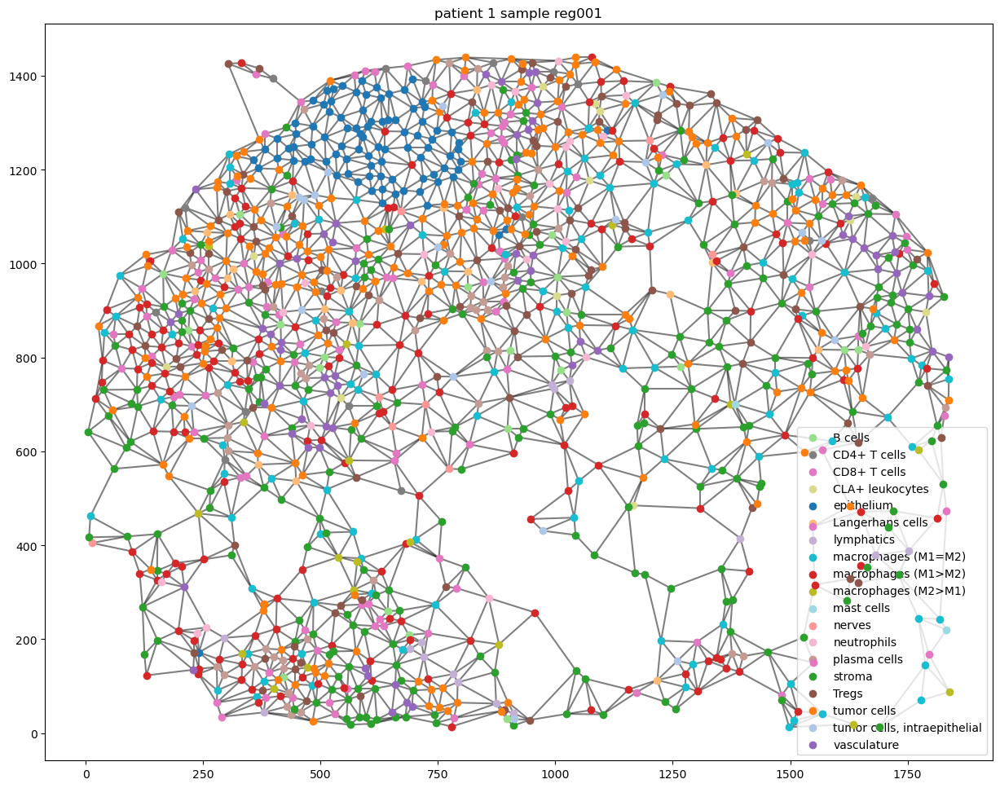

c:\ProgramData\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


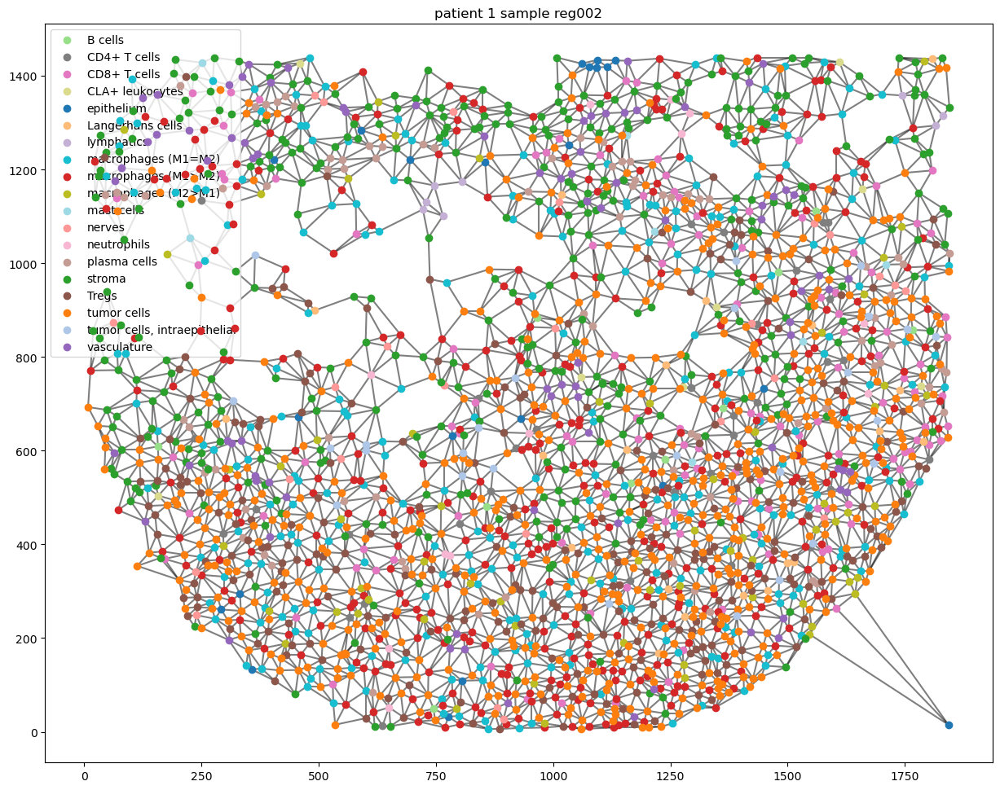

In [86]:
patient_id = 1  # that's our patient
select_patient = obj[patient_col] == patient_id
samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
for sample_id in samples:
    print("processing sample {}".format(sample_id))
    select_sample = obj[sample_col] == sample_id
    nodes = obj.loc[select_patient & select_sample, all_cols]
    coords = nodes[pos_cols].values
    pairs = ty.build_delaunay(coords)
    # we want to avoid isolated cells, so we link them to their 3 closest neighbors
    pairs = link_solitaries(coords, pairs, method='delaunay', min_neighbors=3)

    fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                              color_mapper=celltypes_color_mapper)
    plt.title(f"patient {patient_id} sample {sample_id}")

### All samples network reconstruction

#### Plot spatial networks

In [137]:
processed_dir = Path('../../data/processed/CODEX_CTCL')
dir_fig_save = processed_dir / 'figures'

In [138]:
# Choose optimal distance threshold for edge trimming

trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

save_dir = processed_dir / f"pretreatment_samples_networks_xy_choose_distance_trim_dist-{trim_dist}_solitary-{min_neighbors}"
save_dir.mkdir(parents=True, exist_ok=True)

# 'interesting' networks
samples_dst = [
    "reg001",
    "reg006",
    "reg040",
    "reg042",
    "reg051",
    "reg058",
]

k_sol = 0 

if RUN_LONG:
    for sample_id in samples_dst:
        print(f"    processing filename {sample_id}")
        select_sample = obj[sample_col] == sample_id
        nodes = obj.loc[select_sample, all_cols]
        coords = nodes[pos_cols].values
        pairs = ty.build_delaunay(
            coords, 
            node_adaptive_trimming=True, 
            n_edges=3, 
            trim_dist_ratio=2,
            min_dist=0, 
            trim_dist=trim_dist,
            )
        print("    ", end="")

        if min_neighbors > 0:
            pairs = ty.link_solitaries(
                coords, 
                pairs, 
                min_neighbors=min_neighbors,
                )
        distances = ty.distance_neighbors(coords, pairs)

        fig, ax = ty.plot_network_distances(
            coords, pairs, distances, labels=nodes[pheno_col],
            legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.2, 0.5)}
            )
        plt.axis('off');
        title = f"network_distances_sample-{sample_id}"
        plt.savefig(str(save_dir / title) + '.png', bbox_inches='tight', facecolor='white')
        plt.show()

In [134]:
reconst_dir

WindowsPath('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3')

In [139]:
trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"pretreatment_samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "networks_images_common_cmap_saturated_first"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

In [140]:
if RUN_LONG:
    for patient_id in obj[patient_col].unique():
        print(f"processing patient {patient_id}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
        for sample_id in samples:
            print(f"    processing sample {sample_id}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, all_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                                      color_mapper=celltypes_color_mapper, 
                                      legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
            plt.axis('off');
            title = f"patient {patient_id} sample {sample_id}_network_delaunay"
            plt.savefig(str(save_dir / title) + '.jpg', bbox_inches='tight', facecolor='white')
            plt.show()

#### Merge all samples

In [141]:
uniq_patients = obj[patient_col].unique()
uniq_samples = obj[sample_col].unique()
n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

In [56]:
# if RUN_LONG:
#     edges_all = pd.DataFrame(data=None, columns=['source', 'target'])
#     # number of nodes previously seen
#     nb_nodes = 0
#     for sample_id in obj[patient_col].unique():
#         print(f"processing sample {sample_id}")
#         select_sample = obj[patient_col] == sample_id
#         filenames = obj.loc[select_sample, sample_col].unique()
#         for filename in filenames:
#             print("    processing filename {}".format(filename))
#             select_file = obj[sample_col] == filename
#             nodes = obj.loc[select_sample & select_file, all_cols]
#             coords = nodes[pos_cols].values
#             pairs = ty.build_delaunay(
#                 coords, 
#                 node_adaptive_trimming=True, 
#                 n_edges=3, 
#                 trim_dist_ratio=2,
#                 min_dist=0, 
#                 trim_dist=trim_dist,
#                 )
#             if min_neighbors > 0:
#                 pairs = ty.link_solitaries(
#                     coords, 
#                     pairs, 
#                     min_neighbors=min_neighbors,
#                     )

#             # increase ids in pairs by the number of nodes in all previously loaded networks
#             pairs = pairs + nb_nodes
#             edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
#             edges[sample_col] = filename
#             # update number of nodes for next network
#             nb_nodes = nb_nodes + coords.shape[0]
#             edges_all = pd.concat([edges_all, edges], ignore_index=True)
#     edges_all.to_csv(reconst_dir / 'sample_all-edges.csv', index=False)
# else:
#     edges_all = pd.read_csv(reconst_dir / 'sample_all-edges.csv')

In [142]:
# or save in separate file for convenience
if RUN_LONG:
    for i, patient_id in enumerate(uniq_patients):
        print(f"processing patient {patient_id} {i+1}/{n_uniq_patients}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()
        for j, sample_id in enumerate(samples):
            print(f"    processing sample {sample_id} {i+j+1}/{n_uniq_samples}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, net_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
            edges.to_parquet(edges_dir / f'edges_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

            nodes.to_parquet(nodes_dir / f'nodes_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

### Data transfomation and batch correction

In [143]:
marker_cols = obj.columns[9:67]

#### CLR transformation

,FOXP3,GATA3,MUC-1,Vimentin,T-bet,CD62L,Cytokeratin,PD-L1,Ki-67,CD15,...,Mastcell-tryptase,MMP12,CD164,p53,CCR6,CD16,CD11b,CCR4,EGFR,HOECHST1:Cyc_1_ch_1
0,0.692403,80.418777,81.578133,0.422483,1281.423706,300.485474,0.025324,154.115509,21.706610,0.000000,...,0.000000,932.848084,2017.046997,1452.009888,1666.669556,1692.139648,729.536743,980.480530,2174.919678,3520.529297
1,8.094747,75.731651,113.700844,48.759071,871.266174,727.925598,6.335735,158.100159,0.000000,3.918327,...,0.818631,808.271423,2883.205811,1766.072021,1818.412964,2158.456299,4201.670898,2979.158447,1702.522217,2368.385986
2,4.110389,120.782913,92.355637,718.113159,541.268494,634.931030,0.000000,1358.853149,19.519222,0.000000,...,0.000000,696.024475,3790.150391,1198.464722,6729.749023,1725.925171,601.758179,2999.567627,1925.974609,2814.299561
3,0.000000,51.528435,66.819679,47.125046,1029.719727,441.645203,0.000000,179.429733,22.709156,0.000000,...,0.000000,763.677307,4075.999023,1284.326294,1321.358398,1140.679688,660.061523,1081.780029,1503.303955,2369.906738
4,2.937673,76.295013,136.434204,88.958450,528.213989,745.576172,25.205679,195.440445,36.913433,0.494460,...,0.000000,910.665527,8478.983398,1950.192505,2833.836670,703.584473,203.676590,767.187683,1224.029053,3678.256348


            FOXP3       GATA3       MUC-1     Vimentin        T-bet  \
0        0.692403   80.418777   81.578133     0.422483  1281.423706   
1        8.094747   75.731651  113.700844    48.759071   871.266174   
2        4.110389  120.782913   92.355637   718.113159   541.268494   
3        0.000000   51.528435   66.819679    47.125046  1029.719727   
4        2.937673   76.295013  136.434204    88.958450   528.213989   
...           ...         ...         ...          ...          ...   
38060    0.000000   50.714081    0.000000     0.000000     0.000000   
38061   42.773430  113.690819   15.576812  2006.328003   451.929474   
38062    0.000000   40.291916   46.055092  1636.253784   432.890259   
38063  100.574509   70.977242   58.662933  1532.417236   630.379089   
38064   24.392471   95.256981   28.812706   935.582336   377.873413   

            CD62L  Cytokeratin        PD-L1      Ki-67       CD15  ...  \
0      300.485474     0.025324   154.115509  21.706610   0.000000  ...   

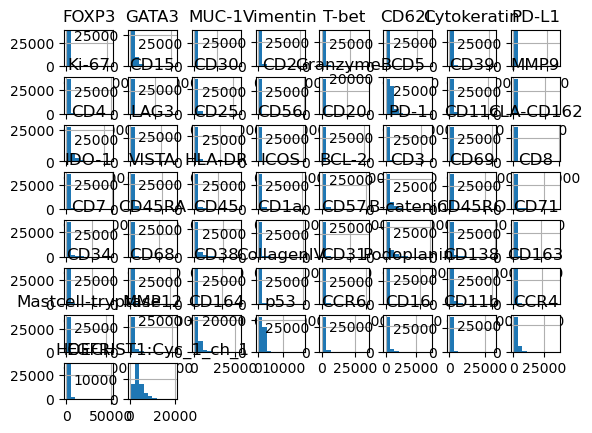

In [144]:
display(obj[marker_cols].head())
print(obj[marker_cols])
obj[marker_cols] = obj[marker_cols].replace(',', '.', regex=True).astype(float)
obj[marker_cols].hist();

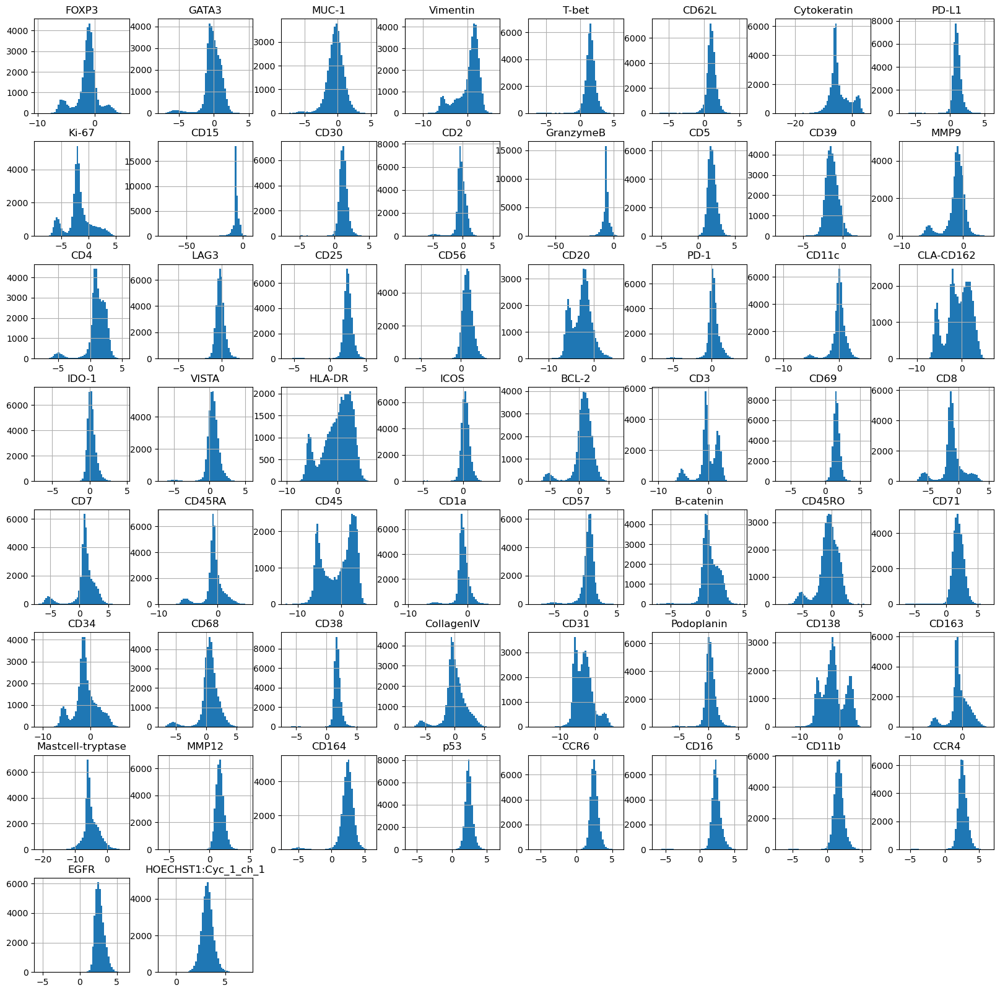

In [145]:
obj_transfo = mosna.transform_data(
    data=obj, 
    groups=sample_col,
    use_cols=marker_cols,
    method='clr')

obj_transfo[marker_cols].hist(bins=50, figsize=(20, 20));

In [146]:
nodes_dir = mosna.transform_nodes(
    nodes_dir=nodes_dir,
    id_level_1='patient',
    id_level_2='sample', 
    use_cols=marker_cols,
    method='clr',
    save_dir='auto',
)

### Batch corrrection

#### make UMAP before batch correction

In [147]:
print(nodes_dir)
nodes_agg = mosna.aggregate_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
)

..\..\data\processed\CODEX_CTCL\pretreatment_samples_networks_xy_min_size-0_solitary-3\transfo-clr


ValueError: No objects to concatenate

In [26]:
nodes_agg

,FOXP3,GATA3,MUC-1,Vimentin,T-bet,CD62L,Cytokeratin,PD-L1,Ki-67,CD15,...,MMP12,CD164,p53,CCR6,CD16,CD11b,CCR4,EGFR,patient,sample
0,-0.577643,0.303034,0.927949,-0.254543,0.851944,0.591799,-1.014143,1.522339,-0.601958,-2.251974,...,0.549218,0.289326,0.940971,1.641375,2.708796,0.289944,1.133214,1.207078,2,reg005
1,-4.033218,-2.332929,-2.044272,-0.798900,1.159985,-0.364916,-2.081535,1.967116,-2.880154,-4.608071,...,-1.465241,-0.273685,0.690325,0.419829,3.193155,-0.119408,3.098539,2.993863,2,reg005
2,-2.048273,-0.115249,0.215023,1.319041,1.894499,1.112348,-7.542443,1.253748,-1.996564,-6.372283,...,1.589725,3.393049,2.506503,2.419743,3.357358,2.663107,1.966820,2.683260,2,reg005
3,-1.421894,-0.095094,-0.589580,2.310676,1.796479,1.071387,-4.040258,1.084849,-2.450859,-7.075460,...,1.448667,3.458985,2.235682,2.178291,3.532978,2.236924,2.129429,2.647542,2,reg005
4,-1.072511,-0.551604,-0.770388,2.945916,1.797972,1.306224,-5.360121,1.162806,1.800443,-12.737854,...,0.825002,2.849466,2.392137,1.541138,3.435253,2.266494,1.887595,3.061349,2,reg005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38060,-0.149549,-1.043051,-2.003256,0.789330,0.380304,0.097740,-1.599680,0.585397,-2.324107,-2.378211,...,0.805515,1.117501,1.683828,1.661990,2.008904,1.183713,1.755553,1.850817,3,reg009
38061,0.250702,-1.129898,1.303055,1.391171,1.605707,1.185920,-6.081461,1.128793,-1.979856,-6.081461,...,1.319780,2.731213,2.775572,2.700915,2.659446,1.916965,2.706461,2.963308,3,reg009
38062,-0.508385,-0.081507,2.071783,0.256330,0.813486,0.784149,-7.157277,0.774346,0.957699,-7.157277,...,0.739428,1.866181,2.027164,1.918900,1.718823,0.974998,2.344081,1.826326,3,reg009
38063,0.925035,-0.753774,-2.943654,2.362044,2.032106,1.283706,-5.719733,1.141324,-5.719733,-4.729417,...,1.531272,1.507729,3.161583,2.694277,3.807474,2.364732,2.845351,3.155808,3,reg009


In [133]:
embed_viz, _ = mosna.get_reducer(nodes_agg[marker_cols], nodes_dir)

NameError: name 'nodes_agg' is not defined

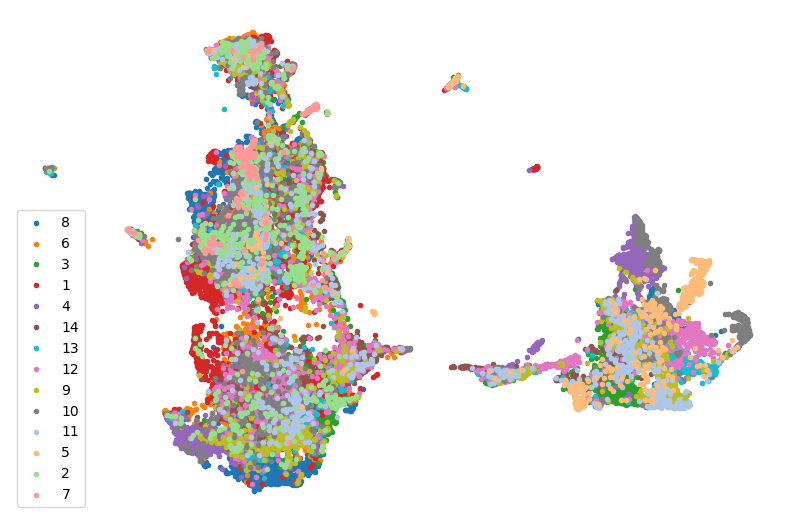

In [48]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

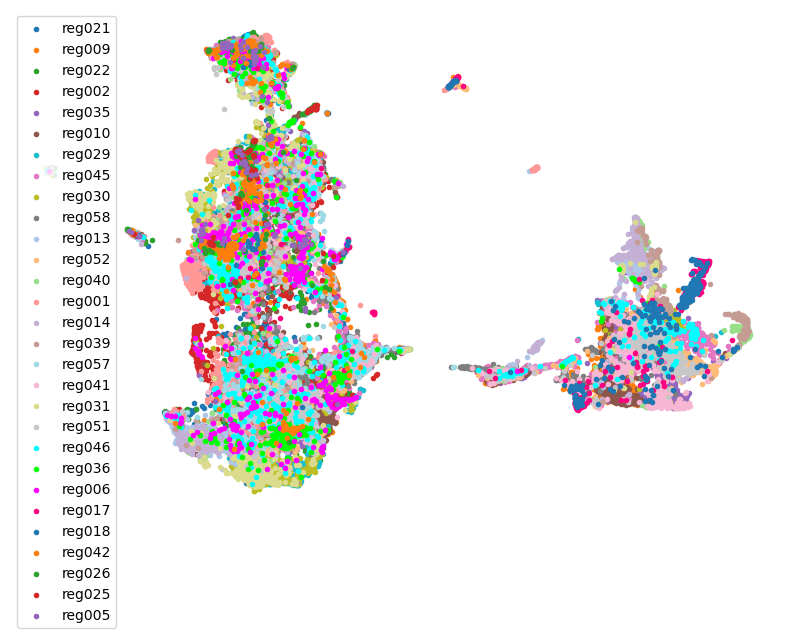

In [49]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['sample'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

#### Perform batch correction

In [ ]:
nodes_dir, nodes_corr = mosna.batch_correct_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
    batch_key='patient',
    return_nodes=True,
    )

In [102]:
embed_viz, _ = mosna.get_reducer(nodes_corr[marker_cols], nodes_dir, random_state=0)

Loading reducer object and reduced coordinates


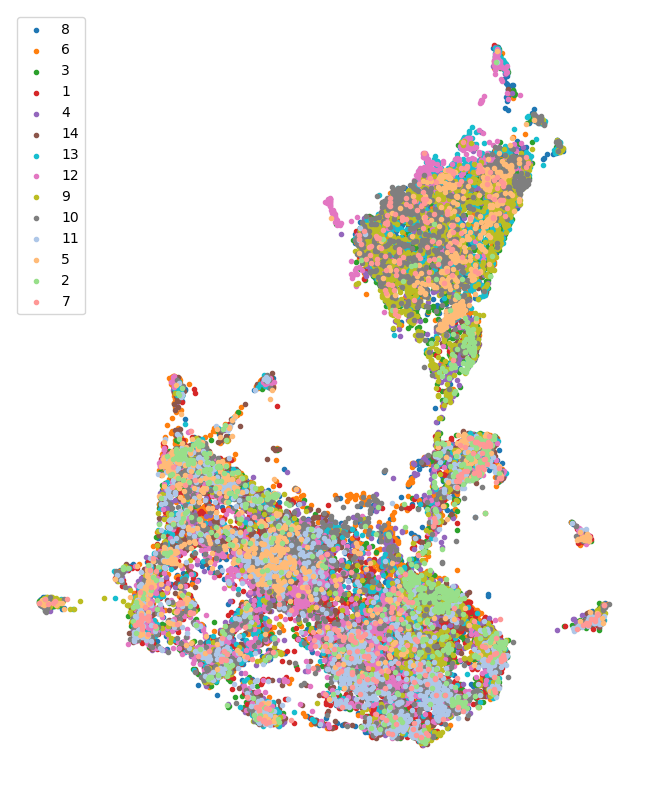

In [103]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_corr['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

## Response groups characteristics and survival analysis

We will look at what variables define or explain response to therapy or longer survival.  
For this, we will start with the simplest statistics, like proportions of cell types or marker-positive cells, and we will gradulally increase the complexity of variables, looking at interactions between cell types and finally discovering spatial neighborhoods, or "niches", potentially predictive of response to therapy.

### Cell types proportions

In [20]:
# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique() 

In [21]:
# here we don't use `sample_col` but `patient_col` in the group / unstack procedure to aggregate 
# statistics per patient and condition (before / after treatment) rather than per sample.

count_types = obj[[patient_col, group_col, 'Count']].join(nodes_all[pheno_col]).groupby([patient_col, group_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
# count_types.index.name = 'sample'
count_types.to_csv(save_dir / 'count_types_per_patient_per_condition.csv')
count_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,34,50,229,20,0,0,42,350,112,23,...,545,83,9,33,36,133,582,777,48,149
2,1,6,3,5,3,0,0,12,15,6,5,...,71,64,3,6,1,4,203,155,2,95
3,2,2,208,186,14,0,2,130,99,1759,24,...,397,39,33,17,0,4,328,546,274,86
4,2,178,20,45,0,0,0,16,9,901,7,...,202,10,12,9,0,4,356,987,5,186
5,1,0,0,1,0,0,0,5,6,913,0,...,17,2,2,3,0,1,34,7,1,18
6,2,83,200,693,15,0,3,95,357,11,102,...,809,43,20,5,26,35,679,1157,22,255
7,2,0,0,0,0,0,0,1,0,0,3,...,16,0,5,150,0,0,180,3,0,32
8,2,24,42,39,14,0,0,9,38,338,45,...,174,730,1,49,69,31,871,2081,8,306
9,1,2,19,51,2,0,0,11,9,1041,4,...,129,11,29,11,0,0,354,751,12,168


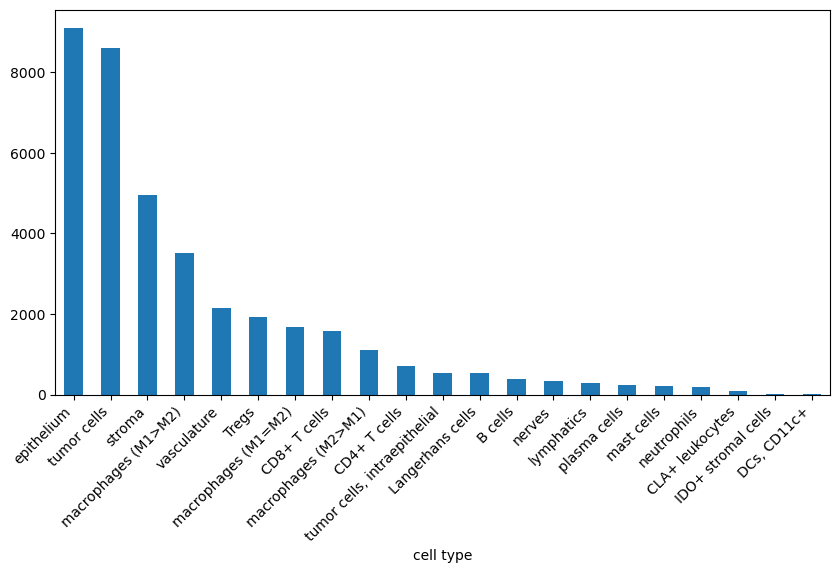

In [22]:
ax = count_types.sum().sort_values(ascending=False).plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');

Instead of counts we use proportions of cell types per patient and condition.

In [23]:
prop_types = count_types.div(count_types.sum(axis=1), axis=0)
prop_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,0.009379,0.013793,0.063172,0.005517,0.000000,0.000000,0.011586,0.096552,0.030897,0.006345,...,0.150345,0.022897,0.002483,0.009103,0.009931,0.036690,0.160552,0.214345,0.013241,0.041103
2,1,0.008392,0.004196,0.006993,0.004196,0.000000,0.000000,0.016783,0.020979,0.008392,0.006993,...,0.099301,0.089510,0.004196,0.008392,0.001399,0.005594,0.283916,0.216783,0.002797,0.132867
3,2,0.000465,0.048327,0.043216,0.003253,0.000000,0.000465,0.030204,0.023002,0.408690,0.005576,...,0.092240,0.009061,0.007667,0.003950,0.000000,0.000929,0.076208,0.126859,0.063662,0.019981
4,2,0.058649,0.006590,0.014827,0.000000,0.000000,0.000000,0.005272,0.002965,0.296870,0.002306,...,0.066557,0.003295,0.003954,0.002965,0.000000,0.001318,0.117298,0.325206,0.001647,0.061285
5,1,0.000000,0.000000,0.000984,0.000000,0.000000,0.000000,0.004921,0.005906,0.898622,0.000000,...,0.016732,0.001969,0.001969,0.002953,0.000000,0.000984,0.033465,0.006890,0.000984,0.017717
6,2,0.017263,0.041597,0.144135,0.003120,0.000000,0.000624,0.019759,0.074251,0.002288,0.021215,...,0.168261,0.008943,0.004160,0.001040,0.005408,0.007280,0.141223,0.240641,0.004576,0.053037
7,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002494,0.000000,0.000000,0.007481,...,0.039900,0.000000,0.012469,0.374065,0.000000,0.000000,0.448878,0.007481,0.000000,0.079800
8,2,0.004871,0.008524,0.007916,0.002841,0.000000,0.000000,0.001827,0.007713,0.068602,0.009133,...,0.035316,0.148163,0.000203,0.009945,0.014004,0.006292,0.176781,0.422367,0.001624,0.062107
9,1,0.000749,0.007113,0.019094,0.000749,0.000000,0.000000,0.004118,0.003370,0.389742,0.001498,...,0.048297,0.004118,0.010857,0.004118,0.000000,0.000000,0.132535,0.281168,0.004493,0.062898


In [24]:
pvals = mosna.find_DE_markers(prop_types, group_ref=1, group_tgt=2, group_var=group_col)
pvals

,pval,pval_corr
IDO+ stromal cells,0.075413,0.988974
lymphatics,0.128205,0.988974
CD4+ T cells,0.141282,0.988974
tumor cells,0.259324,0.996411
epithelium,0.317599,0.996411
CD8+ T cells,0.382867,0.996411
vasculature,0.455711,0.996411
B cells,0.481721,0.996411
macrophages (M1=M2),0.534965,0.996411
Langerhans cells,0.620047,0.996411


There are 0 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

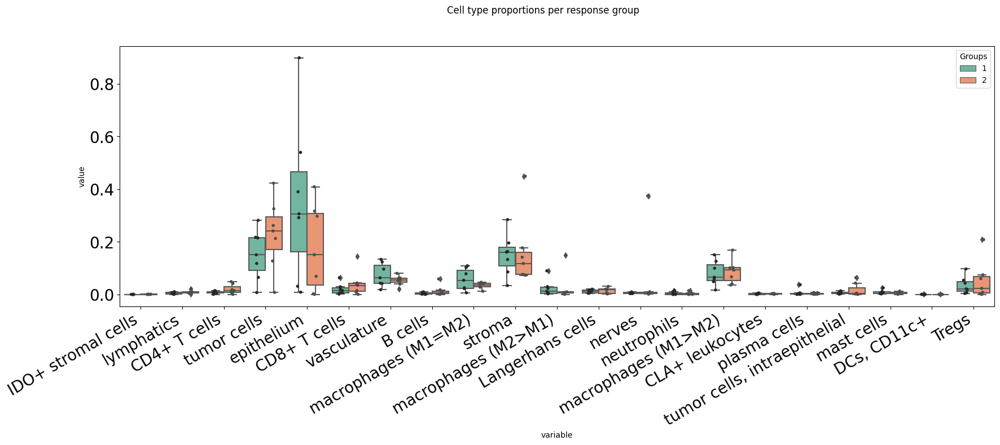

In [28]:
fig, ax = mosna.plot_distrib_groups(
    prop_types, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=-1, 
    multi_ind_to_col=True,
    )
fig.suptitle("Cell type proportions per response group", y=1.0);

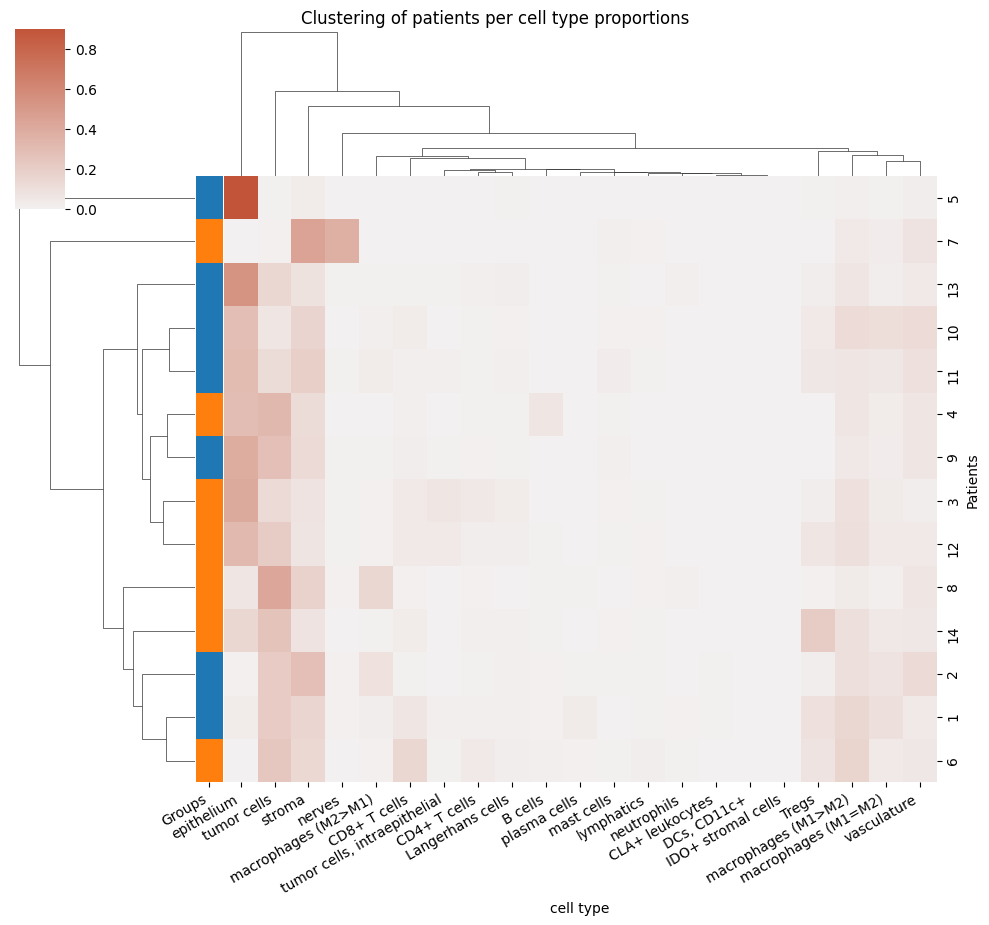

In [29]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    )
g.fig.suptitle("Clustering of patients per cell type proportions", y=1.0);

Because some variables have generally higher values than others, that give them more weight to compare samples.  
To compensate for this effect we should standardize values per variable.

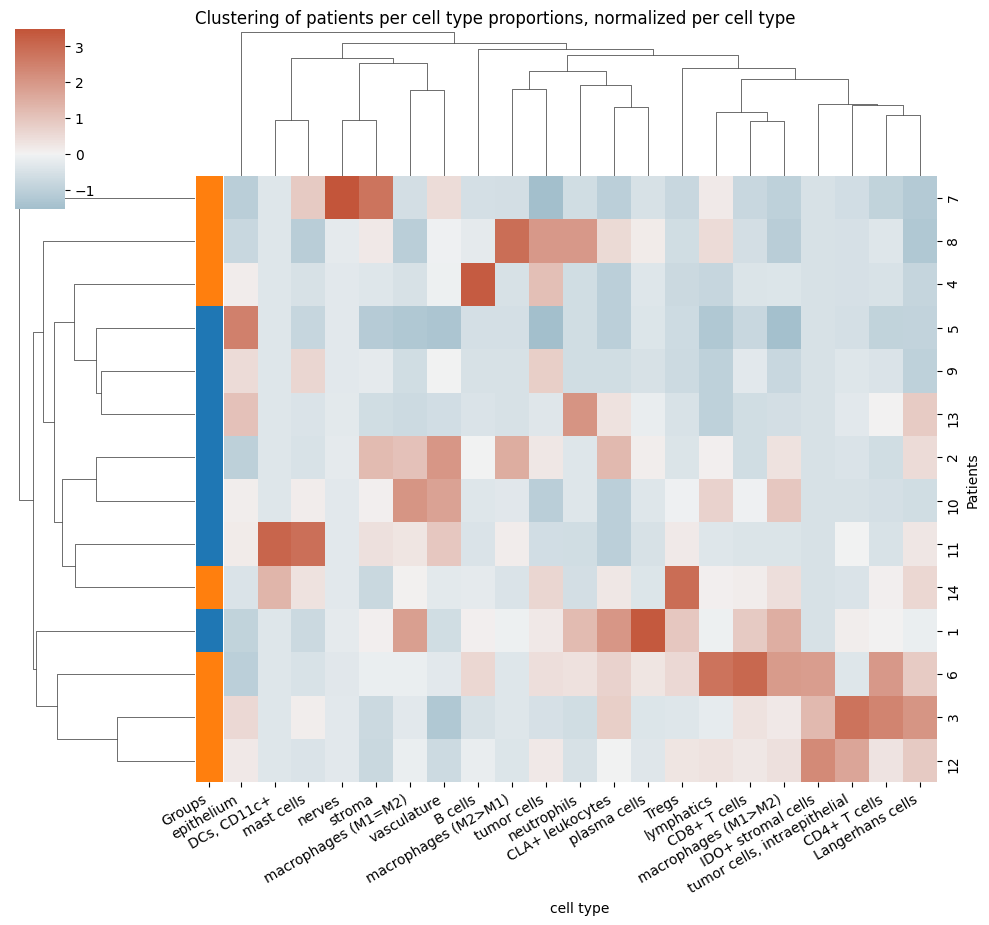

In [30]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    )
g.fig.suptitle("Clustering of patients per cell type proportions, normalized per cell type", y=1.0);

In [25]:
# With this dataset, when we filter networks without enough nodes
# we can't split patients in 5 groups having at least one occurrence
# of both groups (one patient of group 2 is deleted).

if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

        training failed
        training failed with cv <= 5
Training took 2.544s


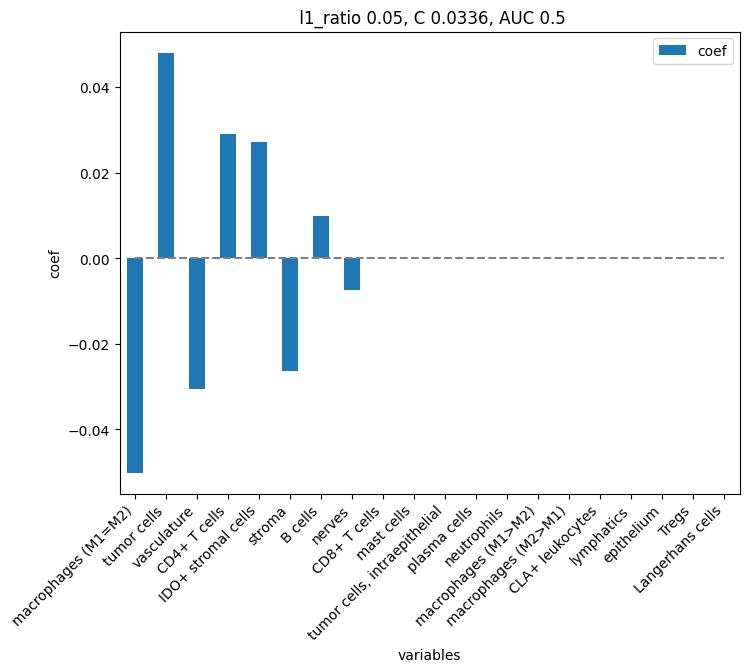

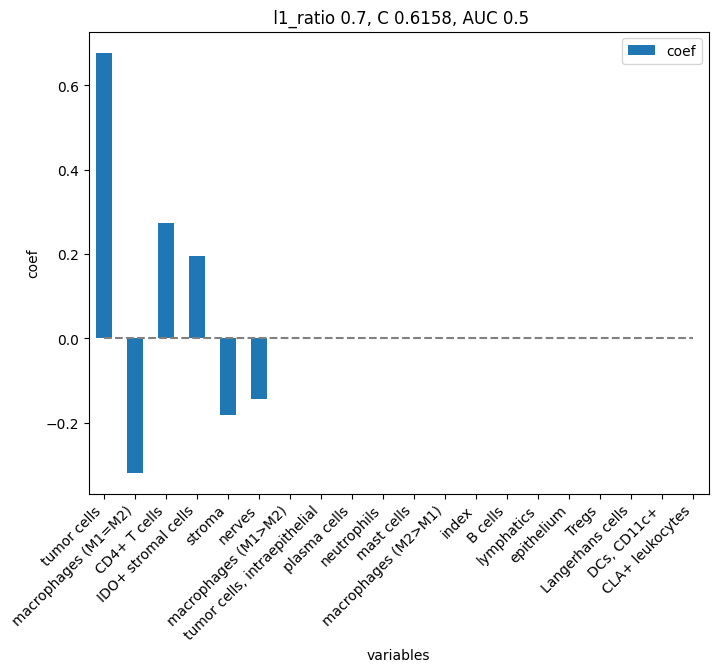

In [32]:
models = mosna.logistic_regression(
    prop_types.reset_index(),
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    figsize=(8,6),
    )

Cell types proportions are not significantly associated with response / non response in samples before treatment.  
But `mosna` can find composed variables potentially related to response of patients:

### Ratio of cell type proportions

In [33]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [34]:
pvals.head(20)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.696813
lymphatics / vasculature,0.026224,0.696813
lymphatics / macrophages (M2>M1),0.040692,0.696813
tumor cells / vasculature,0.053030,0.696813
IDO+ stromal cells / epithelium,0.053349,0.696813
IDO+ stromal cells / macrophages (M2>M1),0.053349,0.696813
"IDO+ stromal cells / tumor cells, intraepithelial",0.053349,0.696813
CD8+ T cells / IDO+ stromal cells,0.053349,0.696813
IDO+ stromal cells / Tregs,0.053349,0.696813
lymphatics / stroma,0.072844,0.696813


There are 3 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

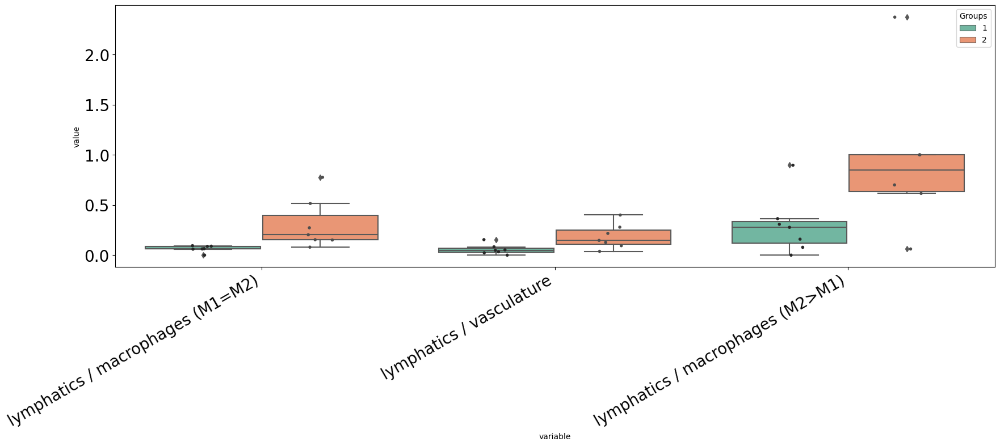

In [35]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

In [37]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 315 non finite values (9.7%)
Imputing data


In [40]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.829539
lymphatics / vasculature,0.026224,0.829539
IDO+ stromal cells / Tregs,0.030721,0.829539
IDO+ stromal cells / epithelium,0.030721,0.829539
IDO+ stromal cells / macrophages (M2>M1),0.030721,0.829539
"IDO+ stromal cells / tumor cells, intraepithelial",0.030721,0.829539
tumor cells / vasculature,0.053030,0.829539
lymphatics / macrophages (M2>M1),0.055017,0.829539
lymphatics / stroma,0.072844,0.829539
CD4+ T cells / macrophages (M2>M1),0.072844,0.829539


There are 6 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

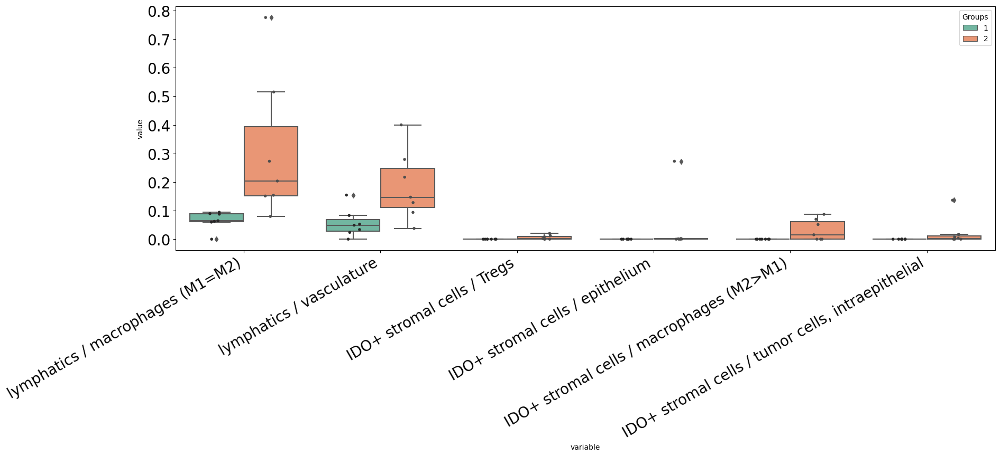

In [41]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

There are 6 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

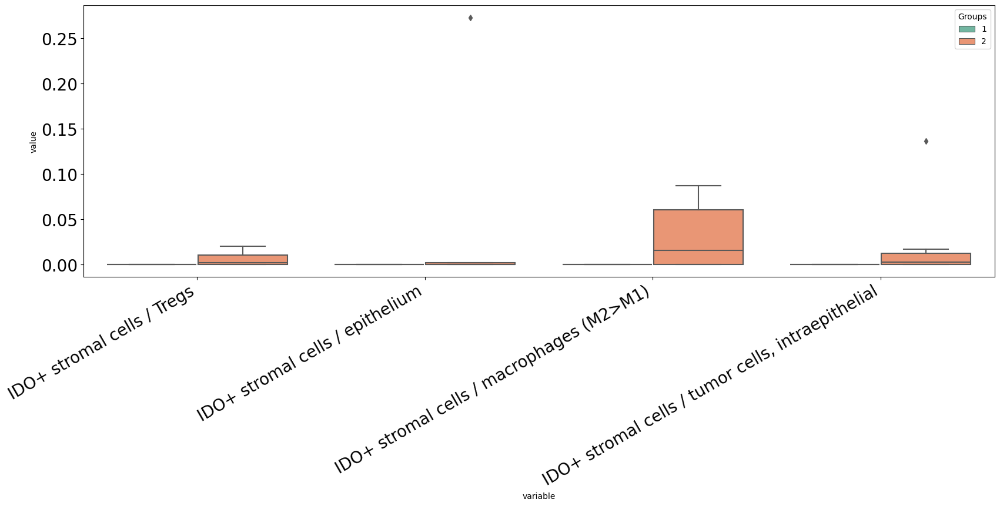

In [43]:
# ignore the first 2 composed variables as their representation hide other distributions

exclude_vars = [
    'lymphatics / macrophages (M1=M2)',
    'lymphatics / vasculature',
]

fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    add_points=False,
    )

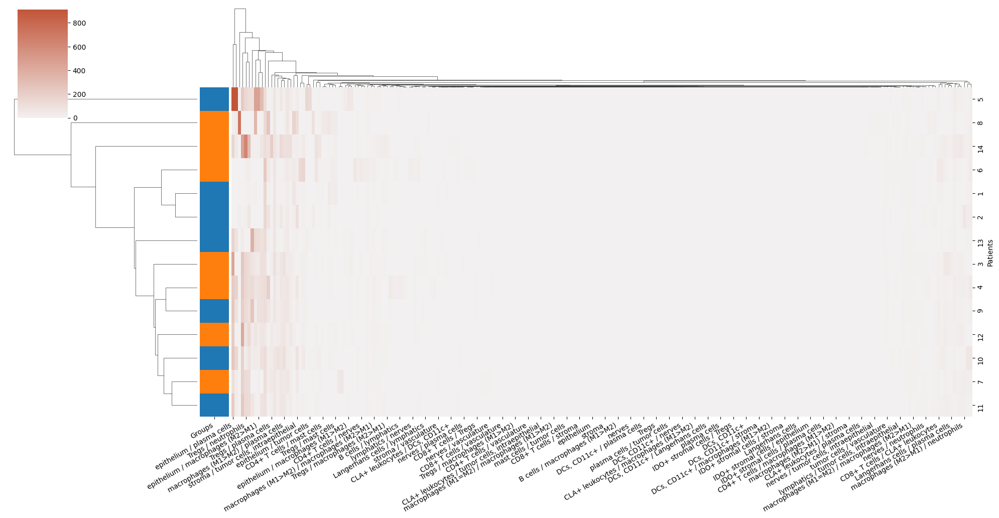

In [44]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    );

In [46]:
# We can't display the dendrogram with values normalized per variable, as some non finite values are produced and make seaborn crash.  

# best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# # or to select only 20 variables:
# # best_pval_names = pvals.head(20).index
# mosna.plot_heatmap(
#     prop_types_comp_cleaned.reset_index(), 
#     obs_labels=patient_col, 
#     group_var=group_col, 
#     groups=[1, 2],
#     z_score=1,
#     figsize=(20, 12),
#     )

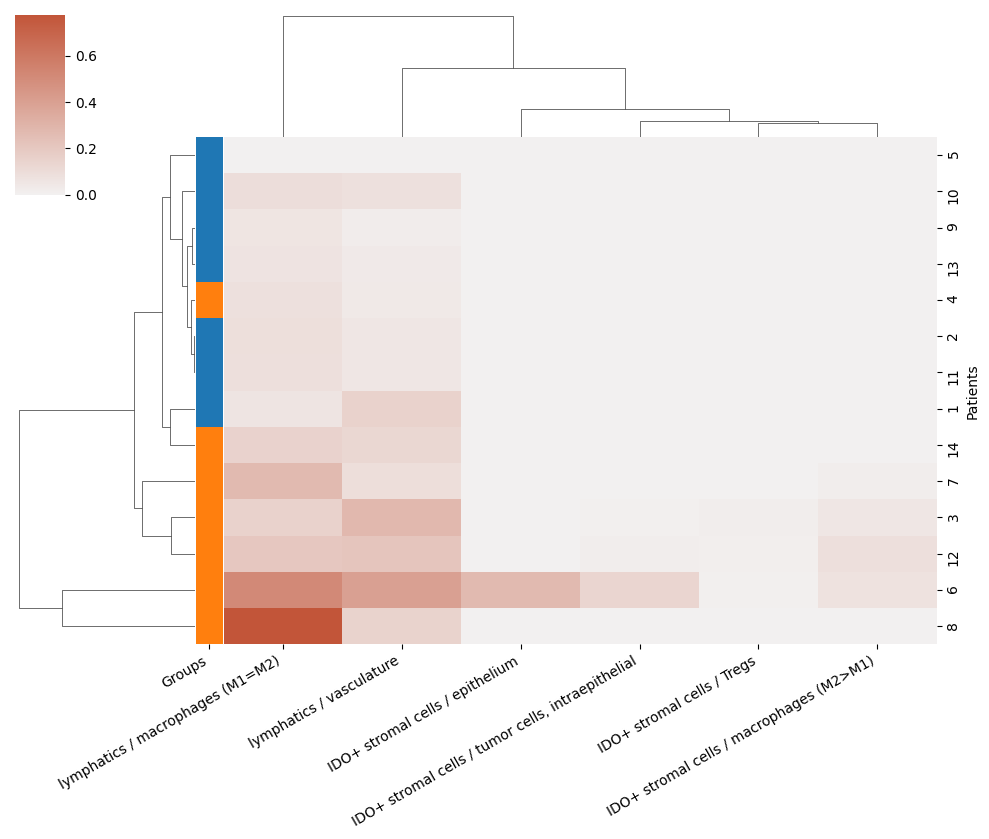

In [49]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    );

Training took 2.929s


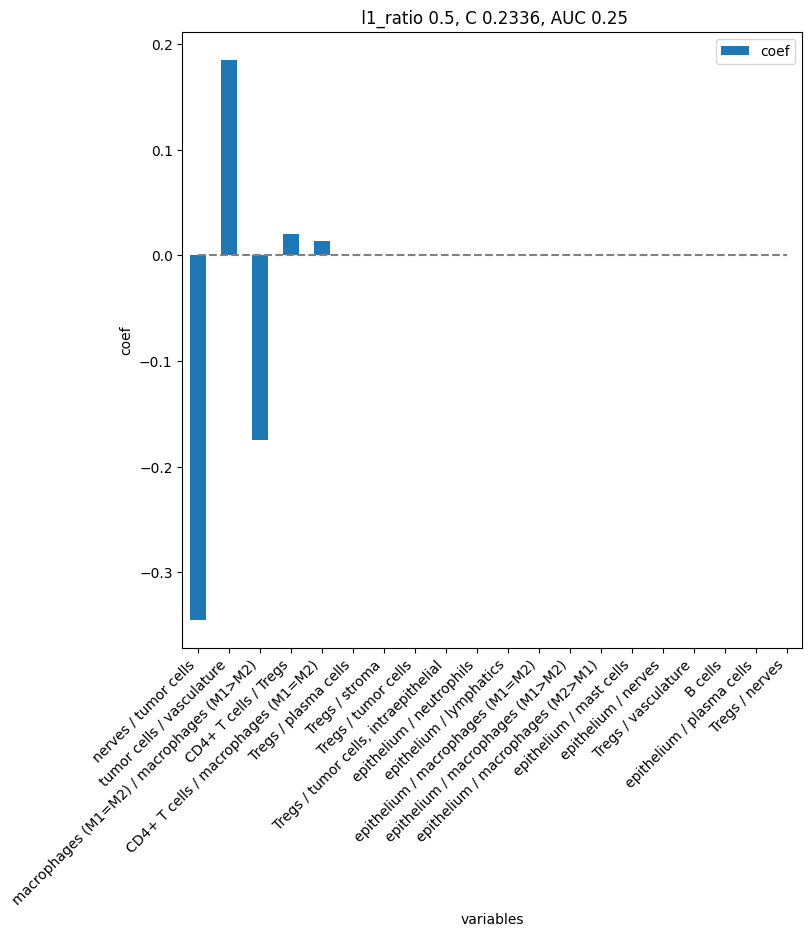

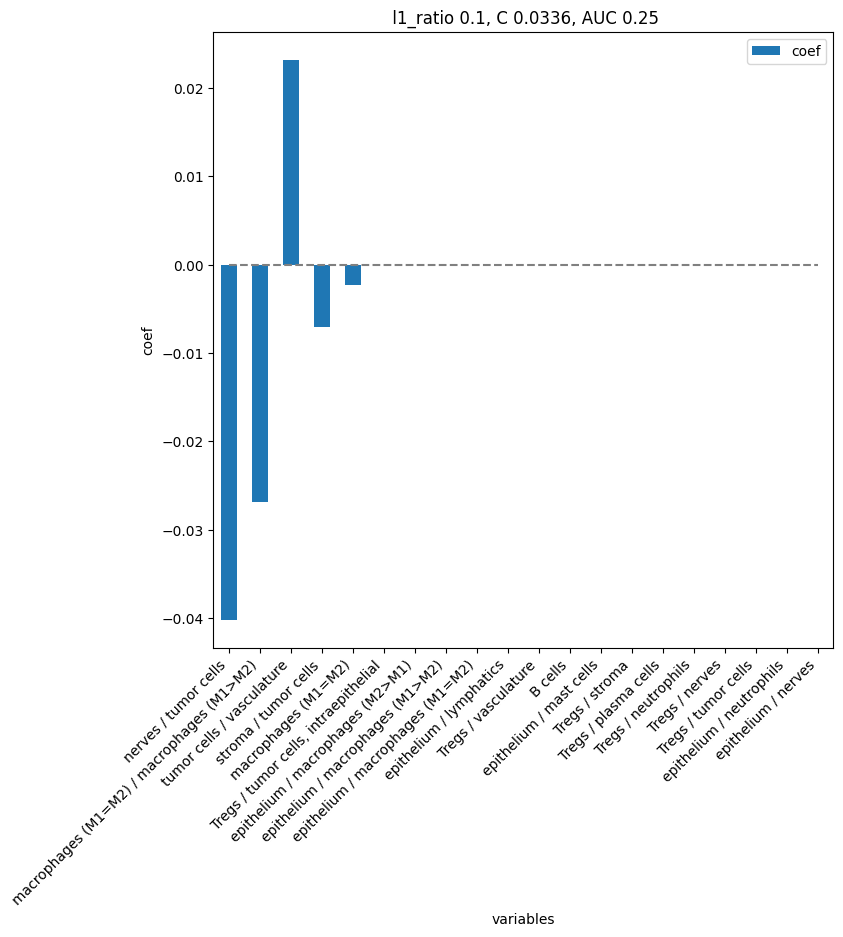

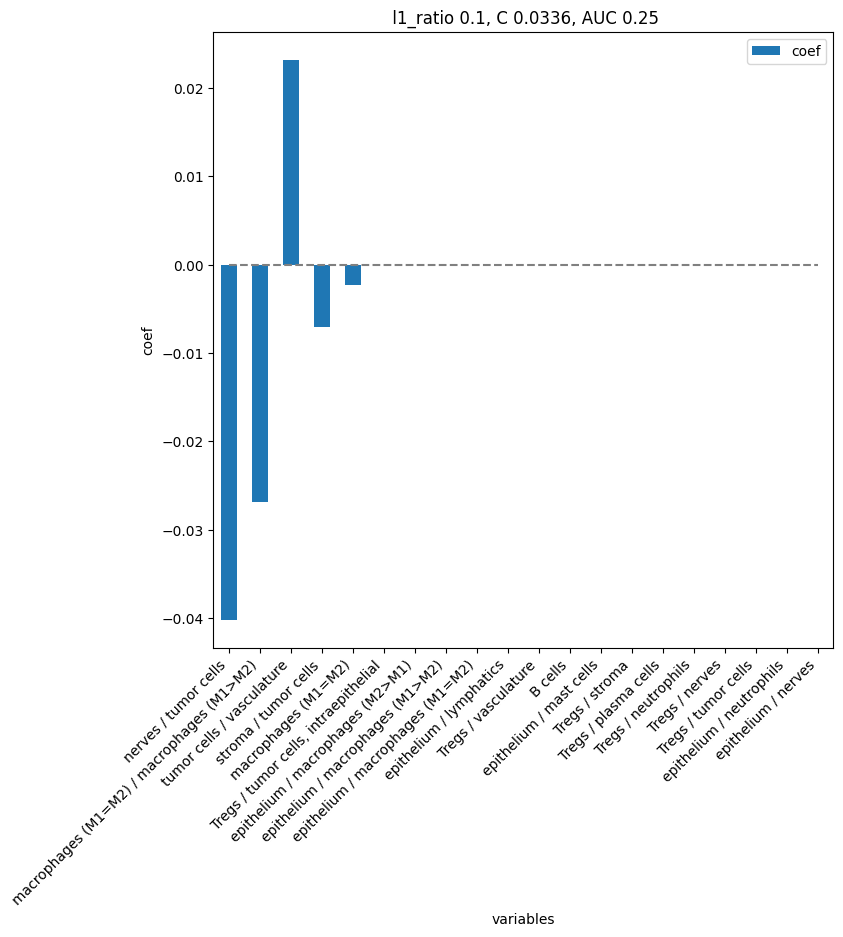

In [50]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.373s


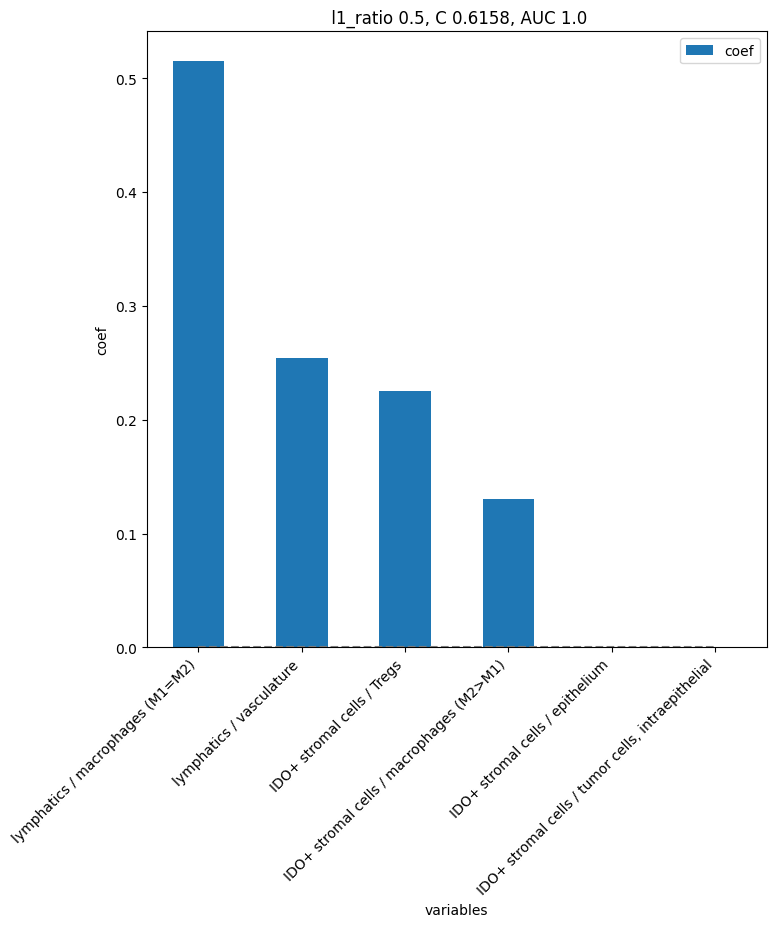

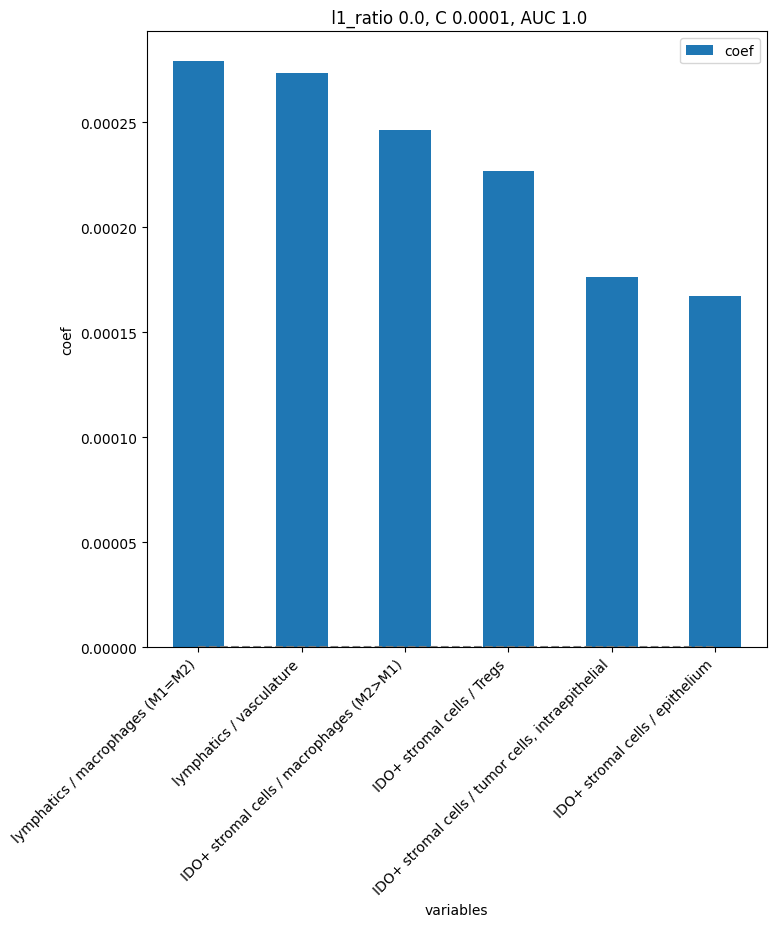

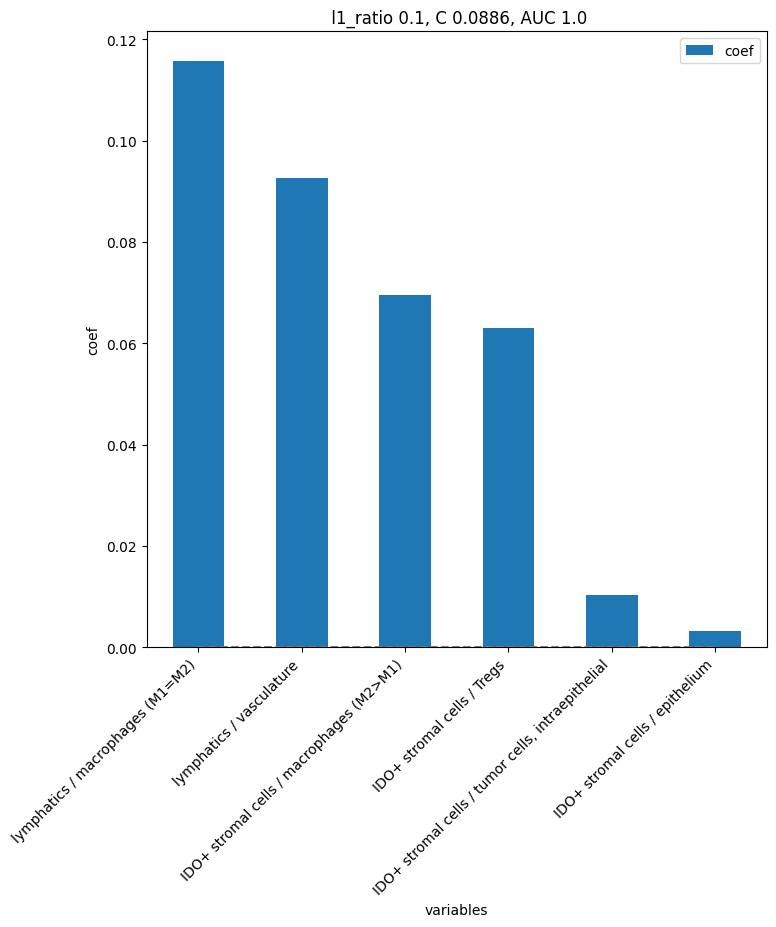

In [51]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Proportions of cell type proportions

Simple ratios can be problematic as they can lead to extreme values, such as in the case of x/0. To avoid that, we use proportions instead, i.e. a / (a + b), so all values are between 0 and 1.

In [57]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='proportion', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [58]:
pvals.head(20)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.696813
lymphatics / ( lymphatics + vasculature ),0.026224,0.696813
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.696813
tumor cells / ( tumor cells + vasculature ),0.053030,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + epithelium ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + macrophages (M2>M1) ),0.053349,0.696813
"IDO+ stromal cells / ( IDO+ stromal cells + tumor cells, intraepithelial )",0.053349,0.696813
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.053349,0.696813
lymphatics / ( lymphatics + stroma ),0.072844,0.696813


There are 3 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

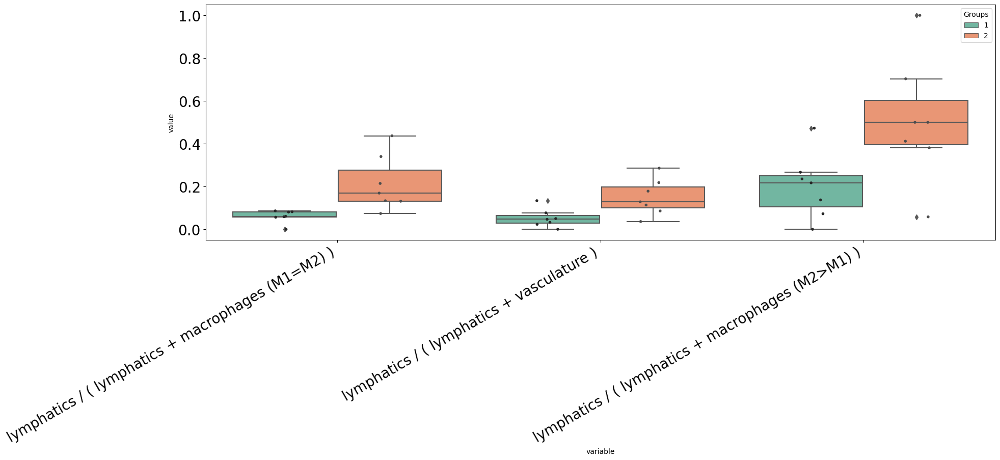

In [59]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

In [60]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN

# with proportions of variables there are 3x fewer NaNs
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 113 non finite values (3.5%)
Imputing data


In [61]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.829539
lymphatics / ( lymphatics + vasculature ),0.026224,0.829539
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.829539
tumor cells / ( tumor cells + vasculature ),0.053030,0.829539
lymphatics / ( lymphatics + macrophages (M1>M2) ),0.072844,0.829539
nerves / ( nerves + tumor cells ),0.072844,0.829539
lymphatics / ( lymphatics + stroma ),0.072844,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.075413,0.829539
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.075413,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + vasculature ),0.075413,0.829539


In [63]:
# Here there is no additional significant variable after data imputation, so we don't plot anything

# fig, ax = mosna.plot_distrib_groups(
#     prop_types_comp_cleaned, 
#     group_var=group_col,
#     groups=[1, 2], 
#     pval_data=pvals_cleaned, 
#     pval_col='pval', 
#     max_cols=20, 
#     multi_ind_to_col=True,
#     )

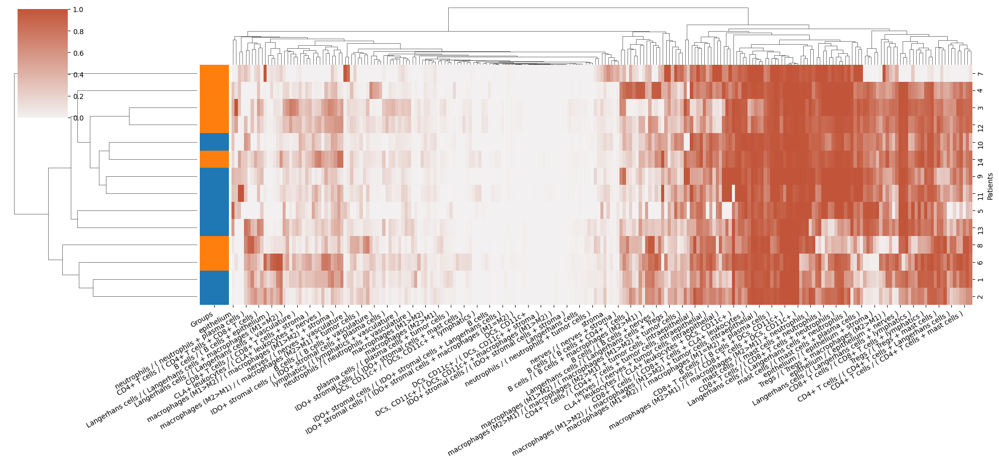

In [64]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    );

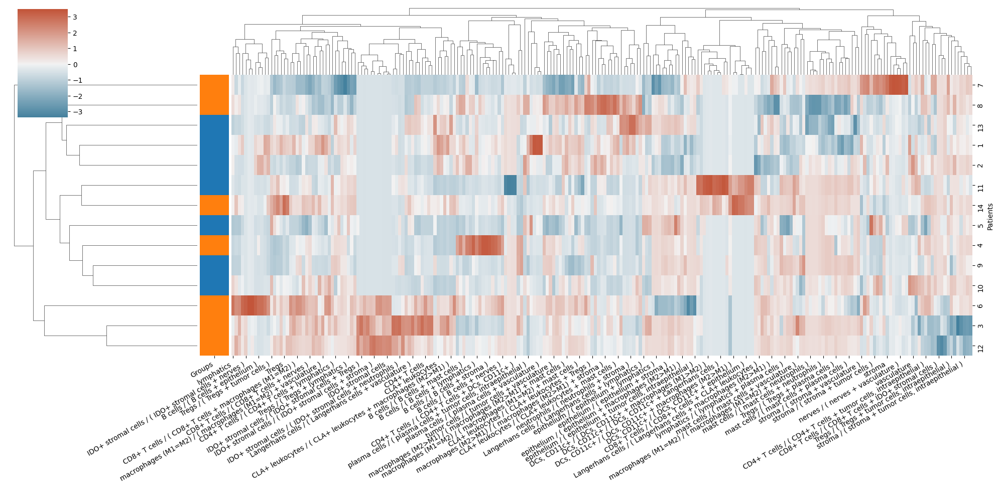

In [65]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

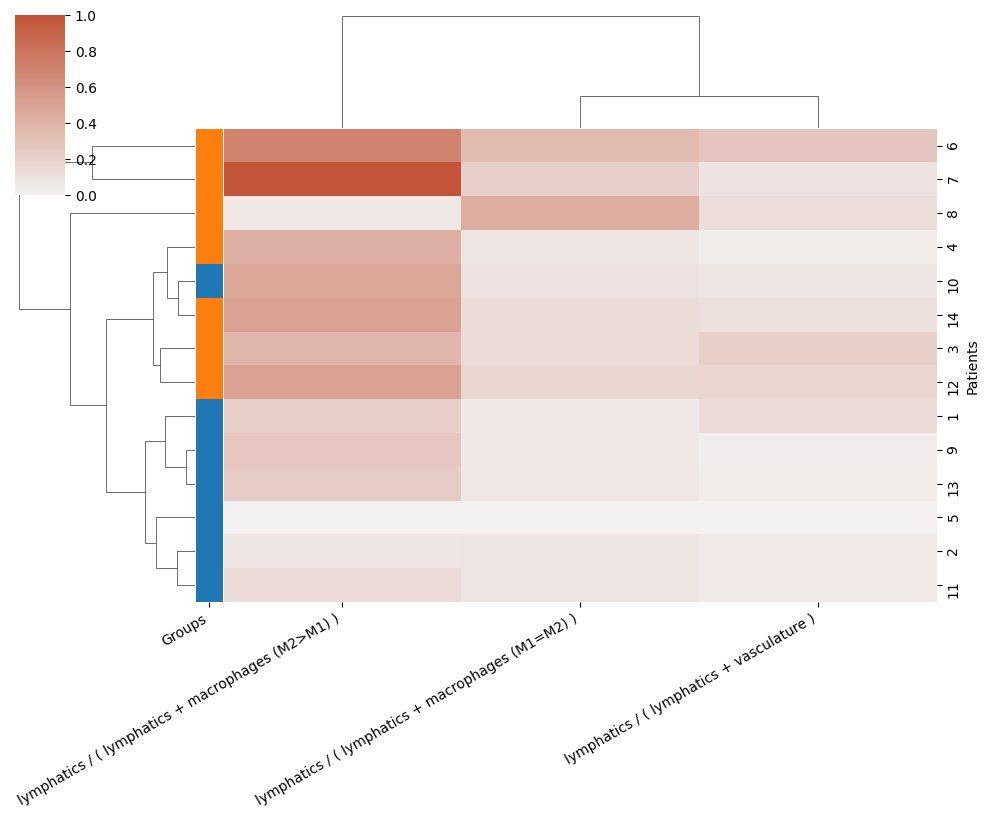

In [71]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    );

Training took 3.035s


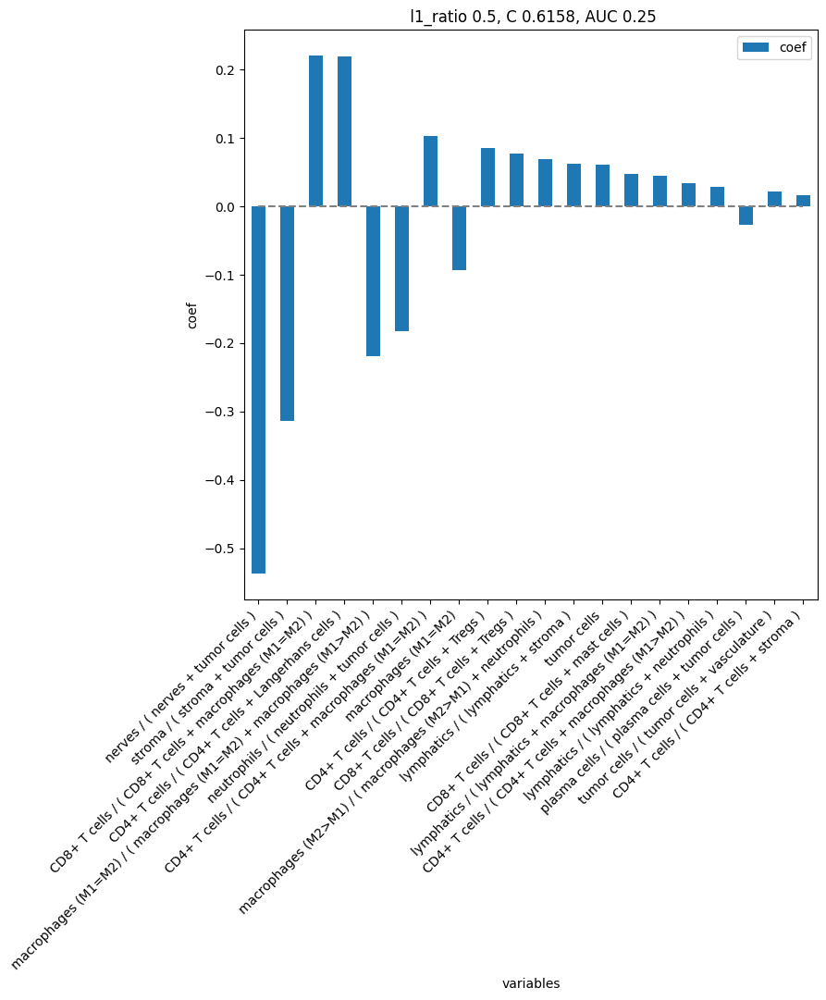

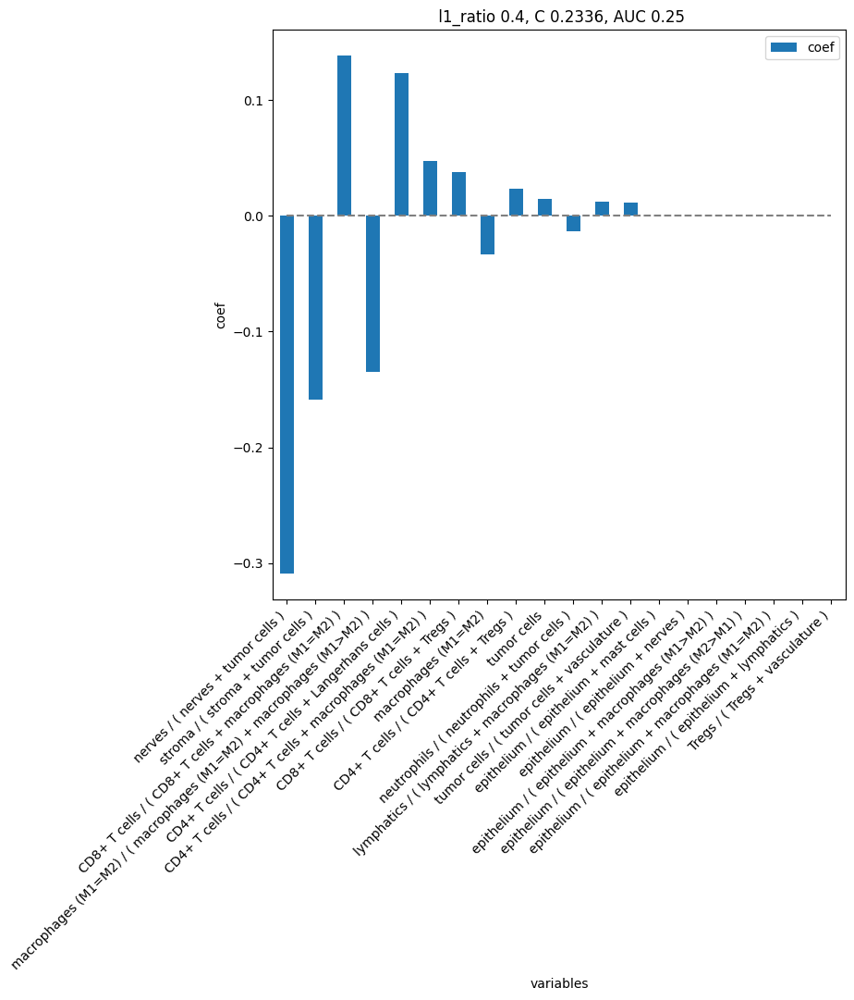

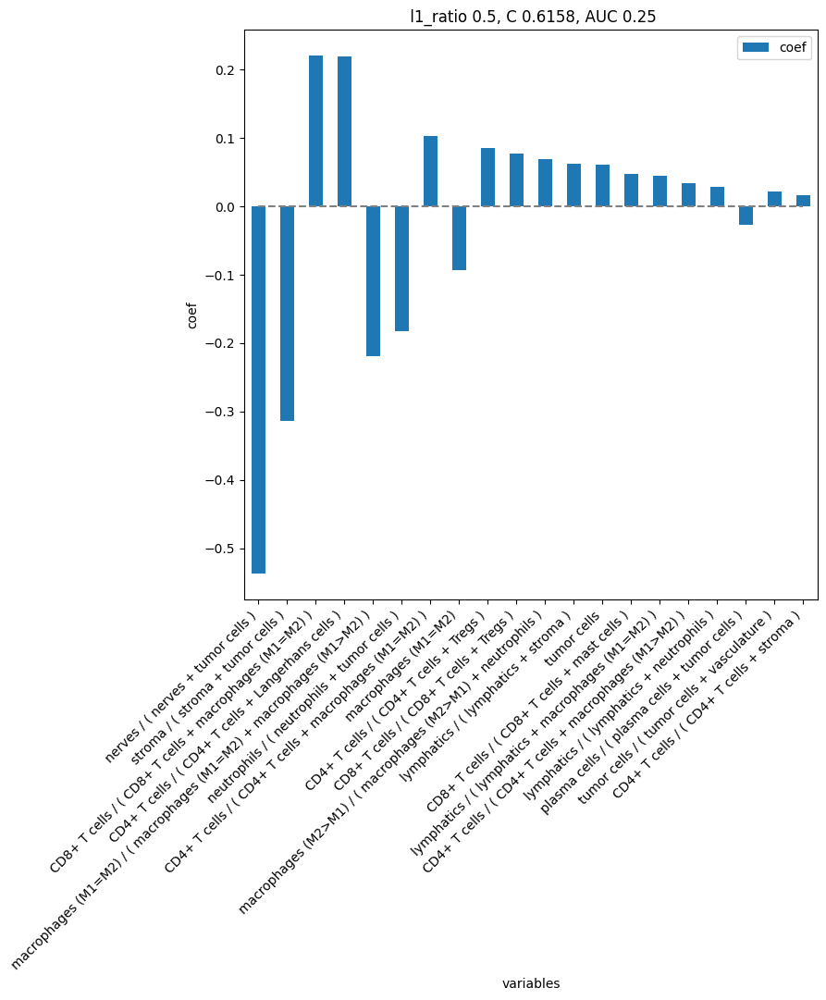

In [67]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.473s


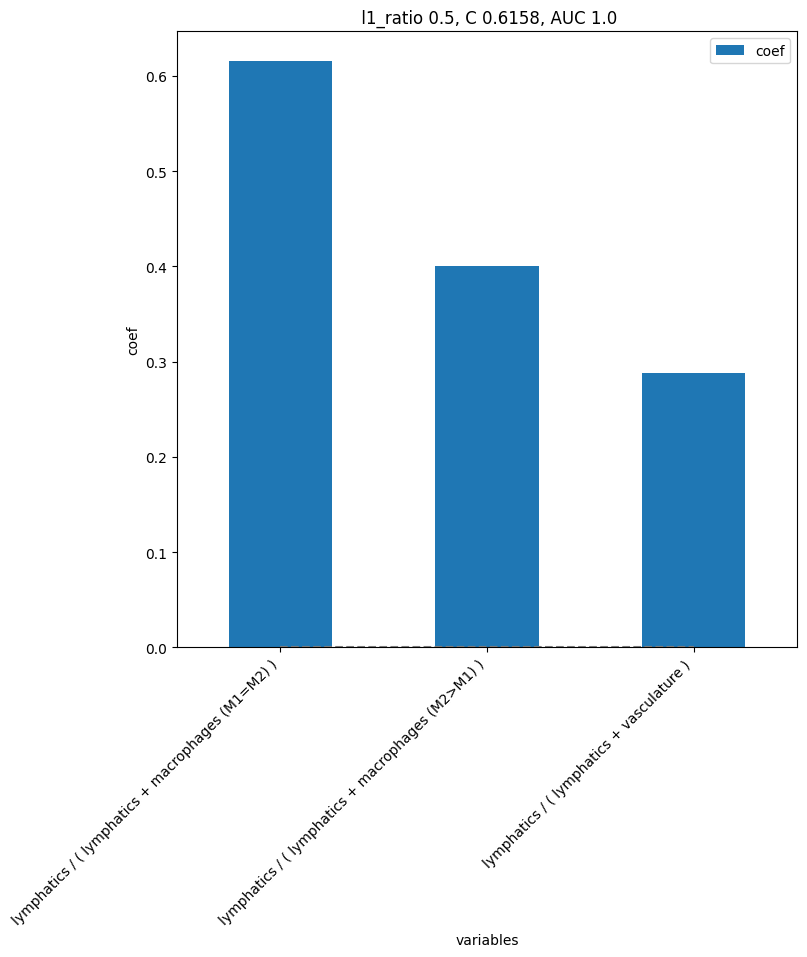

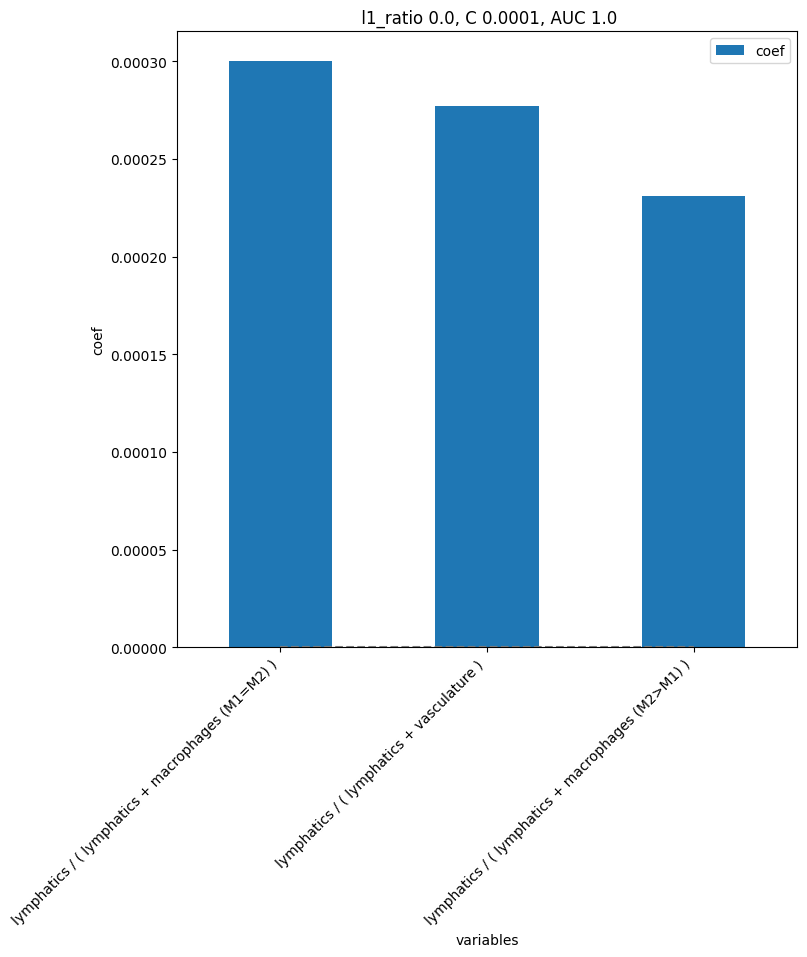

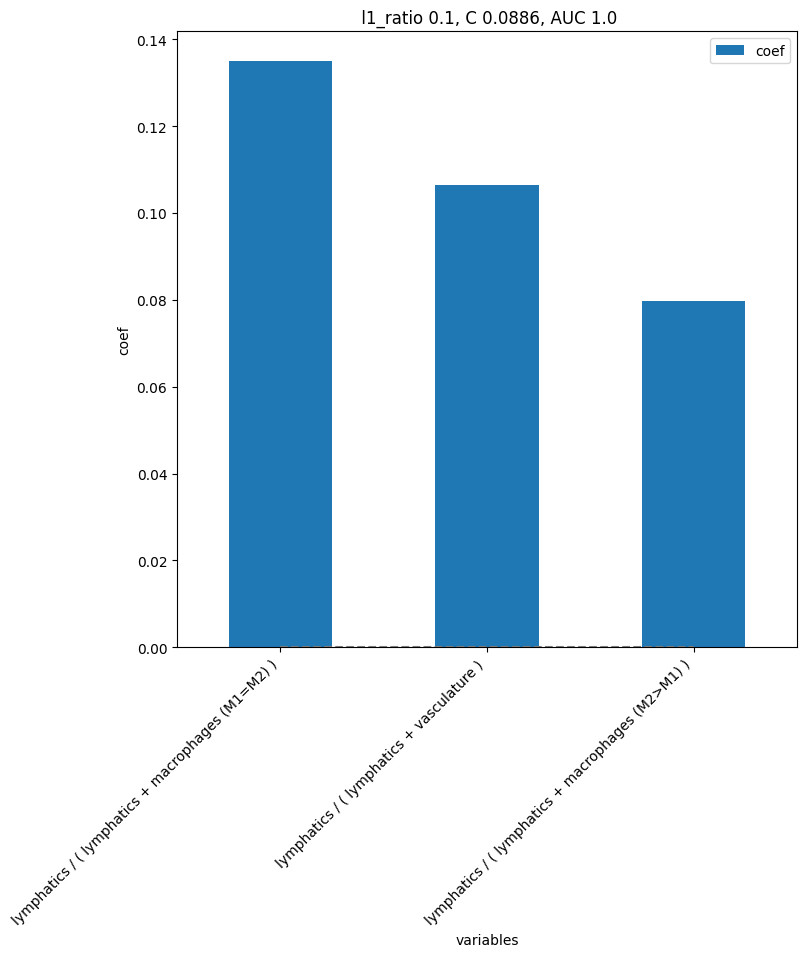

In [68]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Second order of cell types ratios

In [72]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=2)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [73]:
pvals.head(20)

,pval,pval_corr
(lymphatics / macrophages (M2>M1)) / (mast cells / tumor cells),0.002331,0.615098
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.002331,0.615098
lymphatics / macrophages (M1=M2),0.004079,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.004662,0.615098
(lymphatics / macrophages (M2>M1)) / (stroma / tumor cells),0.006993,0.615098
(lymphatics / macrophages (M1>M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / stroma),0.011072,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / vasculature),0.011072,0.615098
(CD8+ T cells / Tregs) / (nerves / tumor cells),0.013986,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / vasculature),0.013986,0.615098


In [74]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected)')

There are 58 significant variables (non corrected)


The first variables related to cell types proportions are composed variables of the 2nd order (ratio of ratios), only `lymphatics / macrophages (M1=M2)` appear in the simpler composed variables, but all corrected pvalues are > 0.05. This is because mosna produced *a lot* of composed variables.

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

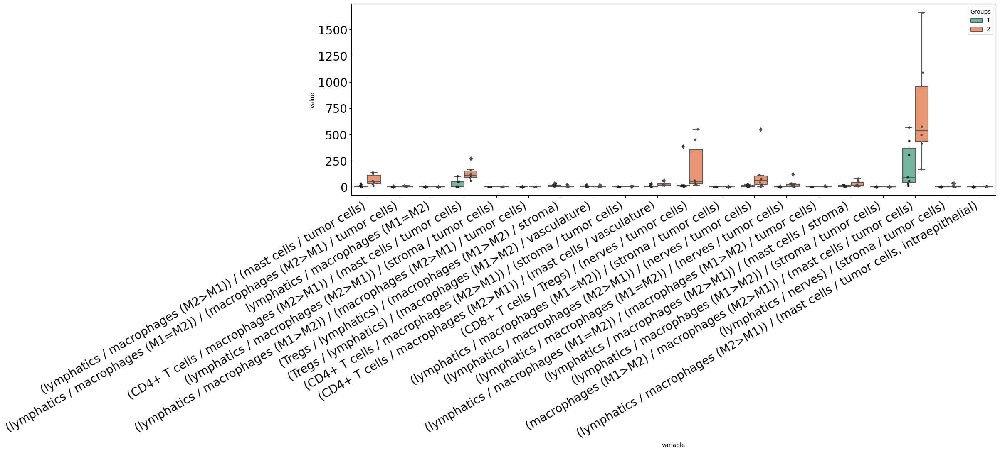

In [75]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

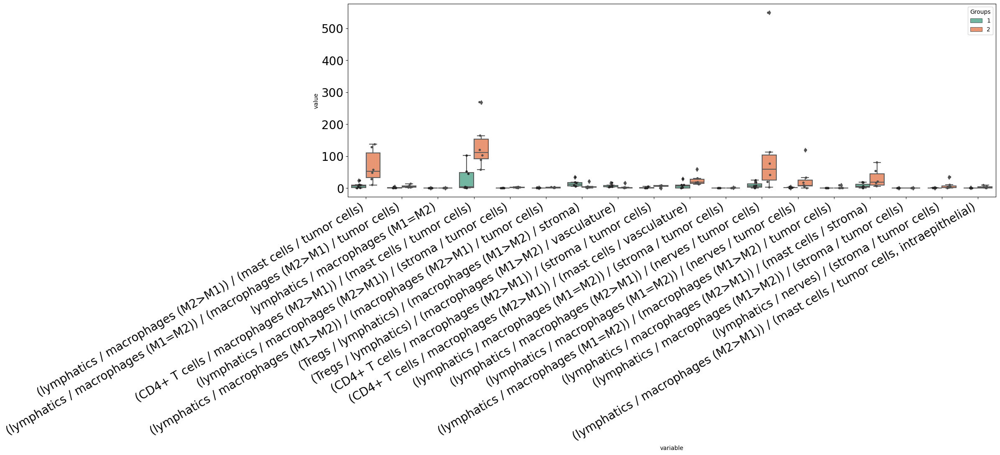

In [76]:
exclude_vars = [
    '(macrophages (M1>M2) / macrophages (M2>M1)) / (mast cells / tumor cells)',
    '(CD8+ T cells / Tregs) / (nerves / tumor cells)',
]
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    )

In [77]:
# we need to clean-up data for further analyses and visualizations
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 24017 non finite values (27.6%)
Imputing data


In [78]:
pvals = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [79]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected) after data imputation')

There are 260 significant variables (non corrected) after data imputation


In [80]:
pd.set_option('display.max_rows', None)
pvals.head(20)

,pval,pval_corr
(CD8+ T cells / mast cells) / (plasma cells / tumor cells),0.002331,0.635998
(lymphatics / macrophages (M1=M2)) / (plasma cells / tumor cells),0.002331,0.635998
lymphatics / macrophages (M1=M2),0.004079,0.635998
(lymphatics / mast cells) / (plasma cells / tumor cells),0.004079,0.635998
(CD4+ T cells / mast cells) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / macrophages (M1=M2)) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / mast cells) / (neutrophils / tumor cells),0.006993,0.635998
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.635998
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.011072,0.635998
(macrophages (M1>M2) / mast cells) / (plasma cells / tumor cells),0.011072,0.635998


In [81]:
pd.set_option('display.max_rows', 10)

There are 260 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

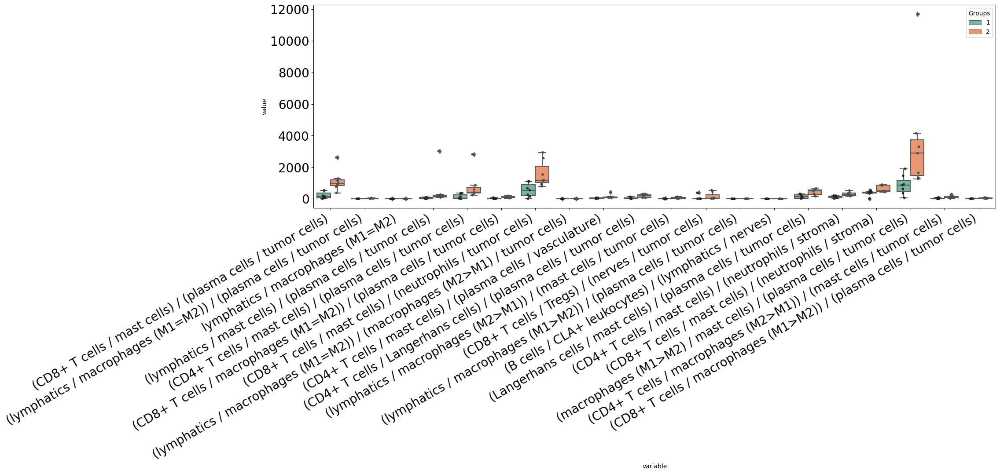

In [82]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

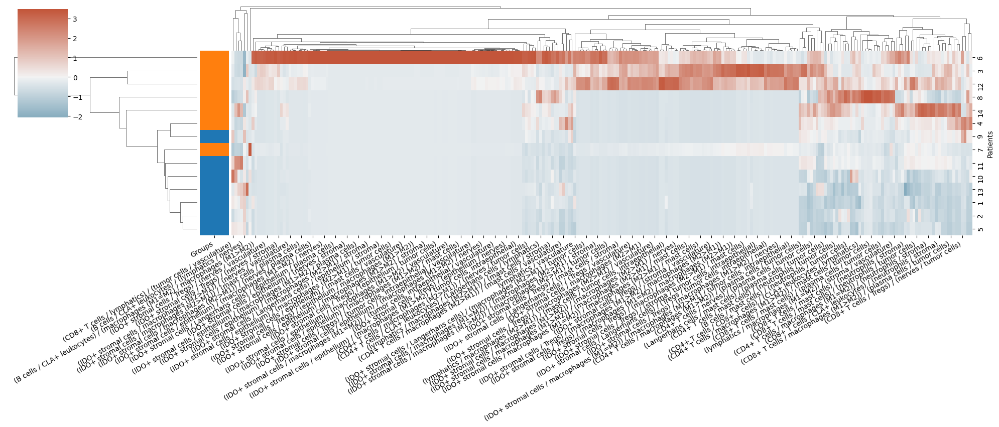

In [ ]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

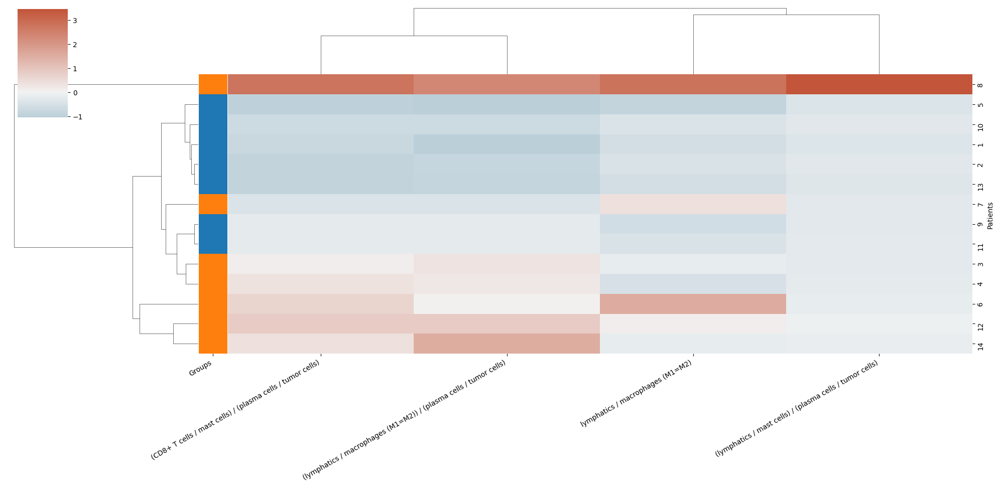

In [85]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(40).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

By selecting the variables with p-values under 5%, although their corresponding corrected p-values are not significant, we can notice a much better separation between patients groups.  
We must be careful though: we have computed a lot of composed variables, and selected those who happened to have the best p-values.

#### Stepwise logistic regression

In [86]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
model, included = mosna.stepwise_regression(X=prop_types_comp_cleaned, y_name=group_col, y_values=[1, 2], col_names=best_pval_names, verbose=True)

Add  (CD8+ T cells / macrophages (M1=M2)) / (plasma cells / tumor cells) with p-value 0.00290078
Add  lymphatics / macrophages (M1=M2) with p-value 0.00465832
Add  (macrophages (M1=M2) / macrophages (M1>M2)) / (tumor cells / vasculature) with p-value 0.0400989


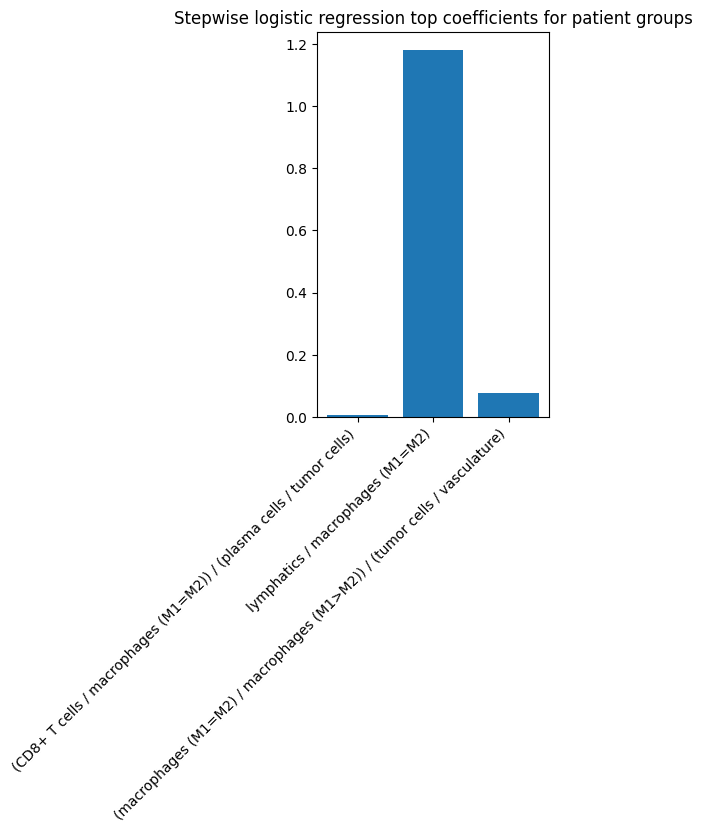

In [87]:
# plot the model's coefficients
coefs = model.params[1:] # skip intercept
nb_coefs = min(coefs.size, 20)
if nb_coefs > 0:
    fig, ax = plt.subplots(figsize=(nb_coefs,5))
    ax.bar(coefs.index, coefs)
    plt.xticks(rotation=45, ha='right');
    title = f"Stepwise logistic regression top coefficients for patient groups"
    plt.title(title)

Training took 3.398s


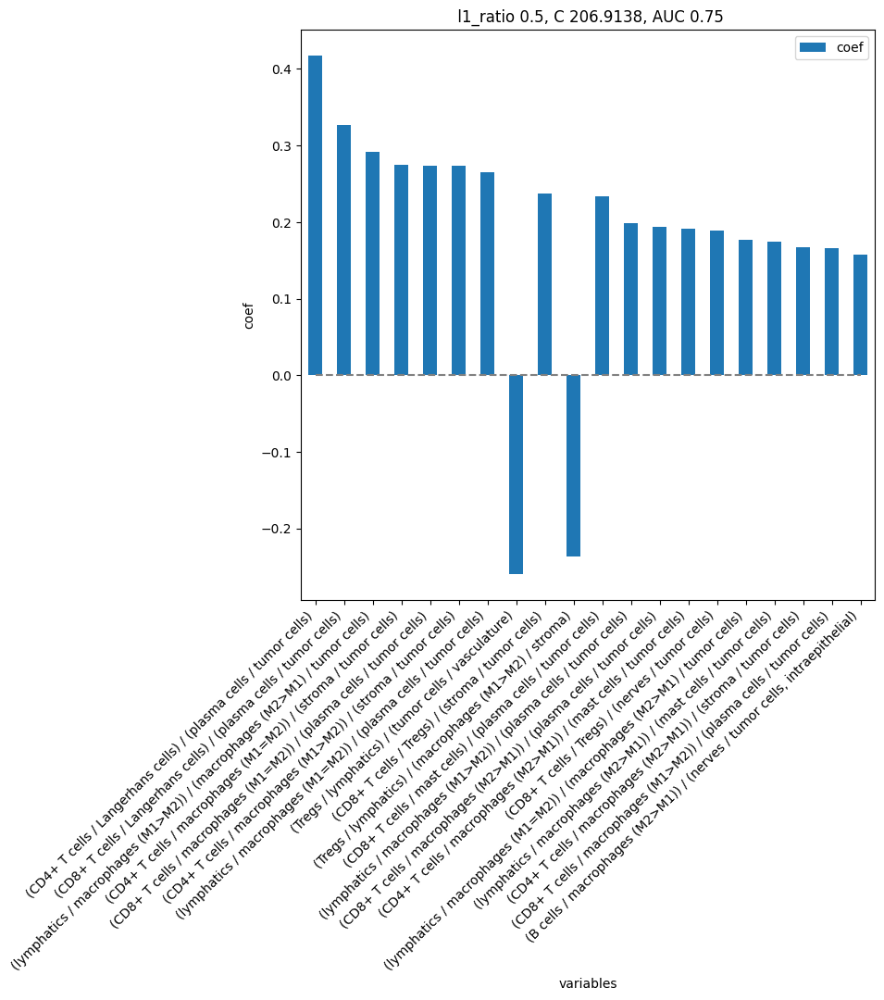

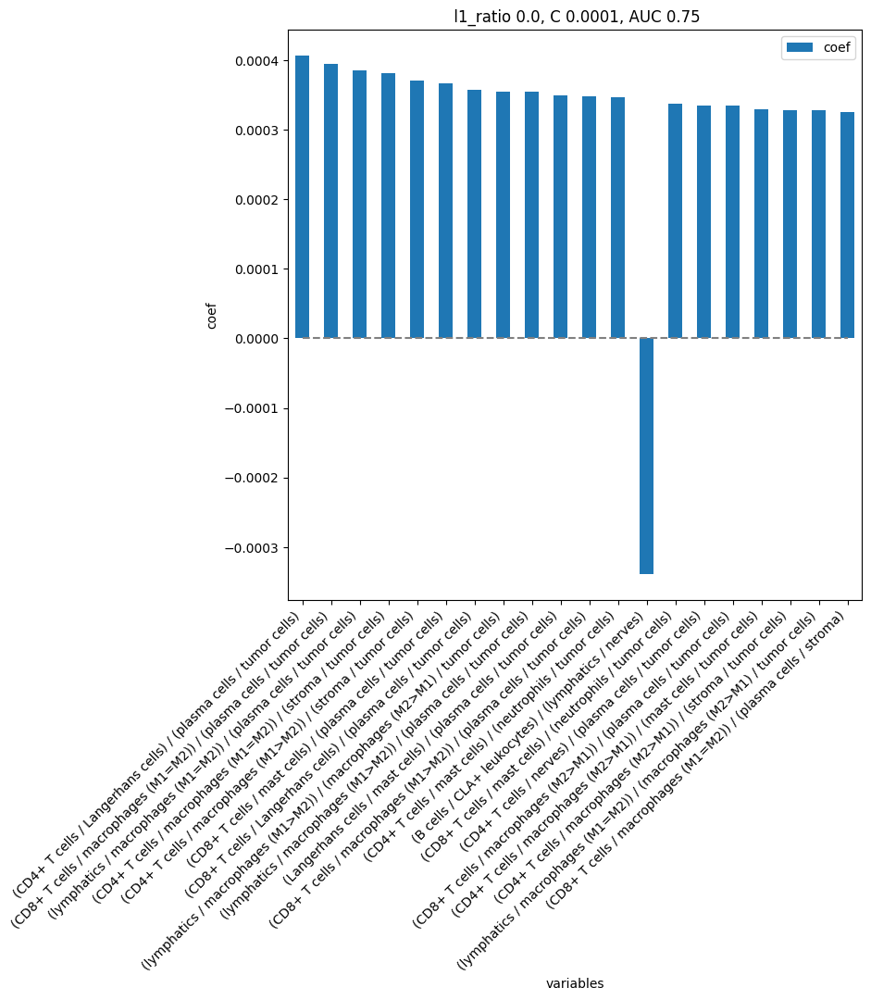

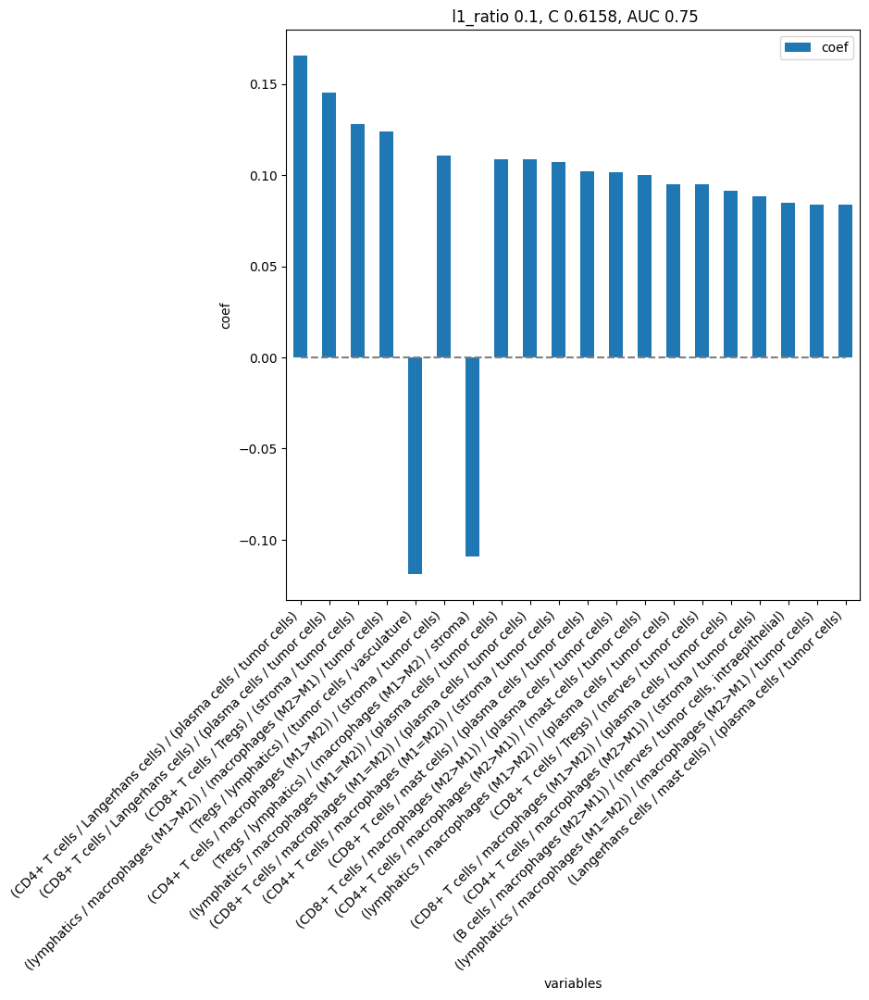

In [88]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [89]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index

In [90]:
model, included = mosna.stepwise_regression(X=prop_types_comp_cleaned, y_name=group_col, y_values=[1, 2], col_names=best_pval_names, verbose=True)

Add  (lymphatics / macrophages (M1=M2)) / (plasma cells / tumor cells) with p-value 0.00339158


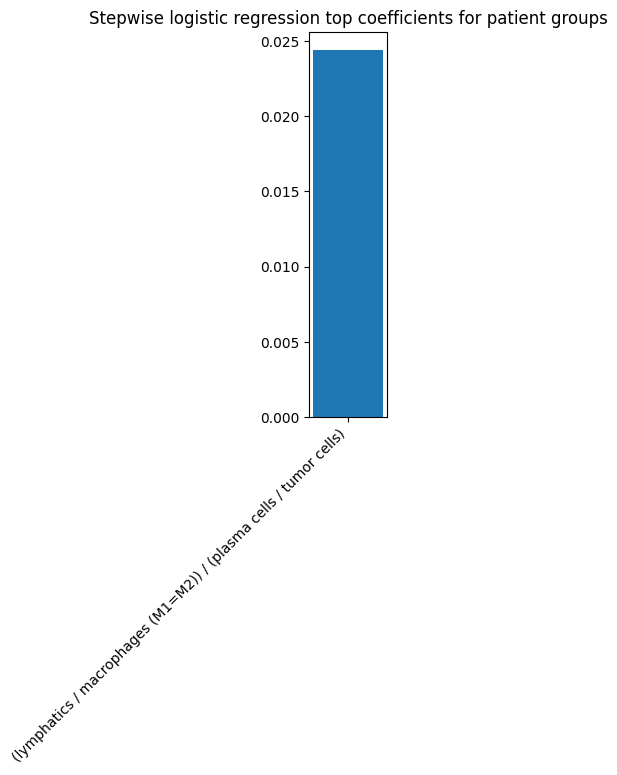

In [91]:
# plot the model's coefficients
coefs = model.params[1:] # skip intercept
nb_coefs = min(coefs.size, 20)
if nb_coefs > 0:
    fig, ax = plt.subplots(figsize=(nb_coefs,5))
    ax.bar(coefs.index, coefs)
    plt.xticks(rotation=45, ha='right');
    title = f"Stepwise logistic regression top coefficients for patient groups"
    plt.title(title)

Training took 2.348s


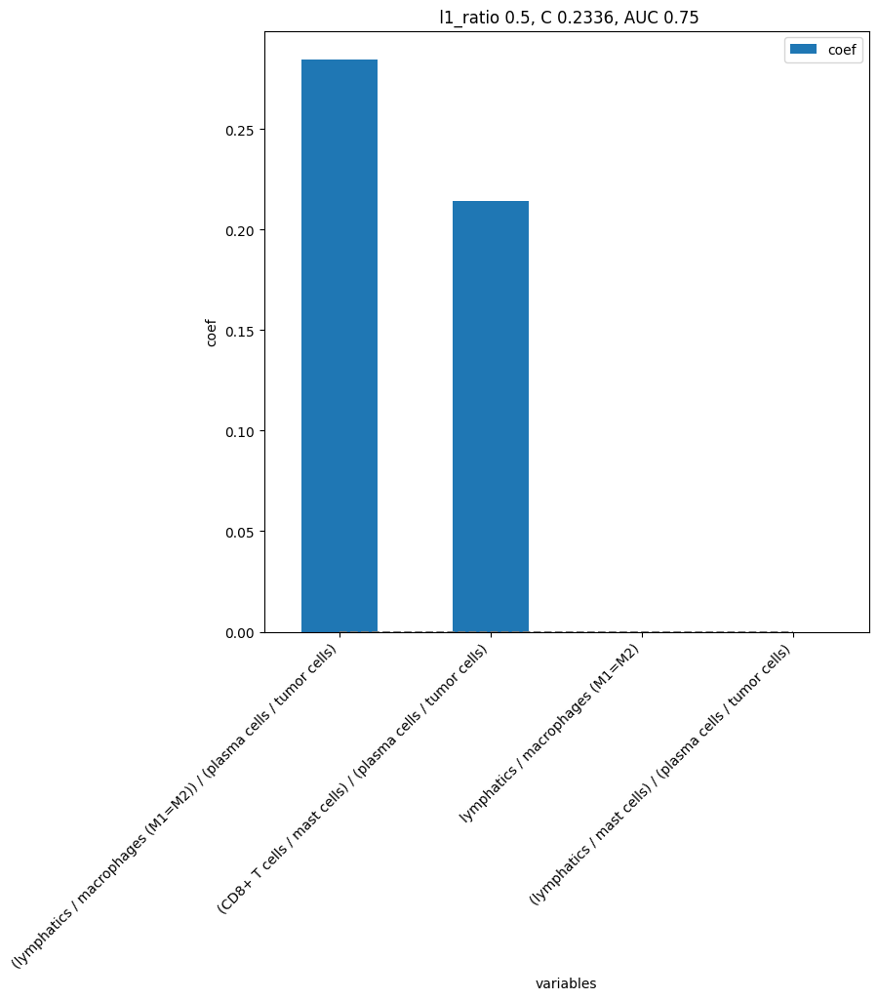

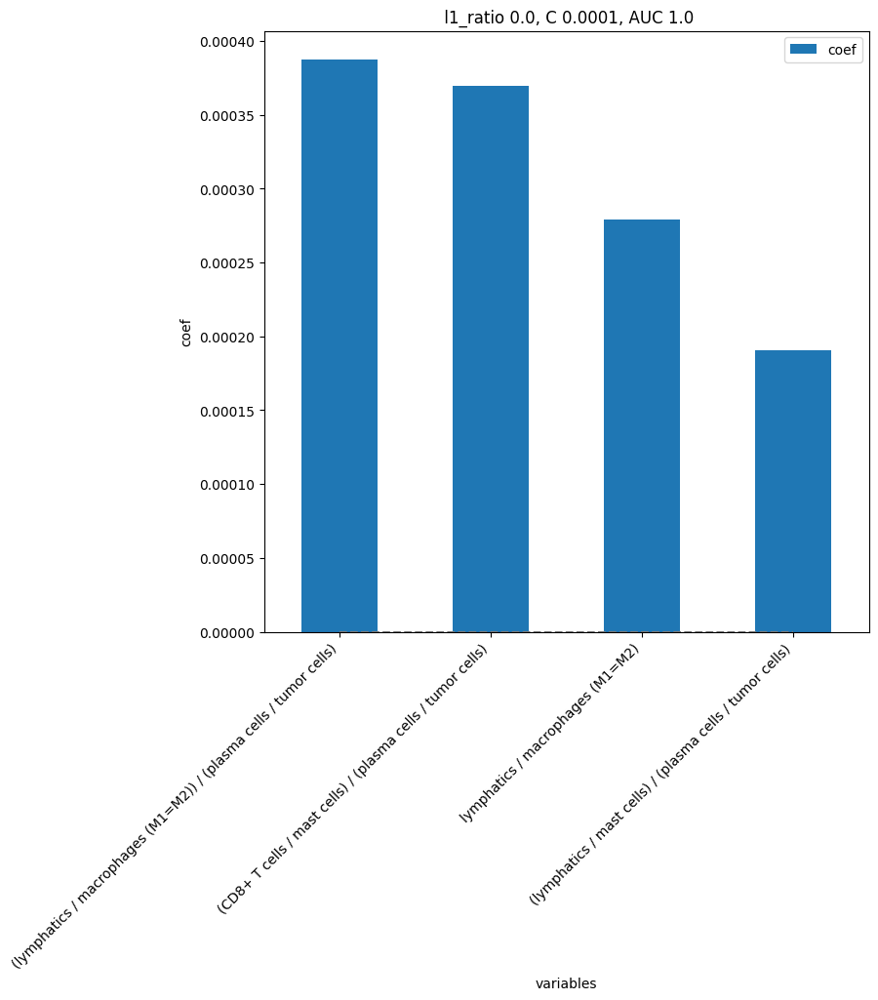

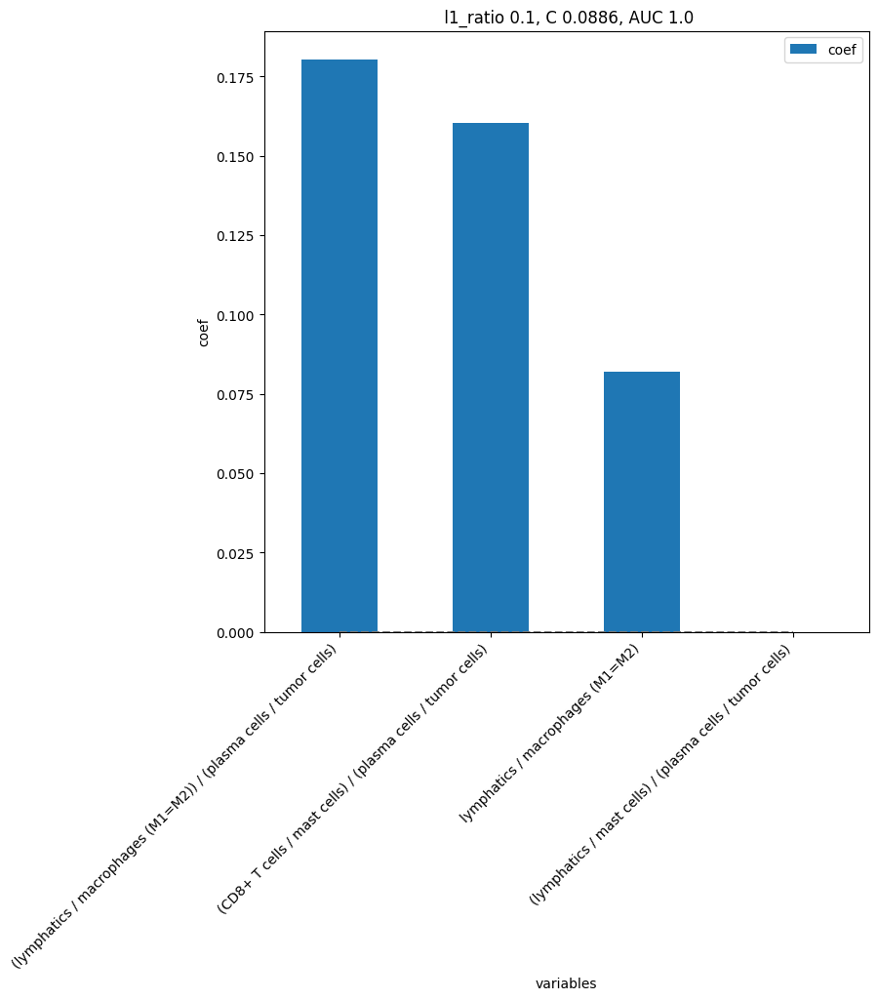

In [92]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Marker-positive cells proportions

In [93]:
def highlight_under(s, thresh=0.05, color='darkorange'):
    '''
    highlight values that are under a threshold
    '''
    is_under = s <= thresh
    attr = 'background-color: {}'.format(color)
    return [attr if v else '' for v in is_under]

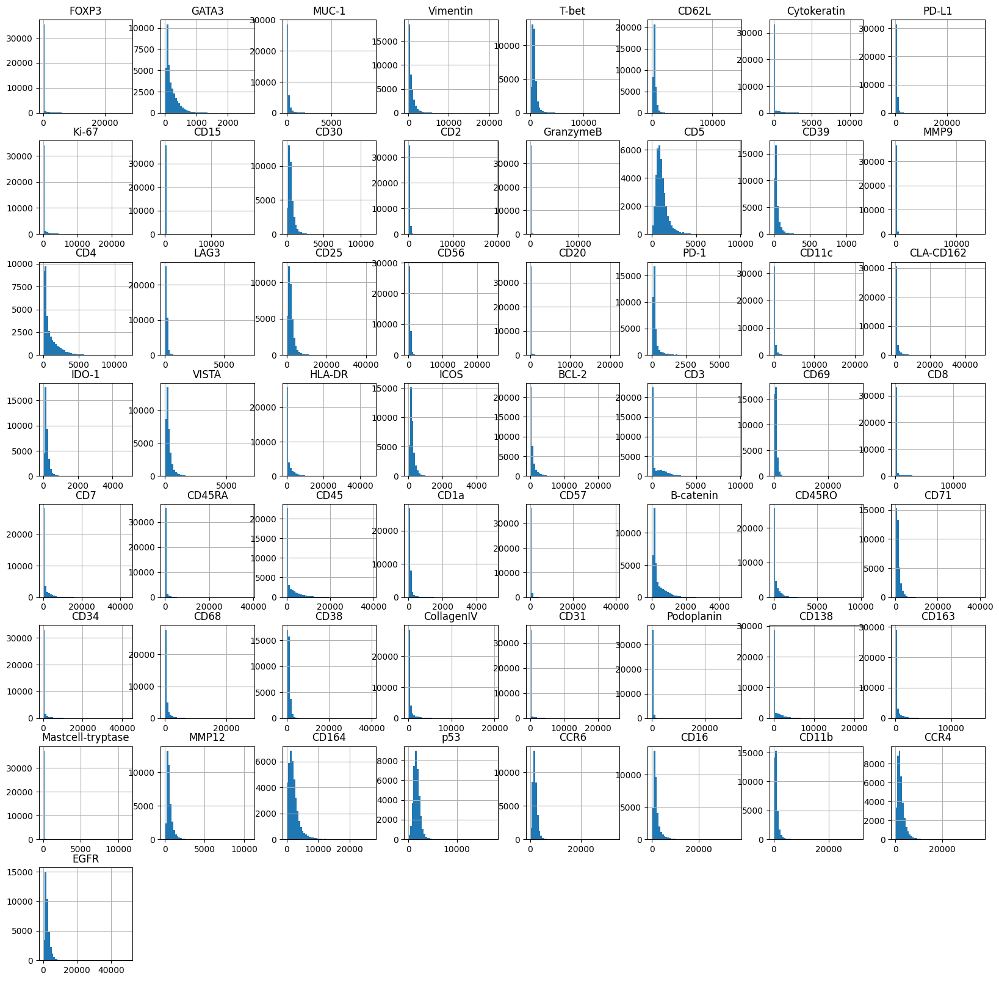

In [94]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

In [77]:
marker_thresh = {
    'FOXP3',
    'GATA3',
    'MUC-1',
    'Vimentin',
    'T-bet',
    'CD62L',
    'Cytokeratin',
    'PD-L1',
    'Ki-67',
    'CD15',
    'CD30',
    'CD2',
    'GranzymeB',
    'CD5',
    'CD39',
    'MMP9',
    'CD4',
    'LAG3',
    'CD25',
    'CD56',
    'CD20',
    'PD-1',
    'CD11c',
    'CLA-CD162',
    'IDO-1',
    'VISTA',
    'HLA-DR',
    'ICOS',
    'BCL-2',
    'CD3',
    'CD69',
    'CD8',
    'CD7',
    'CD45RA',
    'CD45',
    'CD1a',
    'CD57',
    'B-catenin',
    'CD45RO',
    'CD71',
    'CD34',
    'CD68',
    'CD38',
    'CollagenIV',
    'CD31',
    'Podoplanin',
    'CD138',
    'CD163',
    'Mastcell-tryptase',
    'MMP12',
    'CD164',
    'p53',
    'CCR6',
    'CD16',
    'CD11b',
    'CCR4',
    'EGFR'
}

In [78]:
# One needs to define a threshold for each marker, not done here.

We have seen that cell types proportions don't explain response of patient to therapy. But maybe interactions between cell types play a role in response?  
To answer this question we will look at the *mixing matrix* and *assortativity* of tissue networks.  

## Cell types interactions

We compute cell types interactions per sample to aggregate latter per patient or condition.

###  Assortativity and Mixing Matrix

#### Computation of assortativity

In [26]:
grouping = sample_col
n_shuffle = 500
load_dir = reconst_dir
save_dir = load_dir / "assortativity"
filename = save_dir / f'network_interactions_stats_grouping-{grouping}_n_shuffle-{n_shuffle}.csv'

if RUN_LONG or not filename.exists():
    print("Computing z-scored assortativity")
    start = time()
    net_stats = mosna.groups_assort_mixmat(
        net_dir=reconst_dir, 
        attributes_col=pheno_col, 
        make_onehot=False,
        id_level_1='patient',
        id_level_2='sample', 
        extension='parquet',
        n_shuffle=n_shuffle,
        parallel_groups='max',  # or False
        memory_limit='2 GB',
        save_intermediate_results=True)
    end = time()
    duration = end - start
    print(f"Assortativity took {duration:.3f}s for n_suffle {n_shuffle}")

    net_stats.index = net_stats['id']
    net_stats.drop(columns=['id'], inplace=True)

    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    net_stats.to_csv(filename)
else:
    print("Loading z-scored assortativity")
    net_stats = pd.read_csv(filename, index_col=0)

Loading z-scored assortativity


In [27]:
net_stats

,# total,% B cells,% CD4+ T cells,% CD8+ T cells,% Langerhans cells,% Tregs,% epithelium,% lymphatics,% macrophages (M1=M2),% macrophages (M1>M2),...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-9_sample-reg036,618,0.001618,0.006472,0.033981,0.003236,0.003236,0.021036,0.006472,0.064725,0.097087,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-3_sample-reg009,2334,0.000857,0.046701,0.048843,0.033419,0.022708,0.416881,0.002999,0.035990,0.105827,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg045,1914,0.005225,0.017241,0.037095,0.022466,0.063218,0.379833,0.007315,0.035005,0.088297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg058,1854,0.003776,0.009709,0.014563,0.012406,0.211435,0.242718,0.010248,0.047465,0.096009,...,2.057483,-0.204124,-0.238919,-0.100504,NaN,-0.063372,2.869998,-0.217731,-0.164895,-0.551677
patient-4_sample-reg013,1765,0.086686,0.008499,0.015864,0.003399,0.002833,0.265156,0.003966,0.027762,0.060623,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-9_sample-reg035,2053,0.000487,0.007306,0.014613,0.004384,0.003410,0.500731,NaN,0.013151,0.033609,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-11_sample-reg042,385,0.005195,NaN,0.005195,0.007792,0.010390,0.002597,0.007792,0.070130,0.023377,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-7_sample-reg025,144,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.020833,0.041667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg057,1166,0.006003,0.021441,0.066038,0.025729,0.202401,0.004288,0.001715,0.043739,0.110635,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Example of Mixing Matrix

In [28]:
sample_id = 'patient-1_sample-reg001'
raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
assort_raw = net_stats.loc[sample_id, "assort"]
assort_z = net_stats.loc[sample_id, "assort Z"]

# select_cols = np.logical_and(mixmat_raw.isna(axis=0) == 0, mixmat_z.isna(axis=0) == 0)

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


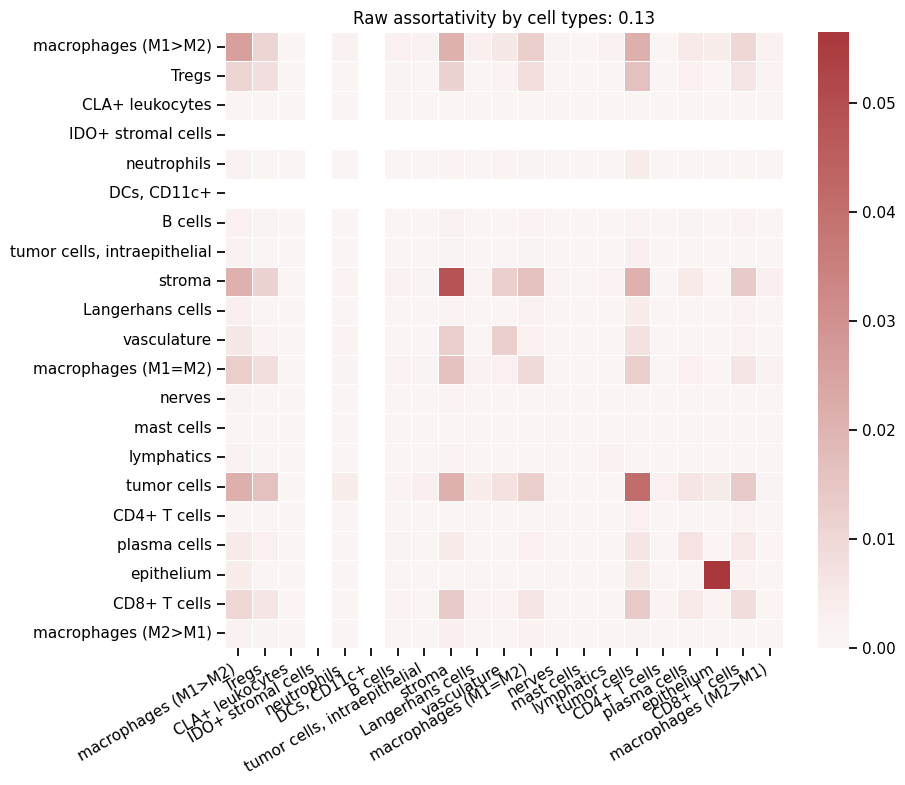

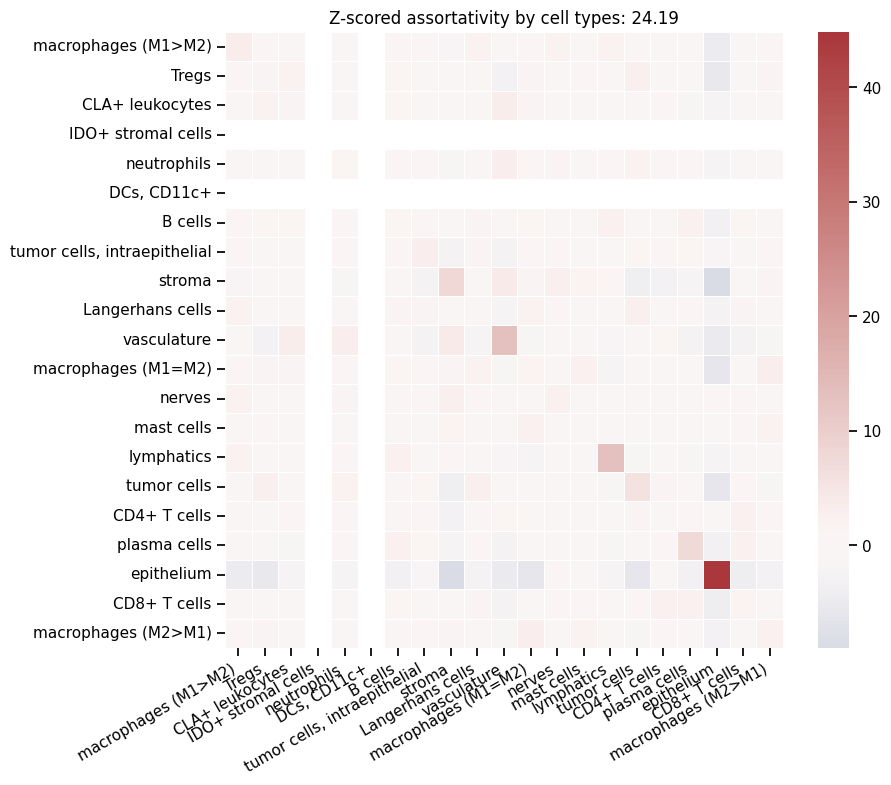

In [49]:
# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');
# plt.xticks(rotation=30, ha='right', fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}", bbox_inches='tight', facecolor='white')

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


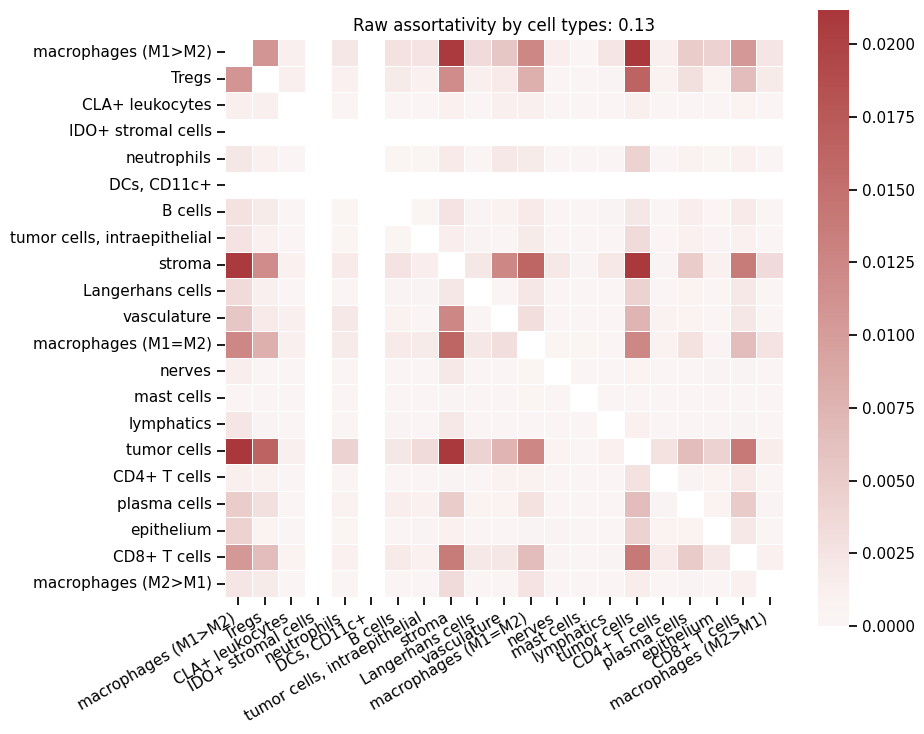

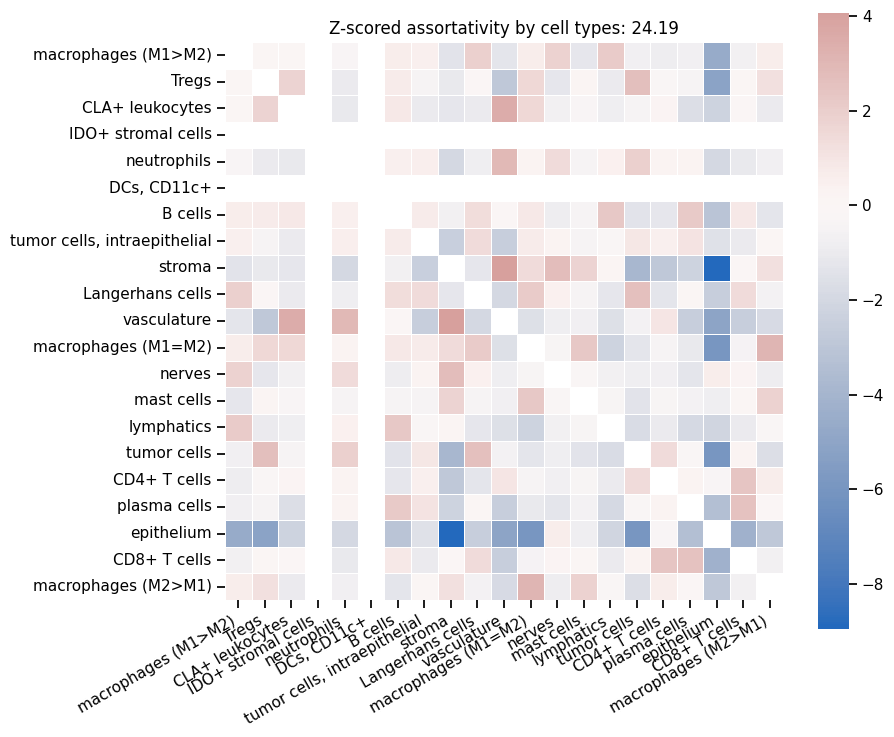

In [50]:
# Hide diagonal
# # Generate a mask for the upper triangle
# mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
# Generate a mask for the diagonal
mask = np.eye(mixmat_raw.shape[0], dtype=bool)

# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');#, fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

In [82]:
if RUN_LONG:
    for sample_id in net_stats.index:

        raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
        z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

        mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
        mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
        assort_raw = net_stats.loc[sample_id, "assort"]
        assort_z = net_stats.loc[sample_id, "assort Z"]

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');
        # plt.xticks(rotation=30, ha='right', fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}", bbox_inches='tight', facecolor='white')

        # Hide diagonal
        # # Generate a mask for the upper triangle
        # mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
        # Generate a mask for the diagonal
        mask = np.eye(mixmat_raw.shape[0], dtype=bool)

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');#, fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

After removing highly self-assortative cell-types, we can notice that ~~most cell types tend to avoid other cell types in this sample.~~

#### Assortativity and patients response

In [29]:
z_cols = [x for x in net_stats.columns if x.endswith('Z')]
z_net_stats = net_stats[z_cols]

In [30]:
z_net_stats

,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-9_sample-reg036,15.638028,NaN,-0.182989,-0.214535,2.094064,0.450974,1.776368,-0.100504,-0.243561,-0.554657,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-3_sample-reg009,51.712912,NaN,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,0.988686,1.971417,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg045,50.355990,2.611957,-1.003352,1.138473,-0.767088,2.832835,4.136948,1.719362,1.038611,4.048322,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg058,47.697650,-0.278960,-0.669385,0.683198,2.127269,1.286638,5.010030,0.882442,-1.222268,0.080840,...,2.057483,-0.204124,-0.238919,-0.100504,NaN,-0.063372,2.869998,-0.217731,-0.164895,-0.551677
patient-4_sample-reg013,58.109504,24.442070,1.563820,3.204244,-2.064984,0.585197,0.659895,0.794877,1.301955,0.737113,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-9_sample-reg035,53.465659,NaN,5.500000,-0.533023,-0.307967,0.615467,1.732717,-0.127515,-0.579873,2.696987,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-11_sample-reg042,8.247755,-0.089803,NaN,NaN,-0.224544,NaN,-0.077693,-0.283092,NaN,-0.295248,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-7_sample-reg025,12.633753,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg057,13.741738,2.459748,0.176978,-1.196626,1.022958,0.632521,1.641990,-1.035808,0.329421,0.029152,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [31]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
B cells - B cells Z                                   10
CD4+ T cells - B cells Z                              8
CD4+ T cells - CD4+ T cells Z                         6
CD8+ T cells - B cells Z                              7
CD8+ T cells - CD4+ T cells Z                         6
CD8+ T cells - CD8+ T cells Z                         5
Langerhans cells - B cells Z                          7
Langerhans cells - CD4+ T cells Z                     6
Langerhans cells - CD8+ T cells Z                     4
Langerhans cells - Langerhans cells Z                 4
Tregs - B cells Z                                     7
Tregs - CD4+ T cells Z                                6
Tregs - CD8+ T cells Z                                4
Tregs - Langerhans cells Z                            3
Tregs - Tregs Z                                       4
epithelium - B cells Z                                7
epithelium - CD4+ T cells Z                    

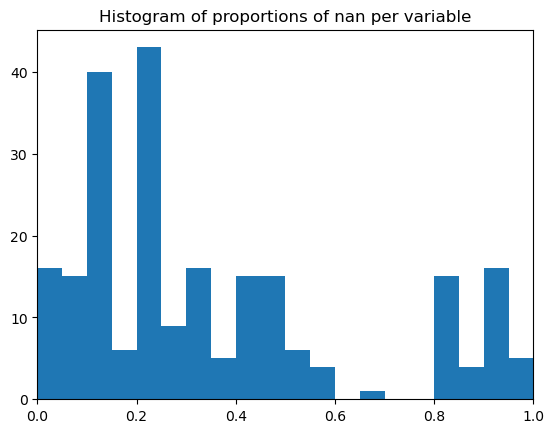

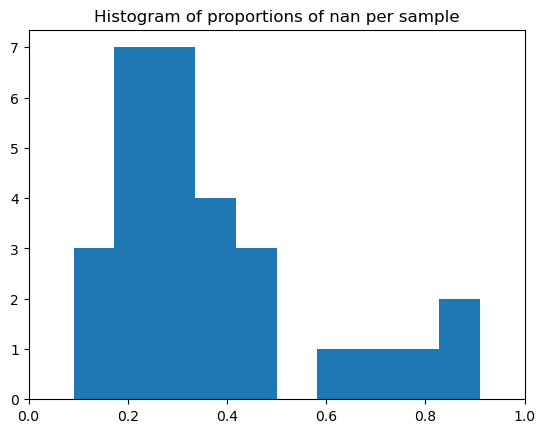

In [32]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

There are some nan values due to interactions between rare cell types that never happened.  
We can have a first look at the sample, but it would be more informative to have a look at samples before therapy, grouping them per patient.

Before dropping variables z_net_stats shape: (29, 231)
There are 2373 non finite values (35.4%)
Final z_net_stats shape: (29, 150)
There are 81 variables discarded


/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py:2536: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[to_nan] = np.nan
/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py:2536: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[to_nan] = np.nan


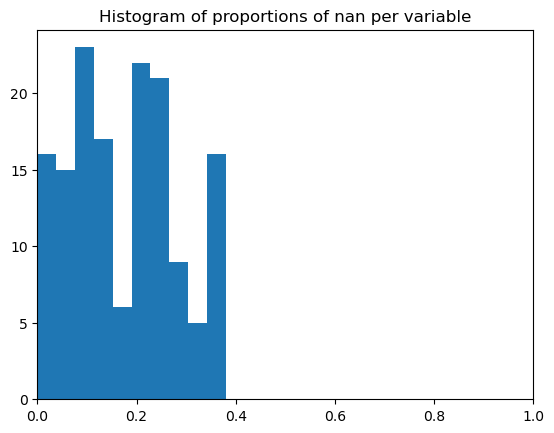

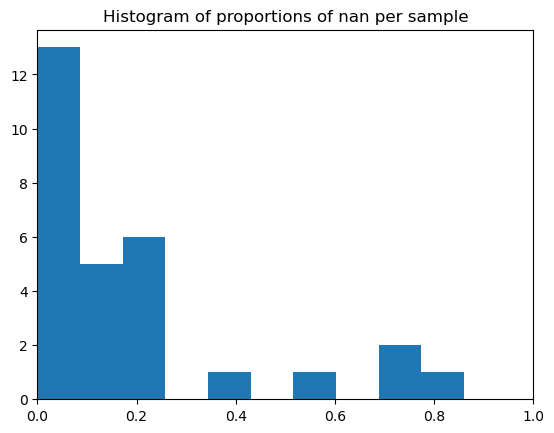

In [33]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (29, 150)
There are 760 non finite values (17.5%)
Final z_net_stats shape: (25, 150)
There are 4 observations discarded


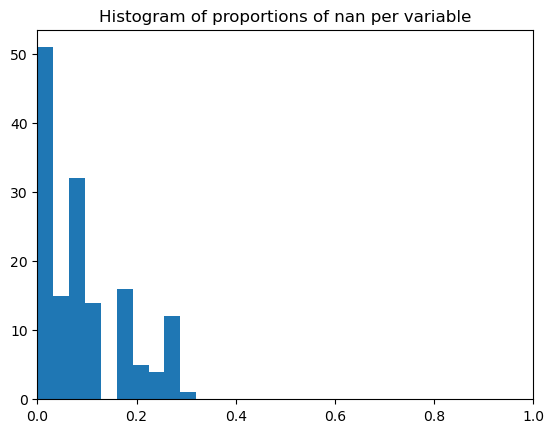

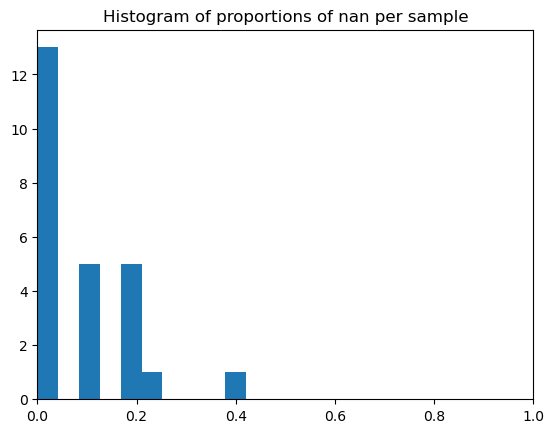

In [34]:
print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [35]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 326 non finite values (8.7%)
Imputing data
Final z_net_stats shape: (25, 150)


In [36]:
# Add back patient id to the network stats dataframe
def parse_patient(s):
    return s.split('_')[0][8:]

# if patient_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[patient_col] = [parse_patient(s) for s in z_net_stats_cleaned.index]

# Add back sample id to the network stats dataframe
def parse_sample(s):
    return s.split('_')[1][7:]

# if sample_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[sample_col] = [parse_sample(s) for s in z_net_stats_cleaned.index]
# z_net_stats_cleaned.index = z_net_stats_cleaned[sample_col]

z_net_stats_cleaned.index = [parse_sample(s) for s in z_net_stats_cleaned.index]
z_net_stats_cleaned.index.name = sample_col


In [37]:
z_net_stats_cleaned

,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"tumor cells, intraepithelial - macrophages (M1=M2) Z","tumor cells, intraepithelial - macrophages (M1>M2) Z","tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg036,15.638028,0.131967,-0.182989,-0.214535,2.094064,0.450974,1.776368,-0.100504,-0.243561,-0.554657,...,-0.289486,0.152593,-0.162248,0.062686,0.850648,-0.569690,0.665444,-0.058831,-1.108444,-1.191784
reg009,51.712912,3.912258,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,0.988686,1.971417,...,-0.475406,0.600099,0.714401,2.239859,0.731007,-1.368285,-0.088305,1.044084,-0.526157,-2.004947
reg045,50.355990,2.611957,-1.003352,1.138473,-0.767088,2.832835,4.136948,1.719362,1.038611,4.048322,...,0.026618,1.255740,0.494464,1.097072,-0.414425,0.240981,1.275797,0.826754,-0.853301,-0.689825
reg058,47.697650,-0.278960,-0.669385,0.683198,2.127269,1.286638,5.010030,0.882442,-1.222268,0.080840,...,0.329180,-0.658858,4.209120,-0.575594,-0.225245,-1.518278,1.187869,-0.238919,-0.790011,-1.377108
reg013,58.109504,24.442070,1.563820,3.204244,-2.064984,0.585197,0.659895,0.794877,1.301955,0.737113,...,-0.609476,-0.855012,-0.163383,-0.142857,6.377042,-0.322816,0.920843,-0.044766,1.027835,-0.831252
reg035,53.465659,7.317220,5.500000,-0.533023,-0.307967,0.615467,1.732717,-0.127515,-0.579873,2.696987,...,-0.909521,-0.850725,-0.363147,3.177501,-0.261488,-0.898369,1.274220,-0.408593,0.029092,-1.755144
reg042,8.247755,-0.089803,-0.467320,-0.607168,-0.224544,0.824221,-0.077693,-0.283092,0.175106,-0.295248,...,1.644815,1.772233,-0.513469,0.500880,4.269750,-0.649670,-0.924298,-0.100504,-1.124196,-1.824518
reg057,13.741738,2.459748,0.176978,-1.196626,1.022958,0.632521,1.641990,-1.035808,0.329421,0.029152,...,-0.823482,0.881107,-0.377021,-0.367549,-0.278543,-1.306101,0.702282,-0.127515,1.111154,-1.131704
reg051,45.689836,-0.089803,-0.480017,1.130731,-0.335480,0.881702,1.426758,1.651555,1.103344,-0.199095,...,0.105164,-0.145020,-0.508913,-0.555348,-0.348209,2.021777,-1.710073,12.930318,1.007051,-2.000002


Let's add information about patients' group and time of biopsy

In [38]:
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'
if 'Count' in status.columns:
    status = status.drop(columns=['Count'])
# status.sort_values('Spots')
status

,Patients,Groups,Spots
id,,,
reg001,1,1,1
reg002,1,1,2
reg005,2,1,5
reg006,2,1,6
reg009,3,2,9
reg010,3,2,10
reg013,4,2,13
reg014,4,2,14
reg017,5,1,17


In [39]:
# pd.set_option('display.max_rows', 10)
# reg026 and reg044 not in biopsies
z_net_stats_cleaned = pd.concat([status, z_net_stats_cleaned], axis=1, join='inner')#.sort_values('Spots')
z_net_stats_cleaned.drop(columns=['Spots'], inplace=True)
z_net_stats_cleaned.index.name = sample_col
z_net_stats_cleaned

,Patients,Groups,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,...,"tumor cells, intraepithelial - macrophages (M1=M2) Z","tumor cells, intraepithelial - macrophages (M1>M2) Z","tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,1.134907,-1.243968,-0.678786,0.860589,2.366711,1.573080,1.344357,...,0.712619,0.517322,0.123441,-0.435376,0.319161,-2.445261,0.956805,2.924093,-2.501314,-2.493605
reg002,1,1,12.379904,-0.375650,3.270044,1.400757,-1.251090,2.228154,2.902544,-0.681232,...,-0.344178,0.343373,-0.958725,0.926844,-0.435887,-1.202350,1.153567,0.314647,-0.805019,-1.460195
reg006,2,1,15.343623,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,...,-0.928841,-1.202189,0.067444,-0.156813,-0.349295,0.966901,0.291703,-0.044766,-0.569737,-0.998532
reg009,3,2,51.712912,3.912258,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,...,-0.475406,0.600099,0.714401,2.239859,0.731007,-1.368285,-0.088305,1.044084,-0.526157,-2.004947
reg010,3,2,52.830785,3.925074,-0.593397,8.865137,0.775713,-2.957335,8.063748,0.424438,...,0.158983,-0.420327,-1.195581,1.112205,-2.063254,-2.116539,0.419101,4.894248,0.622160,0.823554
reg013,4,2,58.109504,24.442070,1.563820,3.204244,-2.064984,0.585197,0.659895,0.794877,...,-0.609476,-0.855012,-0.163383,-0.142857,6.377042,-0.322816,0.920843,-0.044766,1.027835,-0.831252
reg014,4,2,46.301606,7.596524,-0.754354,-0.214535,-0.647140,1.039422,-0.777722,-0.991045,...,-0.754356,1.654233,-0.280056,-0.292233,-0.135388,-0.547611,-1.195504,-0.110208,-0.610361,-1.069354
reg017,5,1,21.926923,1.463436,0.477203,-0.173433,0.176602,0.849947,1.704590,0.023348,...,-0.127515,2.936303,-0.142857,-0.089803,-0.100504,-0.366608,-0.224544,0.011019,-1.097543,3.219609
reg021,6,2,15.761557,1.775415,-0.325513,0.358437,3.477269,-0.143025,3.822918,1.732606,...,-0.880157,0.416937,0.435821,-0.538538,-0.361538,-2.842627,3.213455,-0.370250,-1.786568,-1.661358


In [40]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.drop(columns=[patient_col]), group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [41]:
pd.set_option('display.max_rows', None)
pvals.loc[pvals['pval'] < 0.05, :]

,pval,pval_corr
vasculature - vasculature Z,0.000999,0.149872
lymphatics - B cells Z,0.008338,0.625378
nerves - CD4+ T cells Z,0.023989,0.897791
macrophages (M1=M2) - lymphatics Z,0.047107,0.897791
"tumor cells, intraepithelial - B cells Z",0.047107,0.897791


In [42]:
pd.set_option('display.max_rows', 10)

There are 5 significant variables in `pval`


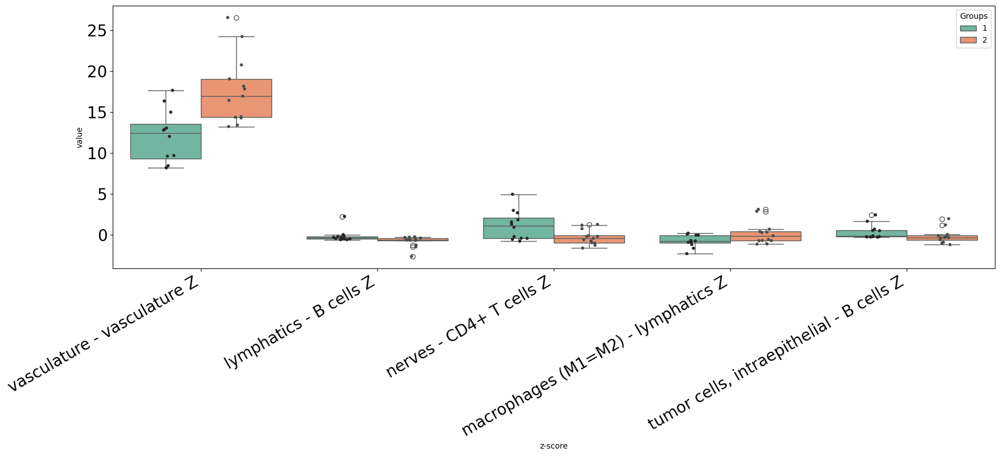

In [43]:
reload(mosna)
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 5 significant variables in `pval`


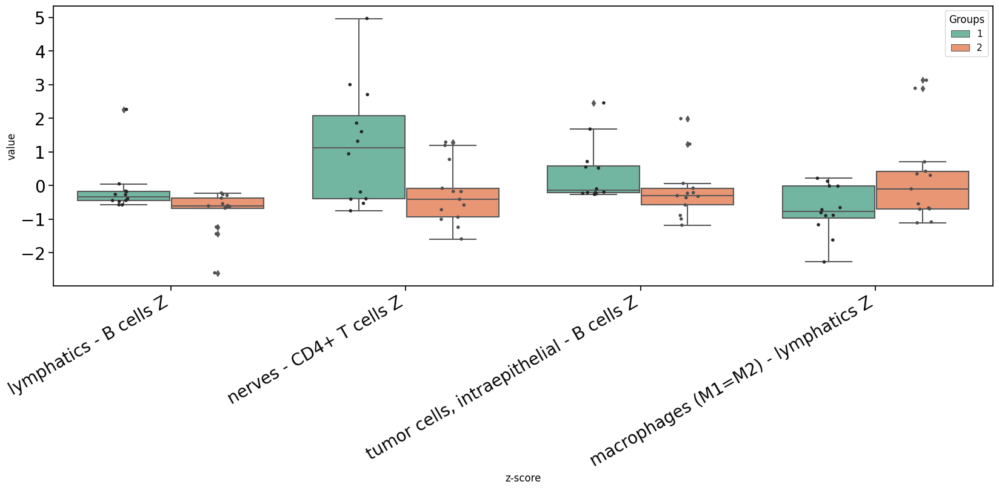

In [98]:
exclude_vars = [
    # 'assort Z',
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'tumor cells - tumor cells Z',
]
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    exclude_vars=exclude_vars,
    )

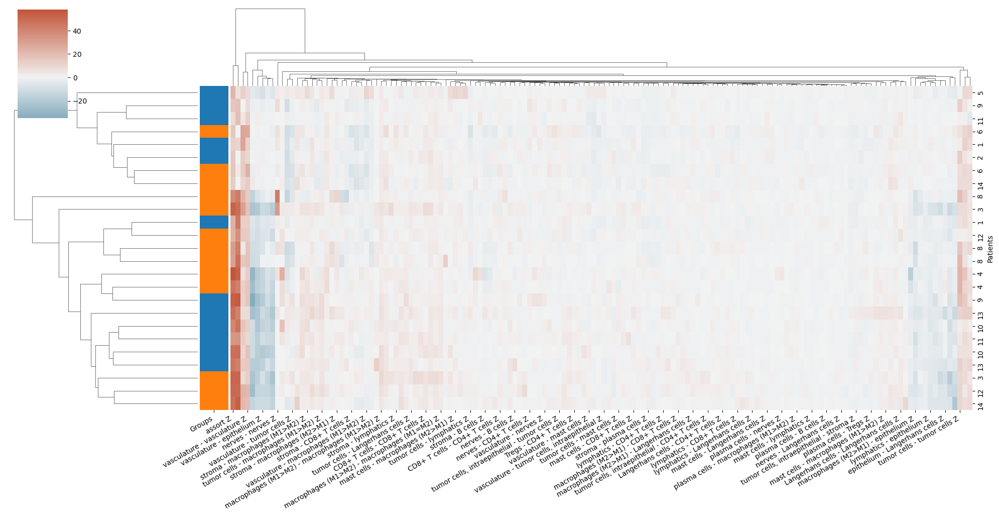

In [44]:
mosna.plot_heatmap(
    z_net_stats_cleaned, 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=None,
    )

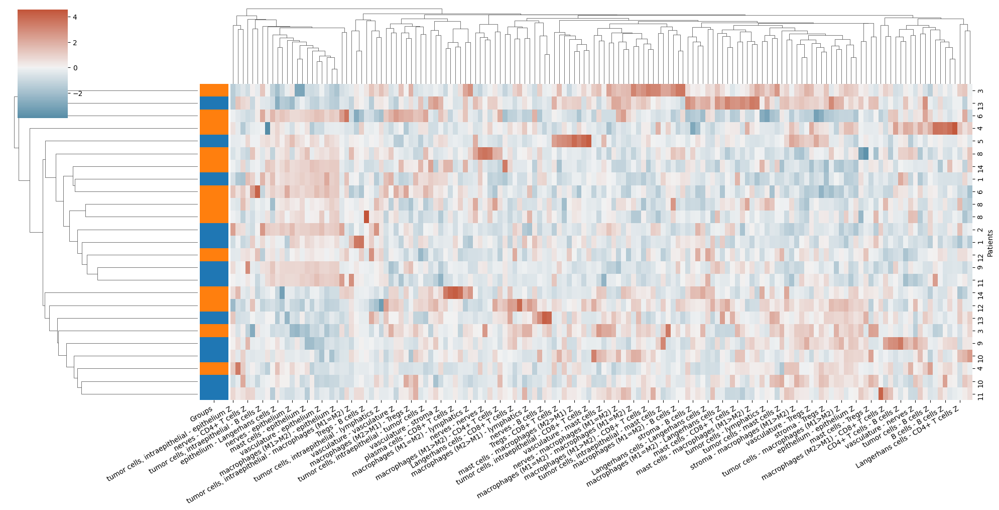

In [45]:
mosna.plot_heatmap(
    z_net_stats_cleaned, 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=1,
    )

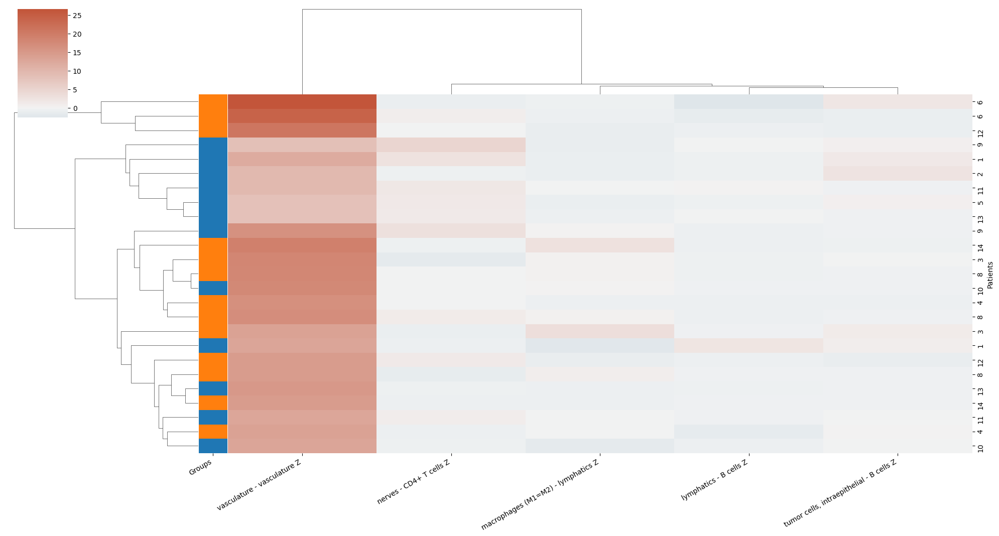

In [46]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names+[patient_col, group_col]], 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=None,
    )

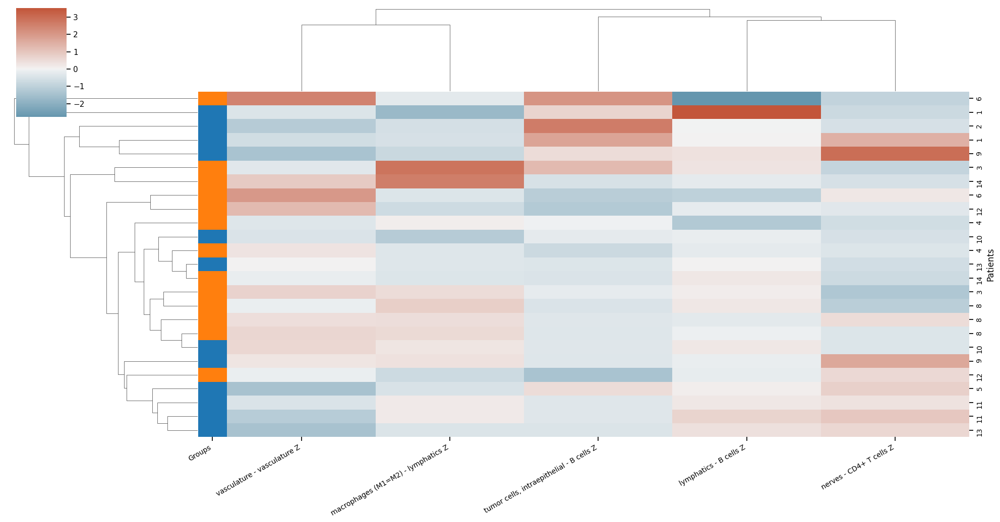

In [100]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names+[patient_col, group_col]], 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=1,
    )

Samples are a bit clustered into consistent response groups, but it's not incredible.  
We also need to aggregate samples per patient and time of biopsy, that may help us correcting nan values and have more variables, and hopefully better clusters.

Add  vasculature - vasculature Z    with p-value 0.000936515
Add  plasma cells - macrophages (M2>M1) Z with p-value 0.00738462
Add  nerves - lymphatics Z          with p-value 0.0134141
Add  CD4+ T cells - B cells Z       with p-value 0.0381359
Add  nerves - nerves Z              with p-value 0.0294015
Add  nerves - mast cells Z          with p-value 0.0444677
Add  tumor cells, intraepithelial - nerves Z with p-value 0.0328883
Add  macrophages (M1>M2) - Langerhans cells Z with p-value 0.00242144
Add  macrophages (M1=M2) - lymphatics Z with p-value 0.0174235
Add  plasma cells - Tregs Z         with p-value 0.00151102
Add  plasma cells - macrophages (M1>M2) Z with p-value 0.00203987
Add  stroma - stroma Z              with p-value 0.00588139
Add  vasculature - lymphatics Z     with p-value 0.0200843
Add  tumor cells, intraepithelial - mast cells Z with p-value 0.0310926
Add  Tregs - Langerhans cells Z     with p-value 0.0303868
Add  B cells - B cells Z            with p-value 0.00883024


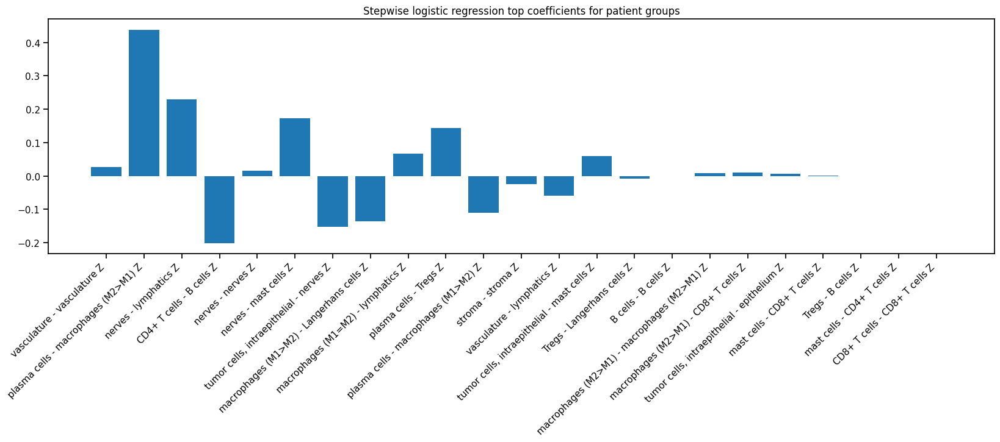

In [103]:
# Stepwise logistic regression
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
if len(best_pval_names) > 0:
    model, included = mosna.stepwise_regression(X=z_net_stats_cleaned, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no interaction statistically related to response group")

In [104]:
z_net_stats_cleaned

,Patients,Groups,assort Z,Langerhans cells - Langerhans cells Z,lymphatics - Langerhans cells Z,lymphatics - lymphatics Z,macrophages (M1=M2) - Langerhans cells Z,macrophages (M1=M2) - lymphatics Z,macrophages (M1=M2) - macrophages (M1=M2) Z,macrophages (M1>M2) - Langerhans cells Z,...,"tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - B cells Z,vasculature - CD4+ T cells Z,vasculature - CD8+ T cells Z,vasculature - Tregs Z,vasculature - epithelium Z,vasculature - macrophages (M2>M1) Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,0.064685,-1.204341,13.084341,2.130628,-2.278864,1.724607,1.919980,...,0.956805,2.924093,-0.053861,0.978381,-2.572324,-2.928686,-5.059101,-1.866915,-2.501314,-2.493605
reg002,1,1,12.379904,0.808659,-0.617620,28.984539,-0.662931,-0.888859,0.452411,-1.363191,...,1.153567,0.314647,-1.620119,-1.479601,-1.859212,-3.962437,-1.193311,-3.223470,-0.805019,-1.460195
reg006,2,1,15.343623,-0.822662,-0.701849,13.168209,0.198415,-0.899198,1.762285,1.320380,...,0.291703,-0.044766,1.913030,1.523492,-1.503655,-0.614116,1.721969,-2.610209,-0.569737,-0.998532
reg009,3,2,51.712912,2.640220,1.667876,9.131471,1.312624,3.134758,7.702667,3.821567,...,-0.088305,1.044084,-0.363300,-0.194533,0.082381,2.364643,-8.688610,-1.223229,-0.526157,-2.004947
reg010,3,2,52.830785,0.175189,0.408794,29.602263,-1.031822,0.345961,1.832072,2.172986,...,0.419101,4.894248,-0.690999,2.731313,-0.582251,2.137763,-11.914736,-1.807364,0.622160,0.823554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,12,2,23.398796,5.569688,-0.861886,15.175724,-0.942157,-1.113342,1.626789,-1.952067,...,-1.621342,-0.012179,2.308891,0.408548,0.686651,-1.841824,-7.172598,-1.480855,-0.300474,0.704778
reg051,13,1,45.689836,2.660568,-0.465422,14.364944,4.175846,-0.660600,1.340313,2.463355,...,-1.710073,12.930318,-0.948478,-0.853378,-0.068100,-1.427852,-16.480729,1.455278,1.007051,-2.000002
reg052,13,1,47.704148,5.307921,0.972203,7.842194,3.787816,-0.722978,3.343262,3.795563,...,-0.711130,-0.368761,1.489903,3.136896,1.028965,0.761823,-12.058906,2.079811,-0.383893,0.352221


        training failed
        training failed with cv <= 5
Training took 3.435s


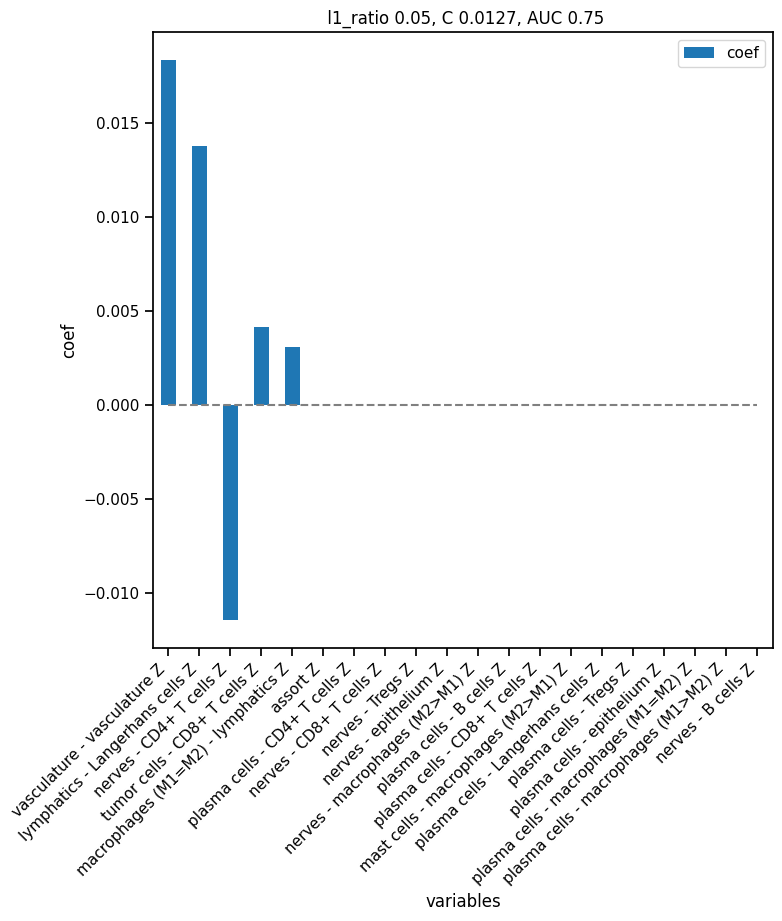

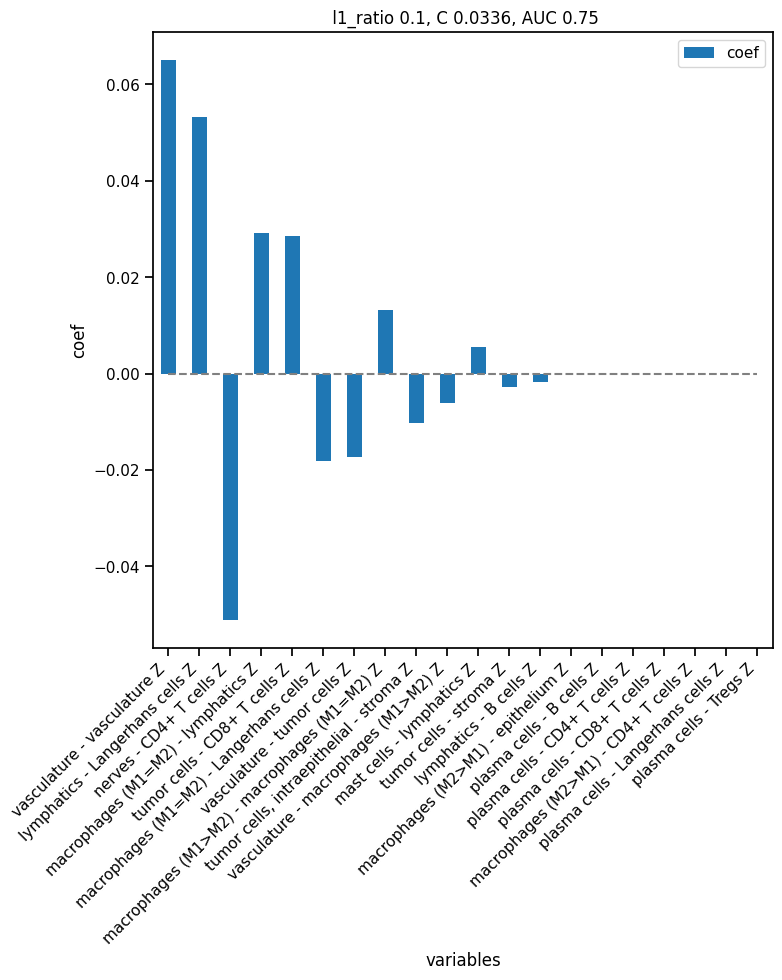

In [106]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[sample_col, patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [107]:
best_pval_names

['vasculature - vasculature Z',
 'lymphatics - B cells Z',
 'nerves - CD4+ T cells Z',
 'tumor cells, intraepithelial - B cells Z',
 'macrophages (M1=M2) - lymphatics Z']

Training took 2.393s


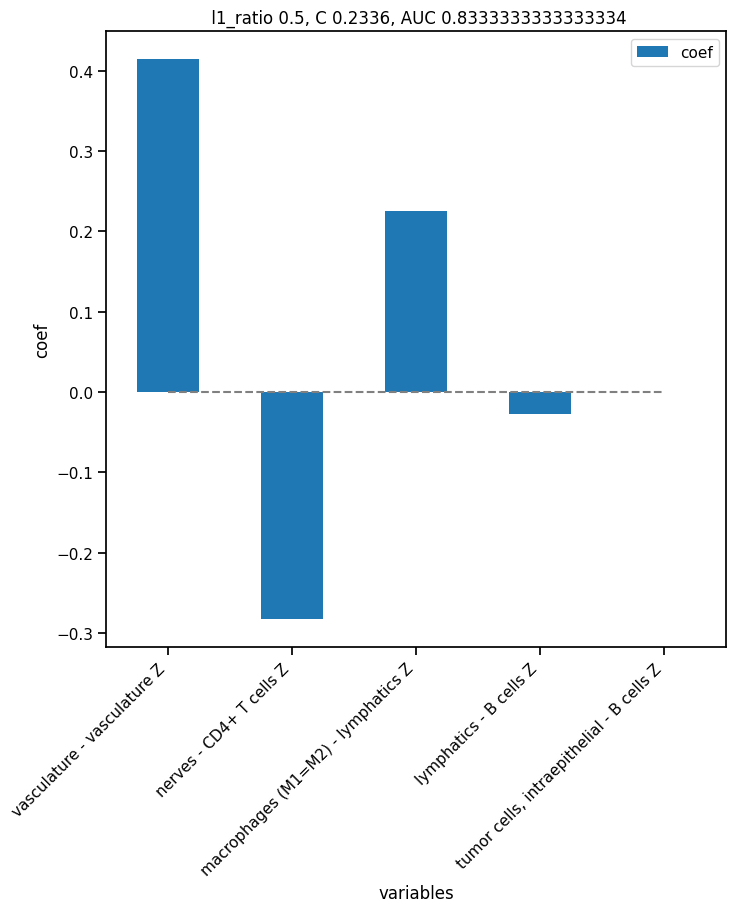

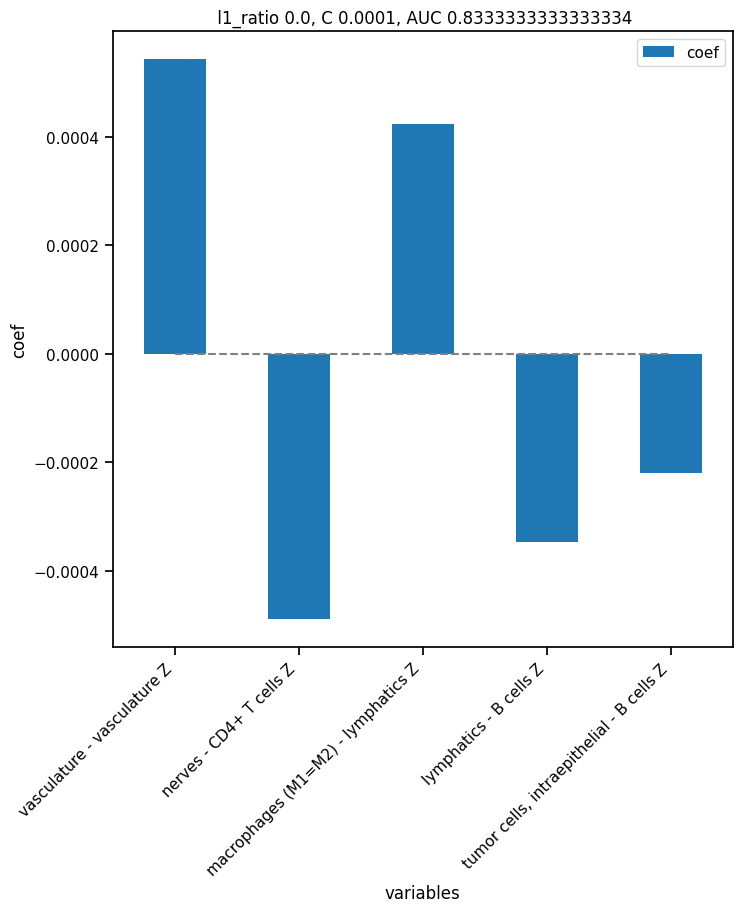

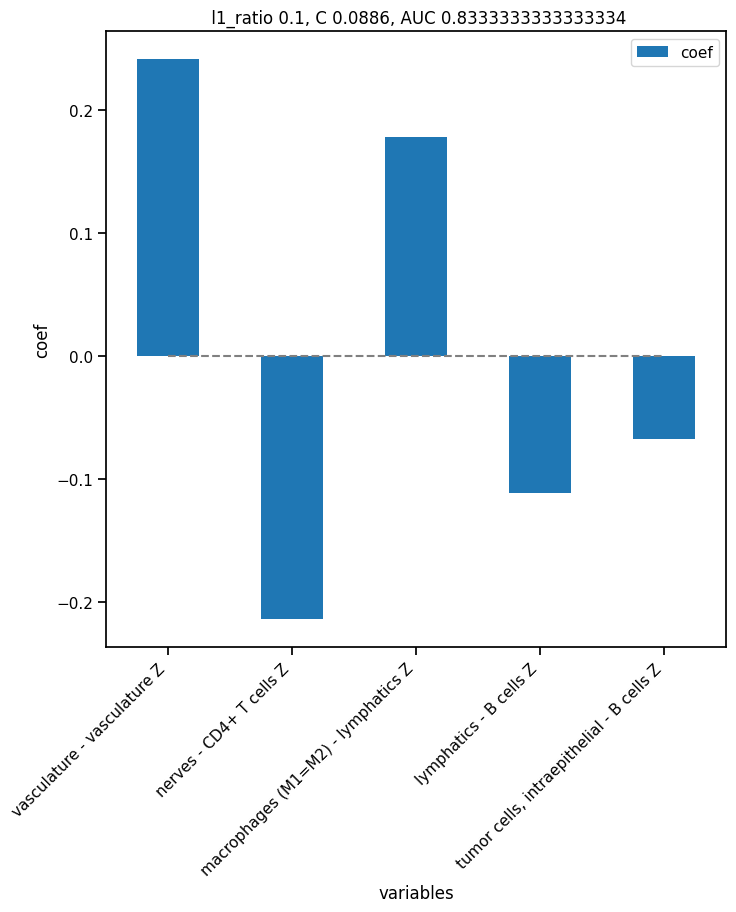

In [108]:
# columns = [
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'neutrophils - neutrophils Z', 
# ]

models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names + [group_col]],
    y_name=group_col,
    col_drop=[sample_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

#### Samples aggregation per patient and time point.

In [56]:
z_net_stats = net_stats[z_cols]
z_net_stats.index = [parse_sample(s) for s in z_net_stats.index]
z_net_stats.index.name = sample_col

z_net_stats = pd.concat([status, z_net_stats], axis=1, join='inner')#.sort_values('Spots')
z_net_stats.drop(columns=['Spots'], inplace=True)

In [57]:
# the mean of aggregated data already ignores nans
z_net_stats = z_net_stats.groupby([patient_col, group_col]).mean()
z_net_stats

,,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.379628,1.013038,0.360985,-0.195251,2.297432,2.237812,0.331563,-0.850976,0.995579,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,9.193553,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,1.376494,2.168006,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2,52.271849,NaN,-0.758091,7.467845,0.576871,-0.973770,6.804749,-0.677016,0.313157,2.253644,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2,52.205555,16.019297,0.404733,1.494855,-1.356062,0.812310,-0.058913,-0.098084,0.436204,-0.089359,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1,20.961282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.193247,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,8.605185,-0.331394,1.186227,2.301700,0.354720,3.069966,-0.355190,0.457781,-0.372936,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,1,20.803035,-0.089803,NaN,-0.462358,-0.224544,2.085407,1.611584,-0.283092,0.118890,0.630564,...,2.372255,-0.362245,-0.229416,-0.119159,NaN,NaN,0.480766,-0.855591,-0.258904,4.171794
12,2,36.877393,4.319336,-0.884892,0.134051,-0.993092,1.998438,2.365100,1.266030,0.848276,3.871280,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
B cells - B cells Z                                   4
CD4+ T cells - B cells Z                              3
CD4+ T cells - CD4+ T cells Z                         2
CD8+ T cells - B cells Z                              2
CD8+ T cells - CD4+ T cells Z                         2
CD8+ T cells - CD8+ T cells Z                         2
Langerhans cells - B cells Z                          2
Langerhans cells - CD4+ T cells Z                     2
Langerhans cells - CD8+ T cells Z                     1
Langerhans cells - Langerhans cells Z                 1
Tregs - B cells Z                                     2
Tregs - CD4+ T cells Z                                2
Tregs - CD8+ T cells Z                                1
Tregs - Langerhans cells Z                            1
Tregs - Tregs Z                                       1
epithelium - B cells Z                                2
epithelium - CD4+ T cells Z                     

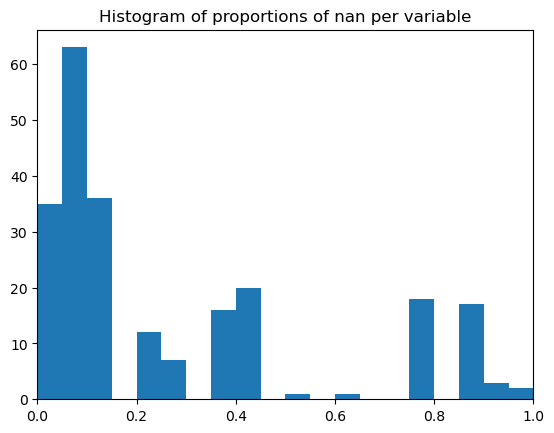

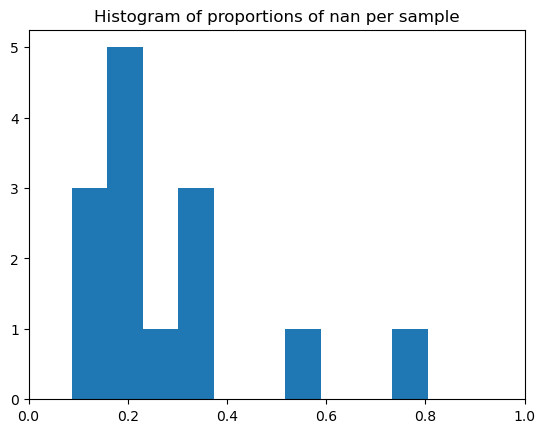

In [59]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping variables z_net_stats shape: (14, 231)
There are 884 non finite values (27.3%)
Final z_net_stats shape: (14, 169)
There are 62 variables discarded


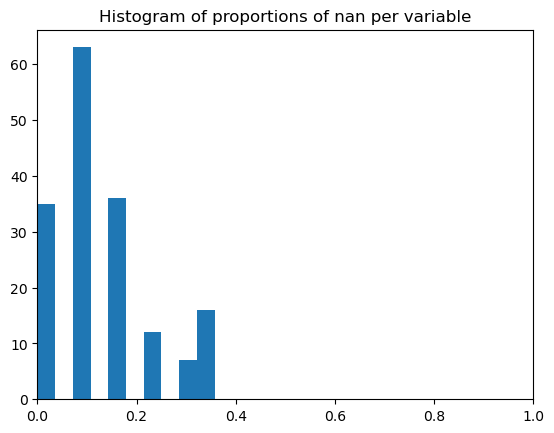

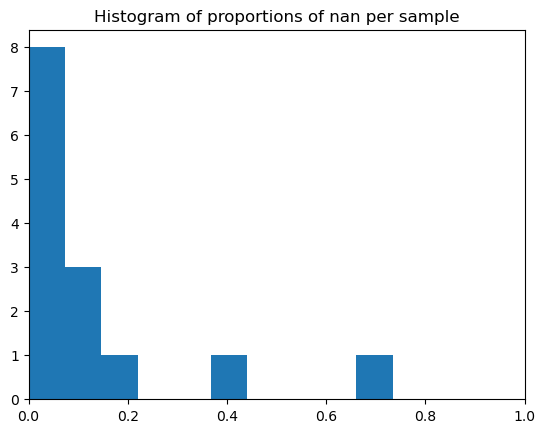

In [60]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (14, 169)
There are 279 non finite values (11.8%)
Final z_net_stats shape: (13, 169)
There are 1 observations discarded


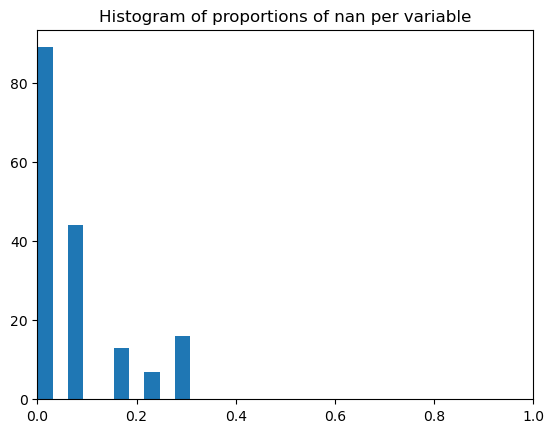

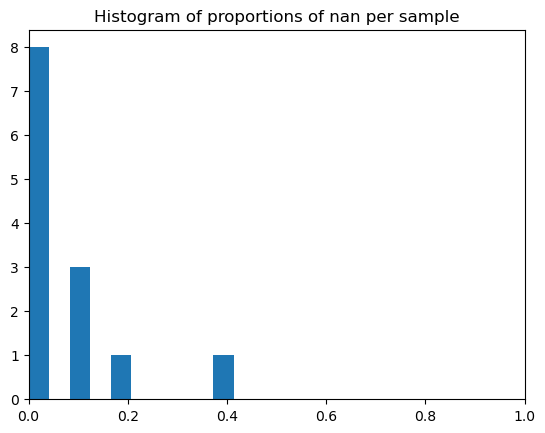

In [61]:
# Here we notice there are no patient with more than80% of nan values.
# We will still drop high-nan patients.

print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [62]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 155 non finite values (7.1%)
Imputing data
Final z_net_stats shape: (13, 169)


In [51]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.iloc[:, 1:], group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [52]:
pvals.head(10)

,pval,pval_corr
vasculature - vasculature Z,0.002331,0.391608
lymphatics - B cells Z,0.022145,0.998725
macrophages (M2>M1) - lymphatics Z,0.022145,0.998725
Tregs - CLA+ leukocytes Z,0.034965,0.998725
nerves - CD4+ T cells Z,0.051282,0.998725
B cells - B cells Z,0.073427,0.998725
macrophages (M1=M2) - lymphatics Z,0.073427,0.998725
"tumor cells, intraepithelial - macrophages (M2>M1) Z",0.101399,0.998725
tumor cells - CD8+ T cells Z,0.137529,0.998725
mast cells - lymphatics Z,0.137529,0.998725


There are 4 significant variables in `pval`


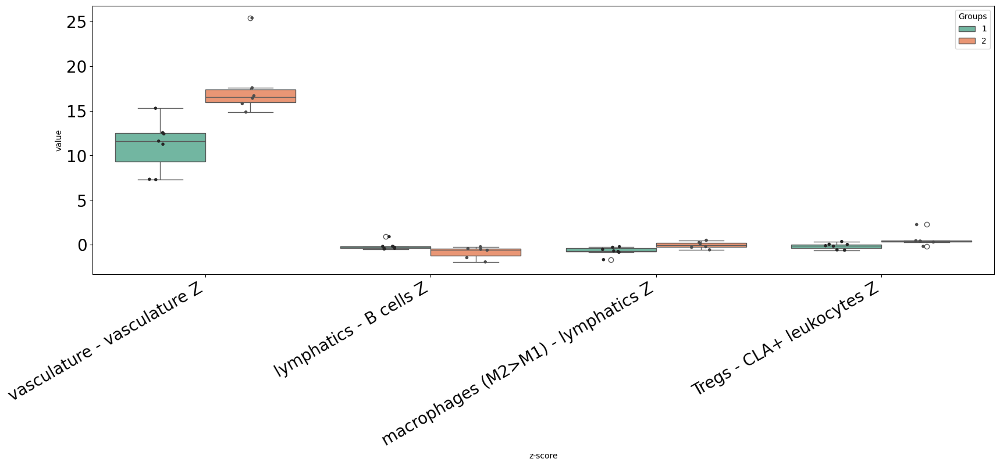

In [53]:
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

There are 4 significant variables in `pval`


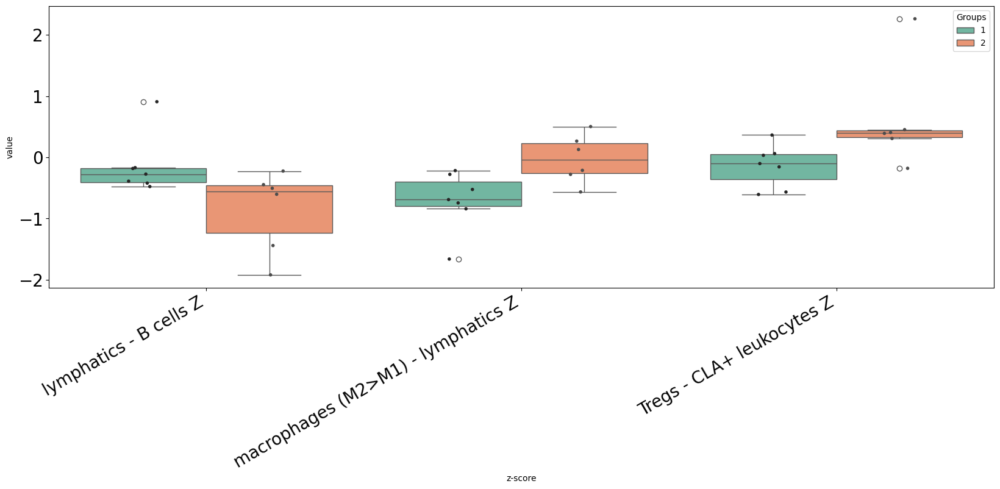

In [66]:
exclude_vars = [
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'Langerhans cells - Langerhans cells Z',
    #  'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
]

fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    exclude_vars=exclude_vars,
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    )

Distributions of Z scored interactions between -2 and 2 are not significative.

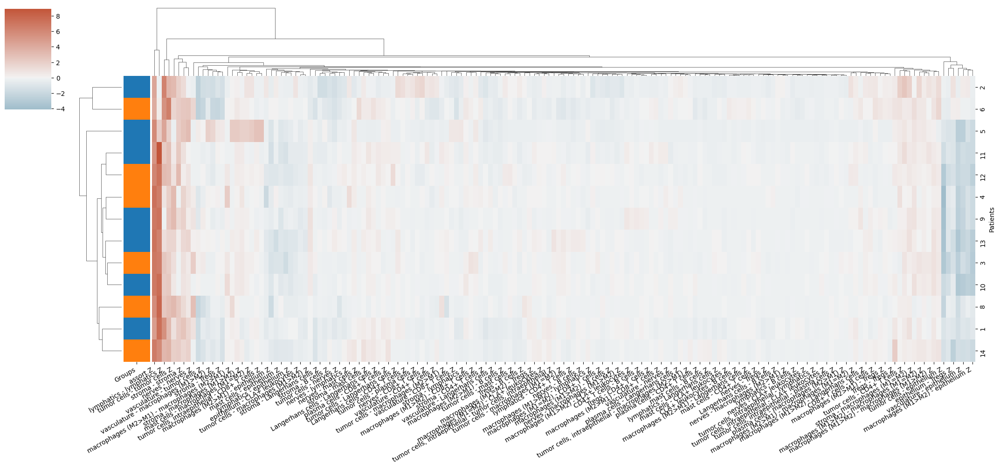

In [68]:
mosna.plot_heatmap(
    z_net_stats_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18),
    z_score=False,
    )

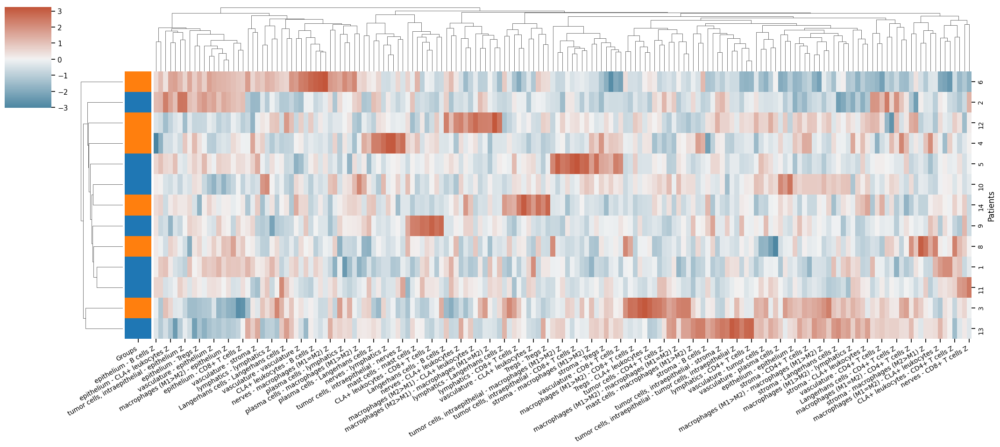

In [120]:
mosna.plot_heatmap(
    z_net_stats_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )
plt.savefig(save_dir / "assortativity_z-scored_clustering-patients", bbox_inches='tight', facecolor='white')

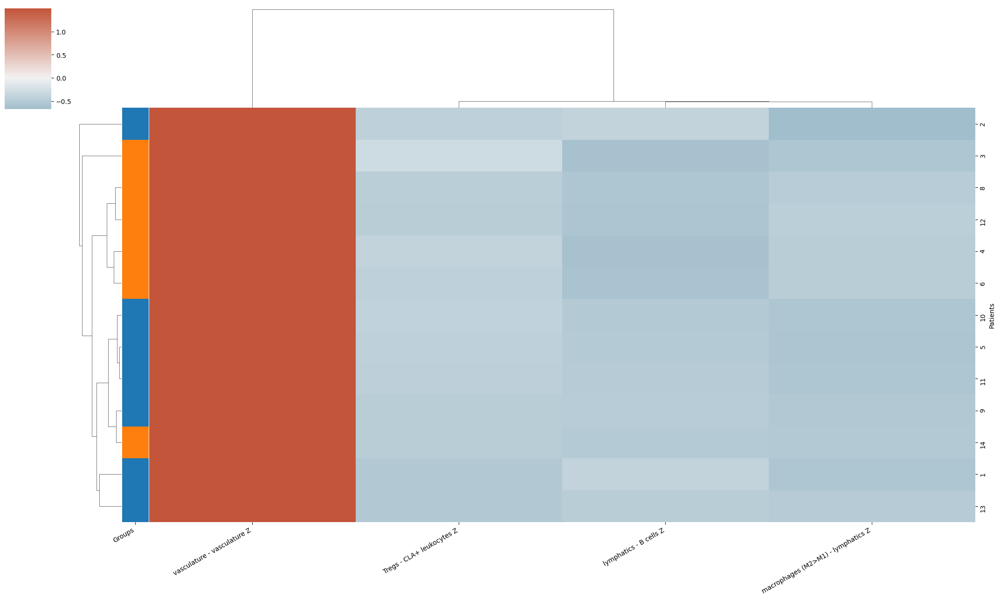

In [78]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18),
    z_score=False,
    )

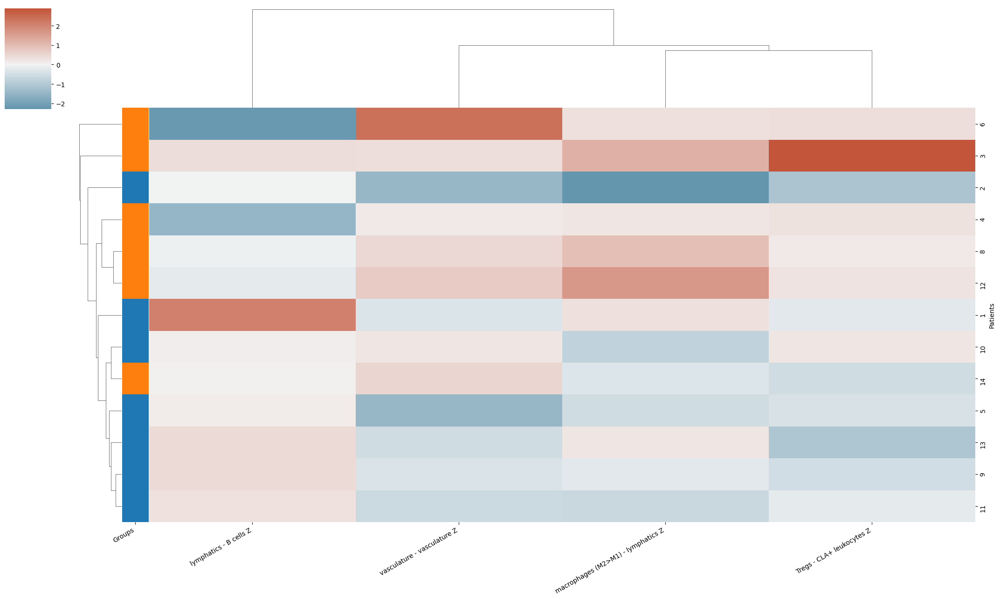

In [79]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    dendrogram_ratio=[0.05, 0.2],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )
plt.savefig(save_dir / "assortativity_z-scored_clustering-patients", bbox_inches='tight', facecolor='white')

#### Logistic regression on interaction coefficients

Add  vasculature - vasculature Z    with p-value 0.00433855
Add  macrophages (M1=M2) - lymphatics Z with p-value 0.0249937
Add  Tregs - CD4+ T cells Z         with p-value 0.0309824
Add  Langerhans cells - B cells Z   with p-value 0.0127671
Add  tumor cells, intraepithelial - nerves Z with p-value 0.0187272
Add  nerves - nerves Z              with p-value 0.00705618
Add  tumor cells, intraepithelial - lymphatics Z with p-value 0.0148705
Add  vasculature - tumor cells, intraepithelial Z with p-value 0.00135075
Add  vasculature - mast cells Z     with p-value 0.0390574
Add  nerves - CD8+ T cells Z        with p-value 0.00431177
Add  vasculature - CD4+ T cells Z   with p-value 0.00863992


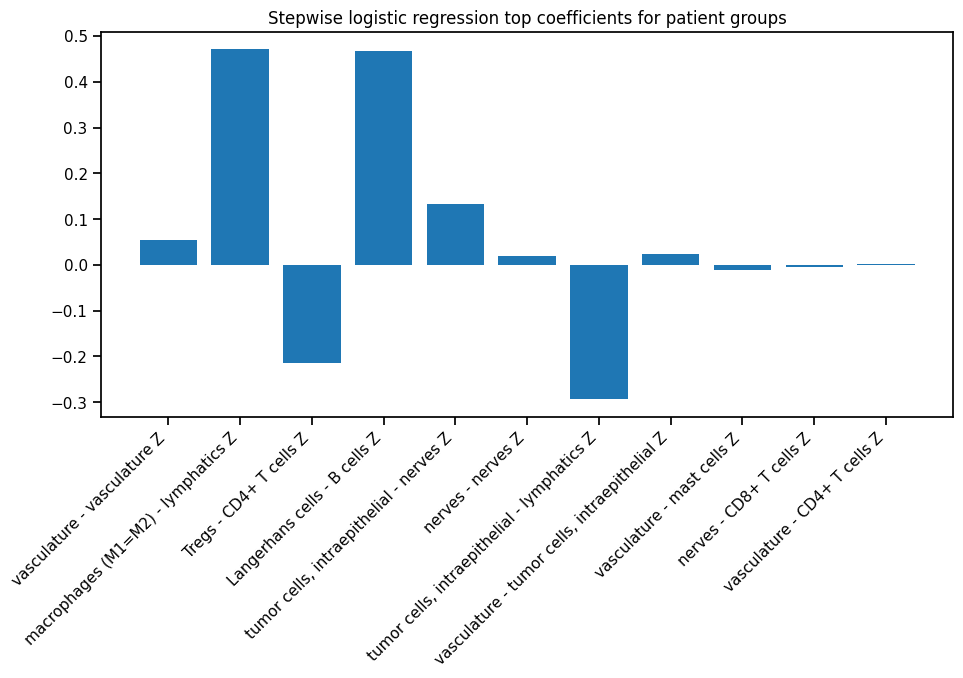

In [123]:
# Stepwise logistic regression
if len(best_pval_names) > 0:
    # model, included = mosna.stepwise_regression(X=z_net_stats_cleaned.drop(columns=['Spots']), y_name=group_col, y_values=[1, 2], verbose=True)
    model, included = mosna.stepwise_regression(X=z_net_stats_cleaned, y_name=group_col, y_values=[1, 2], verbose=True)

    # plot the model's coefficients
    coefs = model.params[1:] # skip intercept
    nb_coefs = min(coefs.size, 20)
    if nb_coefs > 0:
        fig, ax = plt.subplots(figsize=(nb_coefs,5))
        ax.bar(range(len(coefs.index)), coefs)
        plt.xticks(ticks=range(len(coefs.index)), labels=coefs.index, rotation=45, ha='right');
        title = f"Stepwise logistic regression top coefficients for patient groups"
        plt.title(title)
else:
    print("There is no interaction statistically related to response group")

TODO: Compute performance metrics for SWLR models

        training failed
        training failed with cv <= 5
        training failed
        training failed with cv <= 5
Training took 2.320s


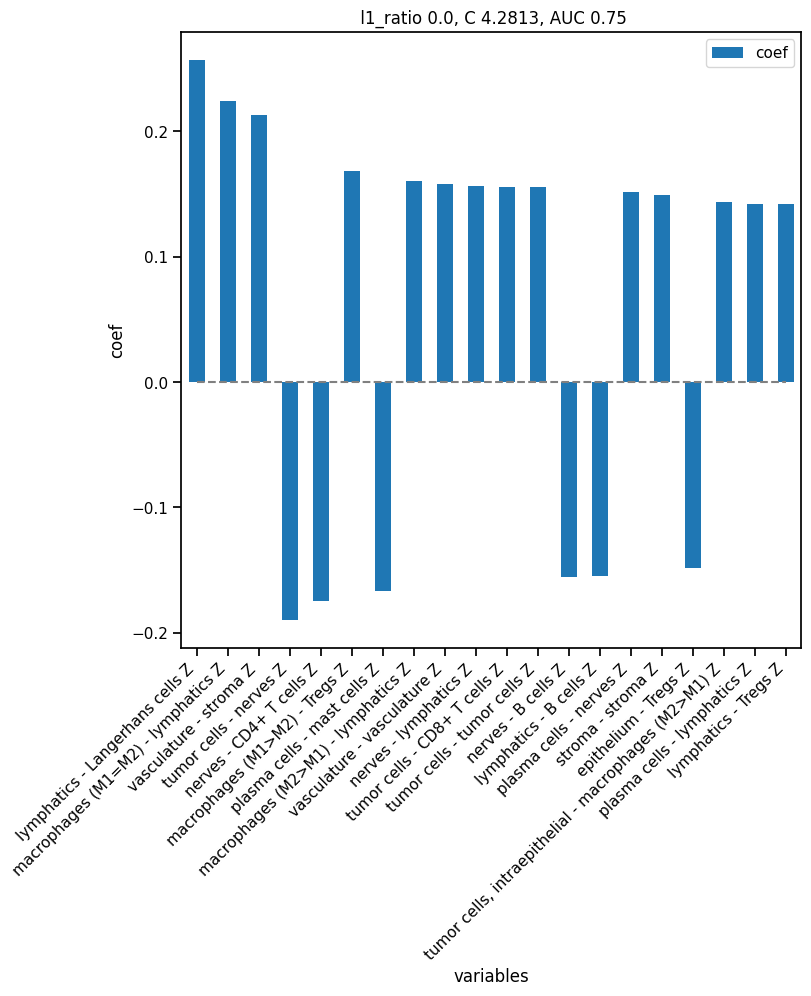

In [126]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

In [99]:
# columns = [
#     'neutrophils - neutrophils Z', 
#     'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
#     'vasculature -vascilature Z',
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'vasculature - vasculature Z',
#     'neutrophils - neutrophils Z',
#     'Langerhans cells - Langerhans cells Z',
# ]

Training took 2.040s


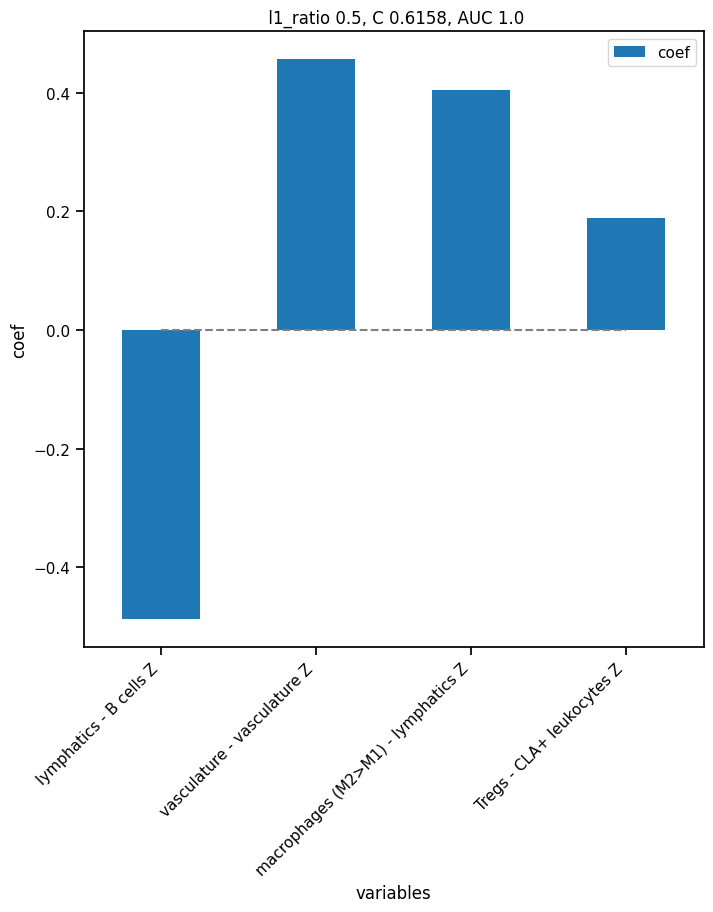

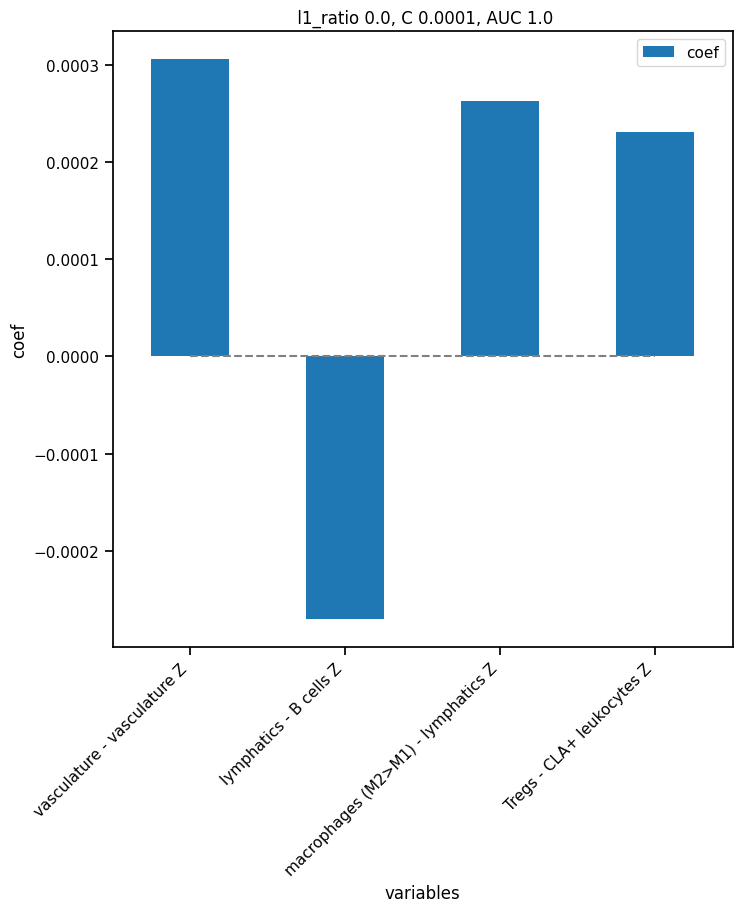

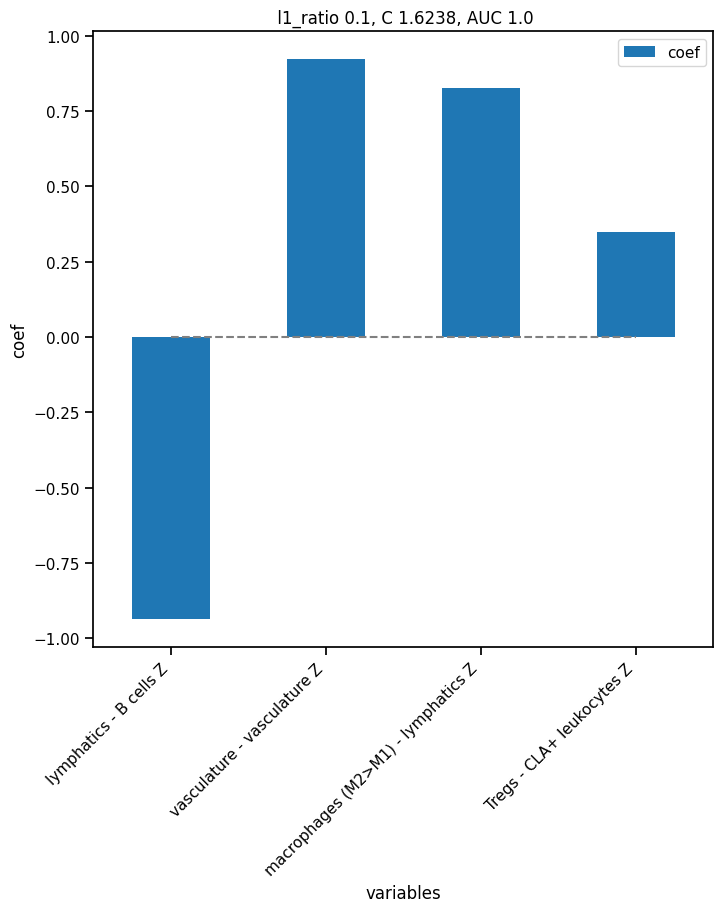

In [129]:
models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

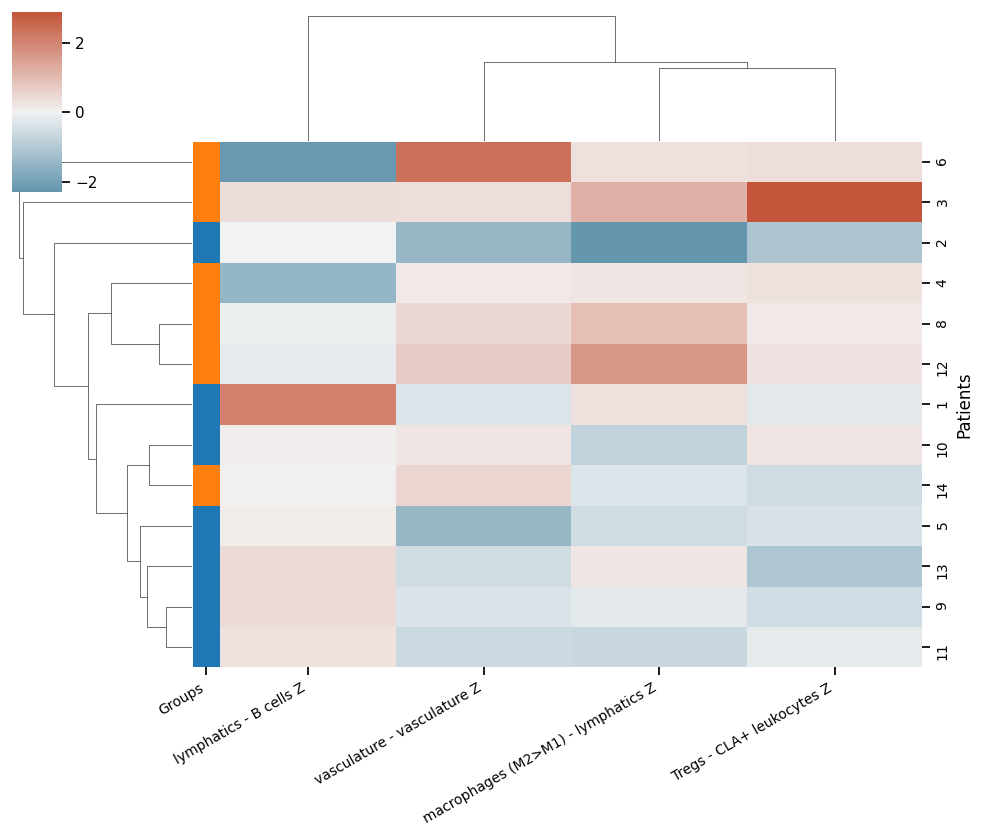

In [133]:
# use the most statistically relevant variable separating groups
# Note: that's to have a clue, do not use this method for real,
# it's a tautology!

nb_vars = np.sum(pvals['pval'] <= 0.05)
# nb_vars = min(nb_vars, 20)
marker_vars = pvals.sort_values(by='pval', ascending=True).head(nb_vars).index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[marker_vars].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(10, 10),
    )

### Ratio of cell-types interactions

Since as noted by this study's authors the imbalance in interactions between cell types can influence response to therapy, let's blindly investigate how ratios of cell types assortativity could predict response to therapy.

In [63]:
z_net_stats_cleaned

,,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - plasma cells Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - CLA+ leukocytes Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.379628,1.013038,0.360985,-0.195251,2.297432,2.237812,0.331563,-0.850976,0.995579,...,-0.417642,0.245734,-0.058363,0.537909,-1.823805,1.055186,1.619370,2.354305,-1.653167,-1.976900
2,1,9.193553,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,1.376494,2.168006,...,0.067444,-0.156813,-0.349295,-0.287183,0.966901,0.291703,-0.044766,-0.270220,-0.569737,-0.998532
3,2,52.271849,6.007915,-0.758091,7.467845,0.576871,-0.973770,6.804749,-0.677016,0.313157,2.253644,...,-0.240590,1.676032,-0.666123,0.290527,-1.742412,0.165398,2.969166,-0.113594,-0.526157,-0.590696
4,2,52.205555,16.019297,0.404733,1.494855,-1.356062,0.812310,-0.058913,-0.098084,0.436204,-0.089359,...,-0.221720,-0.217545,3.120827,-0.135186,-0.435213,-0.137330,-0.077487,-0.725846,0.208737,-0.950303
5,1,20.961282,0.271940,0.584850,0.105791,1.229469,1.405370,2.606522,0.164320,0.001452,-0.193247,...,-0.142857,-0.089803,-0.100504,0.127481,-0.366608,-0.224544,0.436430,0.504944,-0.318498,3.219609
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,8.605185,-0.331394,1.186227,2.301700,0.354720,3.069966,-0.355190,0.457781,-0.372936,...,0.445604,-0.284618,-0.160394,-0.116330,-0.331505,-0.023216,-0.175863,-0.130681,1.877497,0.626649
11,1,20.803035,-0.089803,0.497844,-0.462358,-0.224544,2.085407,1.611584,-0.283092,0.118890,0.630564,...,-0.365601,-0.251638,1.875653,0.324354,-1.366788,-0.397661,0.952437,0.545575,-0.400482,-1.123676
12,2,36.877393,4.319336,-0.884892,0.134051,-0.993092,1.998438,2.365100,1.266030,0.848276,3.871280,...,-0.350890,-0.114000,-0.052110,1.318499,0.241371,-0.172772,0.407288,-0.699327,-0.853301,0.007477


In [65]:
use_cols = [x for x in z_net_stats_cleaned.columns if x != 'assort Z']
composed_variables = mosna.make_composed_variables(z_net_stats_cleaned[use_cols], method='ratio', order=1)
z_net_stats_comp = pd.concat([z_net_stats_cleaned, composed_variables], axis=1)
pvals = mosna.find_DE_markers(z_net_stats_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [88]:
pvals.head(10)

,pval,pval_corr
macrophages (M2>M1) - B cells Z / tumor cells - macrophages (M1>M2) Z,0.001166,1.0
mast cells - mast cells Z / plasma cells - CD4+ T cells Z,0.001166,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z",0.001166,1.0
"tumor cells - mast cells Z / tumor cells, intraepithelial - plasma cells Z",0.001166,1.0
macrophages (M2>M1) - Tregs Z / nerves - macrophages (M1>M2) Z,0.001166,1.0
CD8+ T cells - B cells Z / lymphatics - Langerhans cells Z,0.001166,1.0
macrophages (M2>M1) - lymphatics Z / mast cells - B cells Z,0.001166,1.0
"nerves - CD8+ T cells Z / tumor cells, intraepithelial - epithelium Z",0.001166,1.0
"tumor cells - mast cells Z / tumor cells, intraepithelial - tumor cells, intraepithelial Z",0.001166,1.0
mast cells - macrophages (M1>M2) Z / tumor cells - mast cells Z,0.002331,1.0


In [71]:
# select columns potentially related to the Spatial Score
sc_cols = [x for x in pvals.index if 'Tregs - CD4+ T cells' in x and 'tumor' in x]

In [73]:
pvals.loc[sc_cols, :]

,pval,pval_corr
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z",0.001166,1.0
Tregs - CD4+ T cells Z / tumor cells - nerves Z,0.034965,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - mast cells Z",0.137529,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - CLA+ leukocytes Z",0.137529,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - B cells Z",0.137529,1.0
...,...,...
Tregs - CD4+ T cells Z / tumor cells - plasma cells Z,0.945221,1.0
Tregs - CD4+ T cells Z / vasculature - tumor cells Z,0.945221,1.0
Tregs - CD4+ T cells Z / tumor cells - Tregs Z,0.945221,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - plasma cells Z",0.945221,1.0


In [78]:
pvals.loc['Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z', :]

pval         0.835664
pval_corr    1.000000
Name: Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z, dtype: float64

Only `Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z` and `Tregs - CD4+ T cells Z / tumor cells - nerves Z` are in the significant interaction between the response groups, without FDR correction. The `Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z` corresponding to the Spatial Score is not significantly different between response groups.

There are 333 significant variables in `pval`


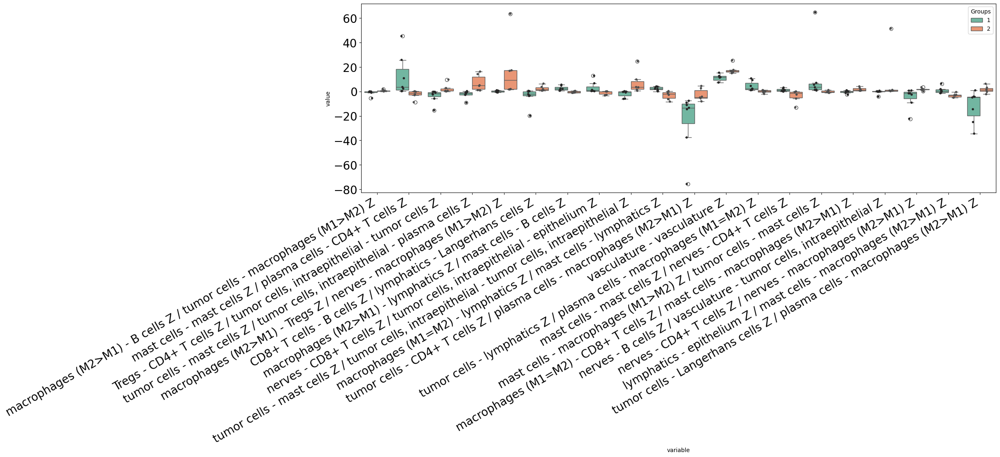

In [79]:
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

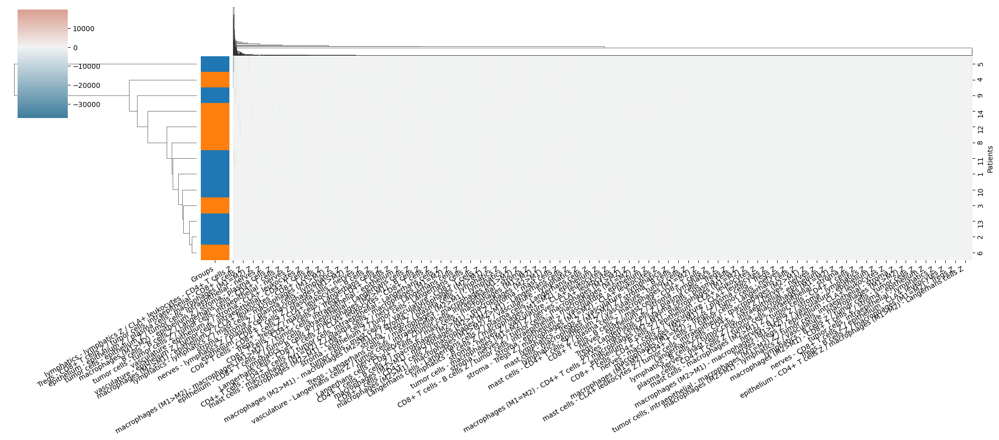

In [80]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    z_net_stats_comp.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    );

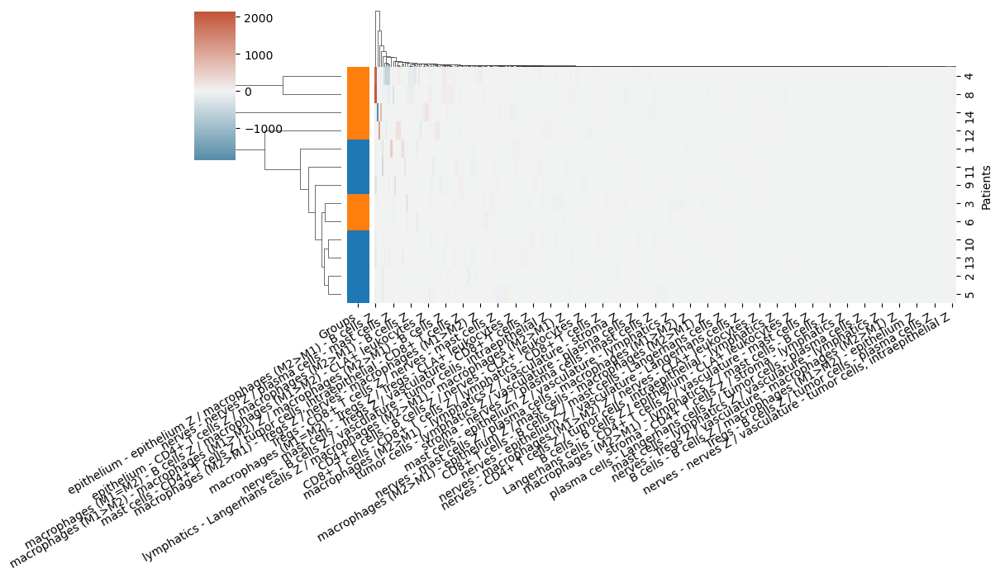

In [81]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    z_net_stats_comp[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    );

        training failed
        training failed with cv <= 5
Training took 49.415s


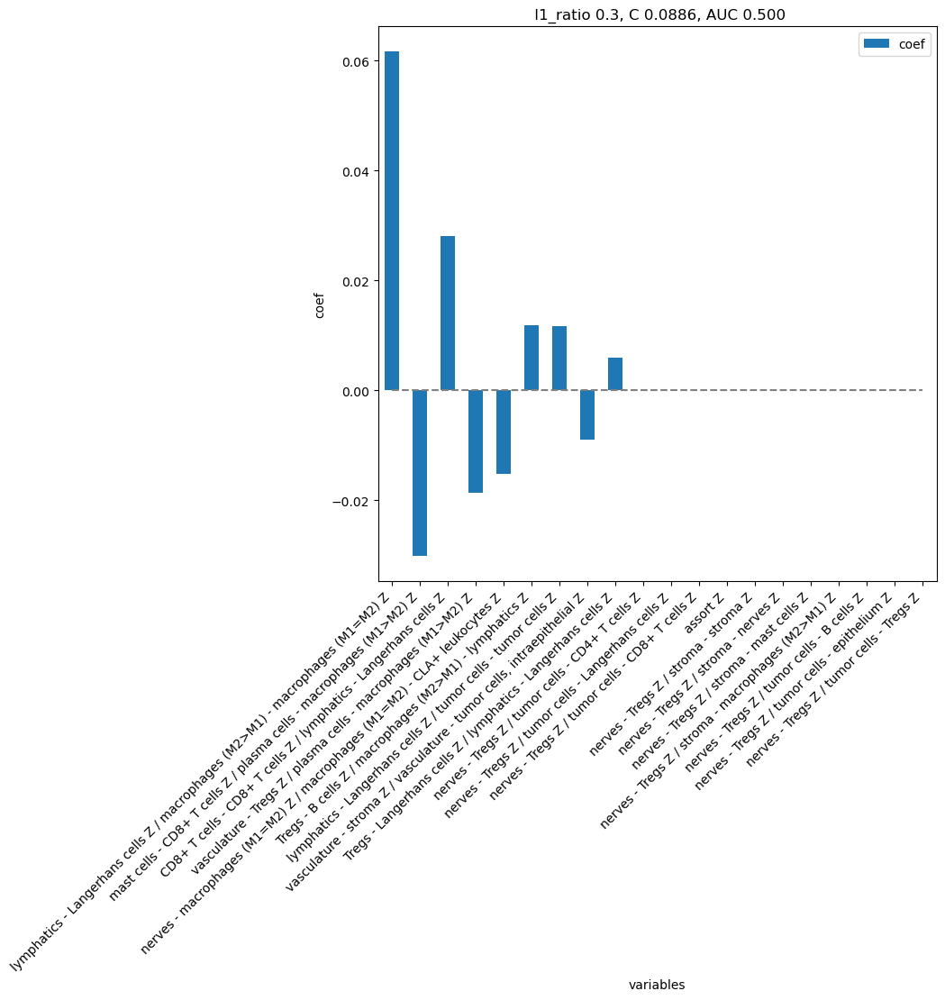

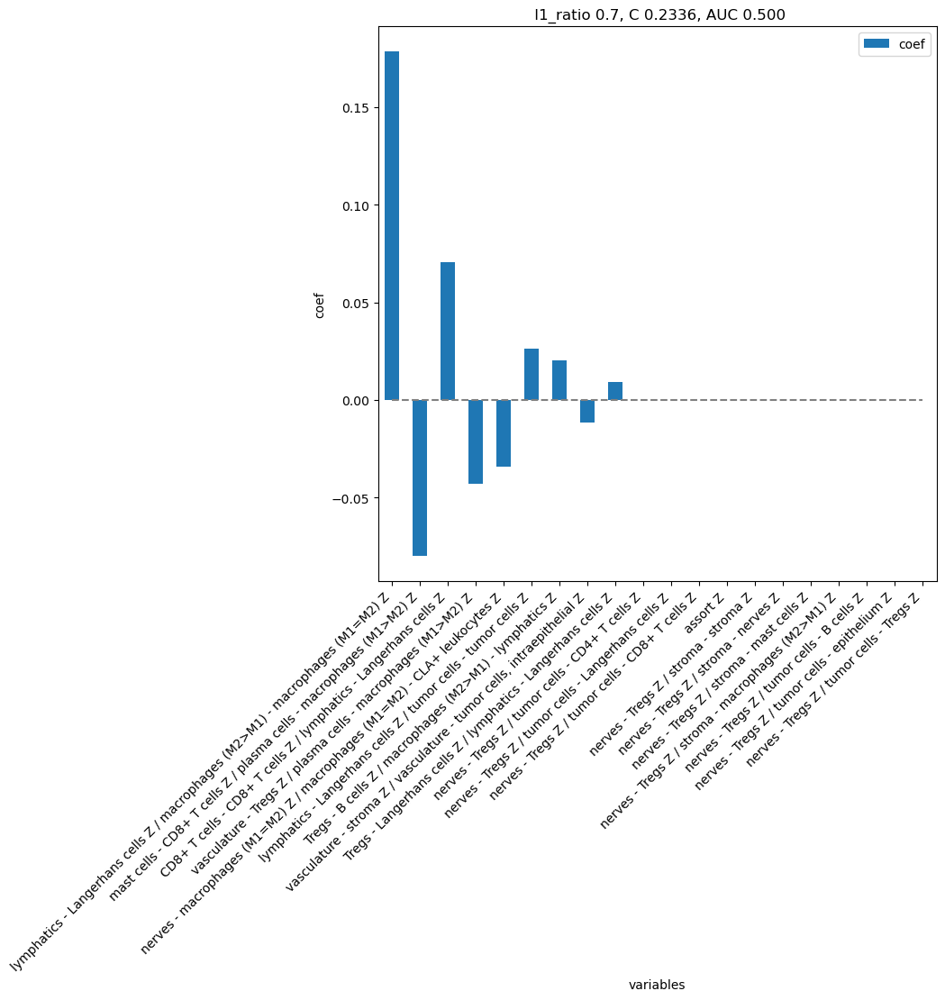

In [85]:
# Train ML model with all variables

models = mosna.logistic_regression(
    z_net_stats_comp,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.612s


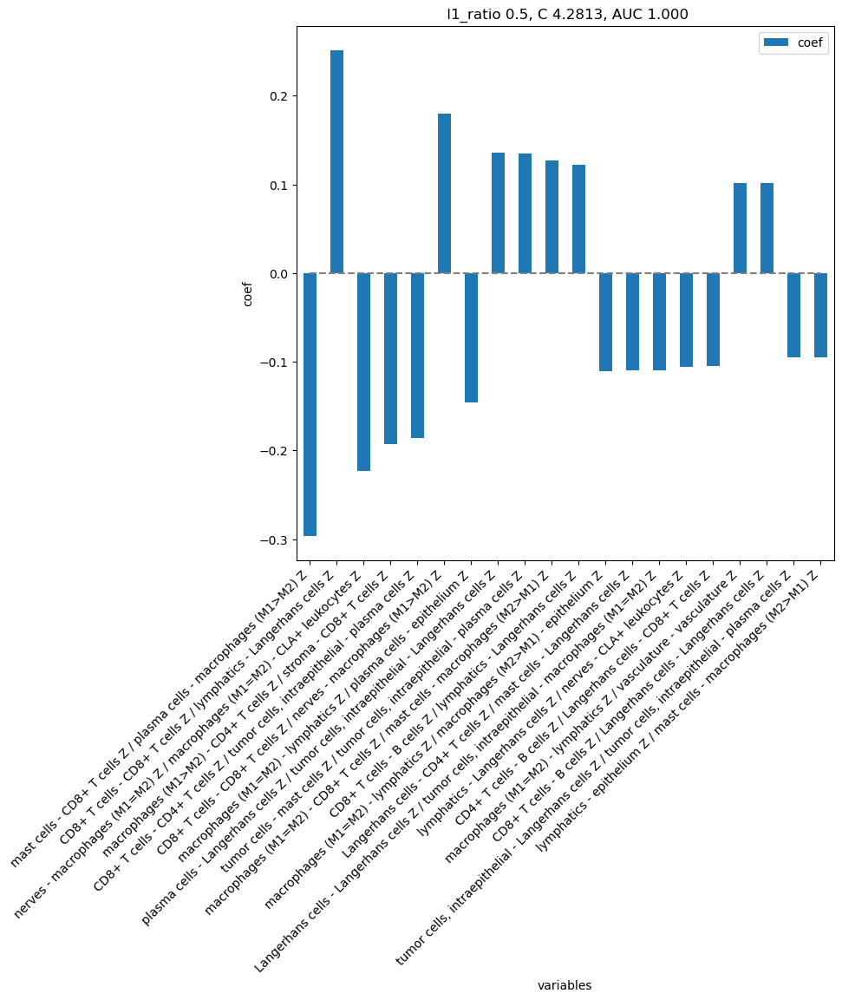

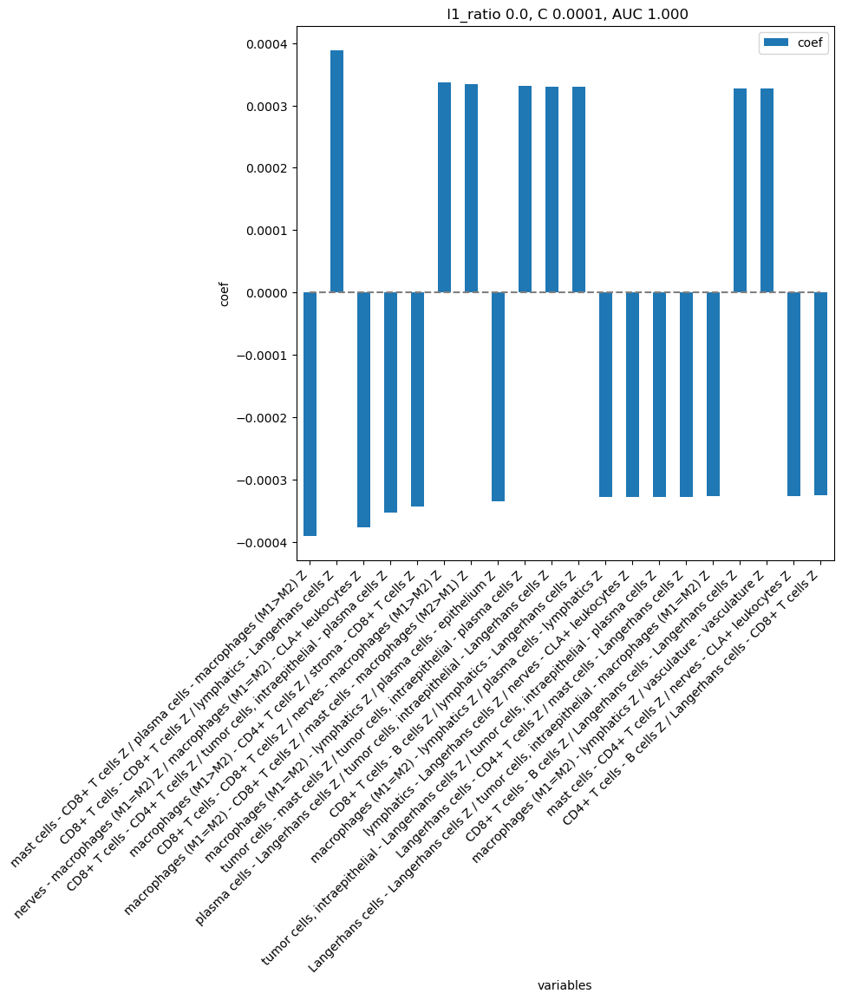

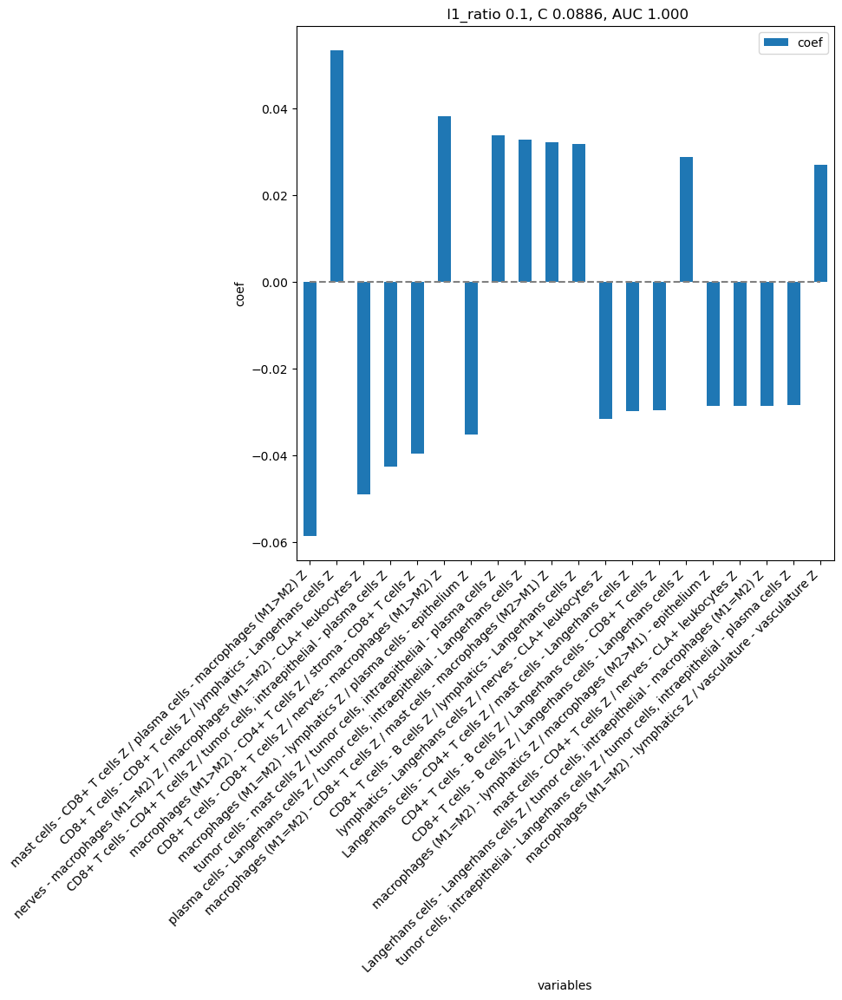

In [86]:
# Train ML model with the best variables

models = mosna.logistic_regression(
    z_net_stats_comp[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Marker-positive cells interactions

We can also compute the mixing matrix and assortativity between marker-positive cells.

## Cellular neighborhoods

The mixing matrix and assortativity give us information about the global network organization.  
Here we will see how to use the *Neighbors Aggregation Statistics* method to find local "cellular communities", or "neighborhoods", or "niches", that can be relevant to understand disease progression or response to therapies.  

### On cell types

First order neighbors, mean and std

In [95]:
order = 1
var_type = 'cell-types'
stat_names = 'mean-std'
aggreg_vars = cell_type_cols

# For UMAP visualization
marker = '.'
size_points = 10

In [51]:
sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
if not os.path.exists(sof_dir):
    os.makedirs(sof_dir)

In [52]:
# attrib_all = obj[cell_type_cols]
X = obj[aggreg_vars].values
edges_all = pd.read_csv(reconst_dir/ 'sample_all-edges.csv')
pairs = edges_all.values

In [53]:
filename = sof_dir / f'aggregation_statistics.csv'

if filename.exists():
    var_aggreg = pd.read_csv(filename)
else:
    var_aggreg = mosna.aggregate_k_neighbors(
        X=X,
        pairs=pairs,
        order=order,
        var_names=aggreg_vars,
    )
    var_aggreg.to_csv(filename, index=False)

In [54]:
n_neighbors = 70
metric = 'euclidean'
min_dist = 0.0

reducer = umap.UMAP(
    random_state=0,
    n_neighbors=n_neighbors,
    metric=metric,
    min_dist=min_dist,
    # we don't modify the other parameters
    # spread=1.0,
    # set_op_mix_ratio=1.0,
    # local_connectivity=1.0,
    # repulsion_strength=1.0,
    # negative_sample_rate=5,
    # transform_queue_size=4.0,
    )
embedding = reducer.fit_transform(var_aggreg)
reducer_name = f"reducer-umap_nneigh-{n_neighbors}_metric-{metric}_min_dist-{min_dist}"
# save reduced coordinates
np.save(sof_dir / (reducer_name + '.npy'), embedding, allow_pickle=False, fix_imports=False)
# save the reducer object
joblib.dump(reducer, sof_dir / (reducer_name + '.pkl'))
embedding.shape

/home/alexis/.pyenv/versions/3.8.10/envs/spatial-networks/lib/python3.8/site-packages/scipy/sparse/_index.py:125: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


(117170, 2)

In [47]:
joblib.dump(reducer, str(sof_dir / (reducer_name + '.pkl')))

['../data/processed/CODEX_CTCL/all_samples_networks_xy_trim_dist-percentile_size_solitary-0/nas_on-cell-types_stats-mean-std_order-1/reducer-umap_nneigh-70_metric-euclidean_min_dist-0.0.pkl']

In [ ]:
plt.figure(figsize=[10,10])
plt.scatter(embedding[:, 0], embedding[:, 1], c='royalblue', marker=marker, s=size_points)
title = f"UMAP of NAS on {var_type}"
plt.title(title, fontsize=18);

#### Screen NAS parameters

In [ ]:
from importlib import reload
reload(mosna)

orders = [1]
dim_clusts = [2, 3, 4, 5, 6, 7, 8, 9]
min_cluster_sizes = [100, 250, 500, 750, 1000]
parallel_dim = 'max'
parallel_clustering = 4
processed_dir = Path('../data/processed/CODEX_CTCL')
opt_str = '_samples-all_stat-mean-std'
save_dir = 'test-parallel'

mosna.screen_nas_parameters(X, pairs, markers, orders, dim_clusts, min_cluster_sizes, processed_dir, save_dir=save_dir, soft_clustering=True, 
                            opt_str=opt_str, parallel_dim=parallel_dim, parallel_clustering=parallel_clustering, memory_limit='800GB')


#### Clusters visualization

dim_clust: 2
    min_cluster_size: 100


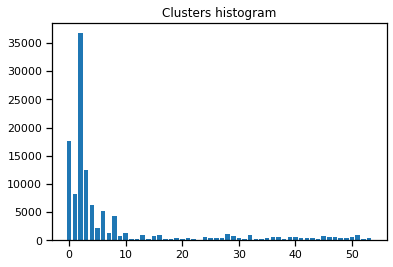

No handles with labels found to put in legend.


        sample: 1


In [188]:
reload(mosna)

orders = [1]
dim_clusts = [2, 3, 4, 5, 6, 7, 8, 9]
min_cluster_sizes = [100, 250, 500, 750, 1000]
processed_dir = Path('../data/processed/CODEX_CTCL')
opt_str = '_samples-all_stat-mean-std'

mosna.plot_screened_parameters(obj, pos_cols, cell_type_cols, orders, dim_clusts, processed_dir,
                               min_cluster_sizes, all_edges='all_samples_networks', sampling=False, var_type=None, 
                               downsample=False, aggreg_dir=None, load_dir=None, save_dir=None, opt_str=opt_str)

### On markers

In [61]:
nodes_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/')

In [62]:
method = 'NAS'
# method = 'SCAN-IT'

order = 1
var_type = 'markers'
stat_funcs='default'
stat_names='default'
# stat_funcs = np.mean
# stat_names = 'mean'
# aggreg_vars = marker_cols

# directory of spatial omic features
if method == 'NAS':
    sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
    sof_dir.mkdir(parents=True, exist_ok=True)
elif method == 'SCAN-IT':
    sof_dir = nodes_dir / f"scanit_on-{var_type}"    
    sof_dir.mkdir(parents=True, exist_ok=True)

# For UMAP visualization
marker = '.'
size_points = 10

# read column names in stored nodes files
node_file = list(nodes_dir.glob('nodes_*.parquet'))[0]
attributes_col = pd.read_parquet(node_file).columns[:-2]

In [63]:
attributes_col

Index(['x', 'y', 'cell type', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'CLA+ leukocytes', 'DCs, CD11c+', 'IDO+ stromal cells',
       'Langerhans cells', 'Tregs', 'epithelium', 'lymphatics',
       'macrophages (M1=M2)', 'macrophages (M1>M2)', 'macrophages (M2>M1)',
       'mast cells', 'nerves', 'neutrophils', 'plasma cells', 'stroma',
       'tumor cells', 'tumor cells, intraepithelial', 'vasculature', 'FOXP3',
       'GATA3', 'MUC-1', 'Vimentin', 'T-bet', 'CD62L', 'Cytokeratin', 'PD-L1',
       'Ki-67', 'CD15', 'CD30', 'CD2', 'GranzymeB', 'CD5', 'CD39', 'MMP9',
       'CD4', 'LAG3', 'CD25', 'CD56', 'CD20', 'PD-1', 'CD11c', 'CLA-CD162',
       'IDO-1', 'VISTA', 'HLA-DR', 'ICOS', 'BCL-2', 'CD3', 'CD69', 'CD8',
       'CD7', 'CD45RA', 'CD45', 'CD1a', 'CD57', 'B-catenin', 'CD45RO', 'CD71',
       'CD34', 'CD68', 'CD38', 'CollagenIV', 'CD31', 'Podoplanin', 'CD138',
       'CD163', 'Mastcell-tryptase', 'MMP12', 'CD164', 'p53', 'CCR6', 'CD16',
       'CD11b', 'CCR4', 'EGFR'],
    

In [64]:
filename = sof_dir / f'aggregation_statistics.parquet'

if filename.exists():
    print('Load aggregation statistics')
    var_aggreg = pd.read_parquet(filename)
else:
    var_aggreg = mosna.compute_spatial_omic_features_all_networks(
        method=method,
        nodes_dir=nodes_dir,
        edges_dir=edges_dir, 
        attributes_col=attributes_col, 
        use_attributes=marker_cols, # use all attributes 
        make_onehot=False, 
        stat_funcs=stat_funcs,
        stat_names=stat_names,
        id_level_1='patient',
        save_intermediate_results=False, 
        dir_save_interm=None,
        verbose=1,
        )
    var_aggreg.to_parquet(filename, index=False)

Load aggregation statistics


In [65]:
# retrieve network info and remove it from NAS table
var_aggreg_samples_info = var_aggreg[['patient', 'sample']]
var_aggreg.drop(columns=['patient', 'sample'], inplace=True)

In [66]:
var_aggreg

,FOXP3 mean,GATA3 mean,MUC-1 mean,Vimentin mean,T-bet mean,CD62L mean,Cytokeratin mean,PD-L1 mean,Ki-67 mean,CD15 mean,...,CD163 std,Mastcell-tryptase std,MMP12 std,CD164 std,p53 std,CCR6 std,CD16 std,CD11b std,CCR4 std,EGFR std
0,0.051929,0.020772,0.143854,0.114105,0.063696,-0.029824,-0.054979,-0.174515,0.102320,-0.051192,...,0.071924,0.053871,0.040228,0.017292,0.009788,0.035631,0.014495,0.023713,0.121012,0.012793
1,0.030949,0.020868,0.103542,0.109624,0.094377,-0.010374,-0.028705,-0.219838,0.124533,-0.039827,...,0.022474,0.053976,0.052094,0.036259,0.005400,0.023135,0.051291,0.013761,0.142735,0.027163
2,0.047038,0.018171,0.143875,0.098401,0.078787,-0.017430,0.025349,-0.216158,0.110923,-0.051625,...,0.083224,0.049045,0.066538,0.009928,0.003357,0.026004,0.112810,0.012135,0.094783,0.024149
3,0.075300,0.040729,0.129774,0.107679,0.068932,-0.023587,-0.016752,-0.220682,0.100538,-0.037418,...,0.085097,0.033951,0.074406,0.018837,0.008119,0.035856,0.011793,0.008725,0.067492,0.017646
4,0.080212,0.001324,0.135504,0.107500,0.073880,-0.040149,0.009726,-0.196033,0.105935,-0.034791,...,0.077400,0.050277,0.070841,0.053142,0.012311,0.035975,0.011338,0.017062,0.114786,0.014883
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38060,0.086637,-0.010136,0.138054,0.067018,0.083059,-0.067397,0.053803,-0.177677,0.110275,-0.040961,...,0.017854,0.015227,0.044064,0.012310,0.013274,0.028051,0.006623,0.012730,0.062015,0.009160
38061,0.020715,0.035064,0.150269,0.116261,0.072845,-0.012741,0.017578,-0.241258,0.110400,-0.027556,...,0.017980,0.053749,0.086857,0.053231,0.015831,0.025305,0.074165,0.008851,0.101246,0.013351
38062,0.056651,0.040472,0.142154,0.108011,0.079002,-0.009502,0.006976,-0.210690,0.109395,-0.037599,...,0.040363,0.071312,0.066242,0.011296,0.014940,0.027676,0.093624,0.020682,0.109082,0.009892
38063,-0.008281,0.055926,0.148055,0.114563,0.071210,-0.006853,-0.058583,-0.227113,0.109383,-0.020025,...,0.011276,0.032378,0.033625,0.033382,0.005845,0.011419,0.012520,0.015343,0.102535,0.006073


In [33]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'cosine', #'manhattan', # or 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading clusterer object and cluster labels
There are 13 clusters


Loading reducer object and reduced coordinates


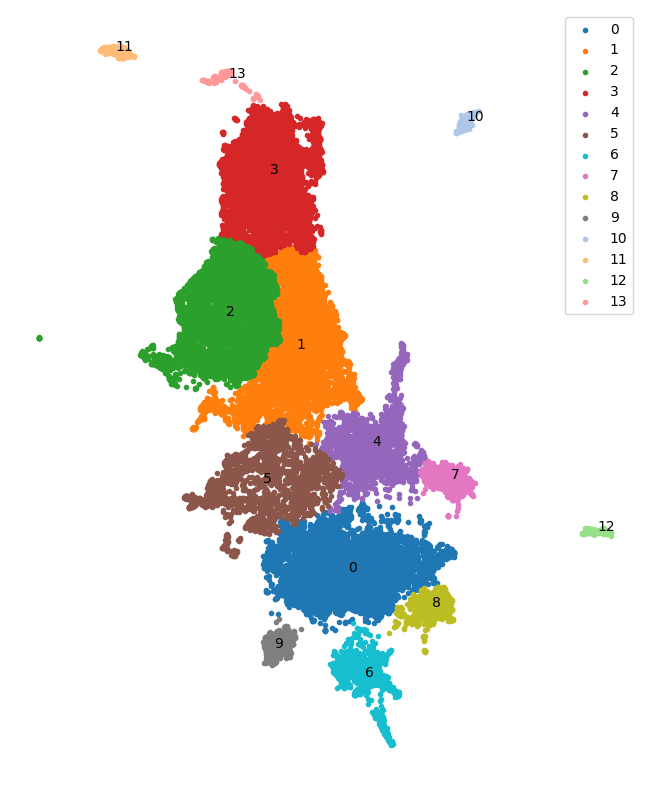

In [34]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    )

In [ ]:
# save_dir = cluster_dir / 'spatial_networks_niches'
# save_dir.mkdir(parents=True, exist_ok=True)

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
# niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])

# plots_marker = '.'
# for sample in obj[sample_col].unique():
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     # TODO: find a way to reuse pairs compatible with aggregated nodes
#     # pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values
#     pairs = ty.build_delaunay(coords, trim_dist=trim_dist)
#     if k_sol > 0:
#         pairs = ty.link_solitaries(coords, pairs, method='knn', k=k_sol)

#     # Big summary plot
#     fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
#     i = 0
#     ty.plot_network(coords, 
#                     pairs,
#                     labels=obj.loc[select, pheno_col], 
#                     color_mapper=celltypes_color_mapper, 
#                     marker=plots_marker, 
#                     size_nodes=size_points, 
#                     ax=ax[0])
#     ax[i].set_title('Spatial map of phenotypes', fontsize=14);

#     i += 1
#     ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points)
#     ax[i].set_title('Spatial map of detected areas', fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=5);
#     ax[i].set_title("Clustering on NAS", fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors);
#     ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
#     ax[i].set_aspect('equal')
    
#     # make plot limits equal
#     ax[i-1].set_xlim(ax[i].get_xlim())
#     ax[i-1].set_ylim(ax[i].get_ylim())

#     suptitle = f"Spatial omics data and detected areas - sample {sample}";
#     fig.suptitle(suptitle, fontsize=18)

#     fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)
#     plt.show()

#### Screen clustering parameters

In [67]:
# net_size_threshold = 0
if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

In [68]:
predict_key = 'patient'
# predict_key = 'sample'
group_col_cat = 'Response status'

if predict_key == 'patient':
    var_label = patient_col
    status = surv[[group_col_cat]]
    status[group_col] = status[group_col_cat].map({'Responder': 1, 'Non-responder':0})
elif predict_key == 'sample':
    var_label = sample_col

/var/folders/yr/dhxfwx0d05s3zq1k3ng_f2j40000gp/T/ipykernel_16544/330855516.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  status[group_col] = status[group_col_cat].map({'Responder': 1, 'Non-responder':0})


In [ ]:
if RUN_LONG:
    # screen NAS parameters
    for dim_clust in tqdm([2, 3, 4, 5], leave=False):
    # for dim_clust in tqdm([2], leave=False):
        for n_neighbors in tqdm([15, 45, 75, 100, 200], leave=False):
            for metric in tqdm(['manhattan', 'euclidean', 'cosine'], leave=False):
                # for n_clusters in tqdm(range(3, 20), leave=False):
                for k_cluster in tqdm([15, 50], leave=False):
                    for resolution_parameter in tqdm([0.1, 0.03, 0.01, 0.003, 0.001], leave=False):
                        cluster_params = {
                            'reducer_type': 'umap', 
                            'n_neighbors': n_neighbors, 
                            'metric': metric,
                            'min_dist': 0.0,
                            'clusterer_type': 'leiden', 
                            'dim_clust': dim_clust, 
                            'k_cluster': k_cluster, 
                            'resolution_parameter': resolution_parameter,
                            # 'flavor': 'CellCharter',
                            # 'n_clusters': n_clusters,
                        }

                        cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
                        
                        # Survival analysis (just heatmap for now)
                        niches = cluster_labels
                        for normalize in ['total', 'niche', 'obs', 'clr', 'niche&obs']:
                            str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                            str_params = str_params + f'_normalize-{normalize}'
                            print(str_params)
                            
                            var_aggreg_niches = var_aggreg_samples_info.copy()
                            var_aggreg_niches['niche'] = np.array(niches)

                            counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize)
                            counts.index = counts.index.astype(status.index.dtype)
                            exo_vars = counts.columns.tolist()
                            df_surv = counts.merge(status, how='inner', on=var_label)
                            # # for samples
                            # counts_clinic = pd.concat([status, counts], axis=1, join='inner').fillna(0)
                            # counts_clinic = counts_clinic.groupby([predict_key, group_col]).mean()

                            # to model data, not to predict from it, do:
                            split_train_test = False
                            models = mosna.logistic_regression(
                                df_surv[exo_vars + [group_col]],
                                y_name=group_col,
                                col_drop=[var_label],
                                cv_train=cv_train, 
                                cv_adapt=cv_adapt, 
                                cv_max=cv_max,
                                plot_coefs=False,
                                split_train_test=split_train_test,
                                )
                            
                            score_roc_auc = np.nanmax([models[model_type]['score']['ROC AUC'] for model_type in models.keys()])
                            print(f'score_roc_auc: {score_roc_auc:.3f}')
                            
                            if score_roc_auc >= 0.7:

                                g, d = mosna.plot_heatmap(
                                    df_surv[exo_vars + [group_col]].reset_index(), 
                                    obs_labels=var_label, 
                                    group_var=group_col, 
                                    groups=[0, 1],
                                    figsize=(10, 10),
                                    z_score=False,
                                    cmap=sns.color_palette("Reds", as_cmap=True),
                                    return_data=True,
                                    )
                                figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}.jpg"
                                plt.savefig(cluster_dir / figname, dpi=150)

                                g, d = mosna.plot_heatmap(
                                    df_surv[exo_vars + [group_col]].reset_index(), 
                                    obs_labels=var_label, 
                                    group_var=group_col, 
                                    groups=[0, 1],
                                    figsize=(10, 10),
                                    z_score=1,
                                    cmap=sns.color_palette("Reds", as_cmap=True),
                                    return_data=True,
                                    )
                                figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}_col_zscored.jpg"
                                plt.savefig(cluster_dir / figname, dpi=150)

In [69]:
def to_number(val):
    """
    Convert a string to a number if possible.

    Example
    -------
    >>> print(to_number('hello'))
    >>> print(to_number('0.1'))
    >>> print(to_number('1.0'))
    """
    try:
        val = float(val)
        if int(val) == val:
            val = int(val)
    finally:
        return val

def get_params_from_str(
    s, 
    ignore_fields=['biclustering'],
    exclude_keys = ['normalize', 'roc_auc'],
    ):
    fields = [x for x in s.split('_') if x not in ignore_fields]

    clean_fields = []
    for i, field in enumerate(fields):
        if '-' not in field:
            try:
                fields[i + 1] = f"{field}_{fields[i + 1]}"
            except:
                print(i)
                print(fields)
        else:
            clean_fields.append(field)

    # make parameters variables
    nas_params = {}
    for field in clean_fields:
        key, val = field.split('-')
        # nas_params[key] = to_number(val)
        nas_params[key] = val

    cluster_params = {key: val for key, val in nas_params.items() if key not in exclude_keys}
    normalize_pred = nas_params['normalize']
    return cluster_params, normalize_pred


In [70]:
best_params_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/select_nas_on-markers_stats-default_order-1')
save_dir = best_params_dir
file_names = best_params_dir.glob('*.jpg')

cell_types = nodes_all[pheno_col]

Loading clusterer object and cluster labels
There are 16 clusters
Loading reducer object and reduced coordinates


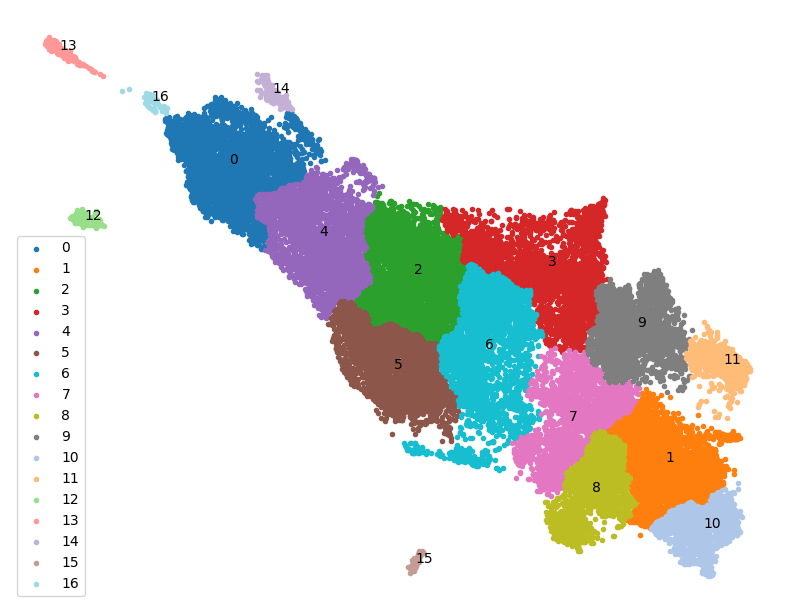

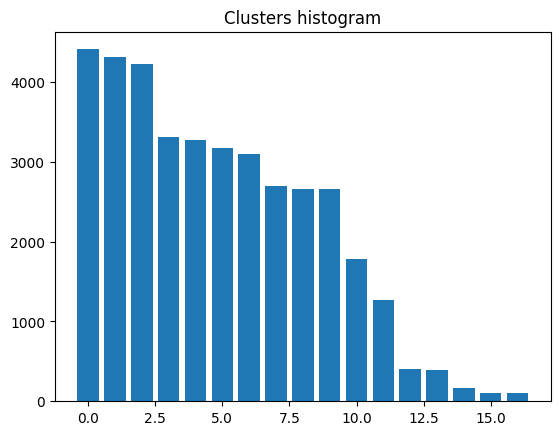

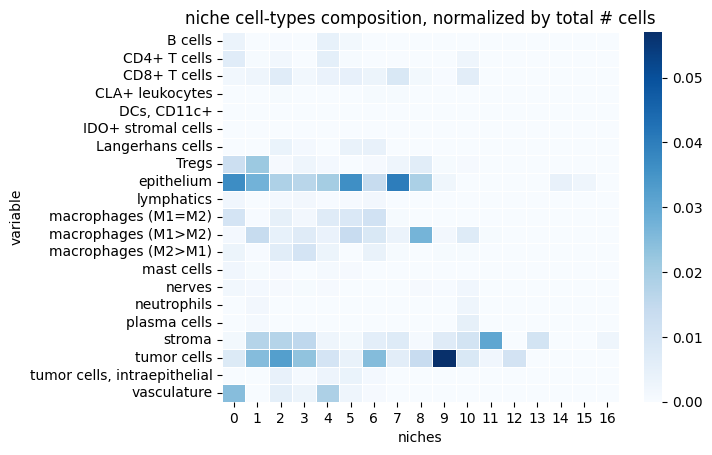

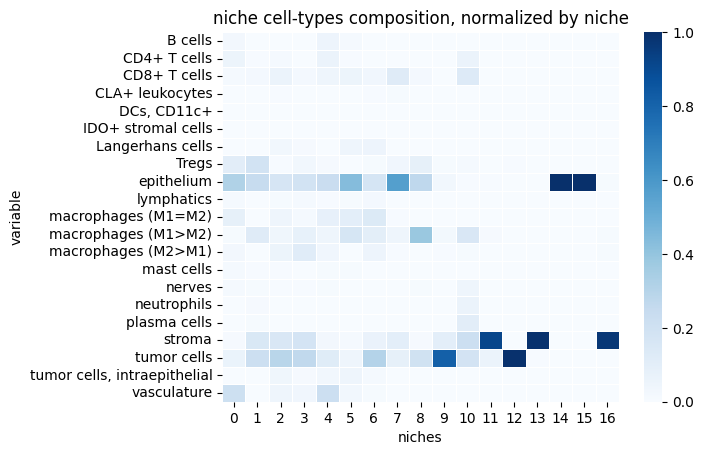

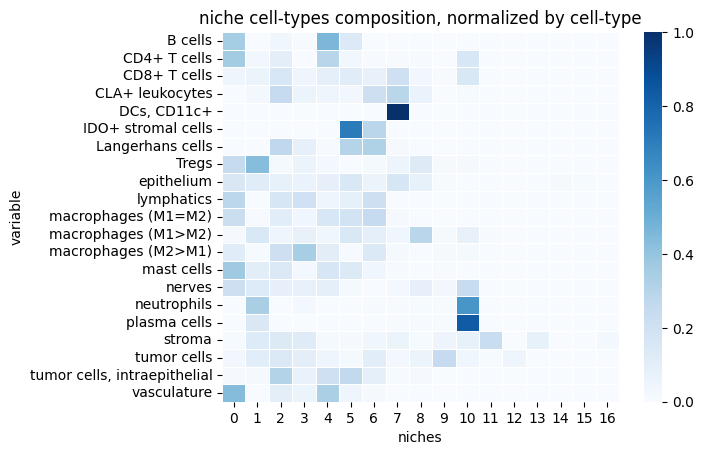

reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


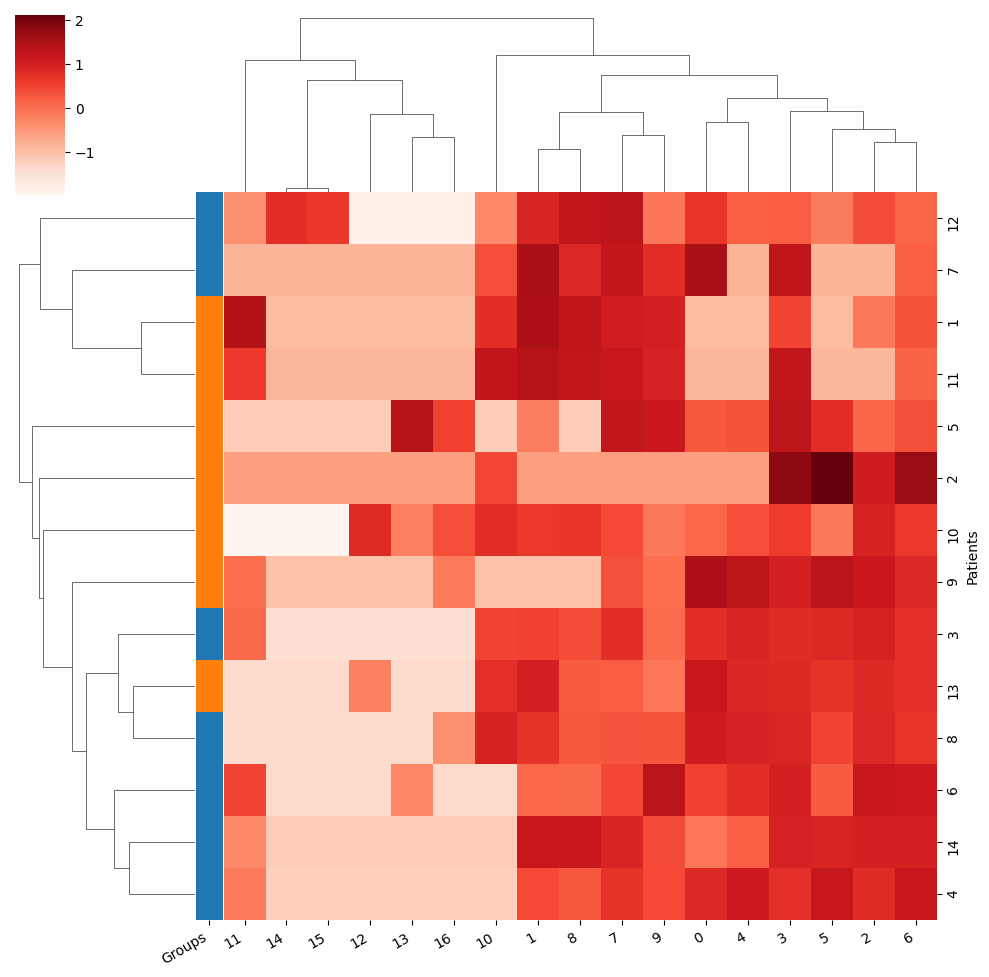

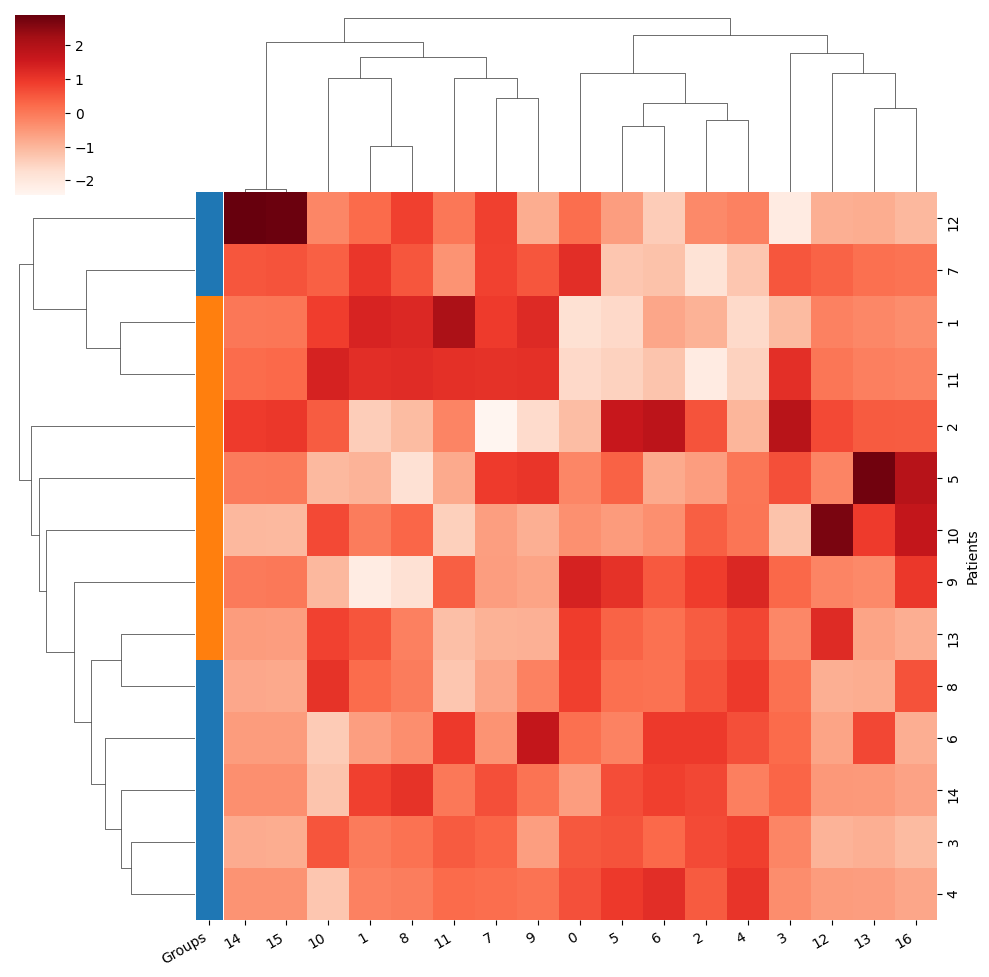

Training took 2.517s


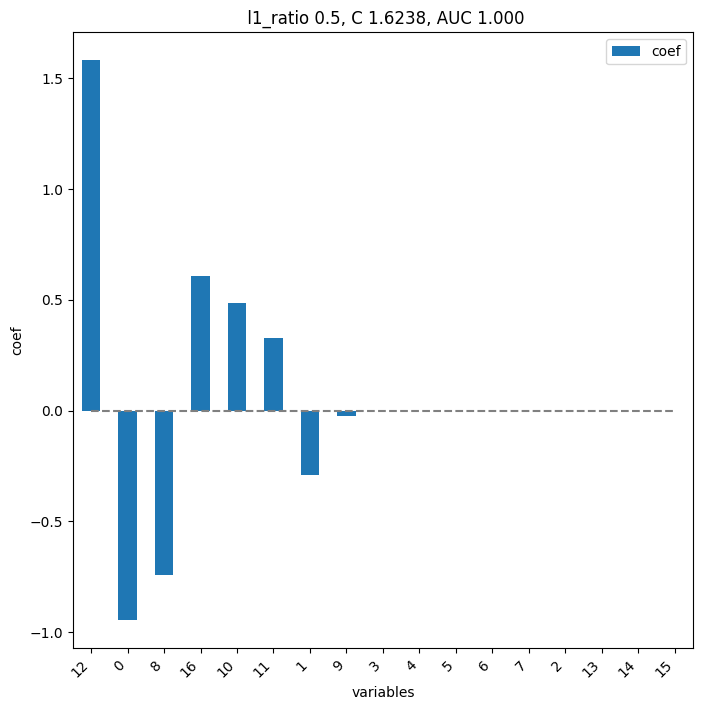

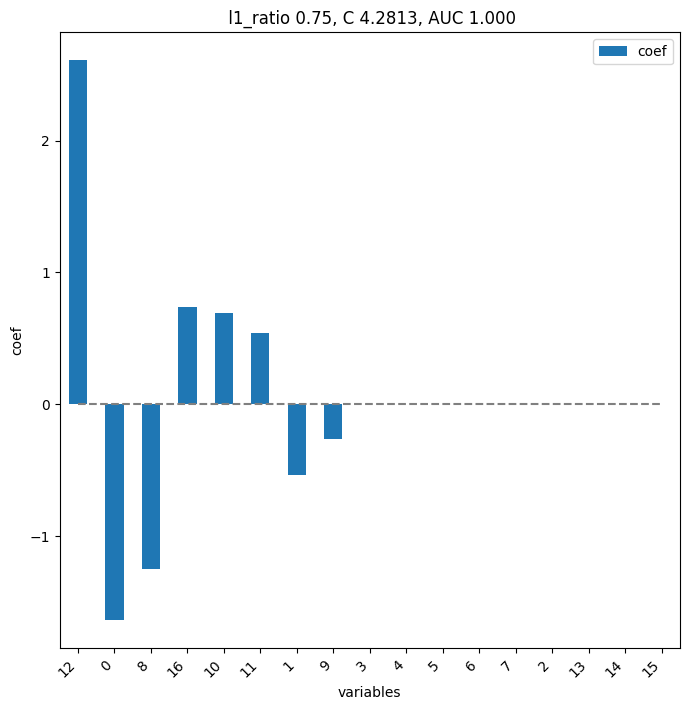

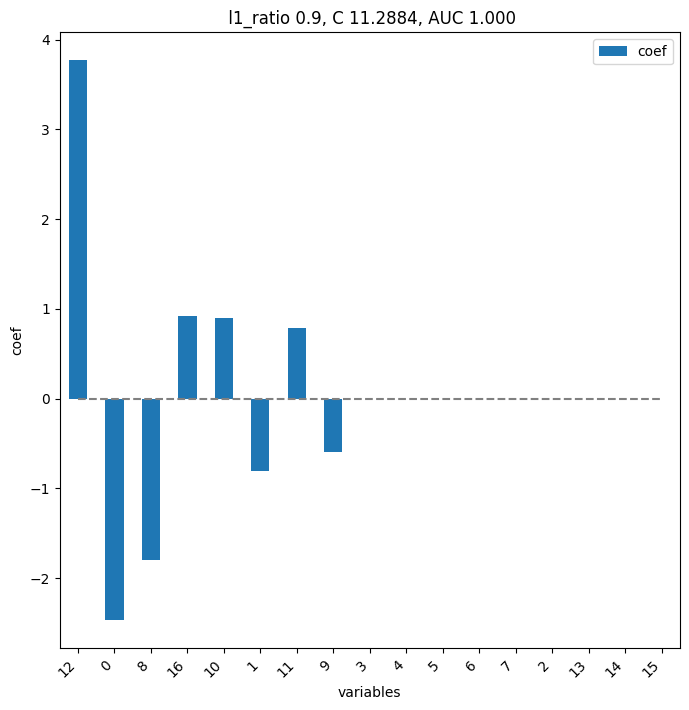

        pval  pval_corr
12  0.006993   0.118881
16  0.072844   0.551476
13  0.097319   0.551476
10  0.164918   0.700903
0   0.259324   0.734751
2   0.259324   0.734751
4   0.455711   0.862596
9   0.534965   0.862596
3   0.534965   0.862596
8   0.534965   0.862596
6   0.710373   0.862596
15  0.710373   0.862596
1   0.710373   0.862596
14  0.710373   0.862596
7   0.901515   0.957860
11  0.901515   0.957860
5   1.000000   1.000000


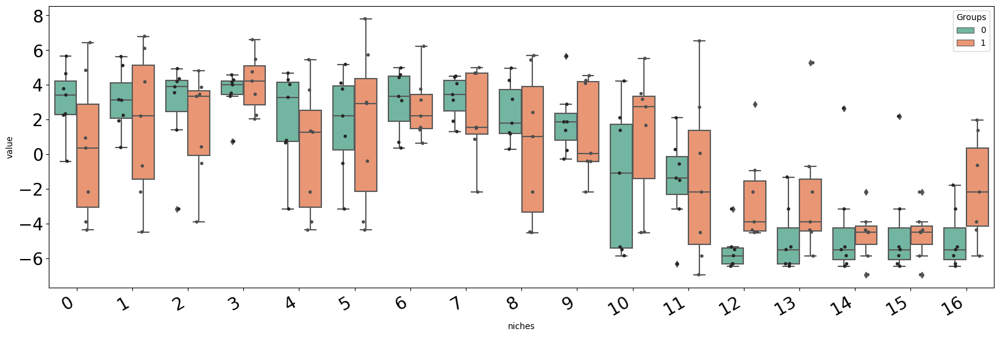

Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


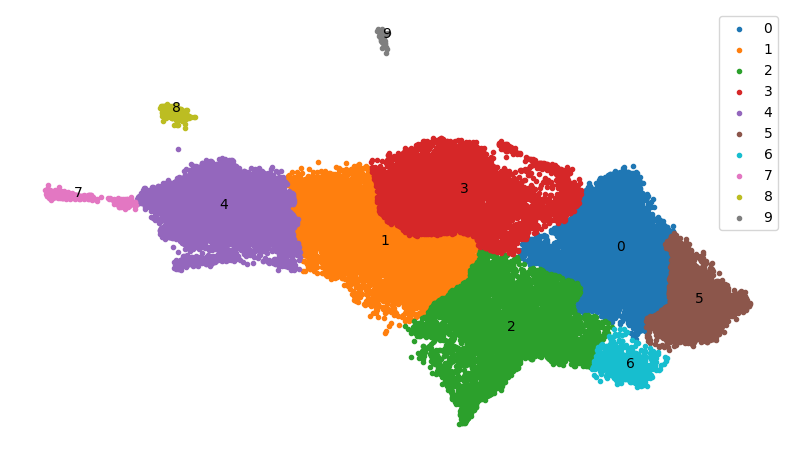

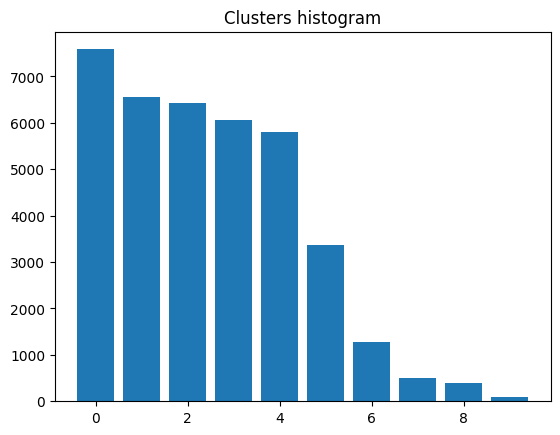

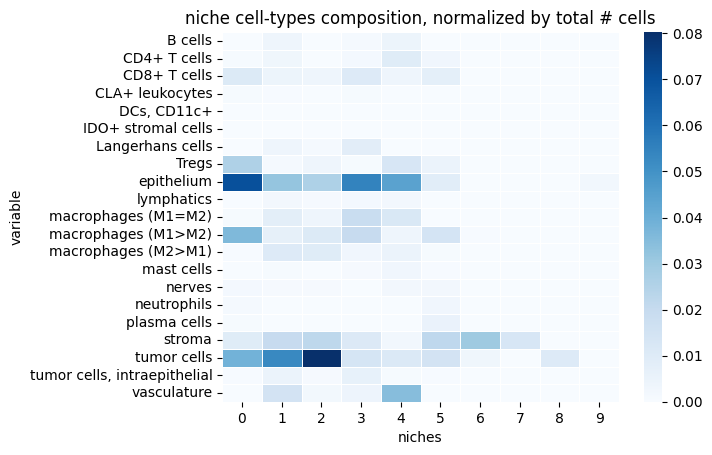

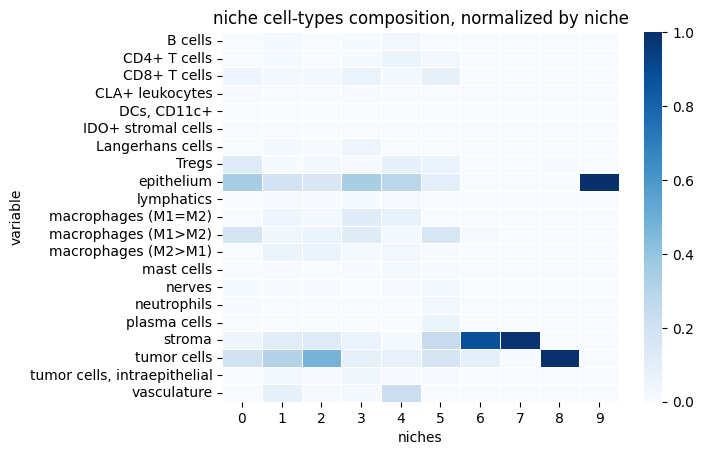

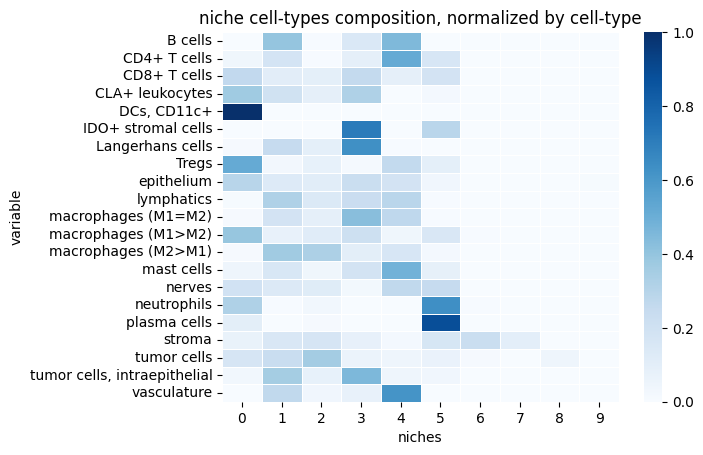

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


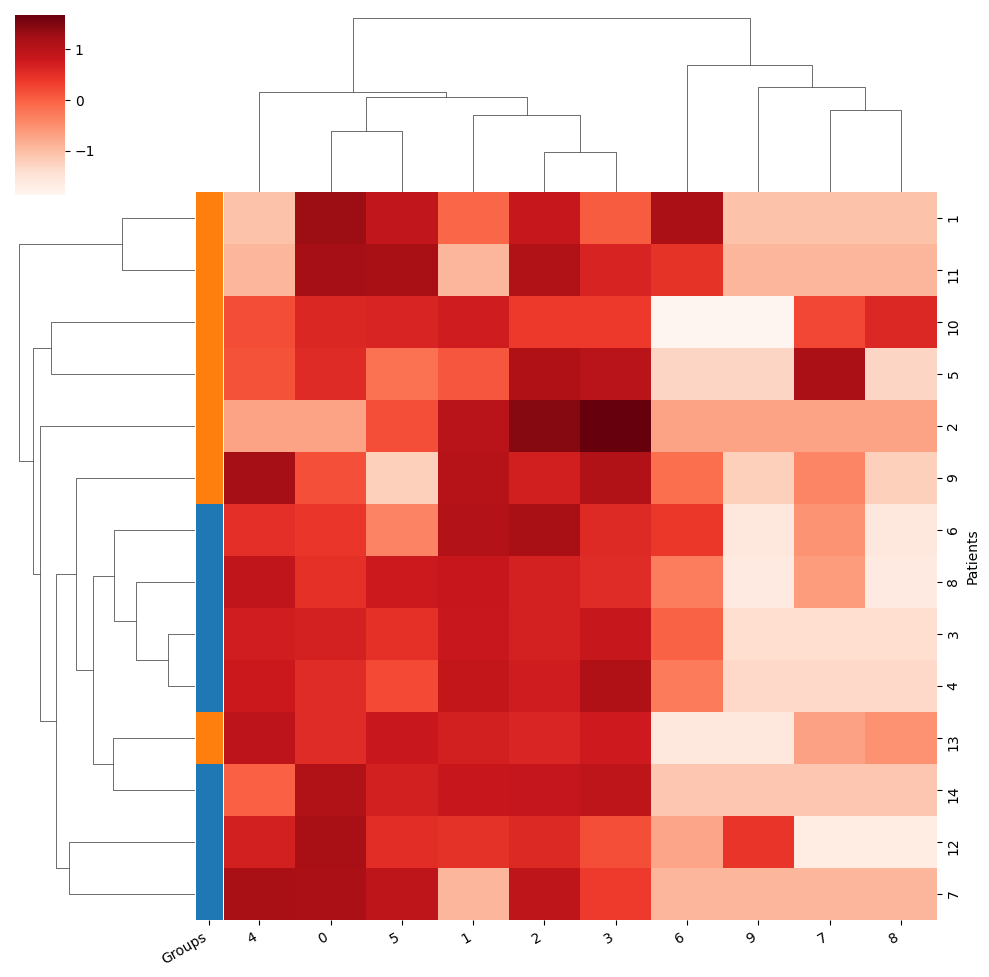

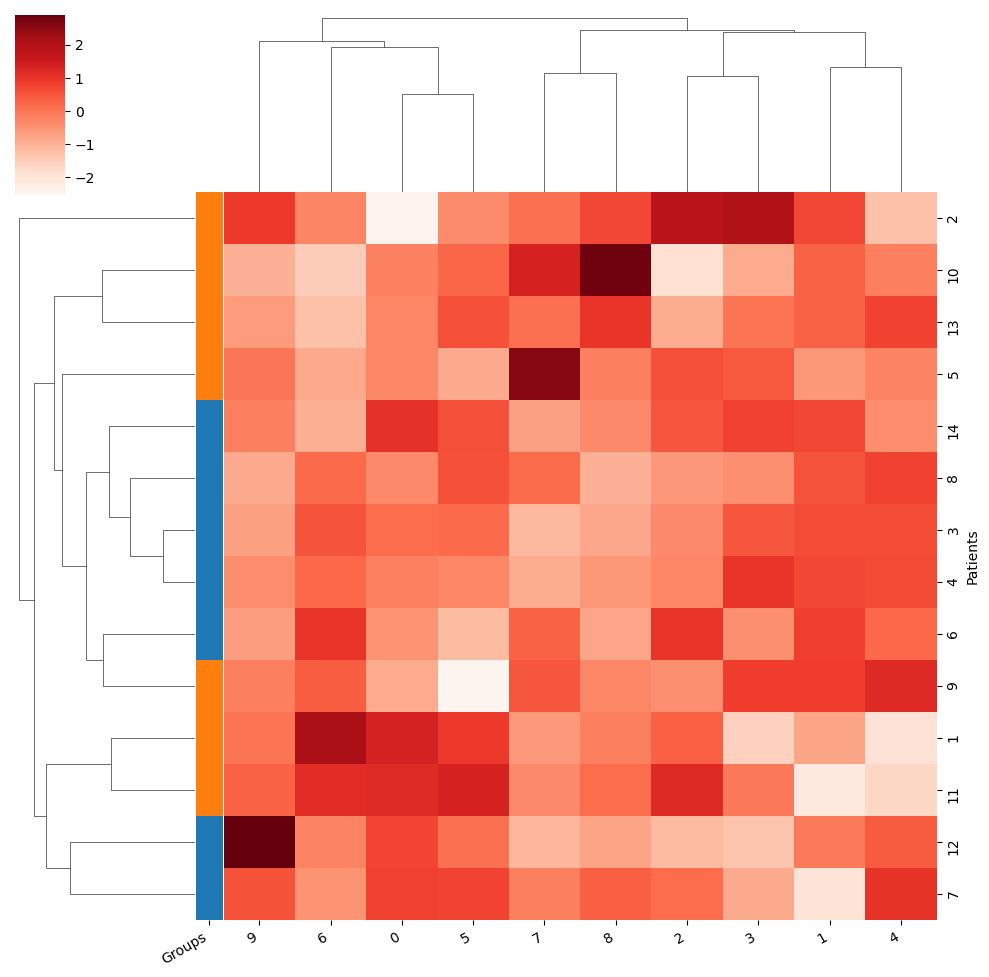

Training took 2.514s


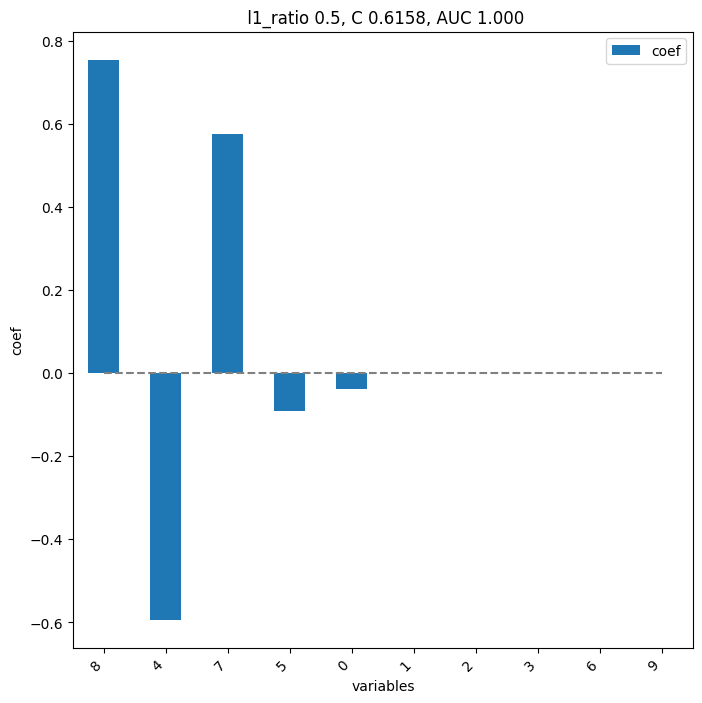

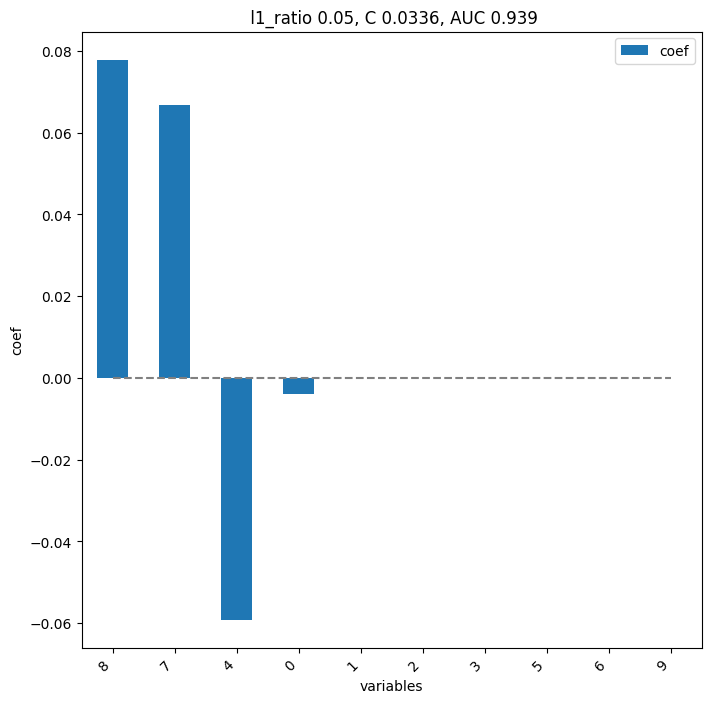

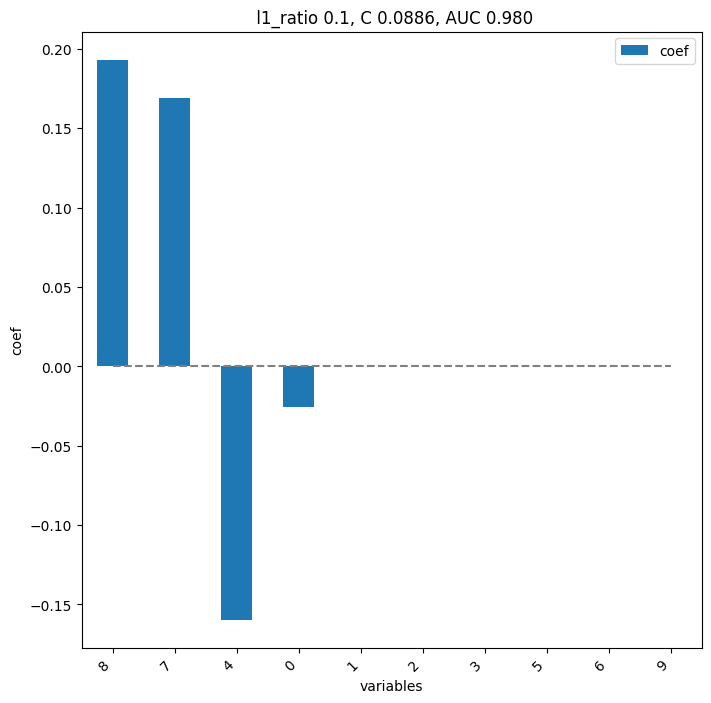

       pval  pval_corr
8  0.006993   0.069930
7  0.072844   0.364219
4  0.259324   0.864413
1  0.534965   1.000000
0  0.620047   1.000000
9  0.620047   1.000000
2  0.710373   1.000000
6  0.804779   1.000000
3  0.901515   1.000000
5  1.000000   1.000000


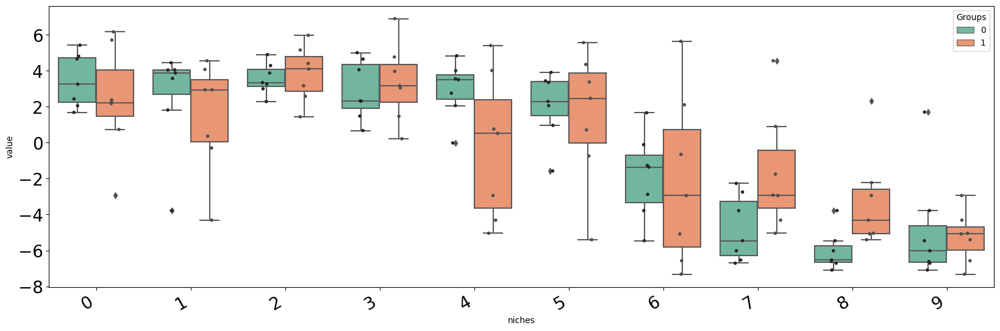

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


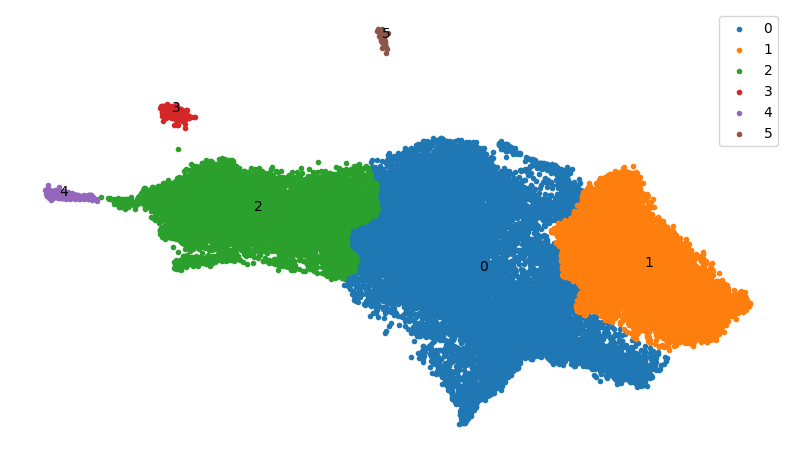

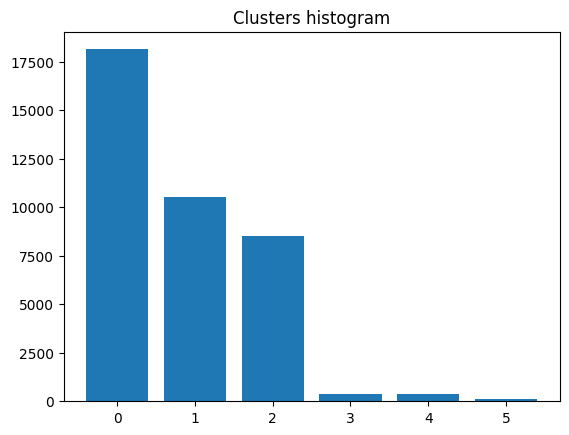

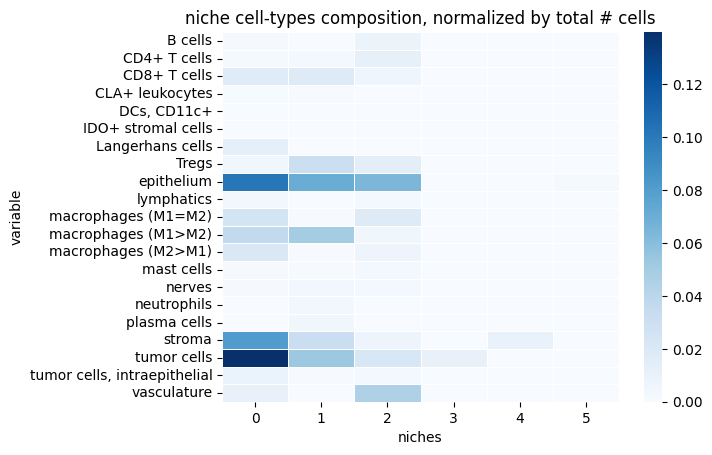

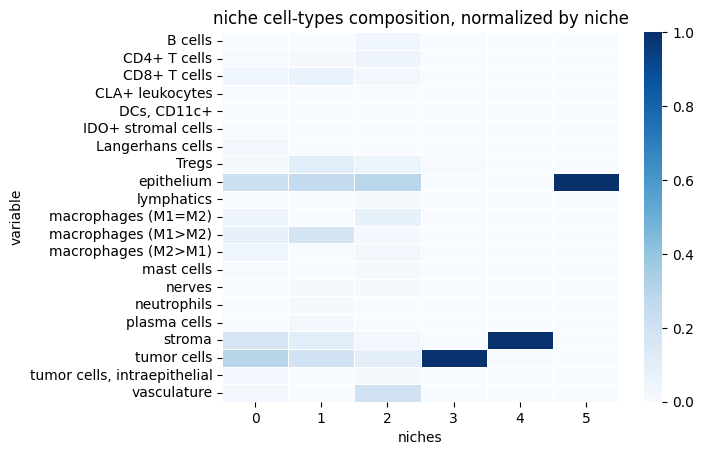

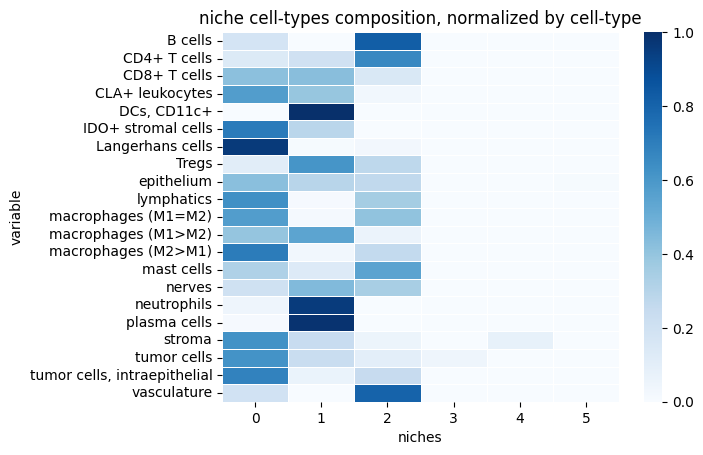

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


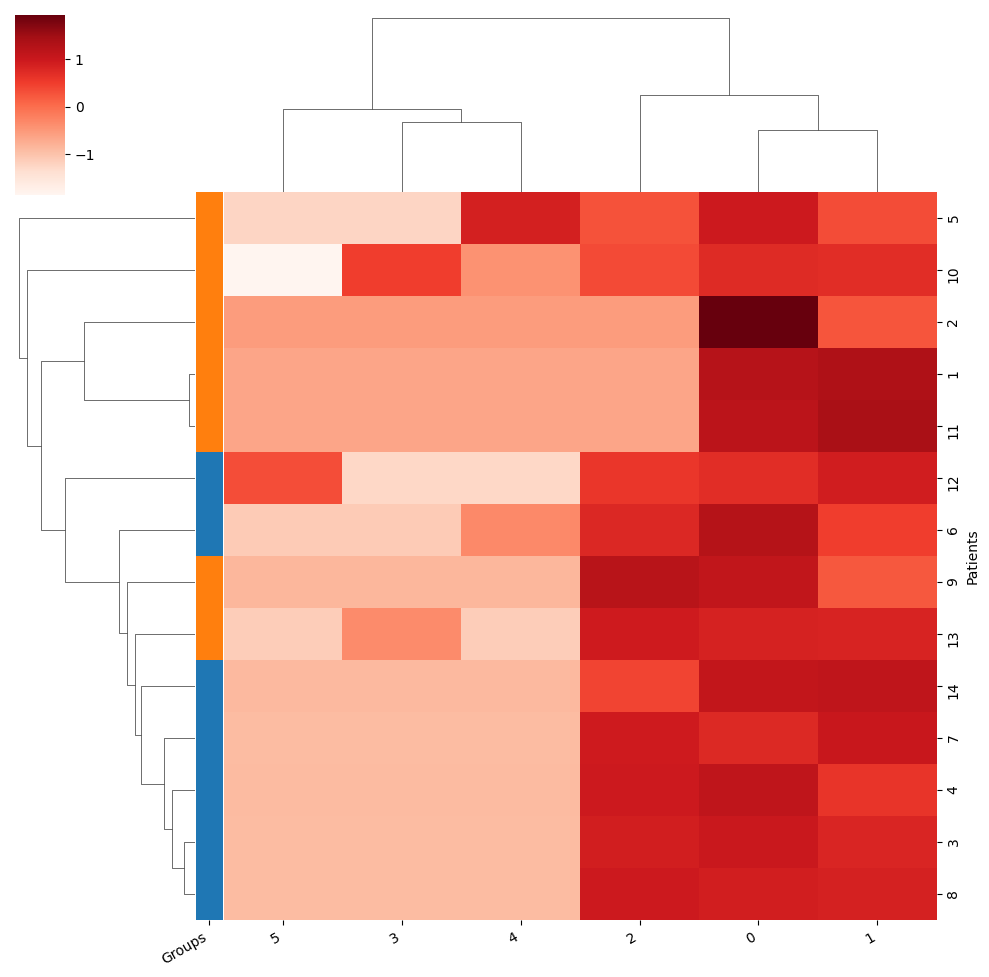

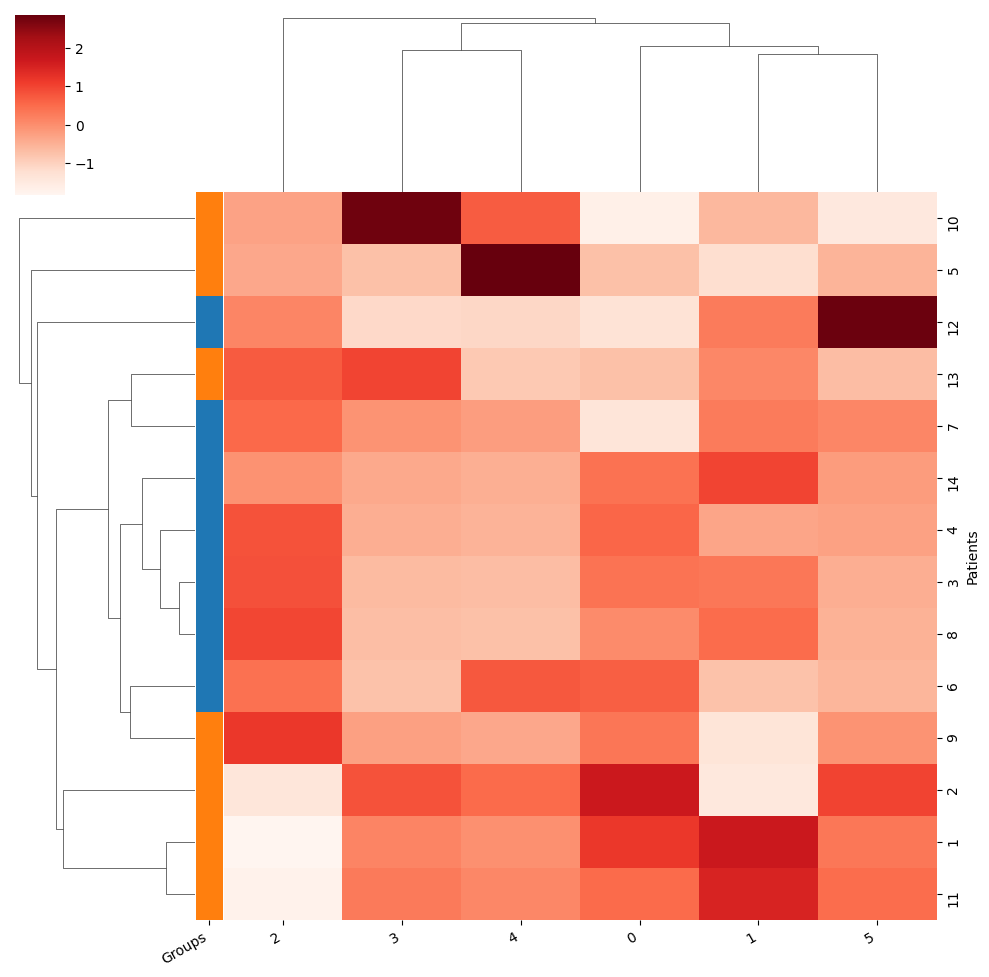

Training took 2.414s


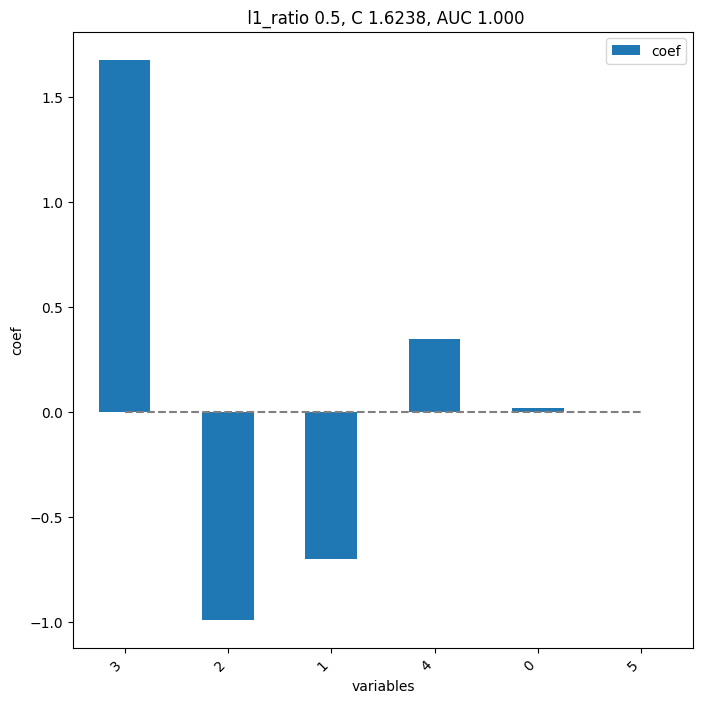

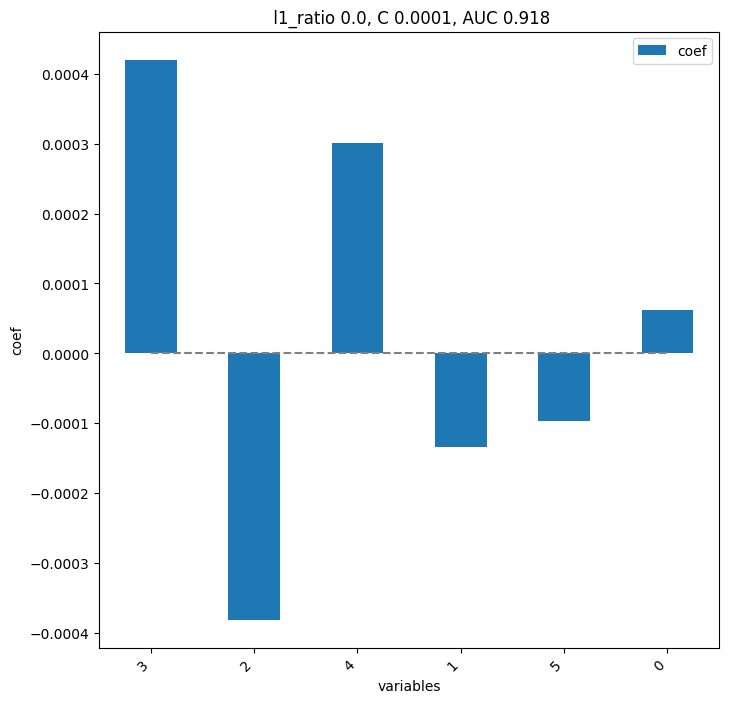

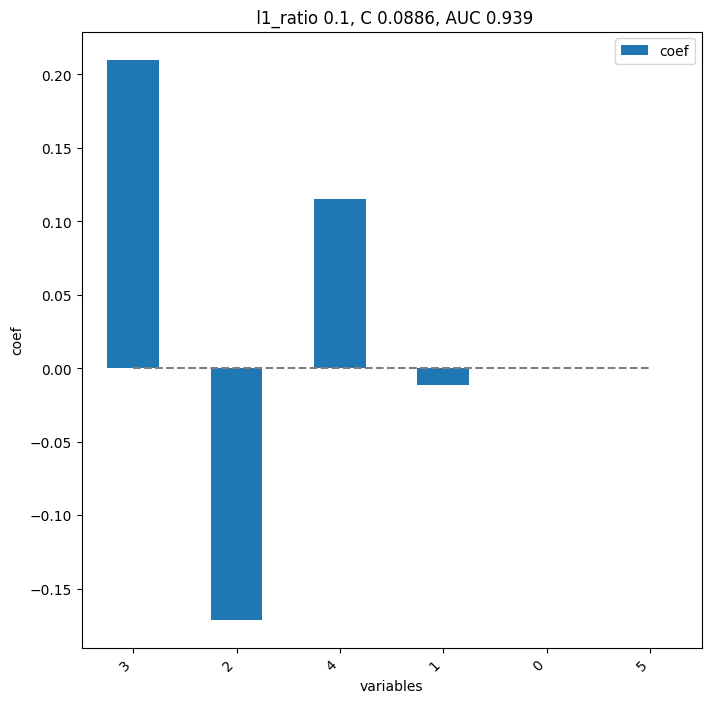

       pval  pval_corr
3  0.017483   0.104895
2  0.097319   0.256410
4  0.128205   0.256410
1  0.382867   0.574301
0  0.901515   1.000000
5  1.000000   1.000000


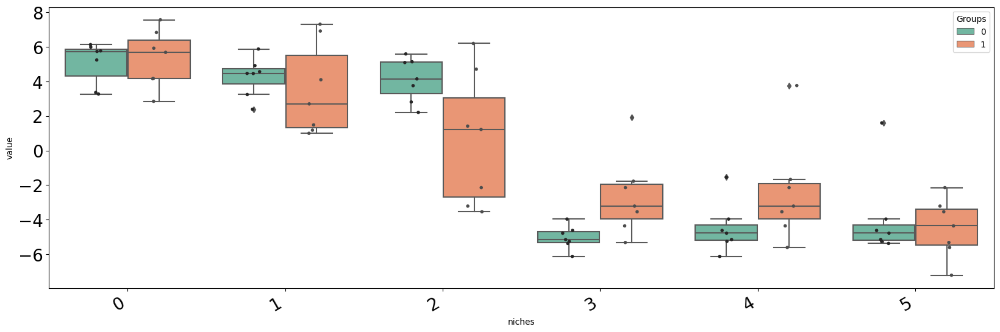

Loading clusterer object and cluster labels
There are 8 clusters
Loading reducer object and reduced coordinates


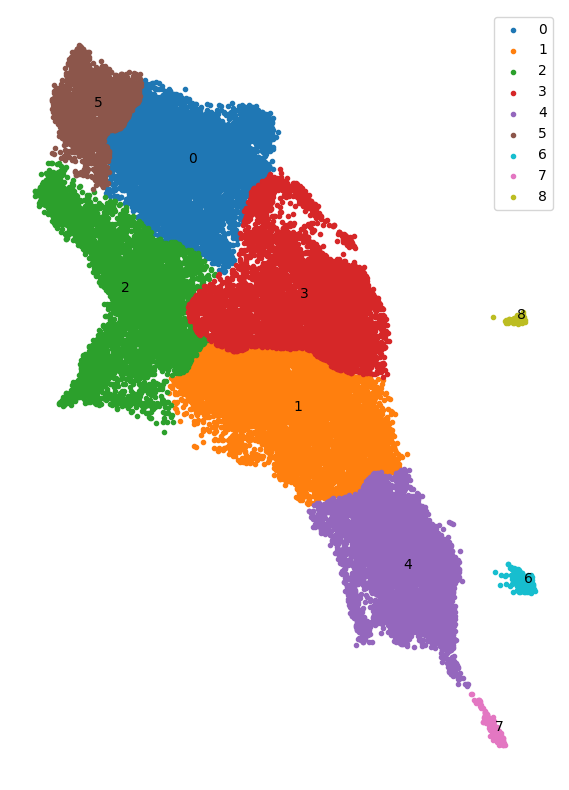

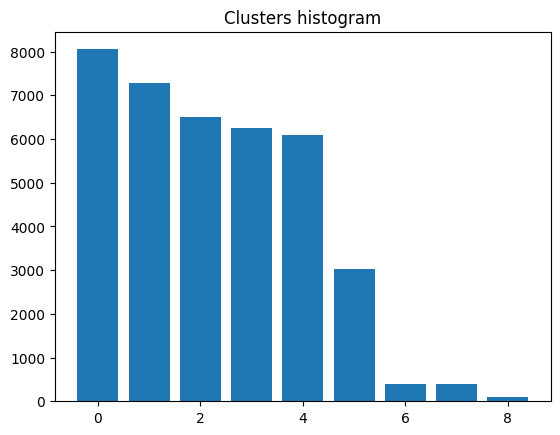

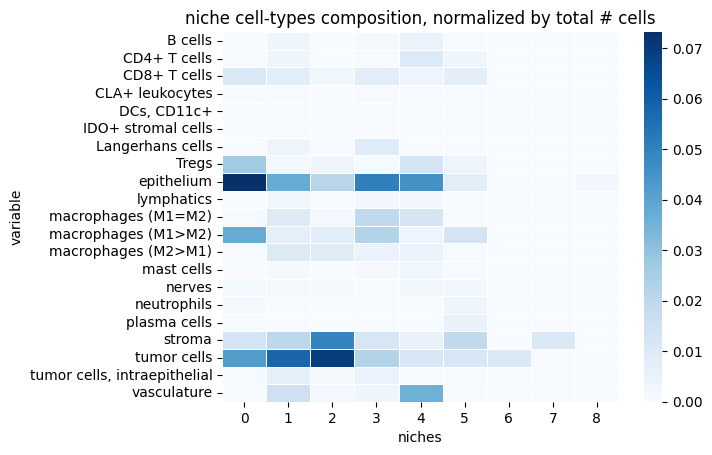

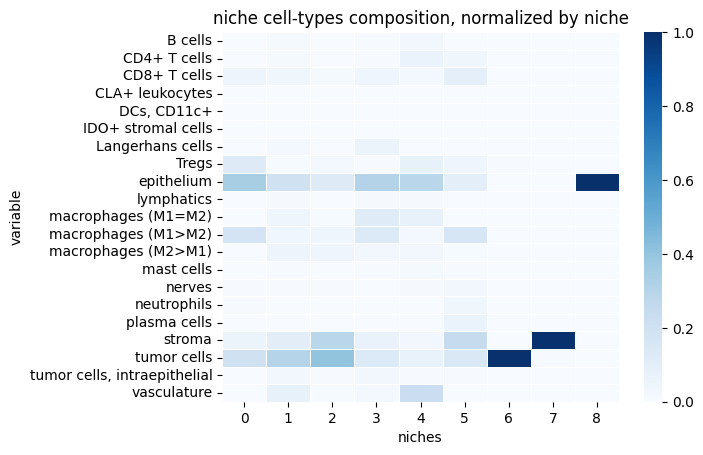

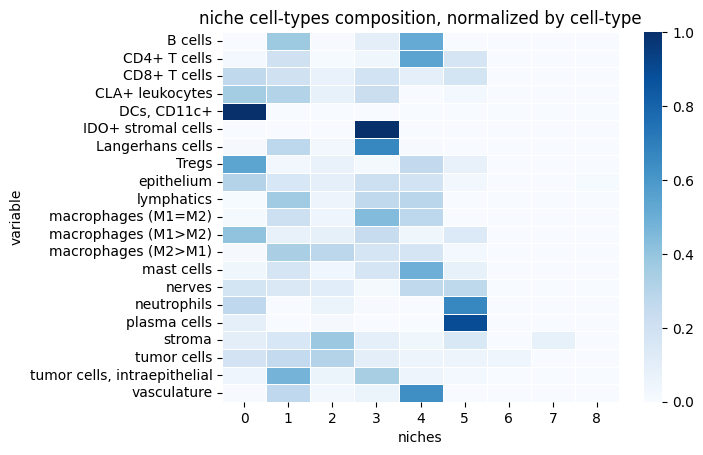

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


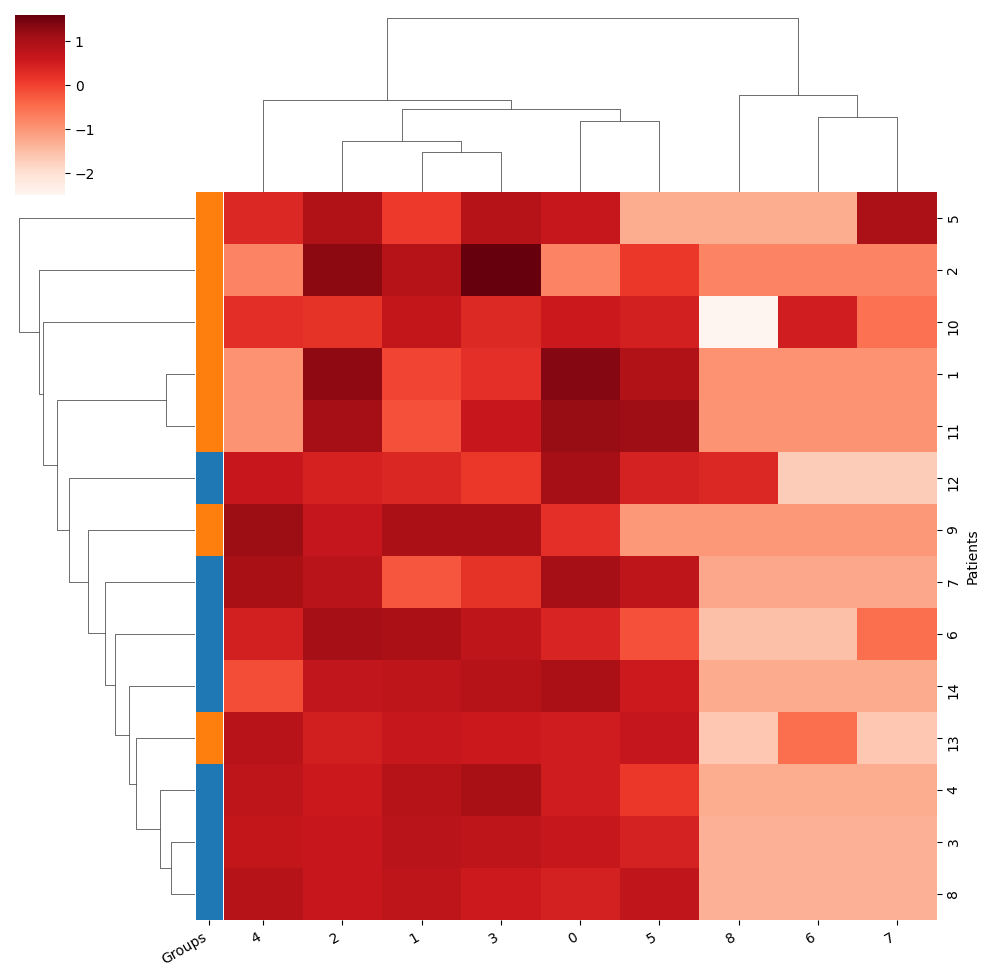

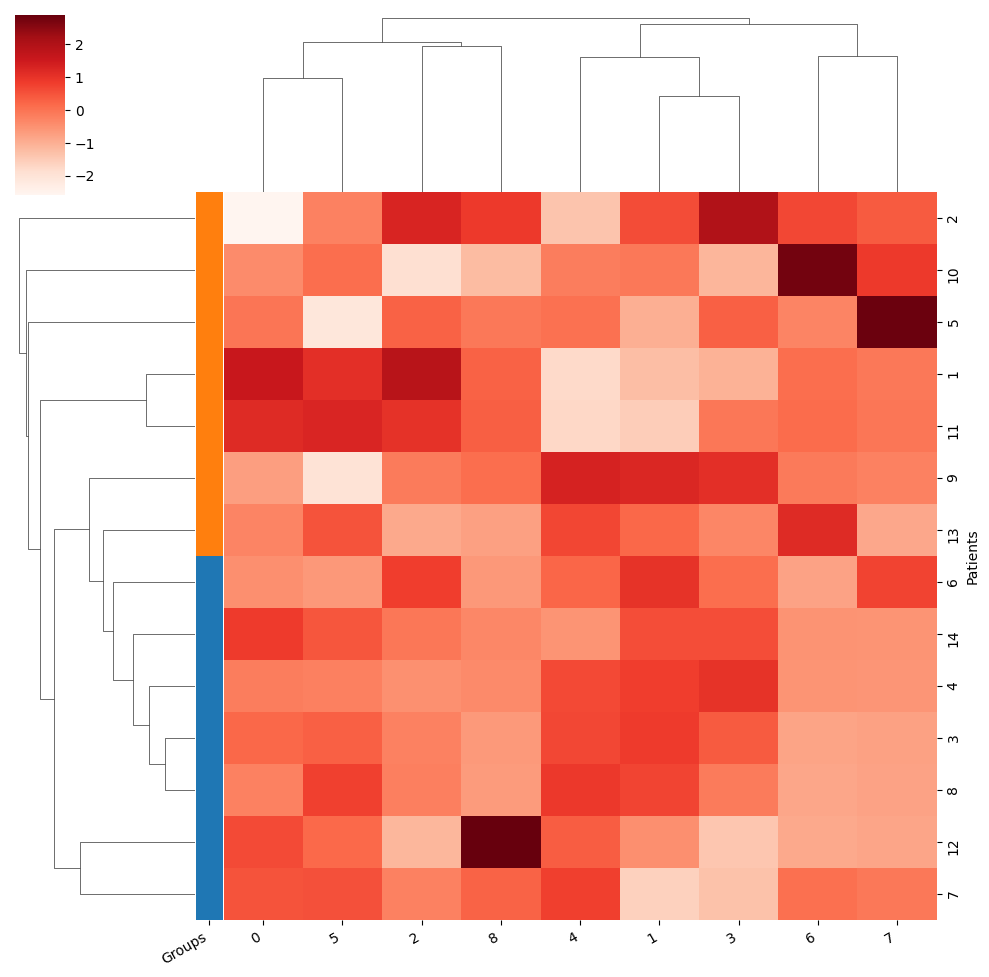

Training took 2.444s


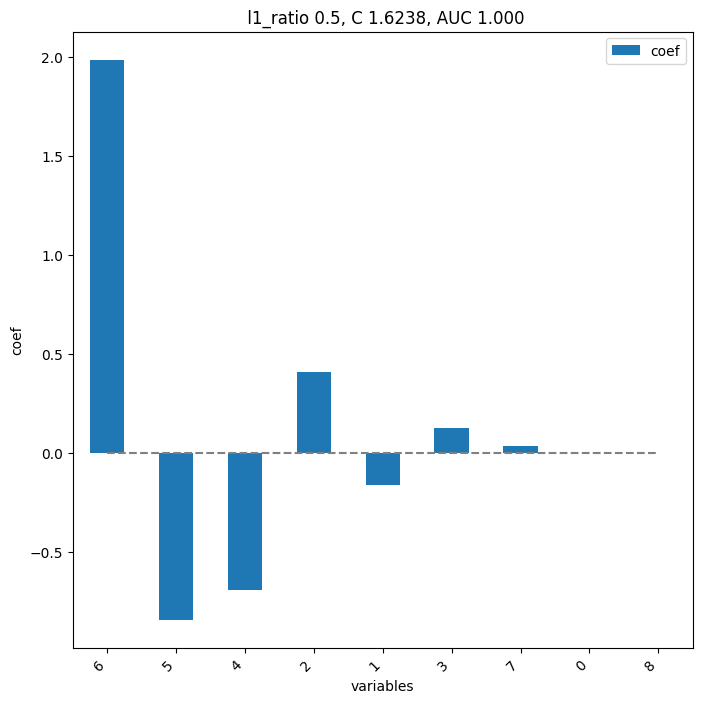

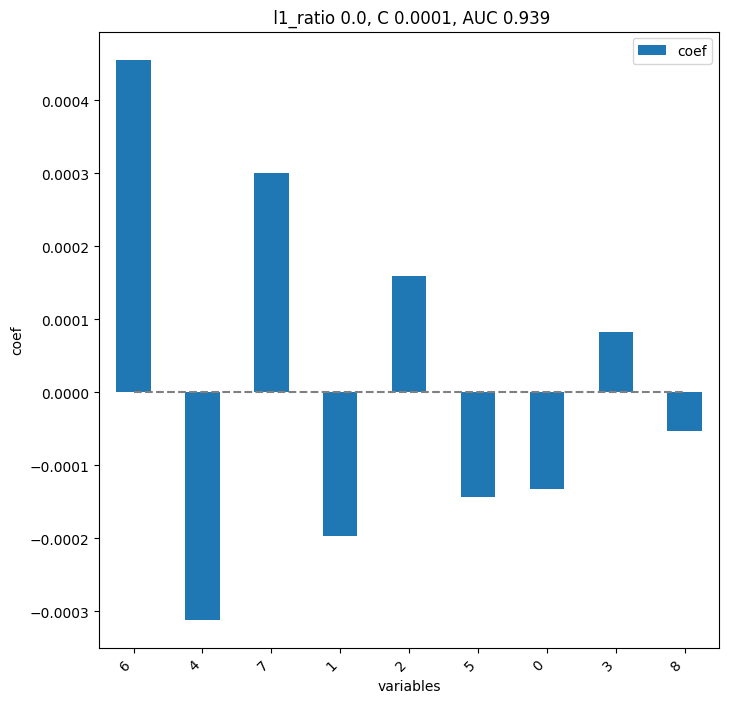

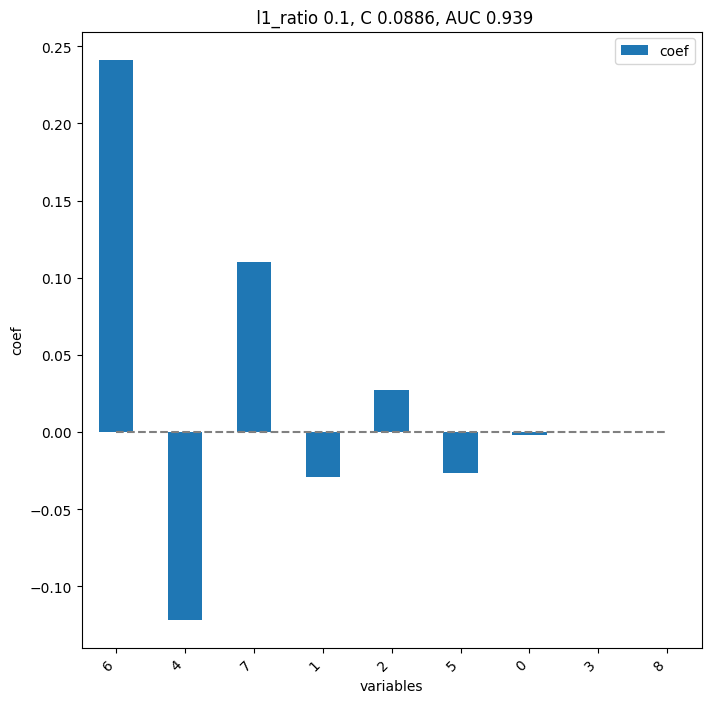

       pval  pval_corr
6  0.002331   0.020979
7  0.128205   0.576923
4  0.208625   0.625874
2  0.317599   0.689161
1  0.382867   0.689161
0  0.534965   0.802448
8  0.710373   0.804779
3  0.804779   0.804779
5  0.804779   0.804779


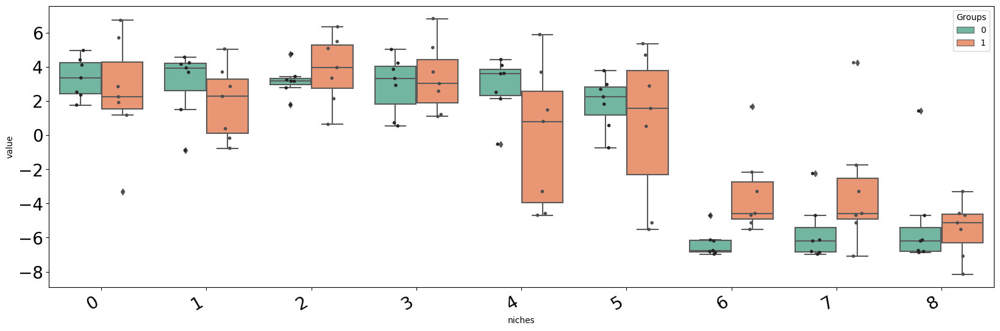

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


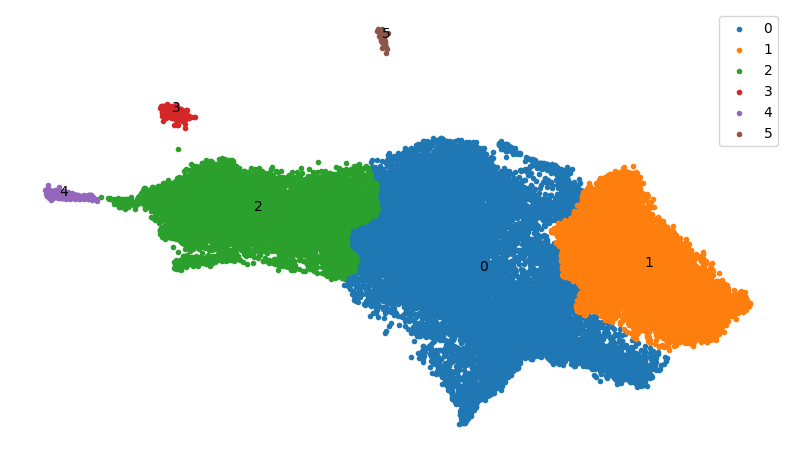

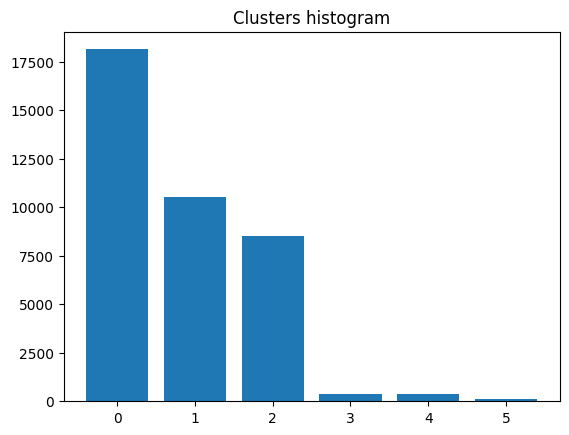

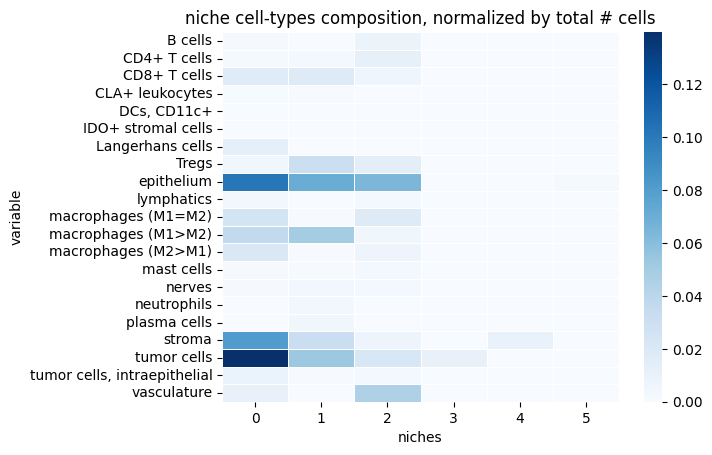

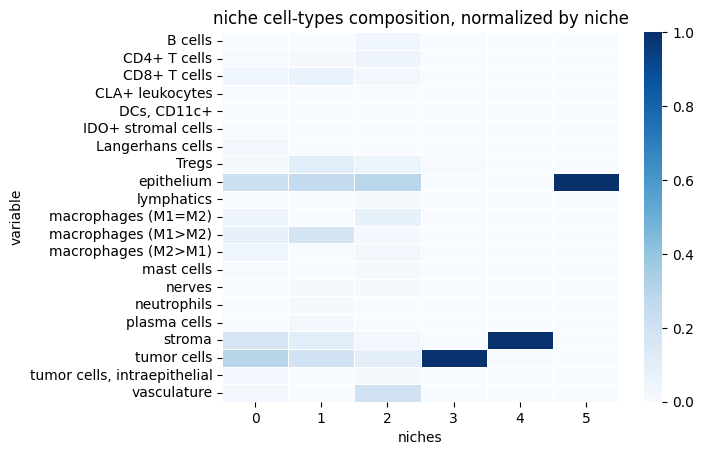

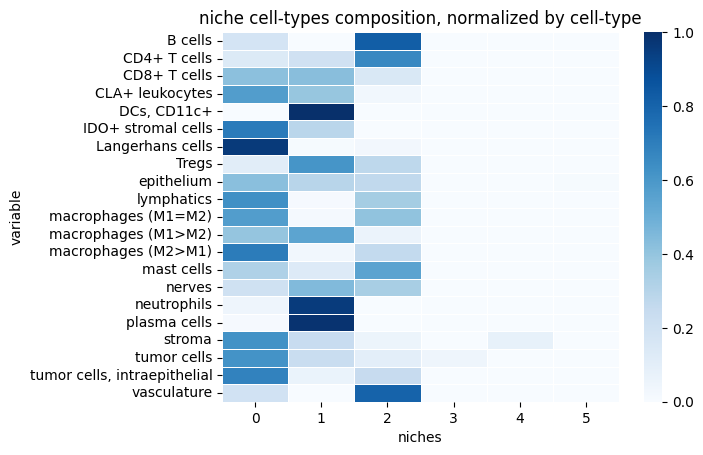

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


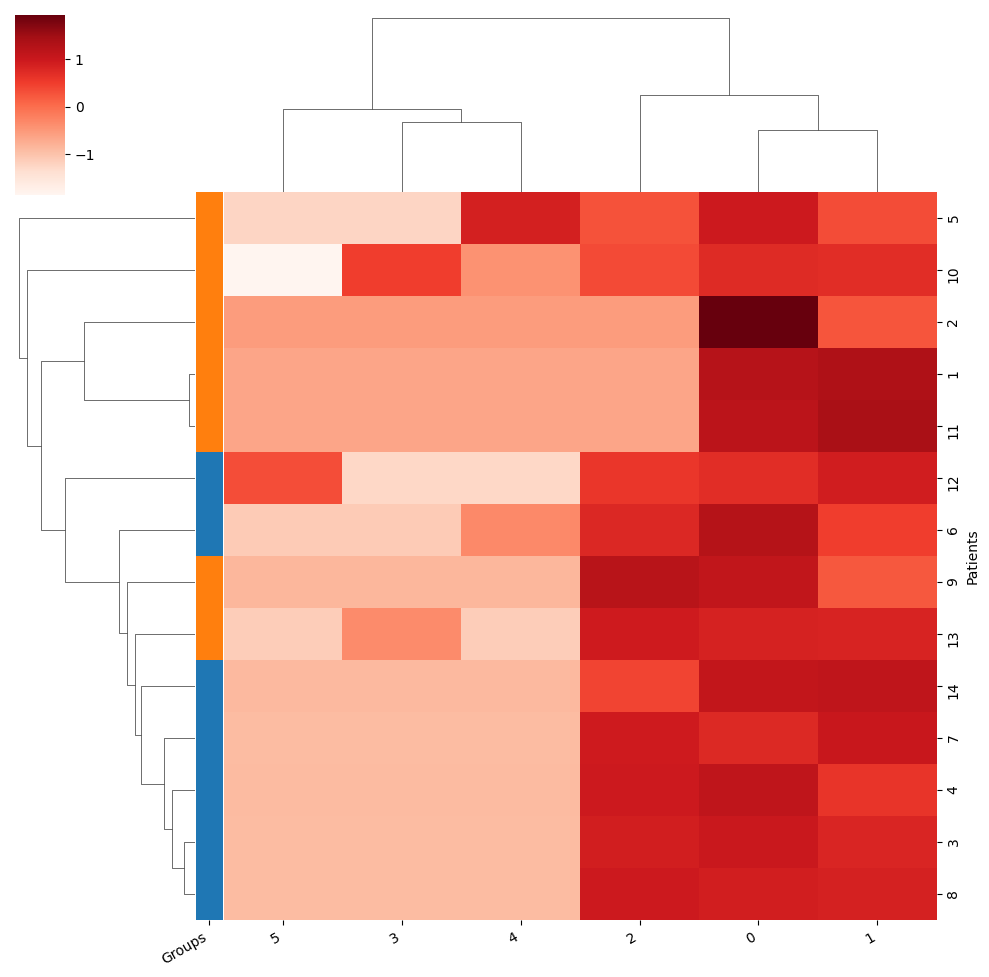

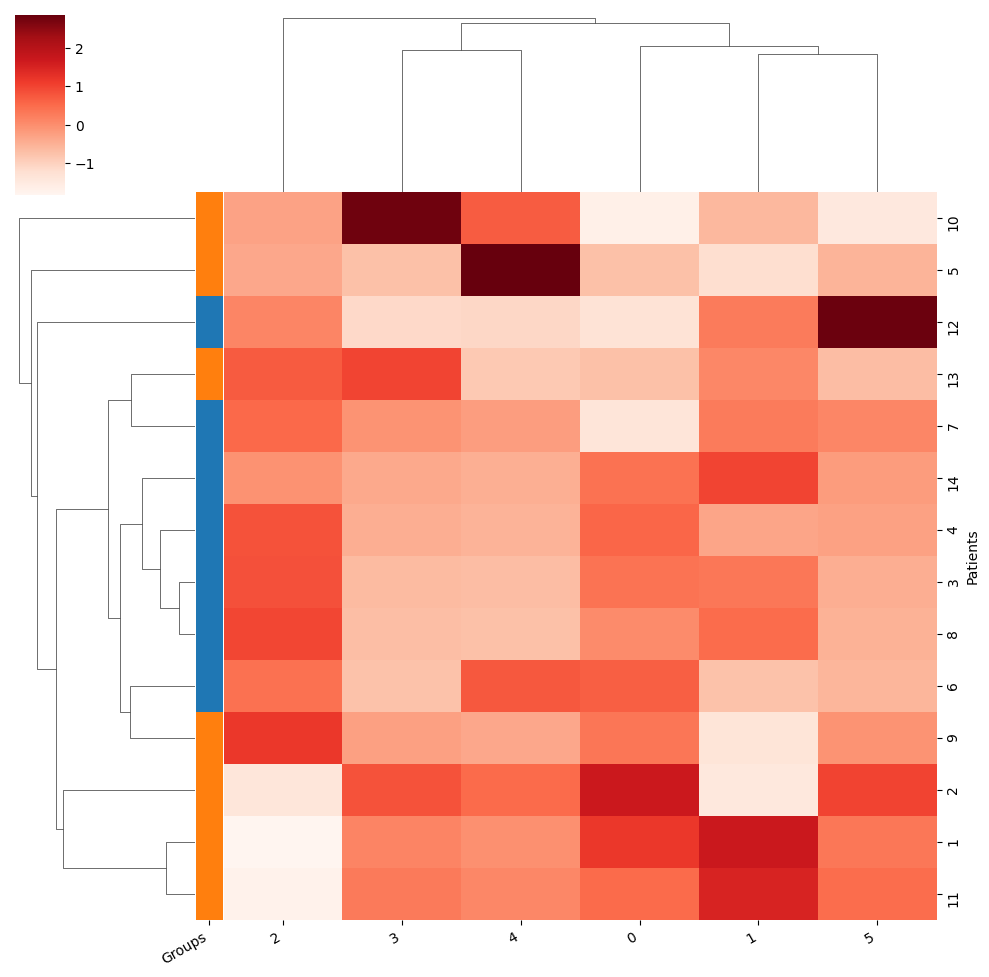

Training took 2.440s


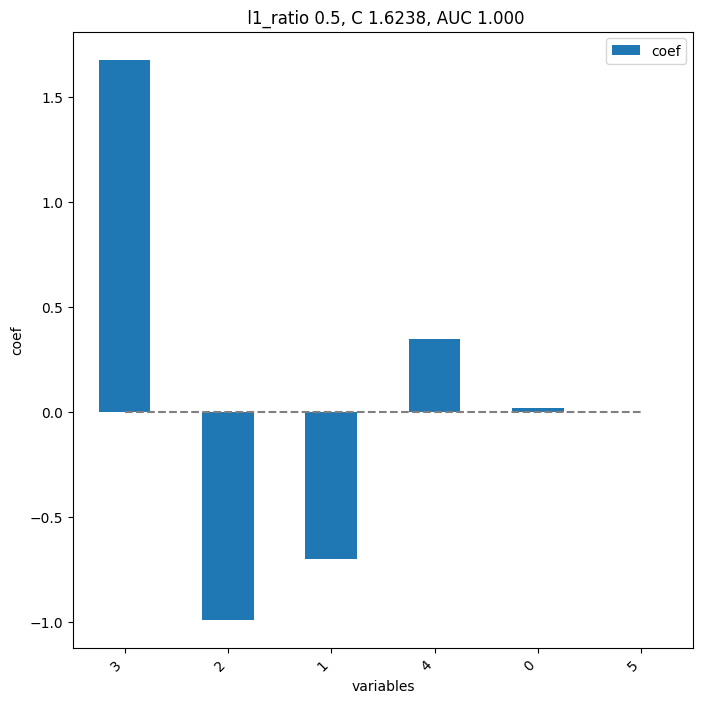

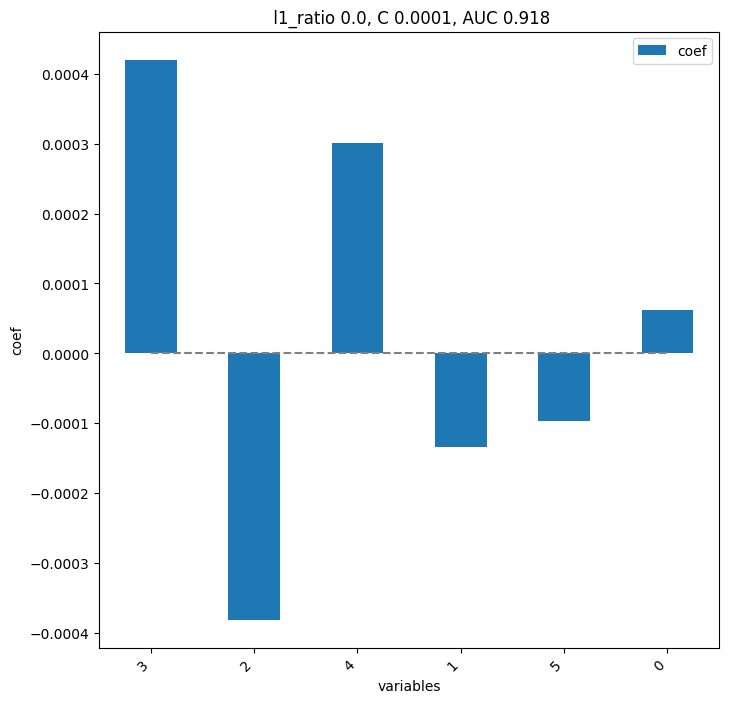

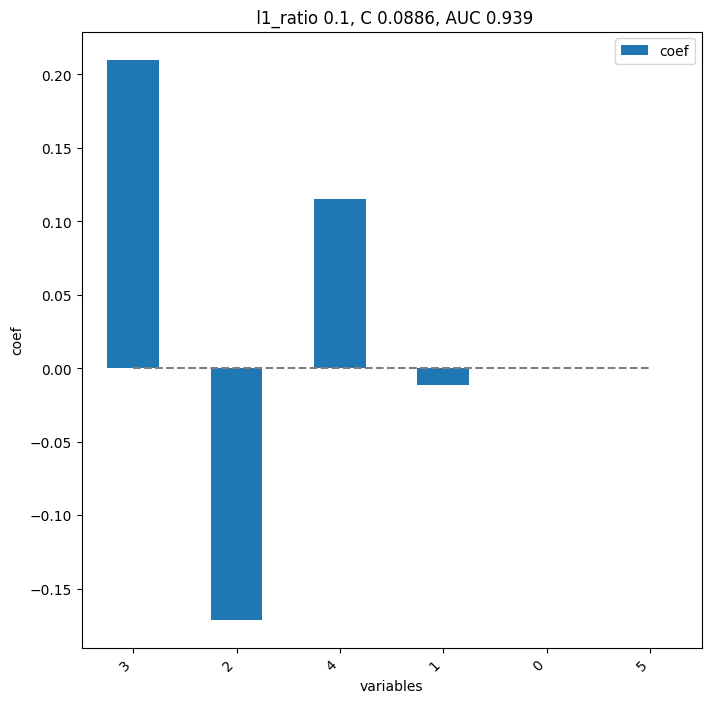

       pval  pval_corr
3  0.017483   0.104895
2  0.097319   0.256410
4  0.128205   0.256410
1  0.382867   0.574301
0  0.901515   1.000000
5  1.000000   1.000000


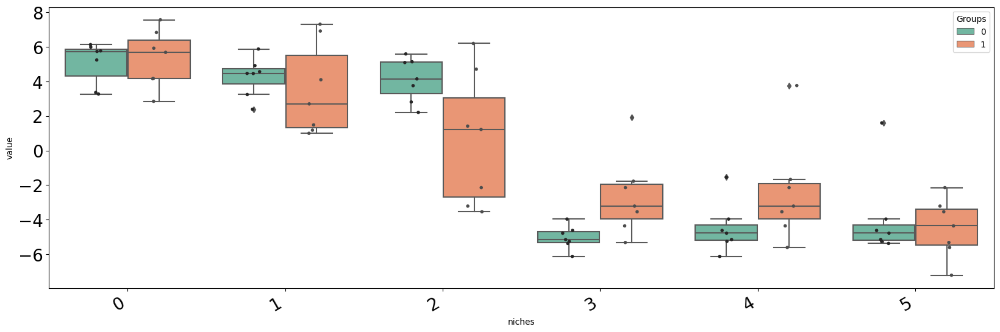

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-45', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 16 clusters
Loading reducer object and reduced coordinates


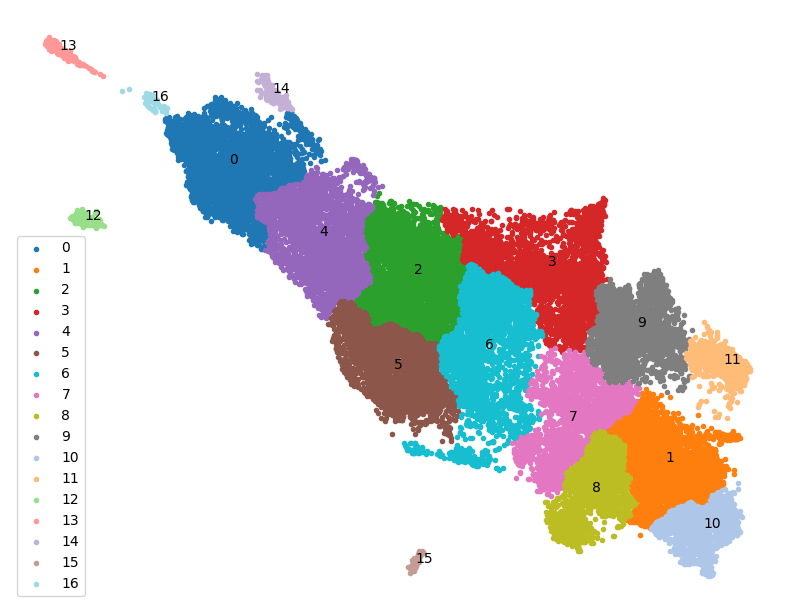

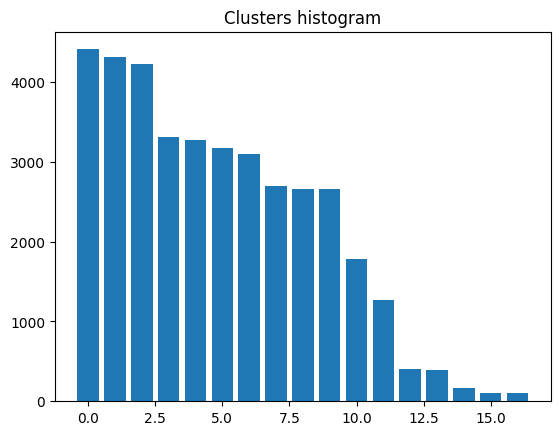

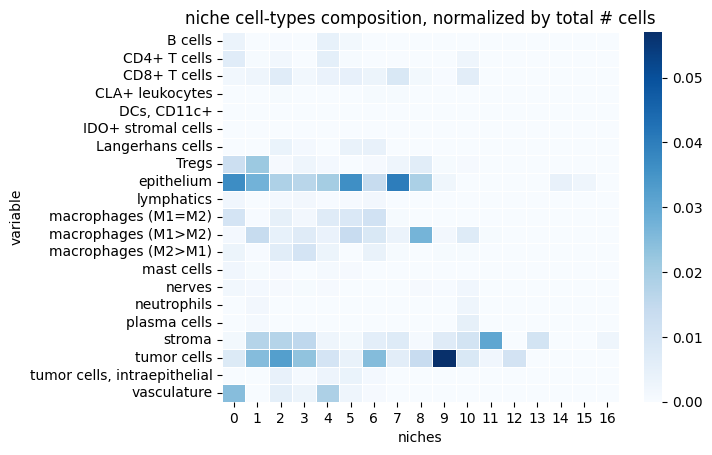

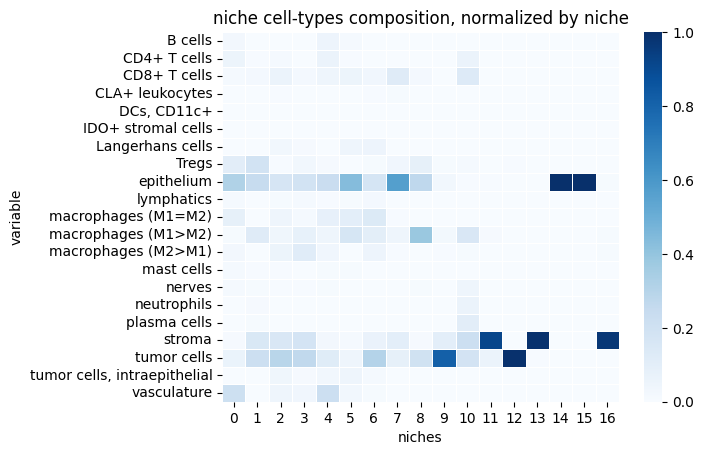

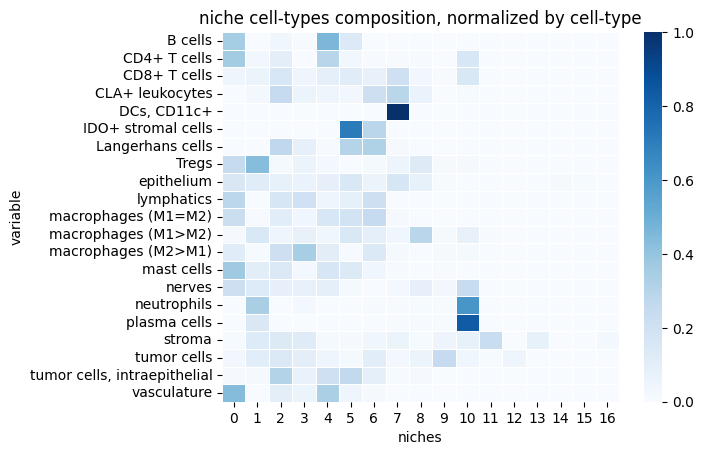

reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


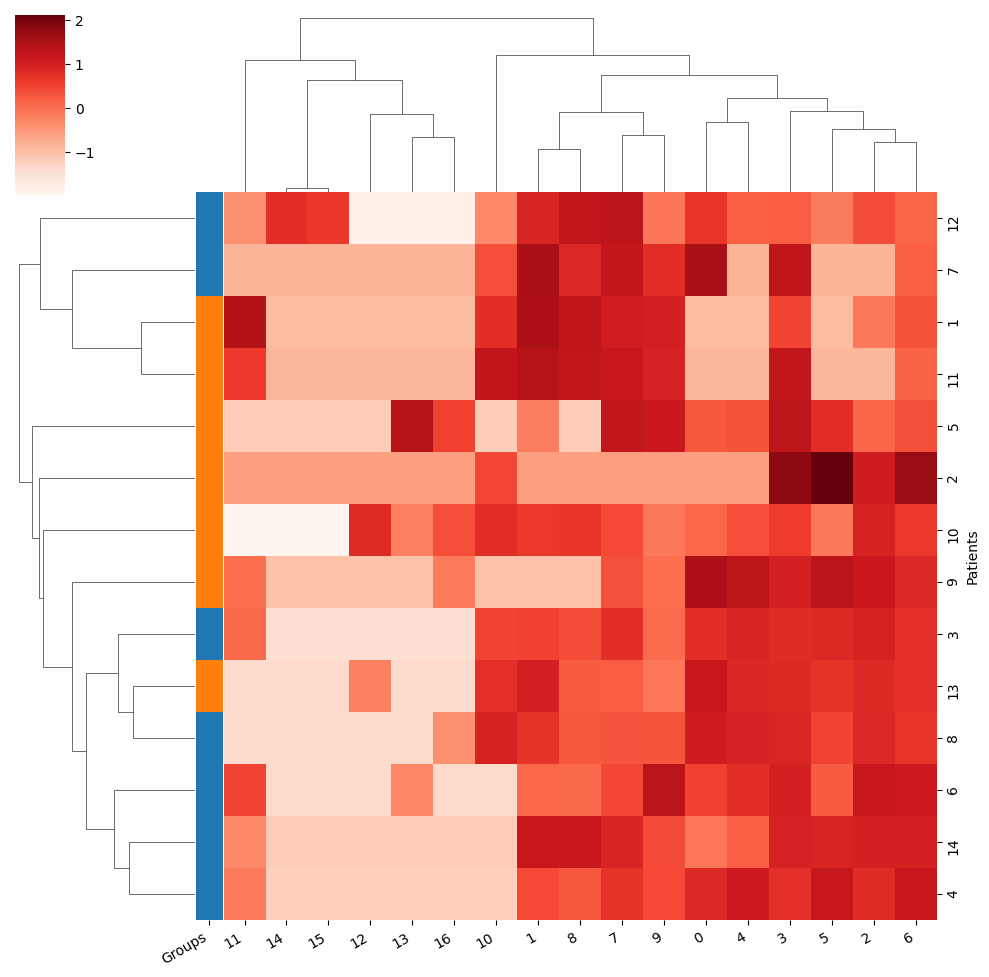

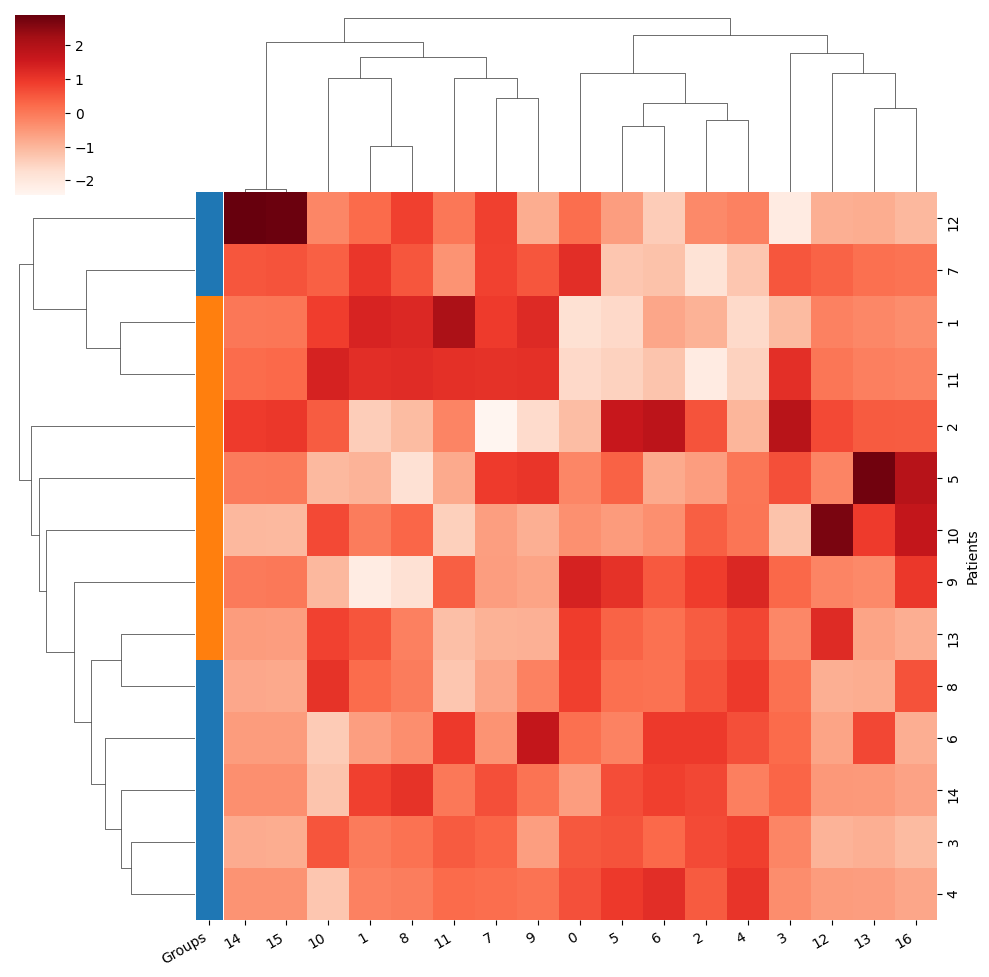

Training took 2.472s


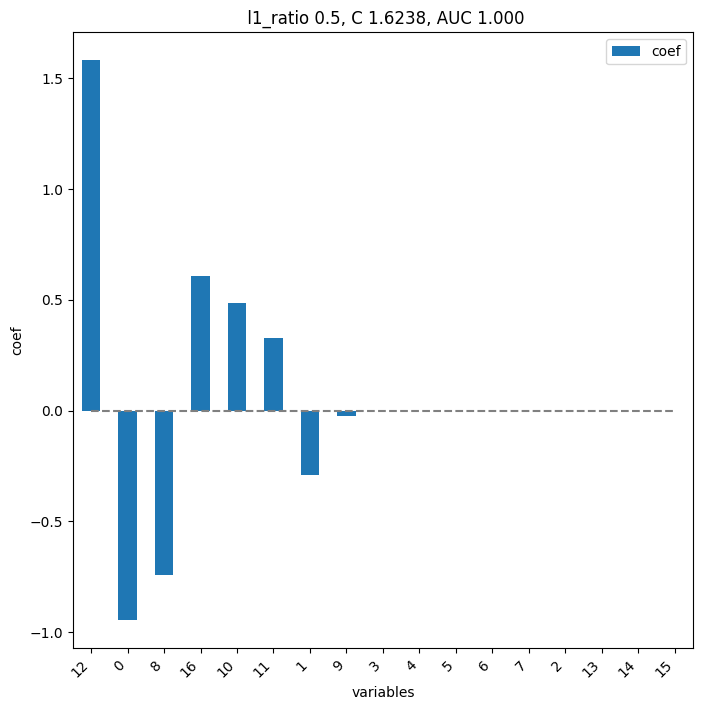

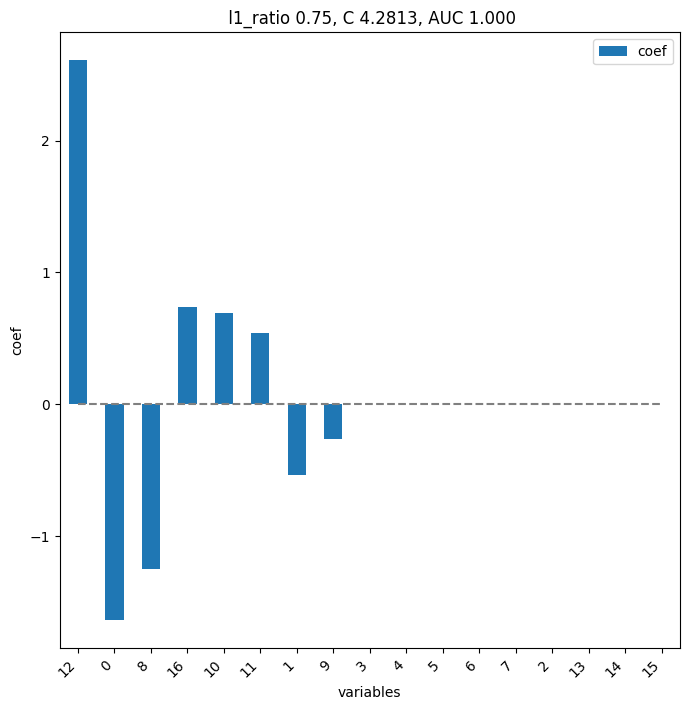

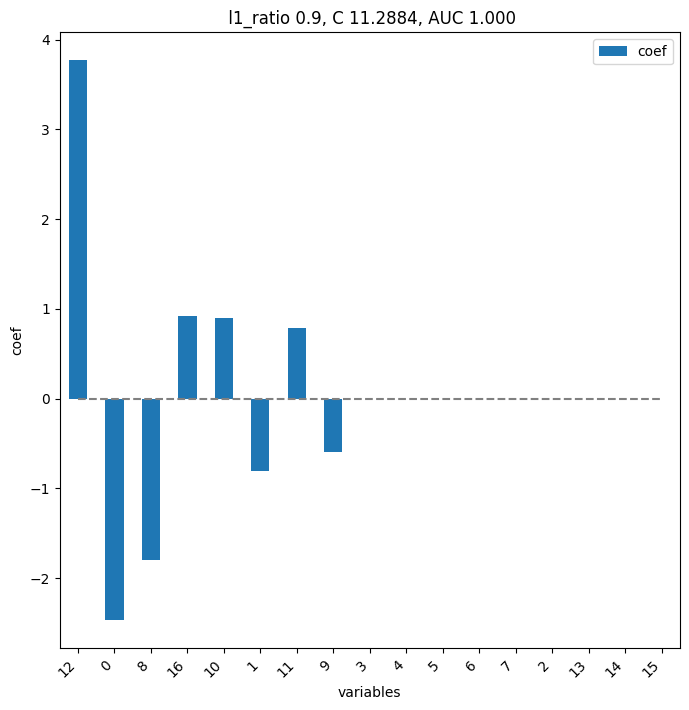

        pval  pval_corr
12  0.006993   0.118881
16  0.072844   0.551476
13  0.097319   0.551476
10  0.164918   0.700903
0   0.259324   0.734751
2   0.259324   0.734751
4   0.455711   0.862596
9   0.534965   0.862596
3   0.534965   0.862596
8   0.534965   0.862596
6   0.710373   0.862596
15  0.710373   0.862596
1   0.710373   0.862596
14  0.710373   0.862596
7   0.901515   0.957860
11  0.901515   0.957860
5   1.000000   1.000000


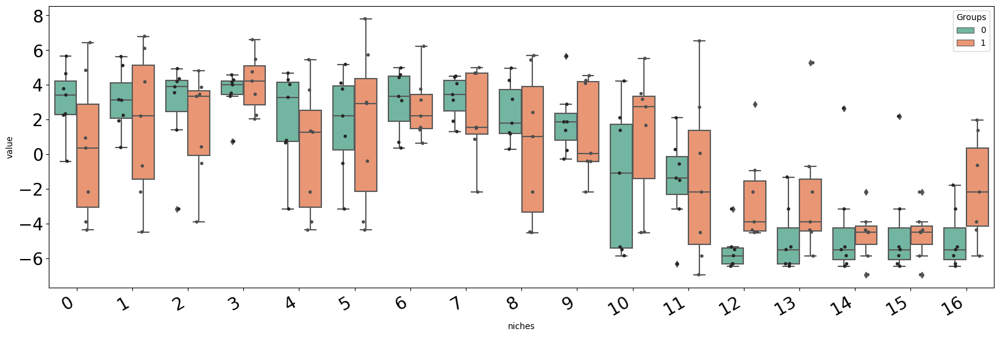

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


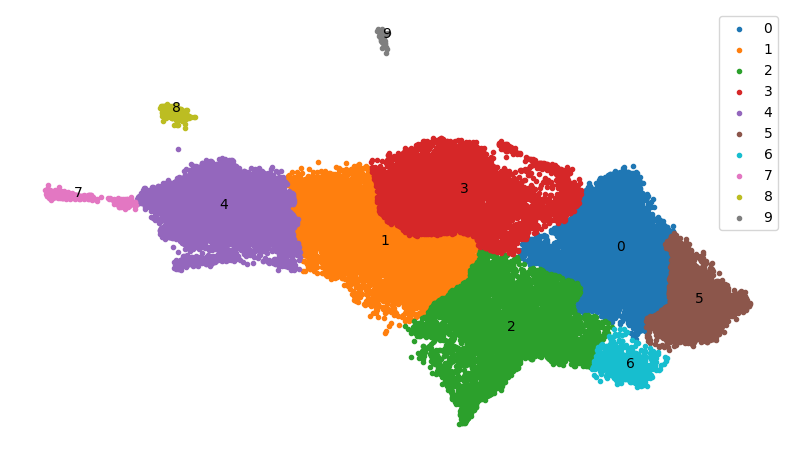

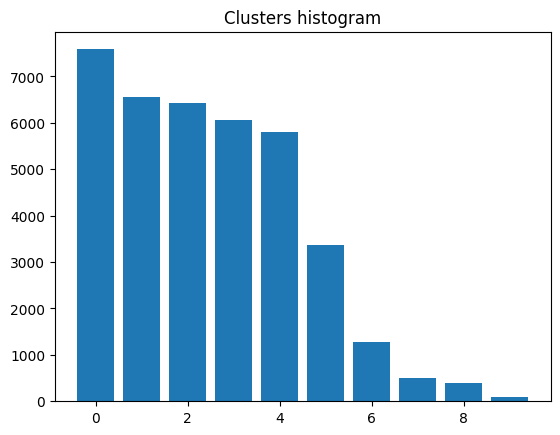

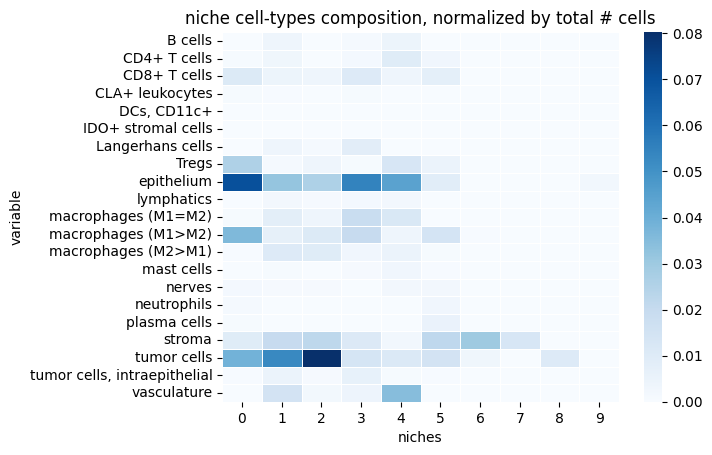

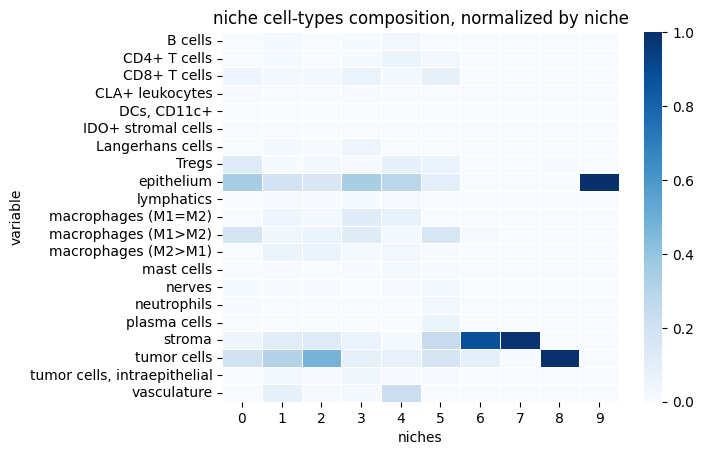

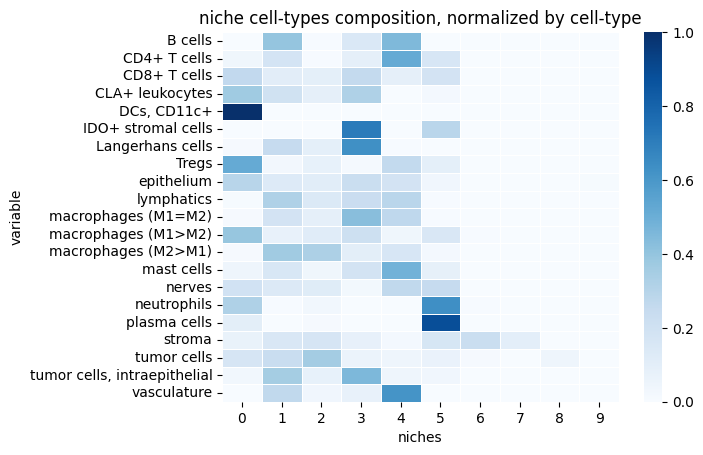

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


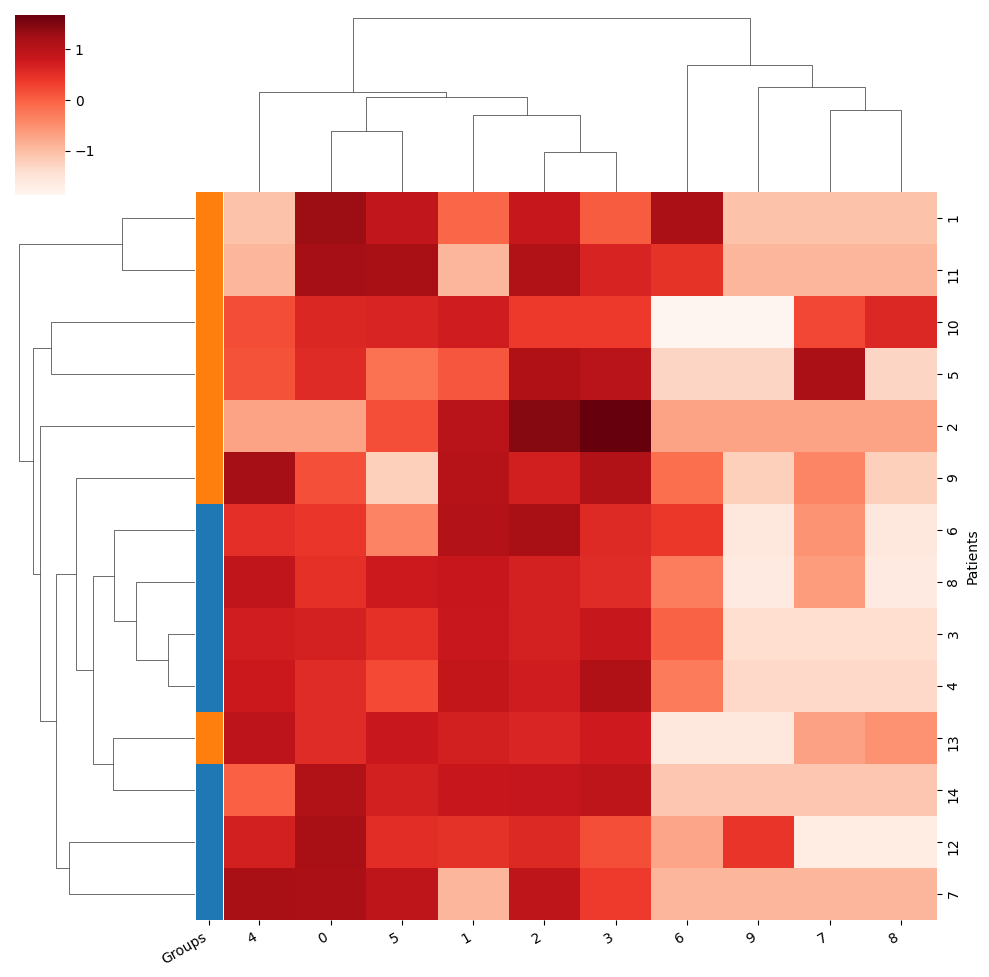

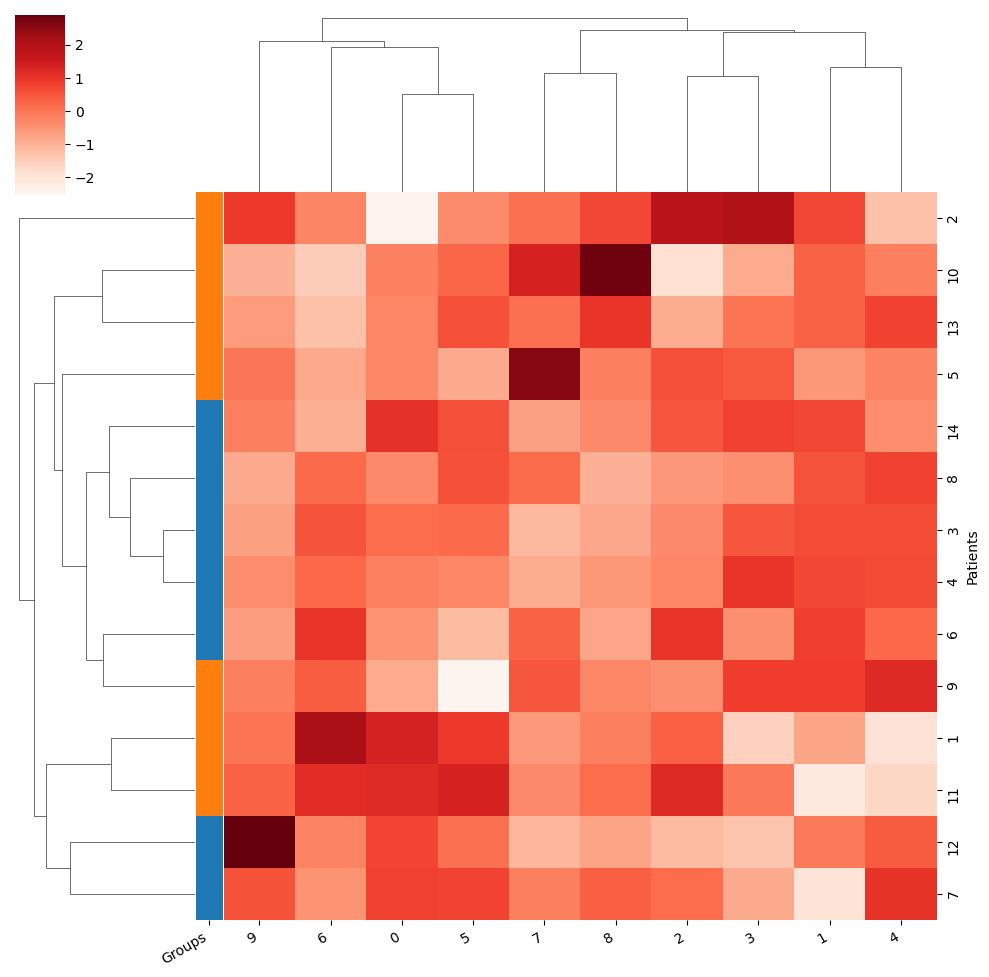

Training took 2.449s


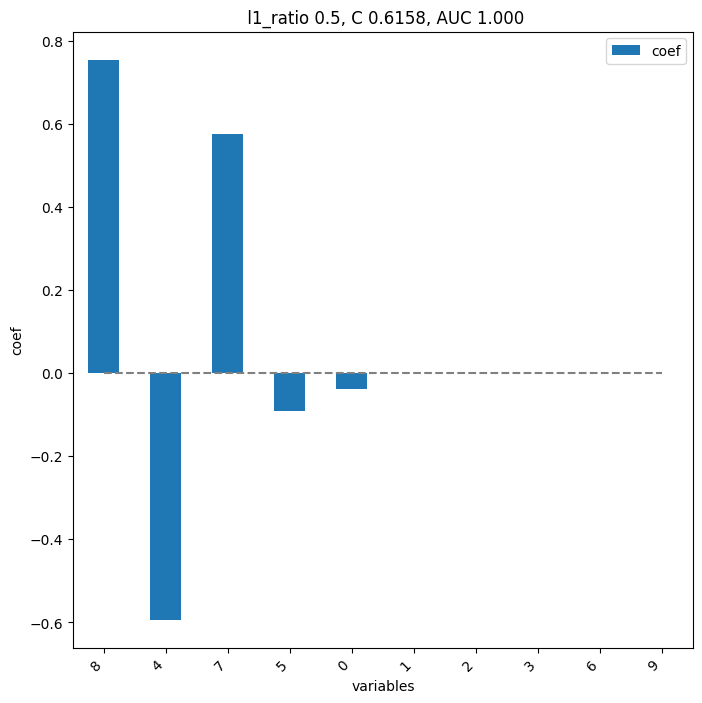

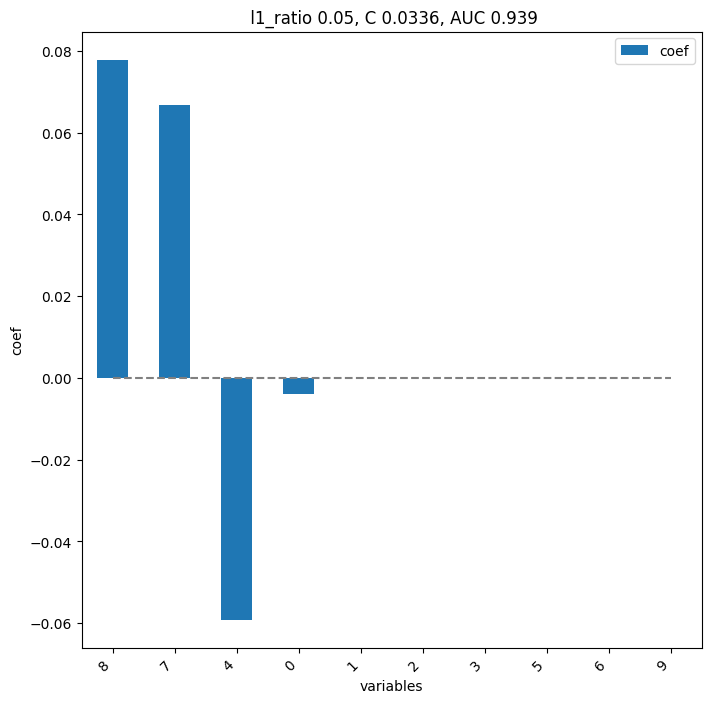

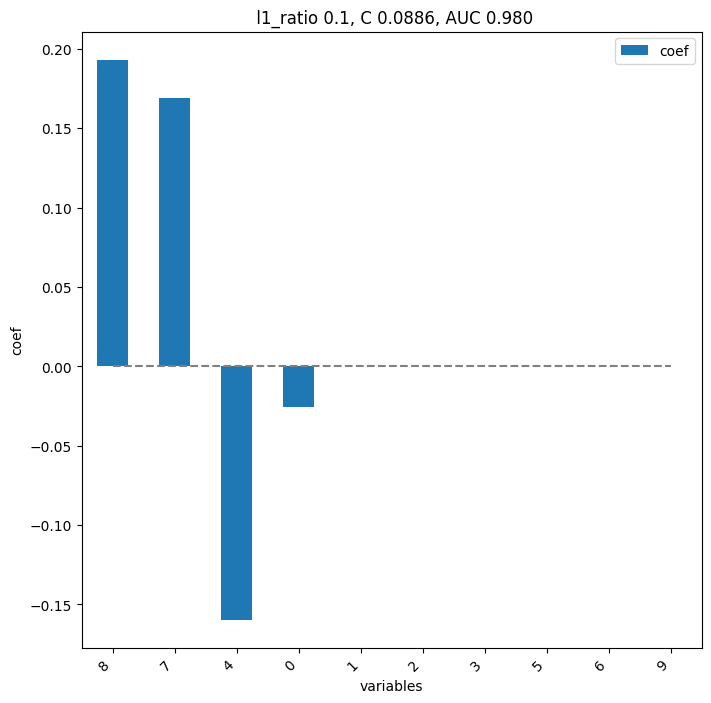

       pval  pval_corr
8  0.006993   0.069930
7  0.072844   0.364219
4  0.259324   0.864413
1  0.534965   1.000000
0  0.620047   1.000000
9  0.620047   1.000000
2  0.710373   1.000000
6  0.804779   1.000000
3  0.901515   1.000000
5  1.000000   1.000000


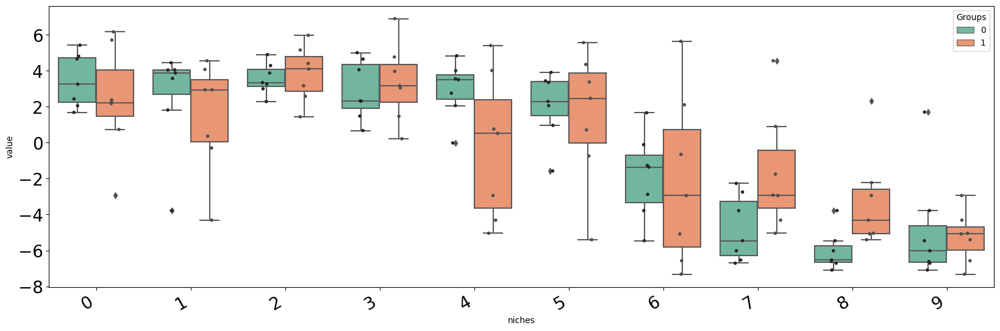

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-75', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.01', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


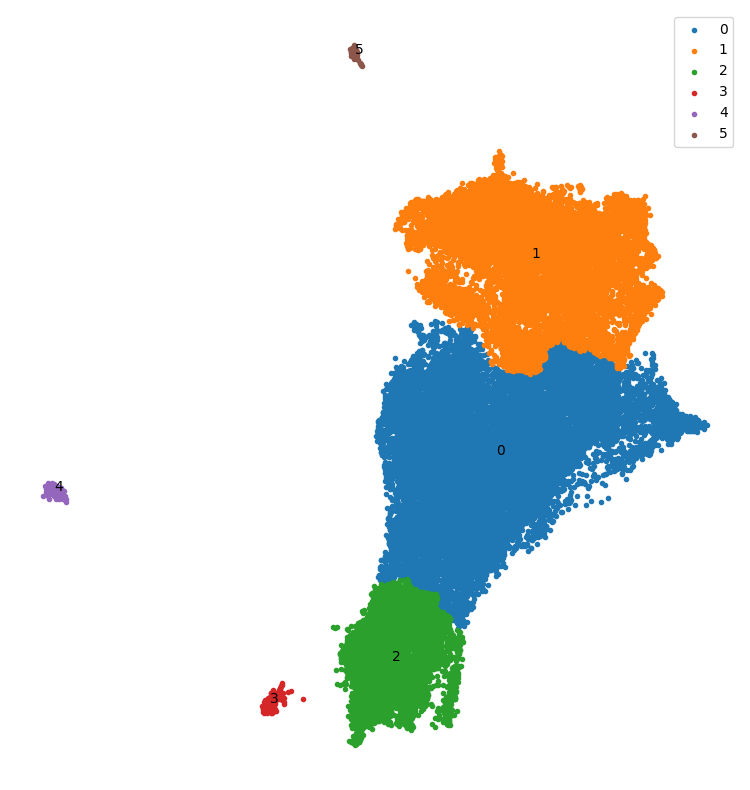

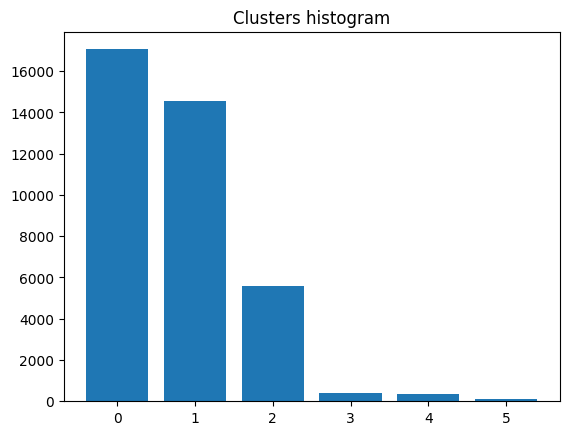

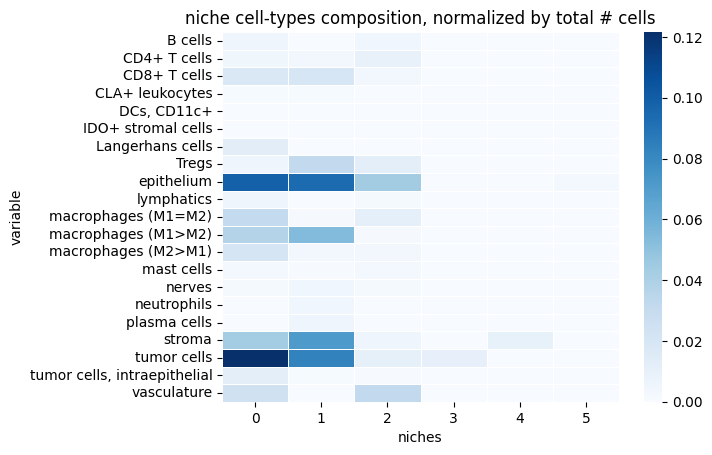

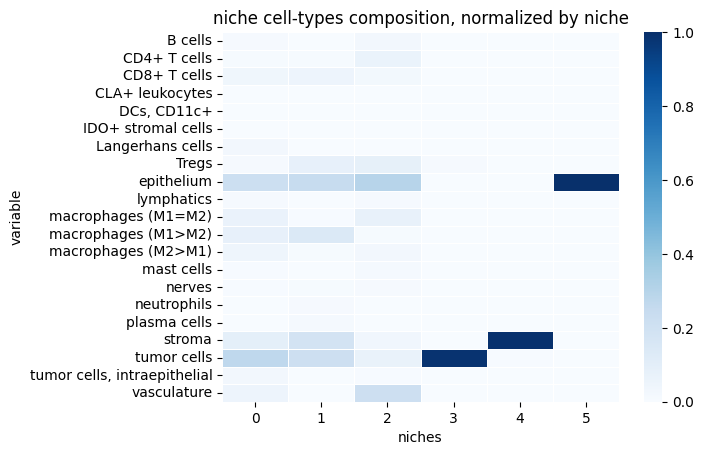

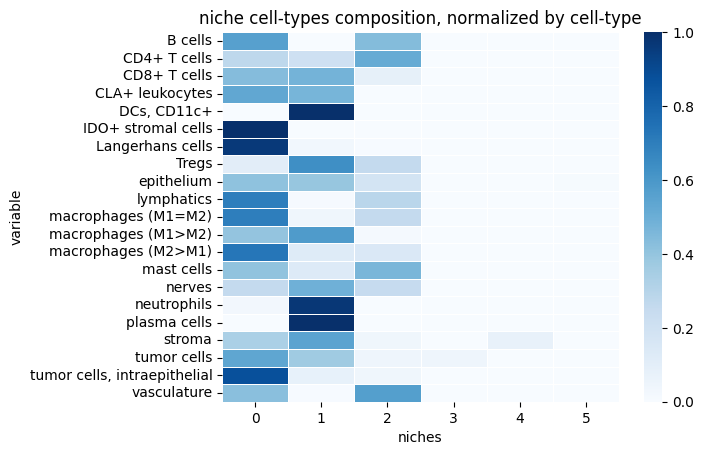

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.01_normalize-clr


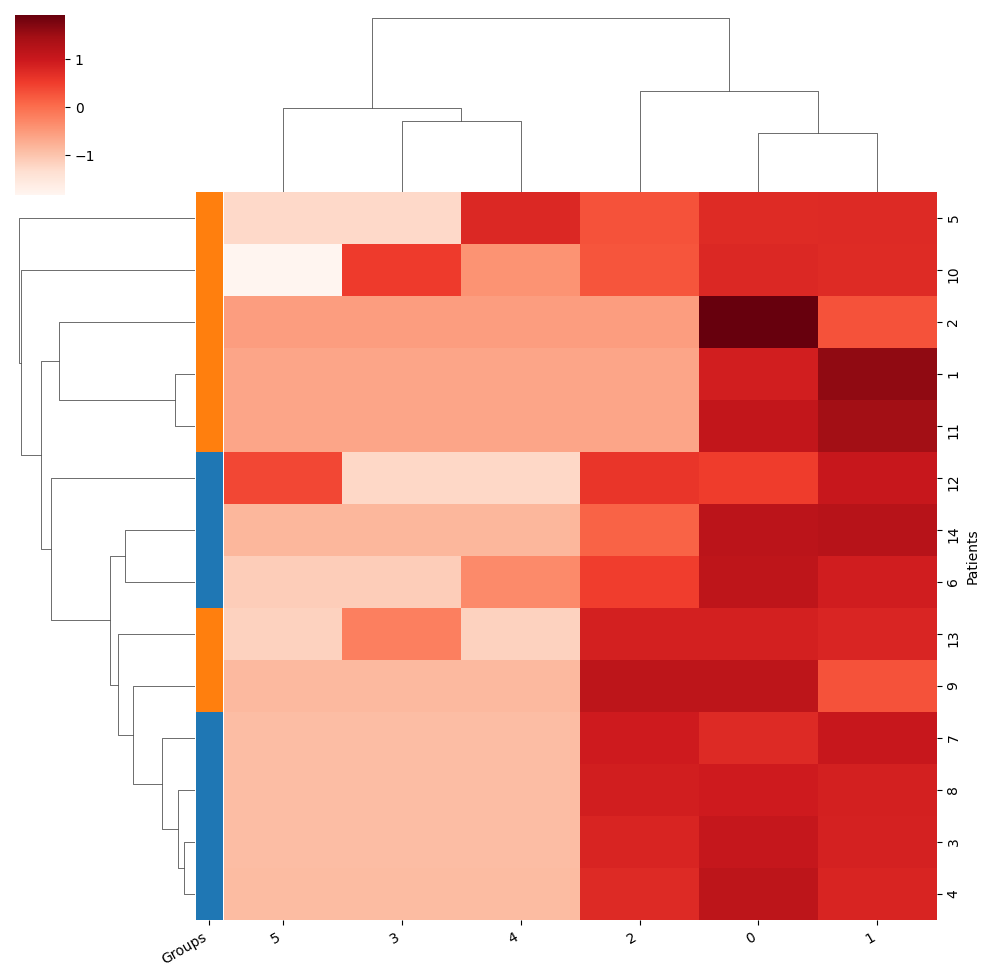

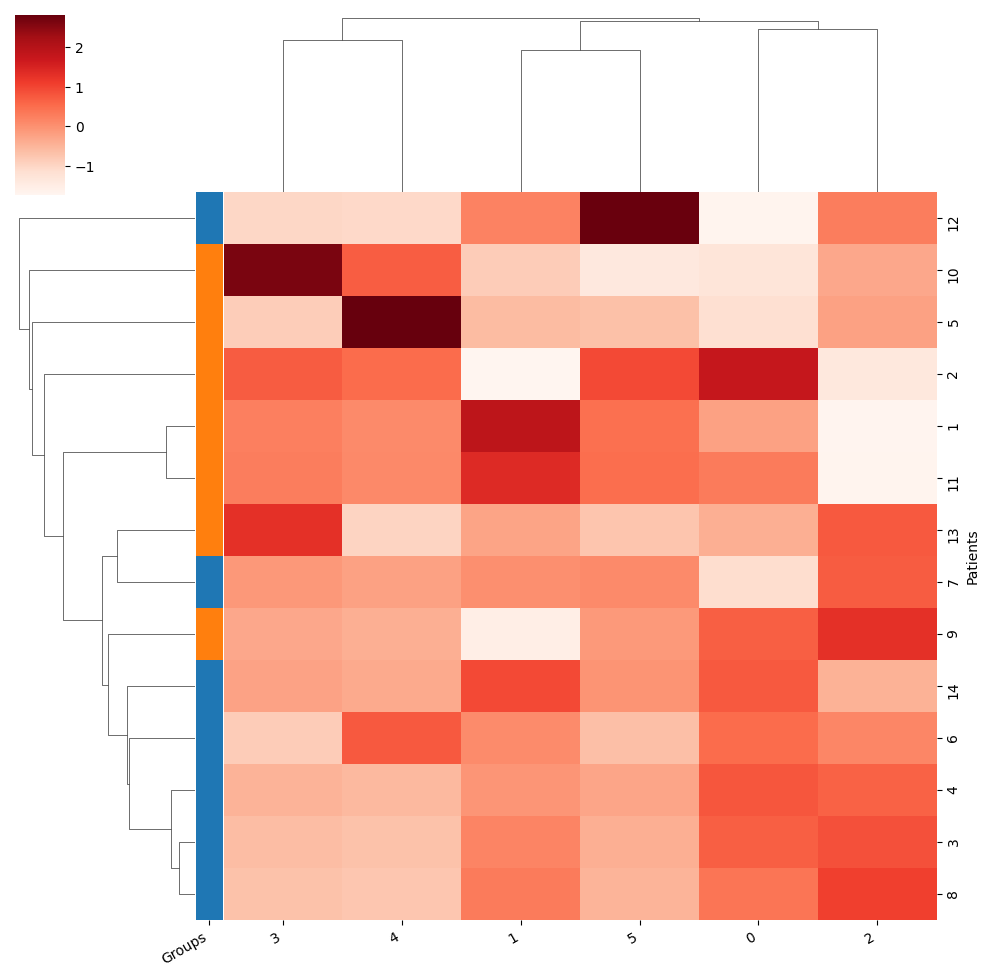

Training took 2.394s


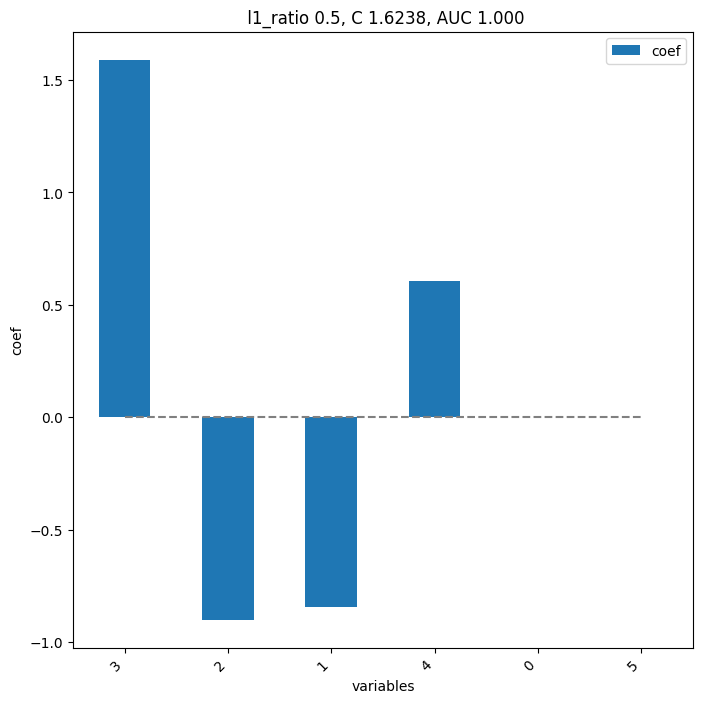

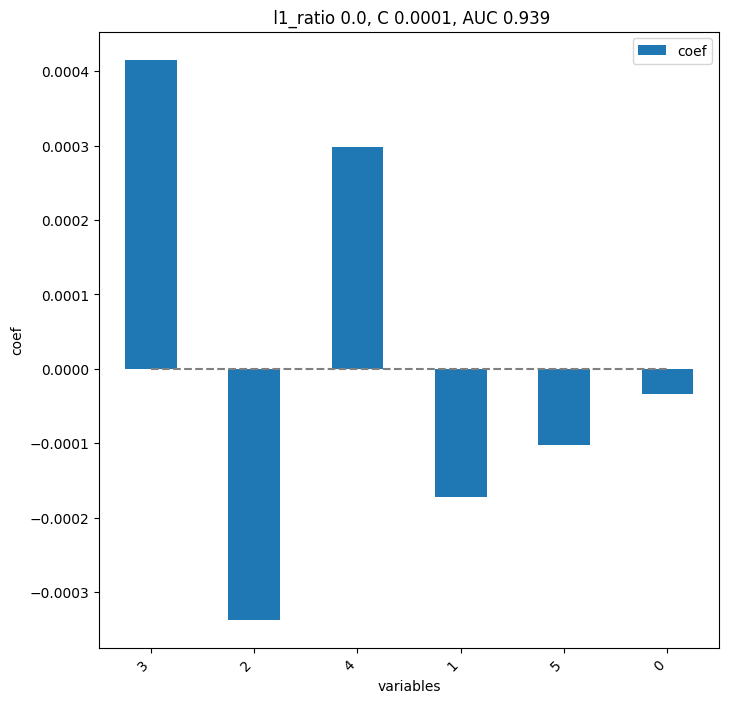

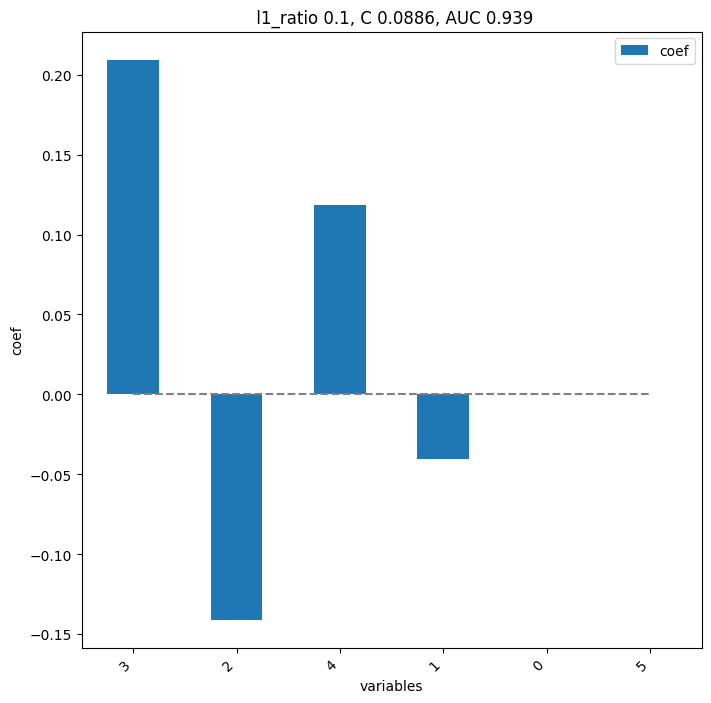

       pval  pval_corr
3  0.037879   0.227273
4  0.164918   0.312937
1  0.208625   0.312937
2  0.208625   0.312937
0  0.534965   0.641958
5  0.804779   0.804779


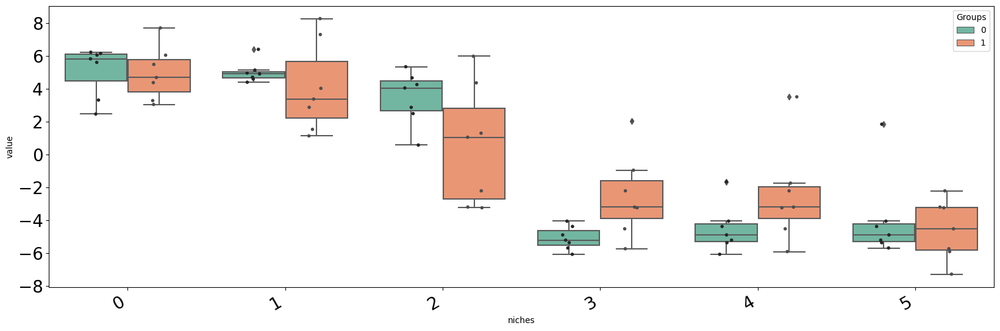

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-45', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


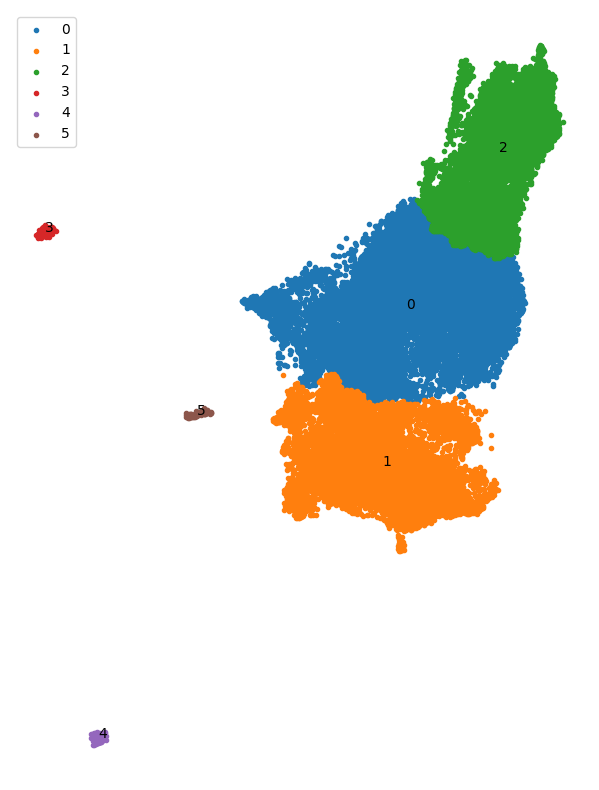

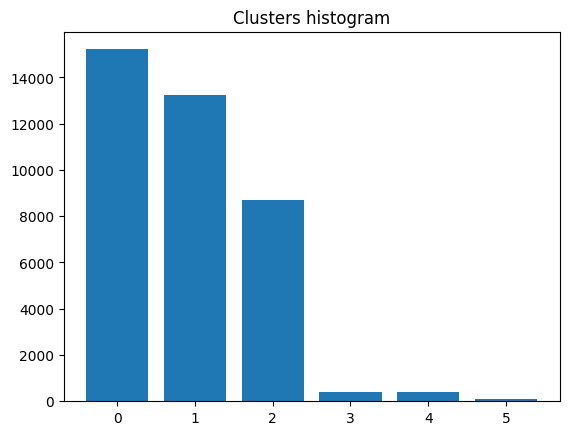

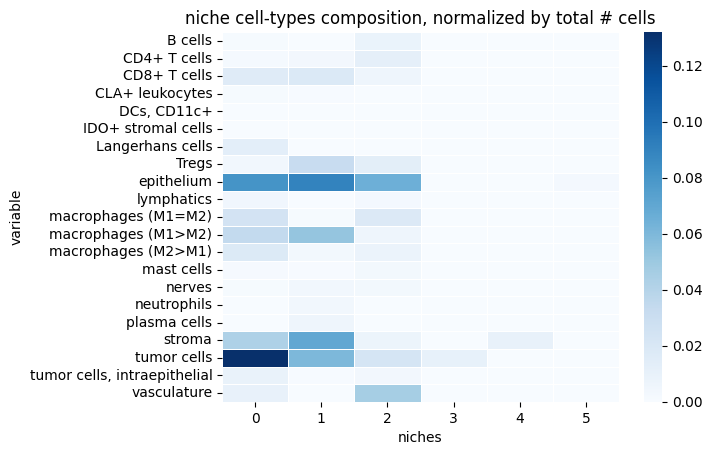

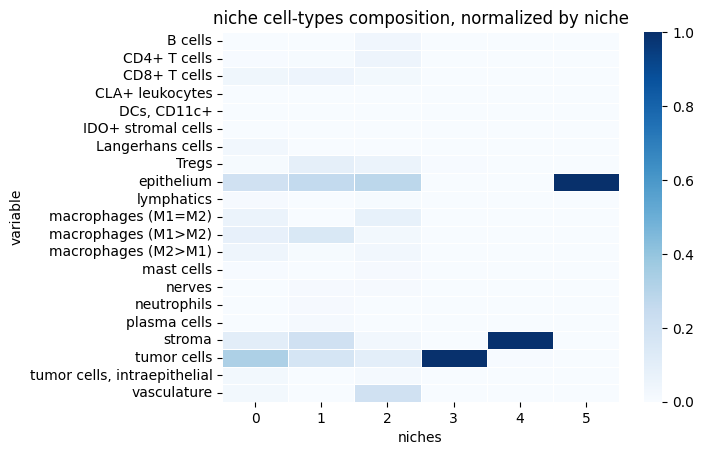

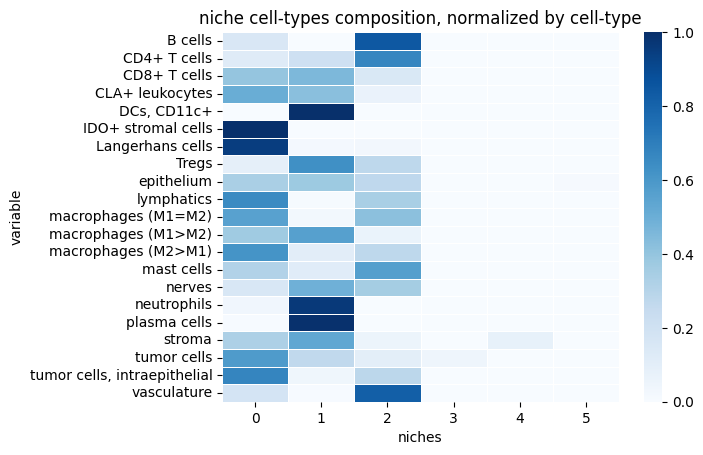

reducer_type-umap_n_neighbors-45_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


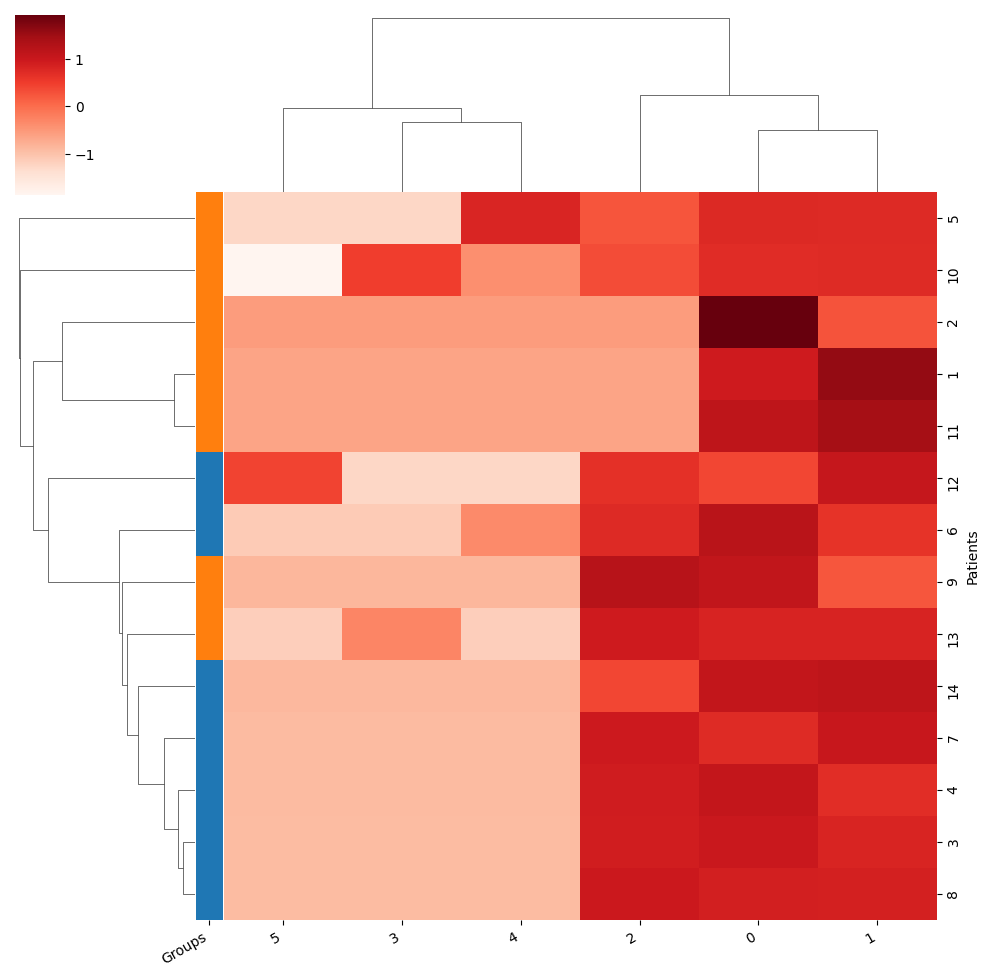

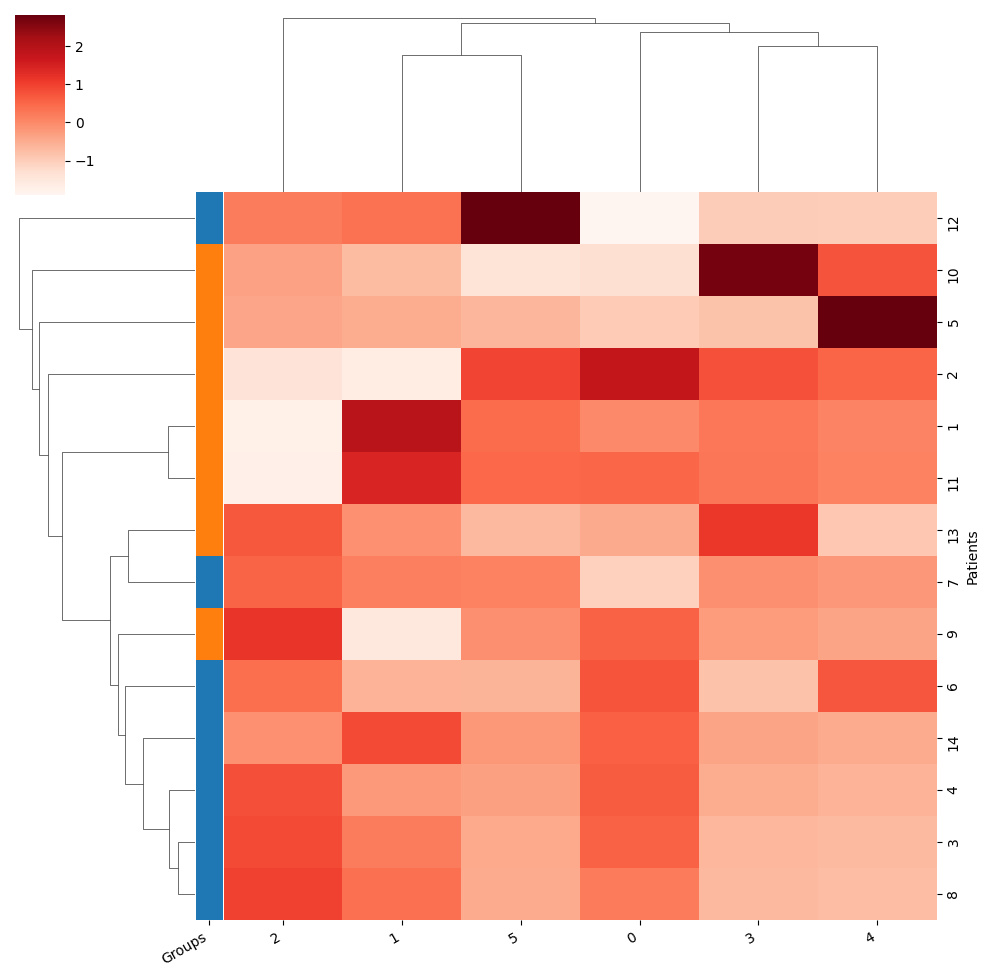

Training took 2.485s


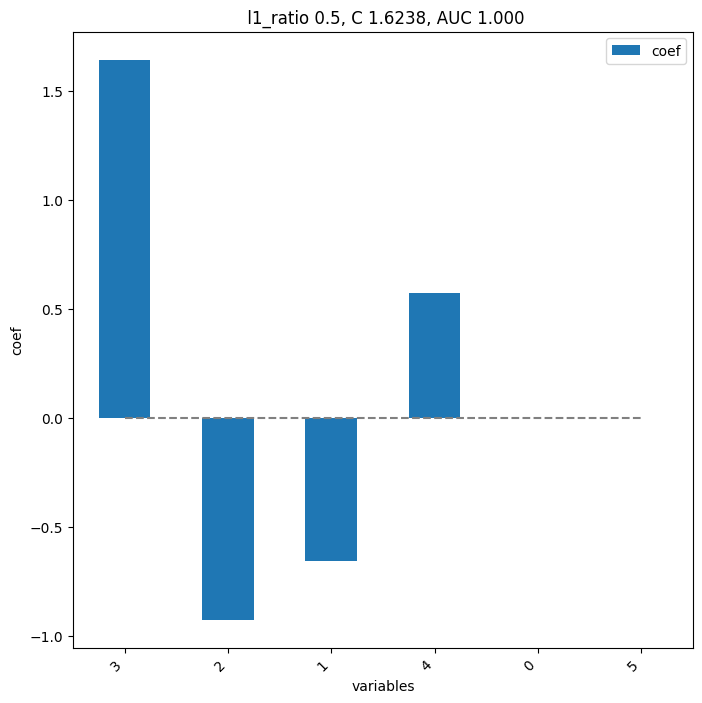

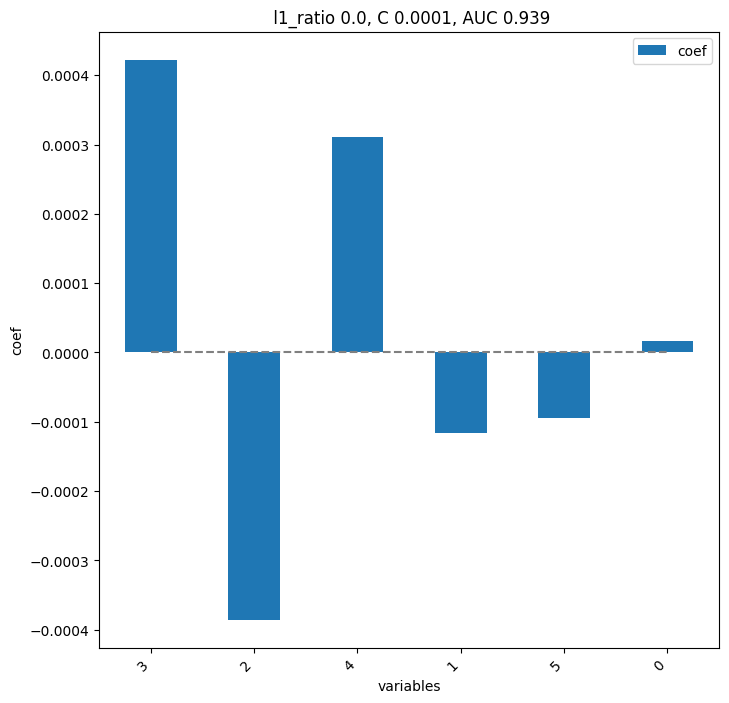

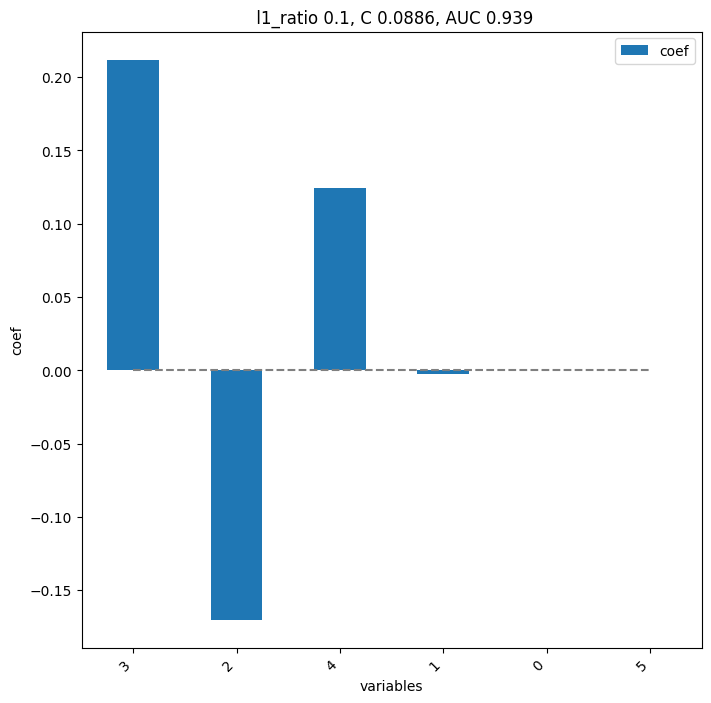

       pval  pval_corr
3  0.026224   0.157343
2  0.097319   0.194639
4  0.097319   0.194639
1  0.382867   0.574301
0  0.620047   0.744056
5  0.901515   0.901515


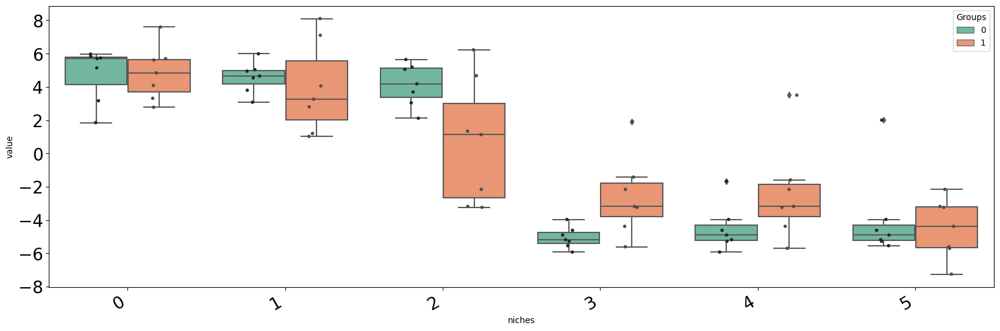

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-75', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


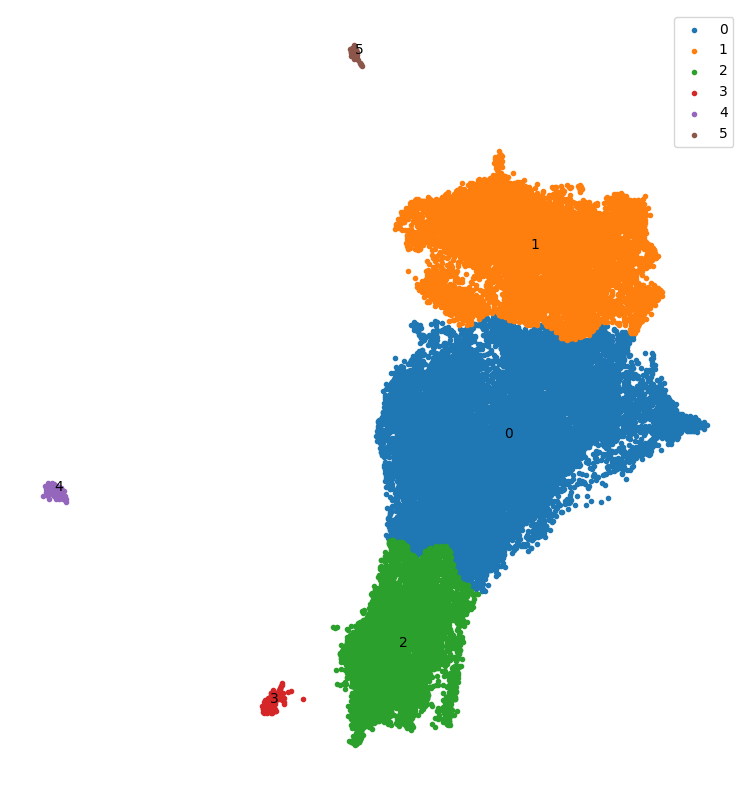

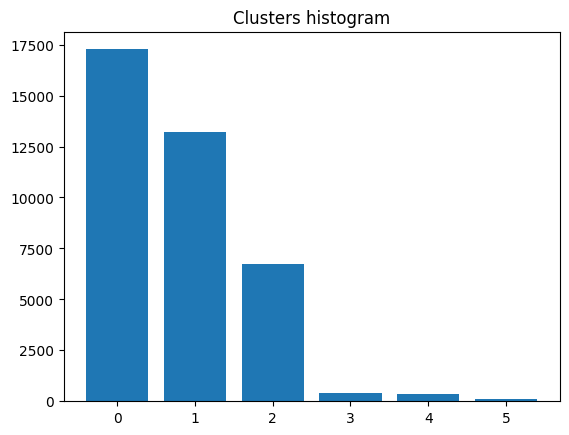

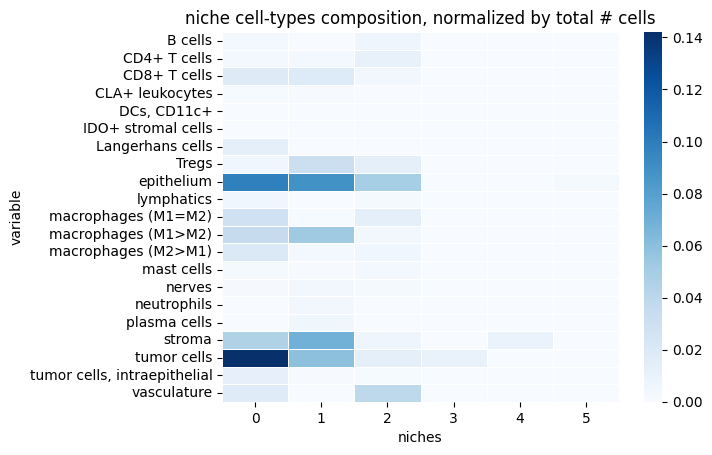

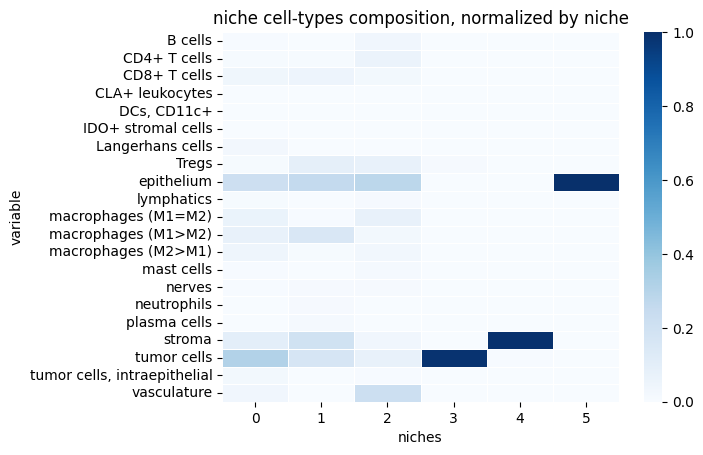

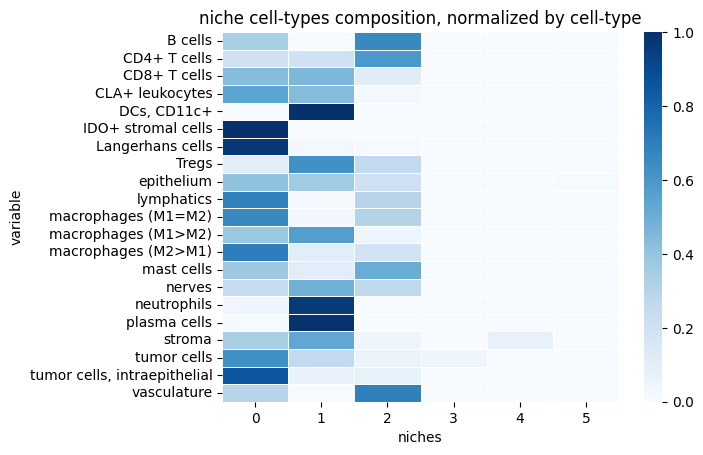

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


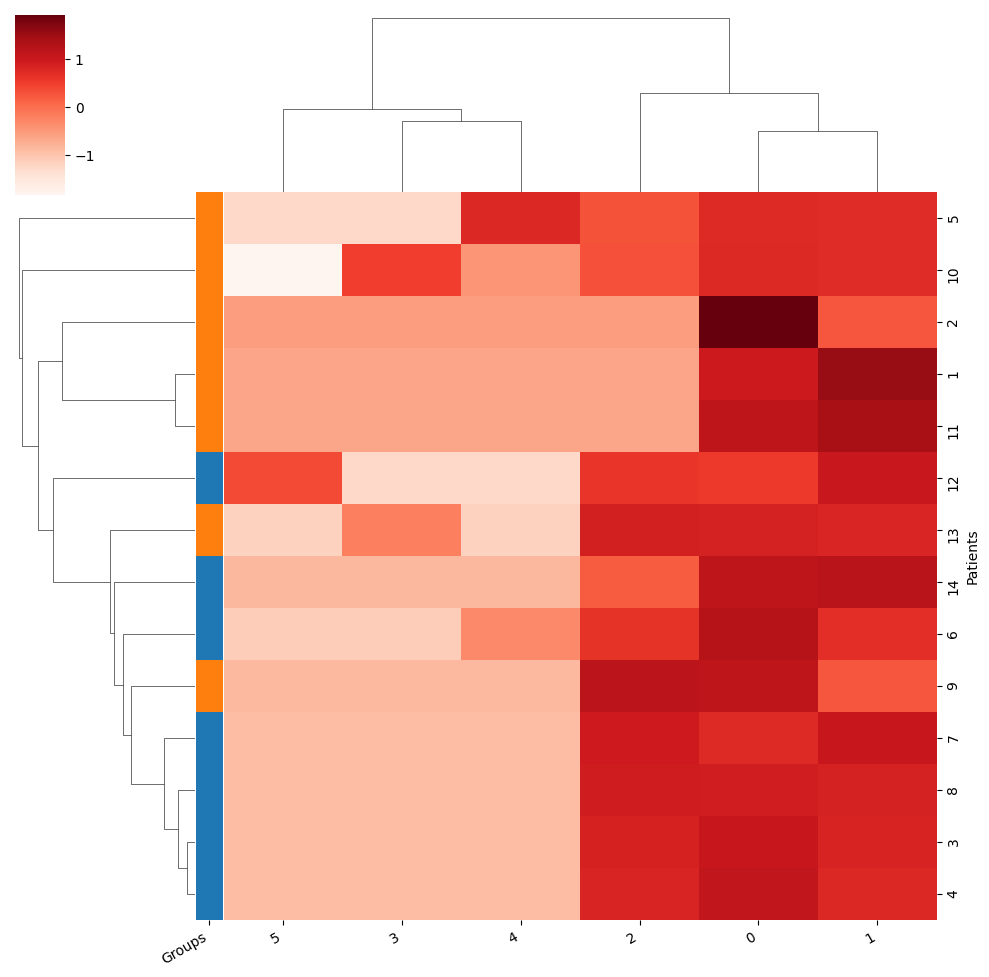

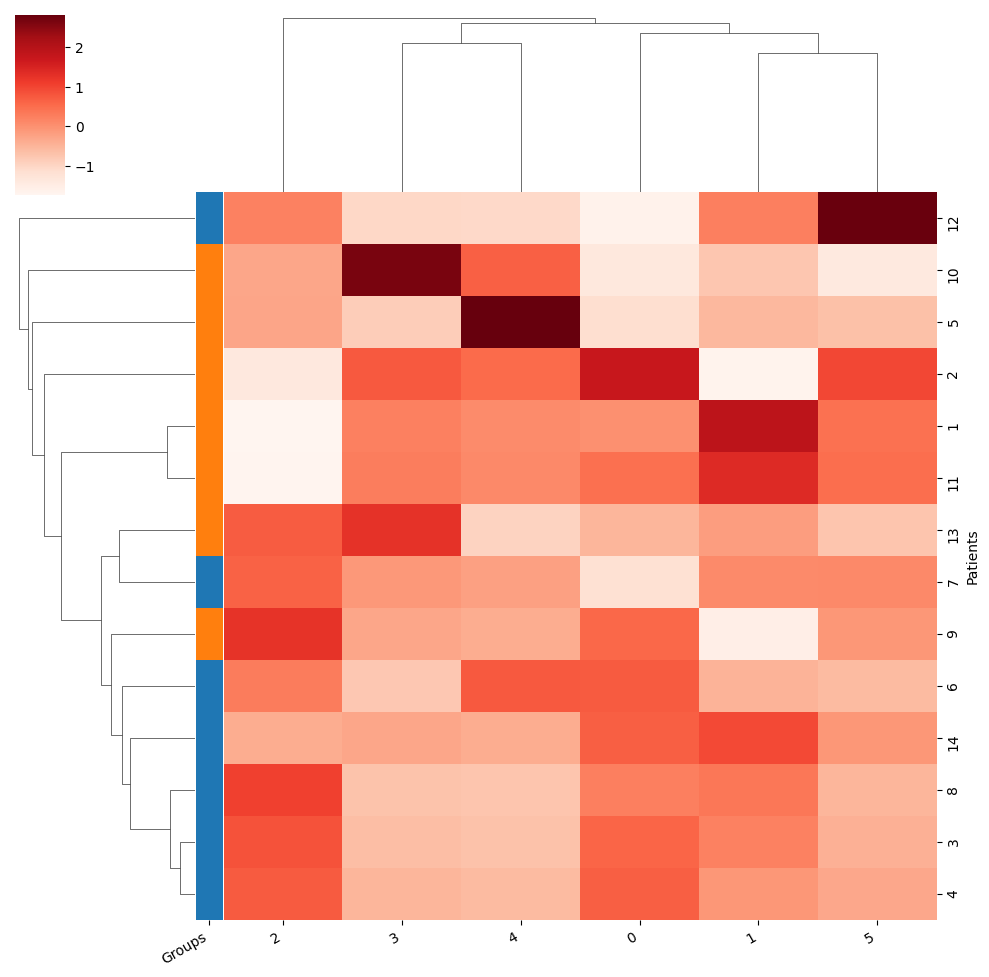

Training took 2.477s


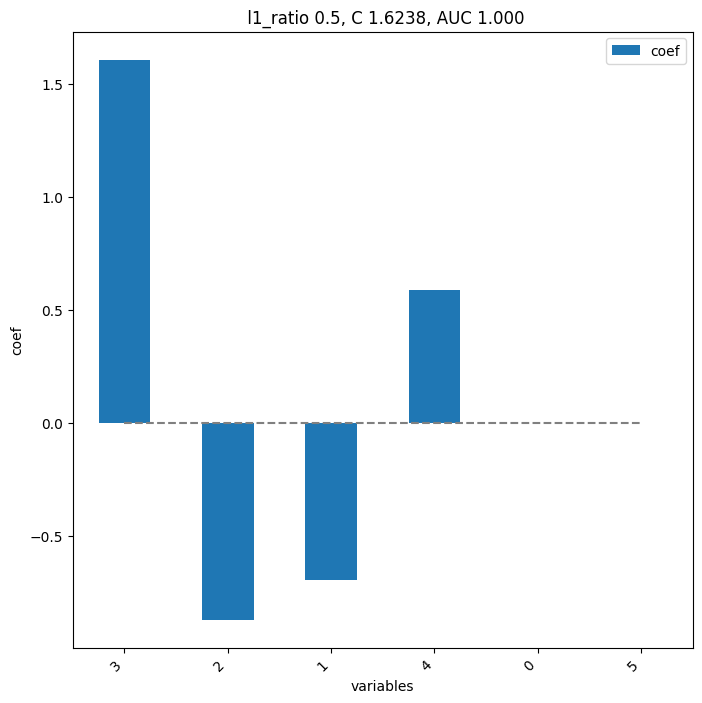

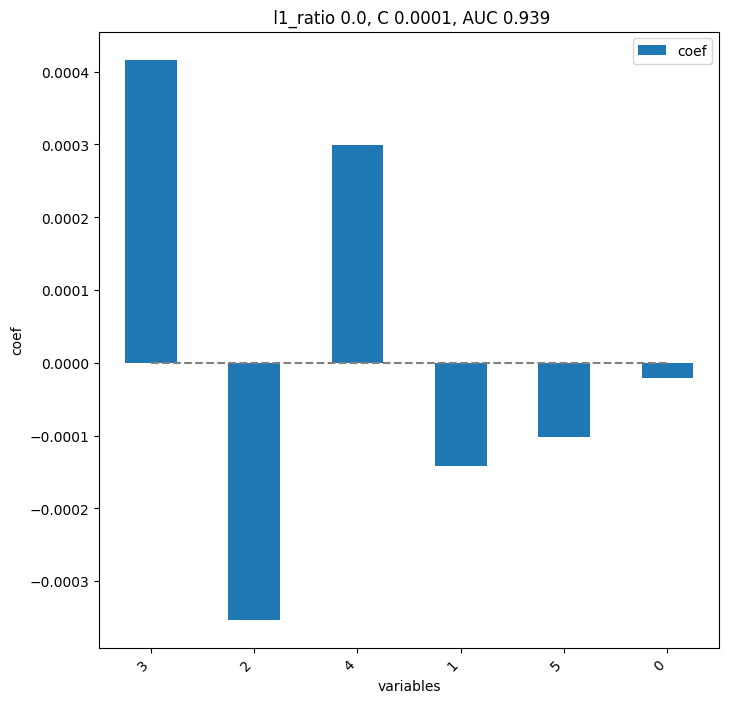

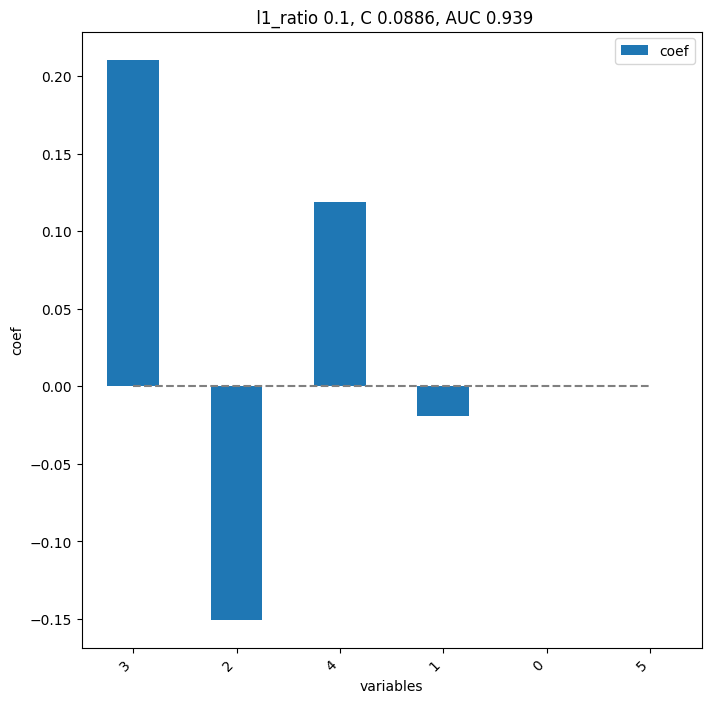

       pval  pval_corr
3  0.037879   0.227273
2  0.164918   0.329837
4  0.164918   0.329837
1  0.259324   0.388986
0  0.620047   0.744056
5  0.804779   0.804779


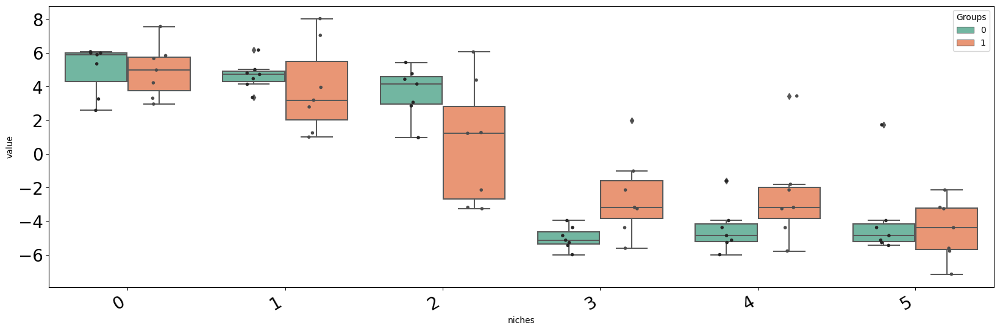

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


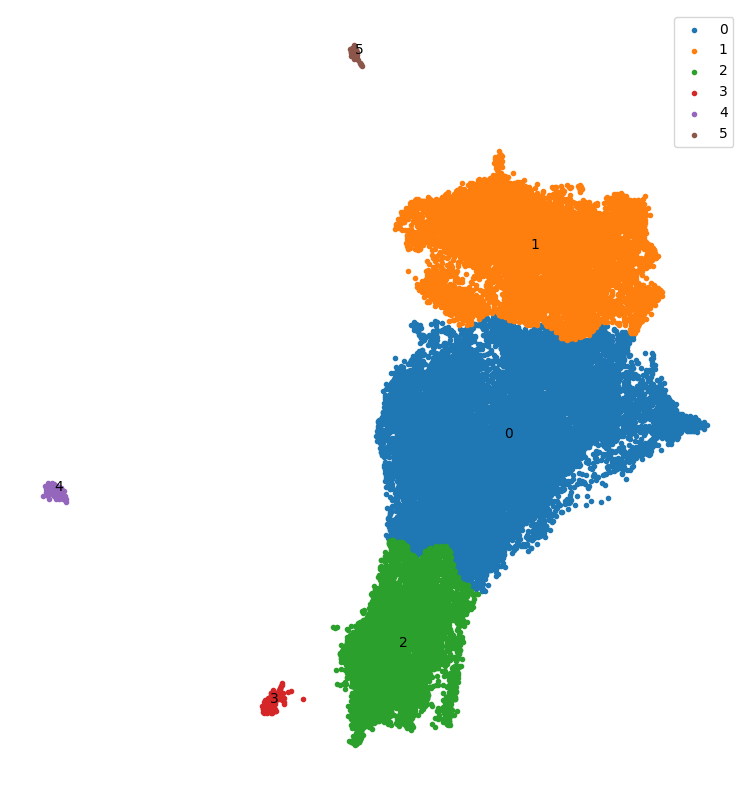

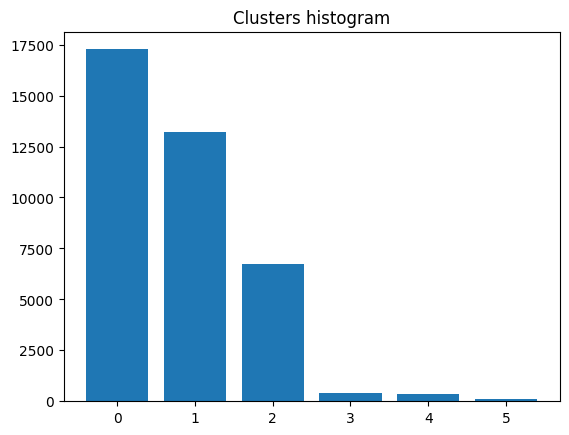

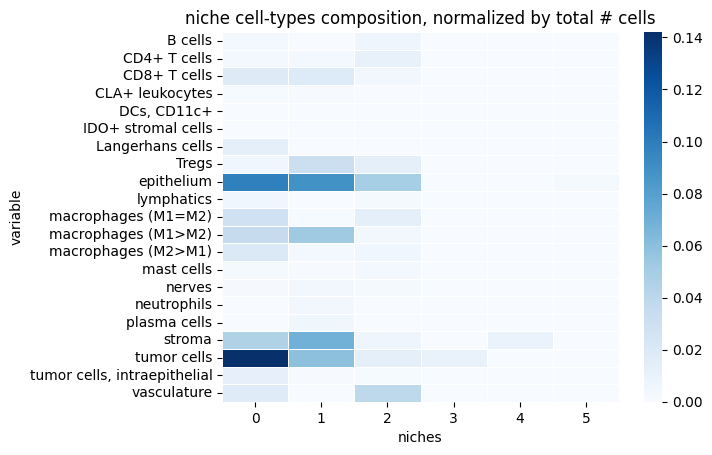

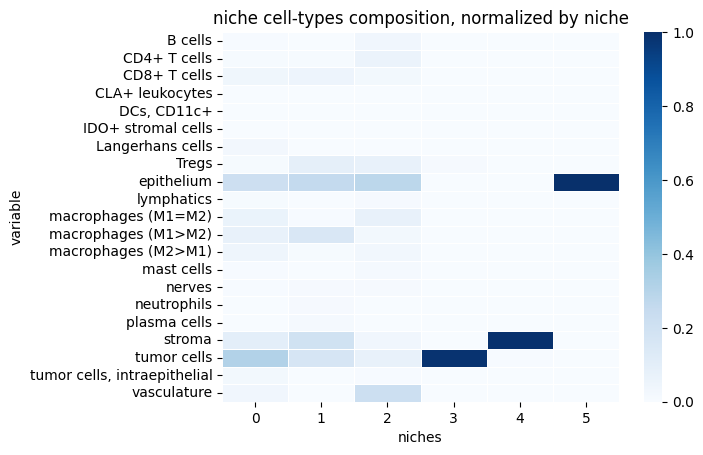

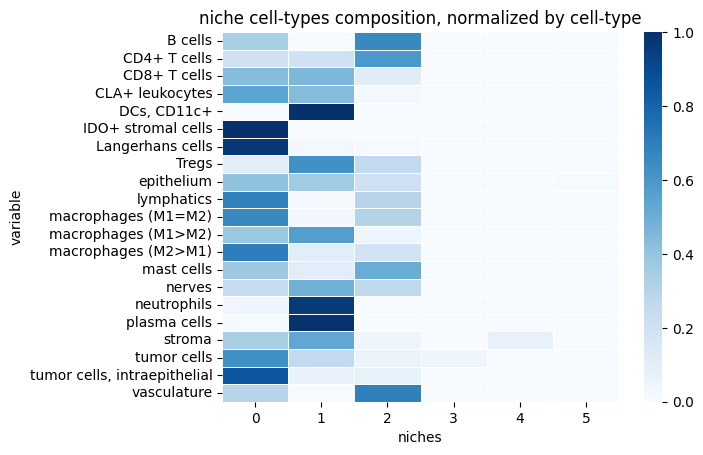

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


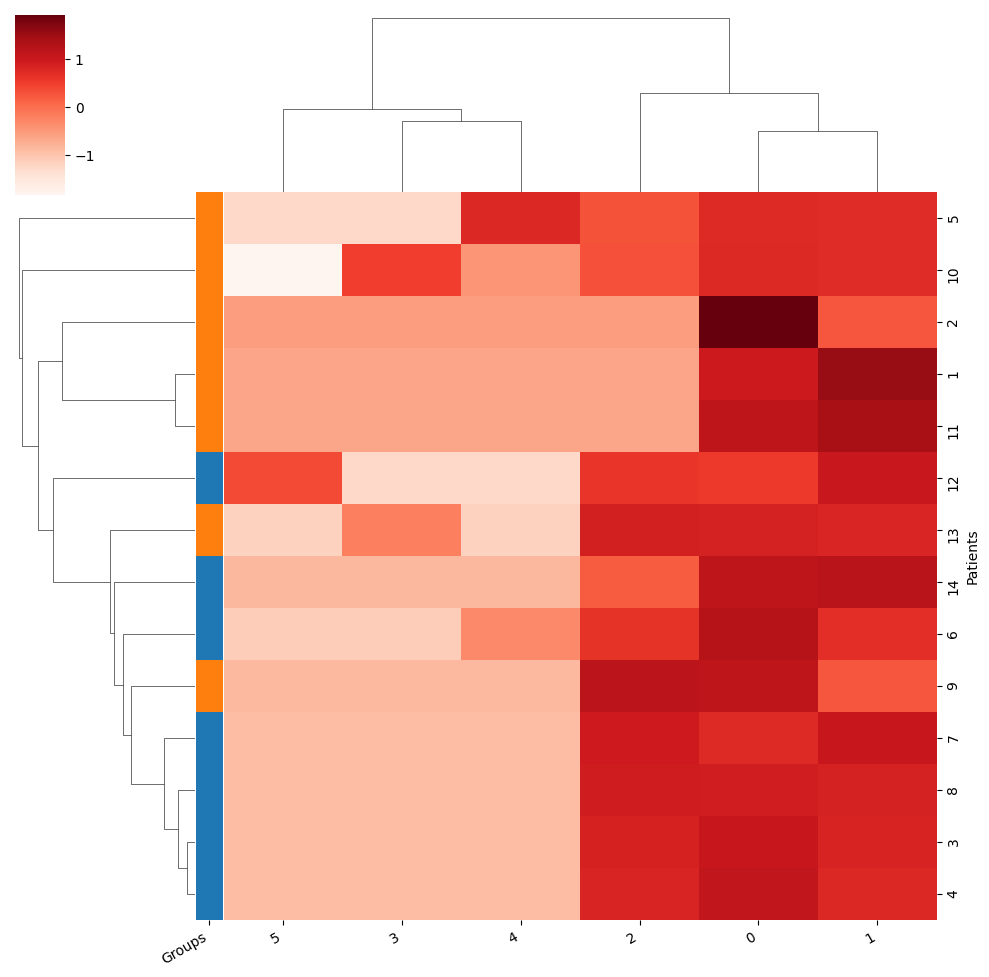

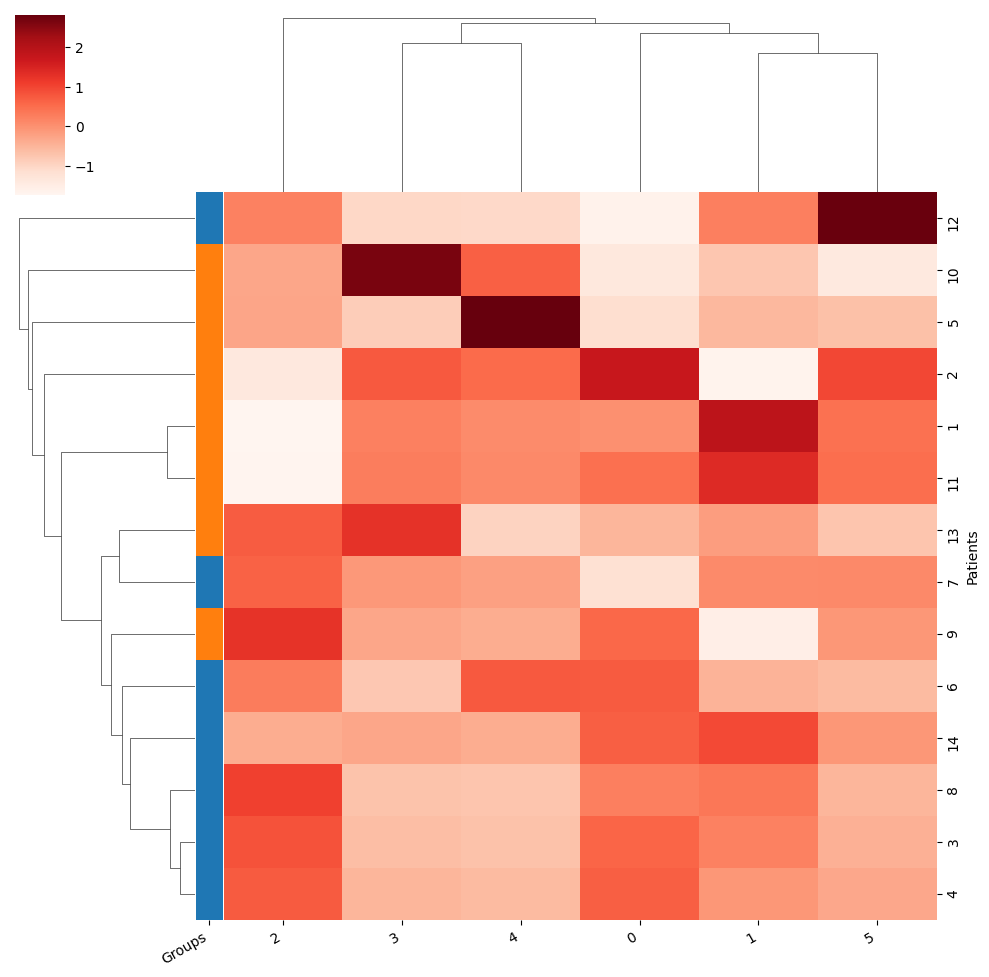

Training took 2.422s


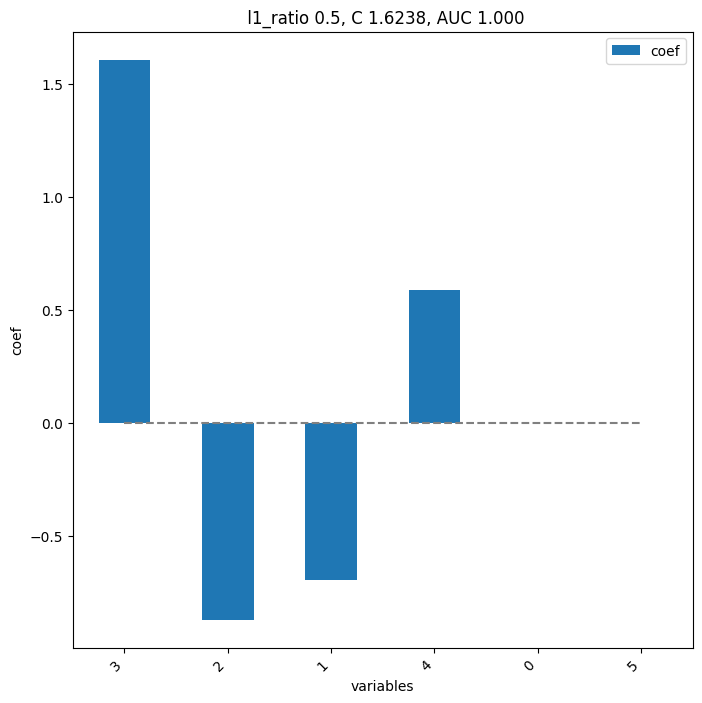

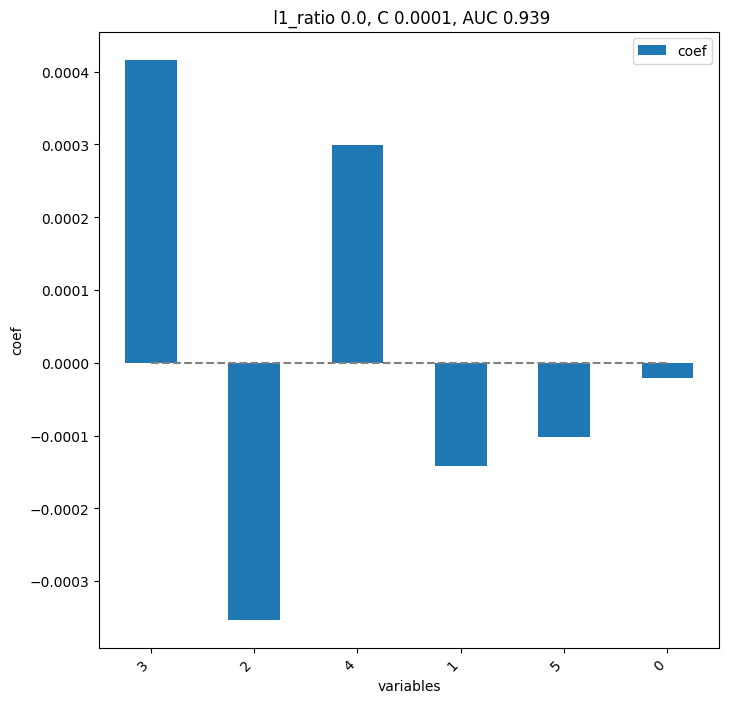

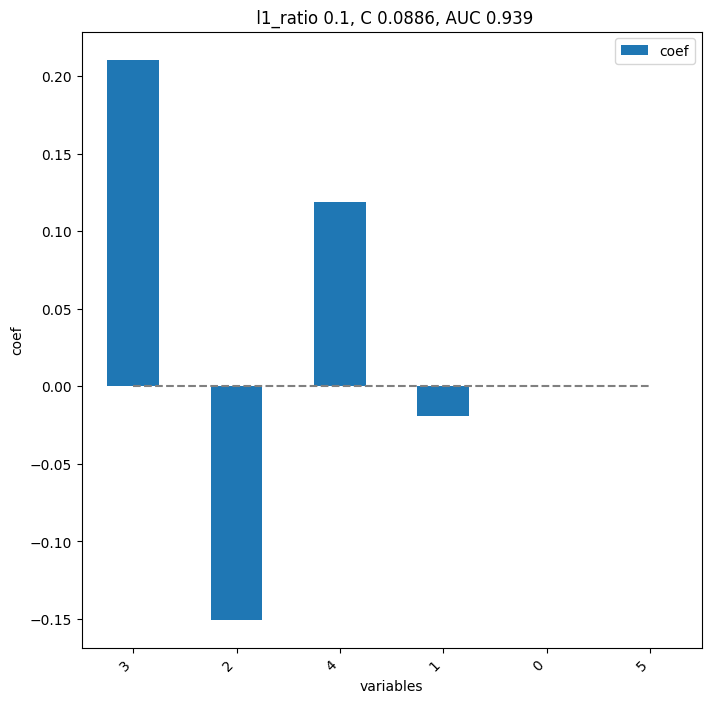

       pval  pval_corr
3  0.037879   0.227273
2  0.164918   0.329837
4  0.164918   0.329837
1  0.259324   0.388986
0  0.620047   0.744056
5  0.804779   0.804779


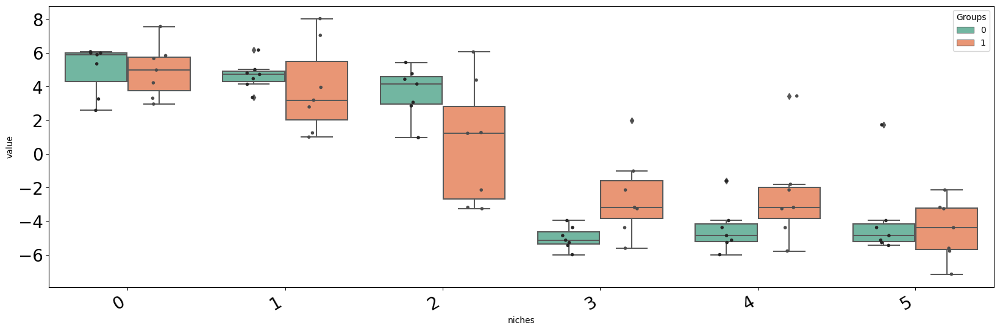

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


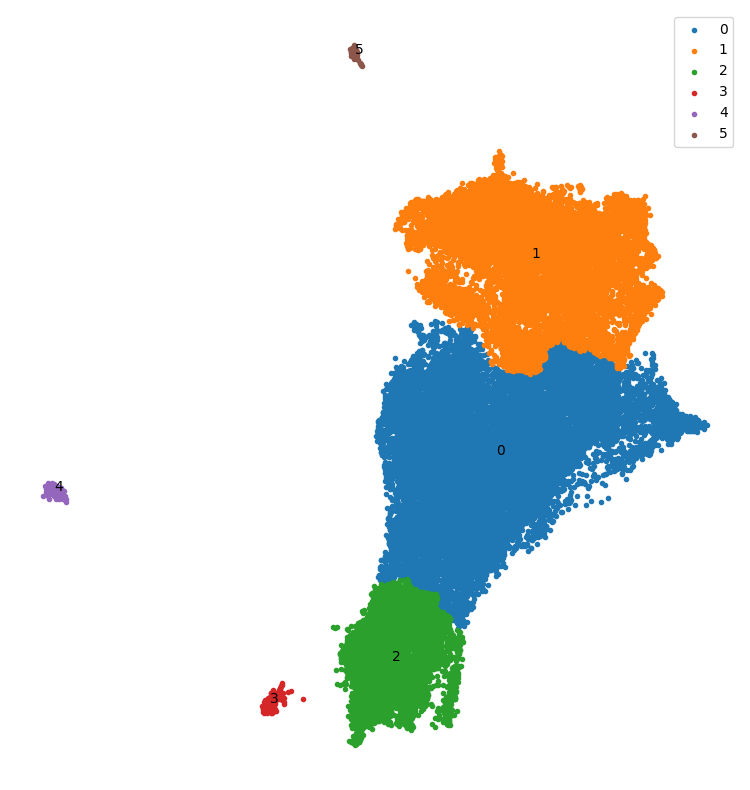

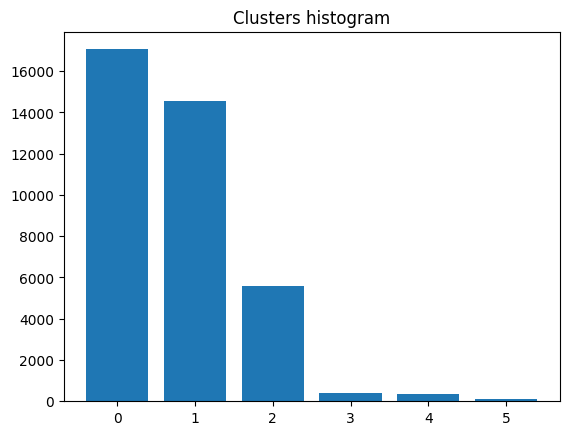

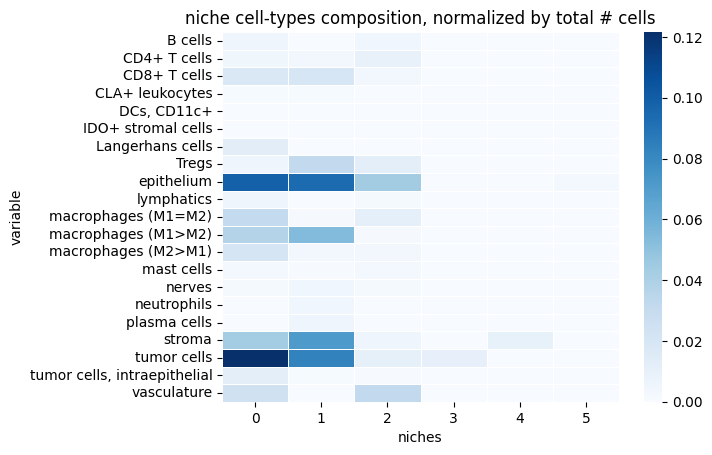

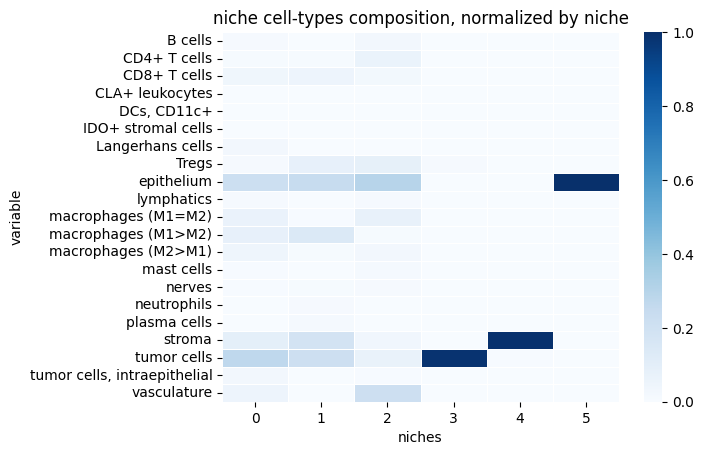

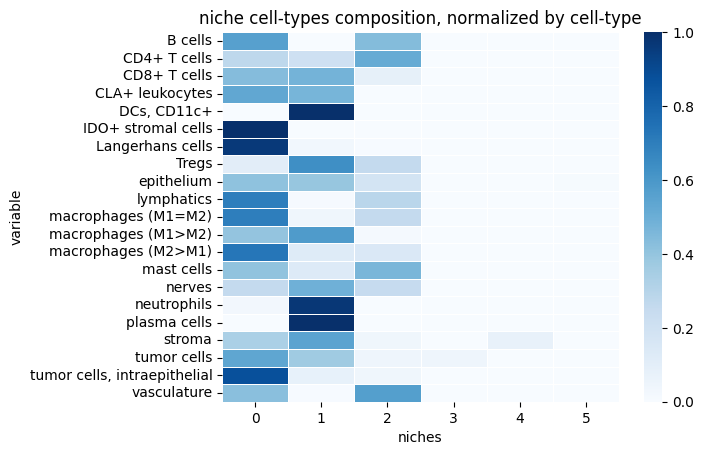

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.01_normalize-clr


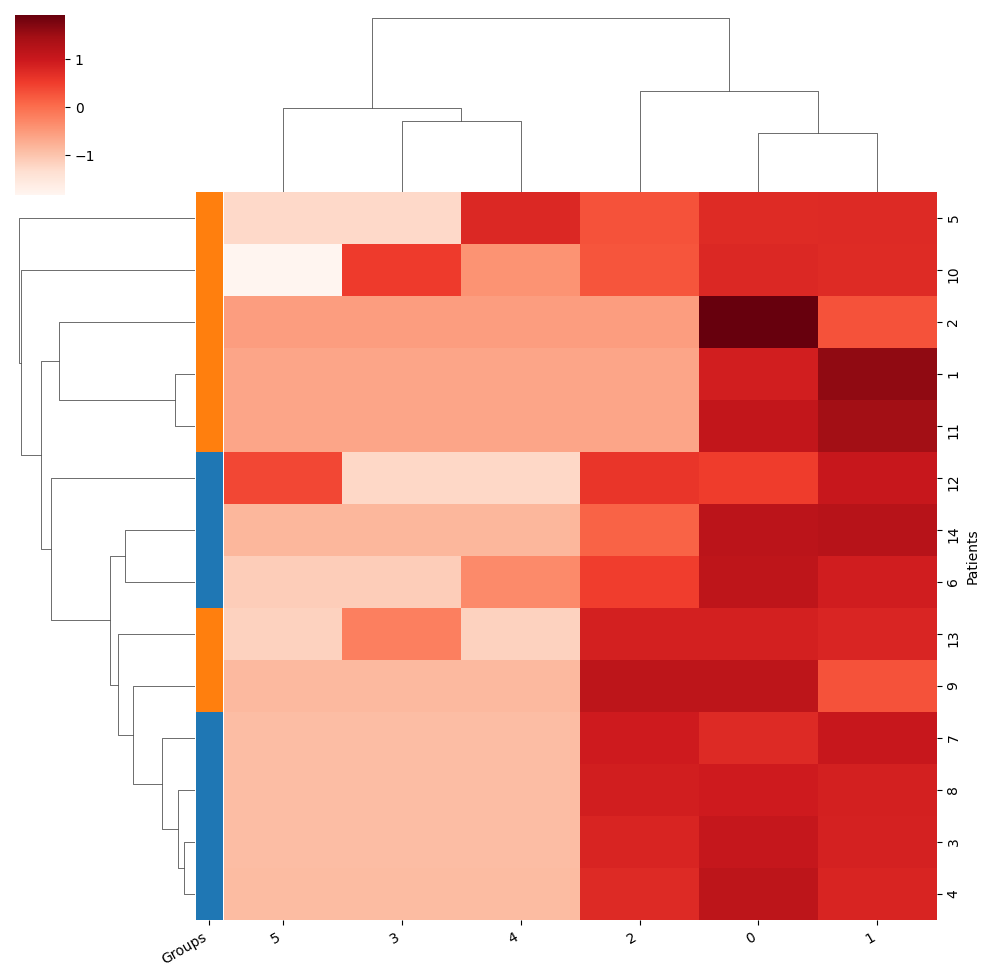

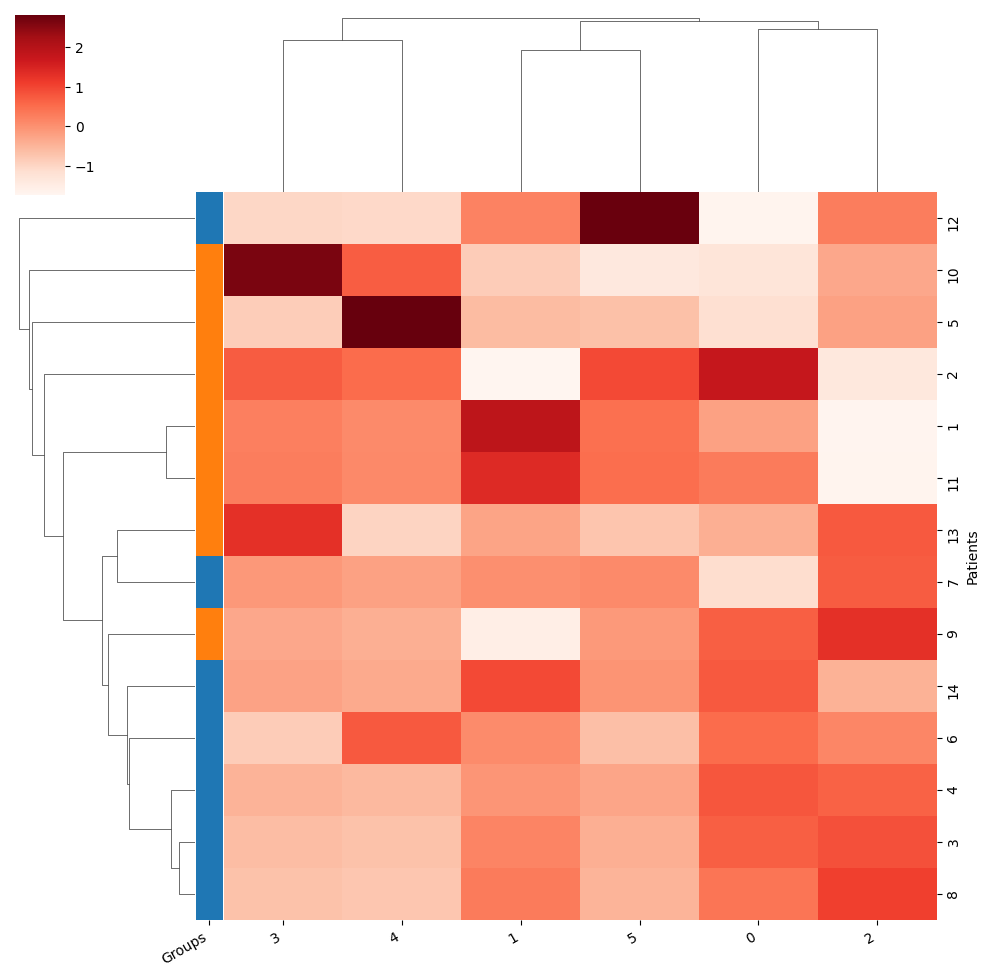

Training took 2.410s


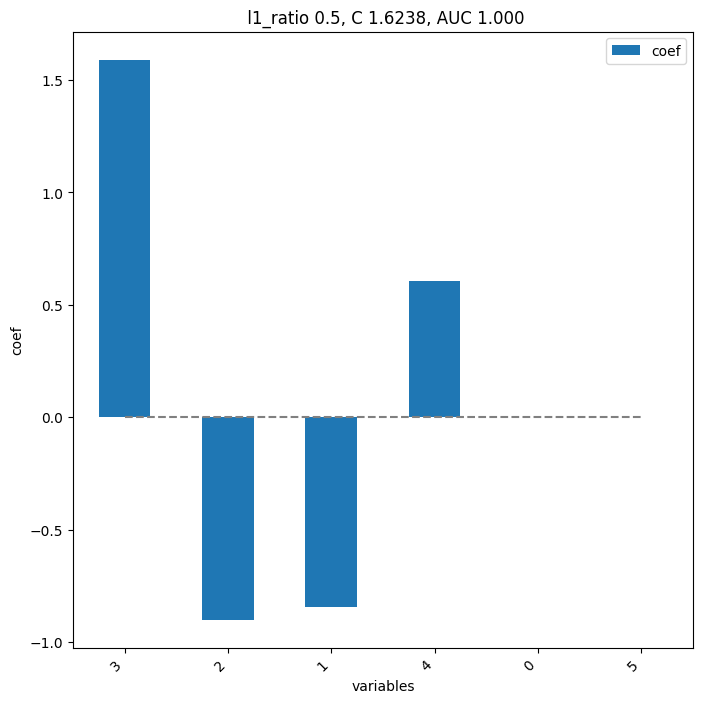

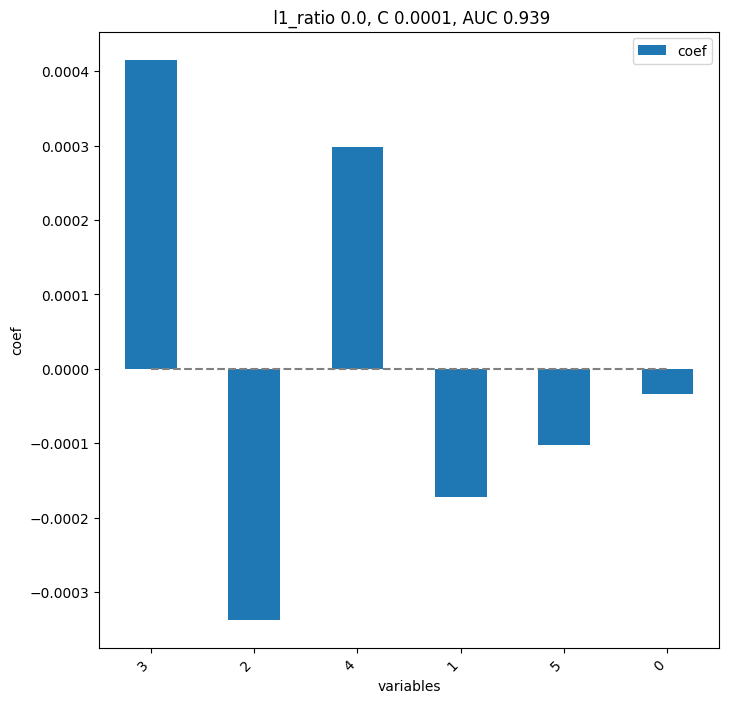

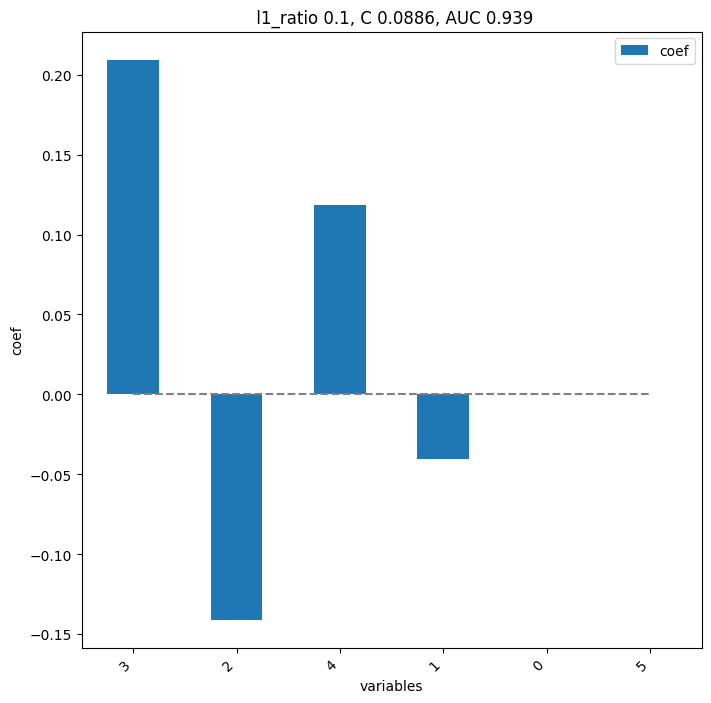

       pval  pval_corr
3  0.037879   0.227273
4  0.164918   0.312937
1  0.208625   0.312937
2  0.208625   0.312937
0  0.534965   0.641958
5  0.804779   0.804779


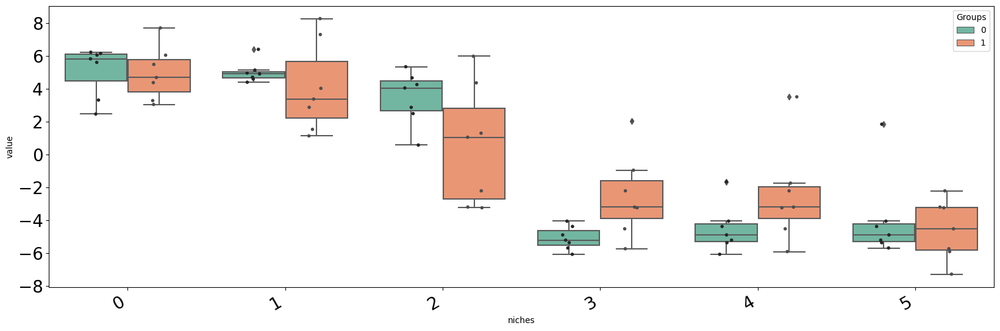

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 8 clusters
Loading reducer object and reduced coordinates


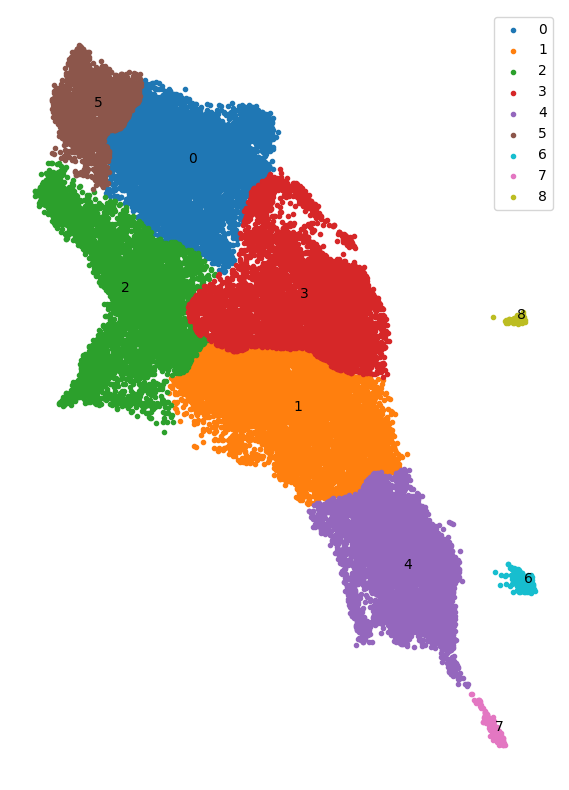

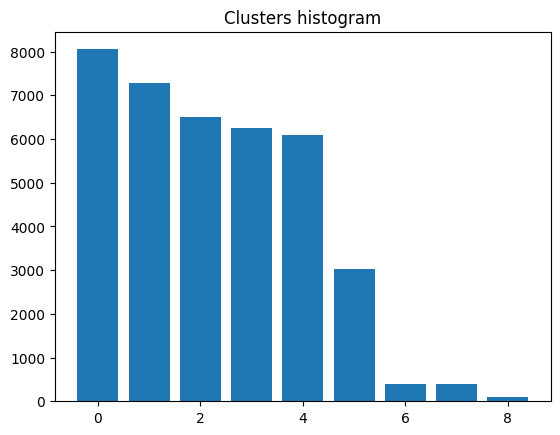

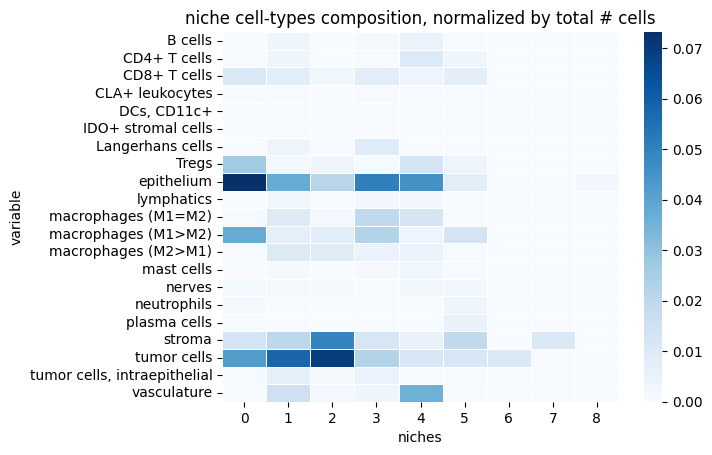

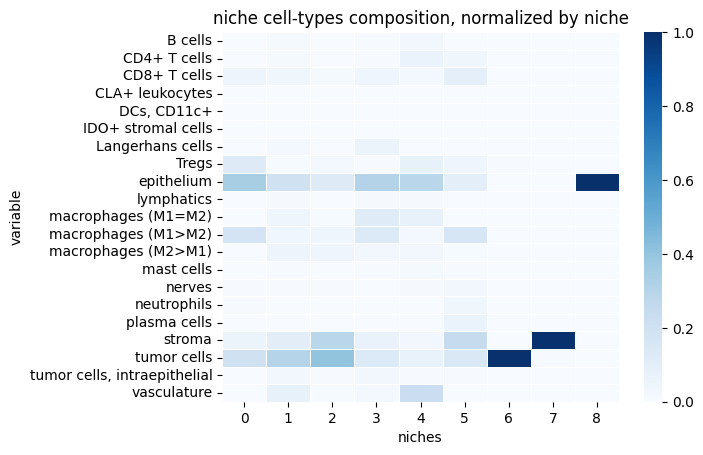

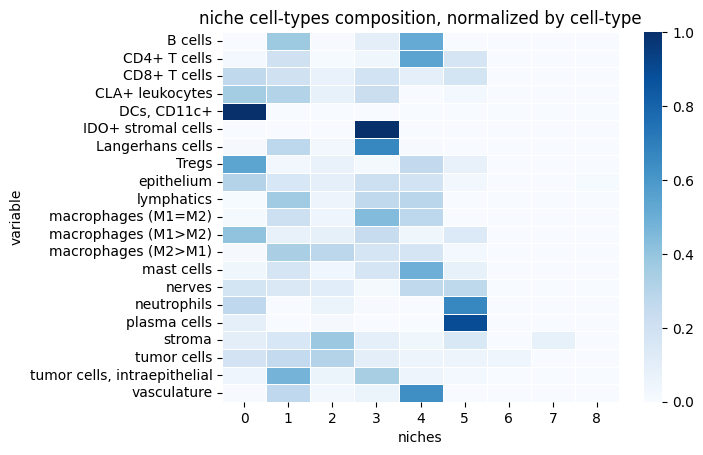

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


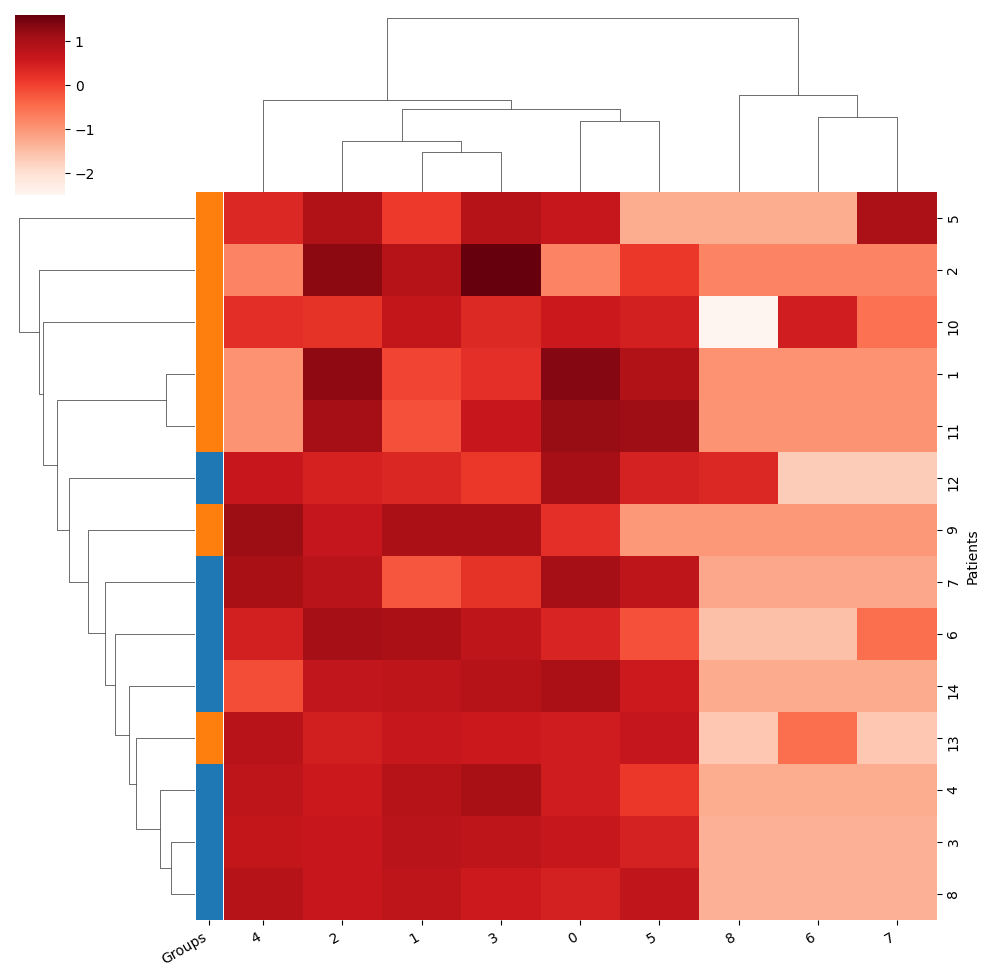

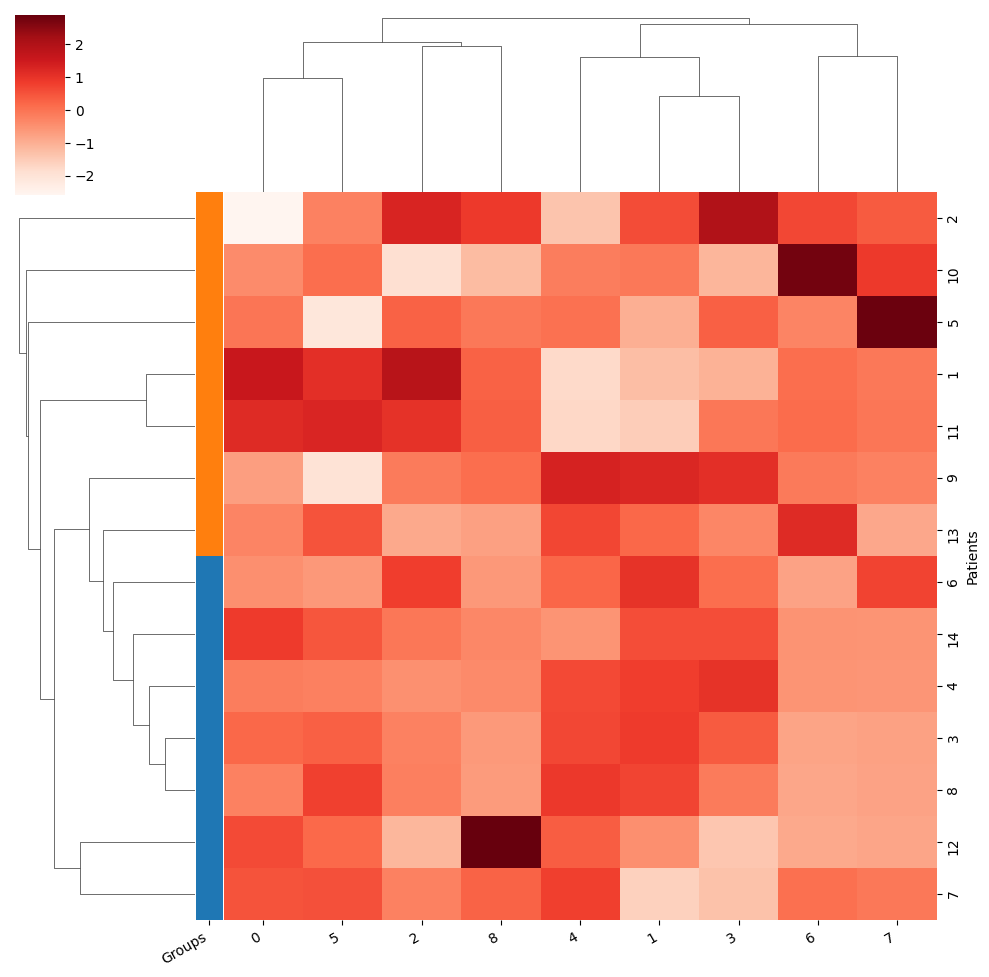

Training took 2.405s


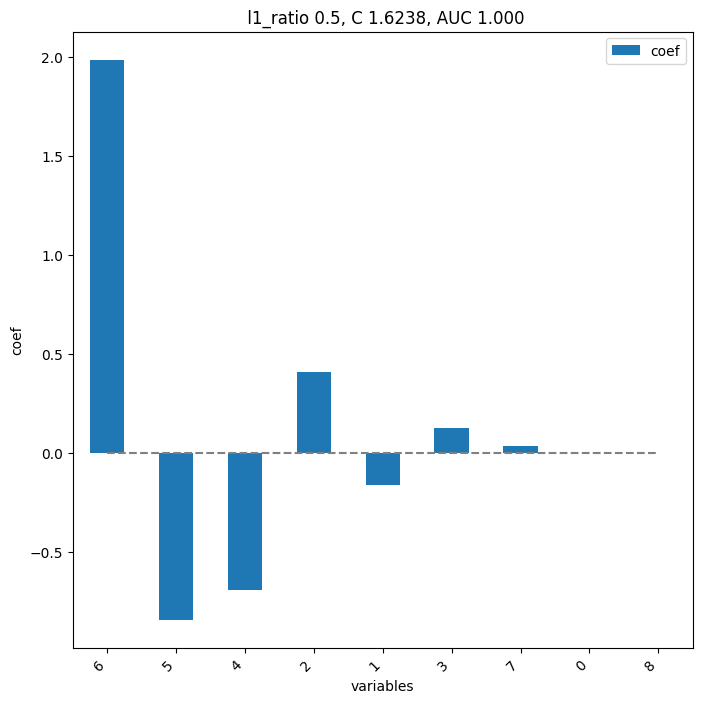

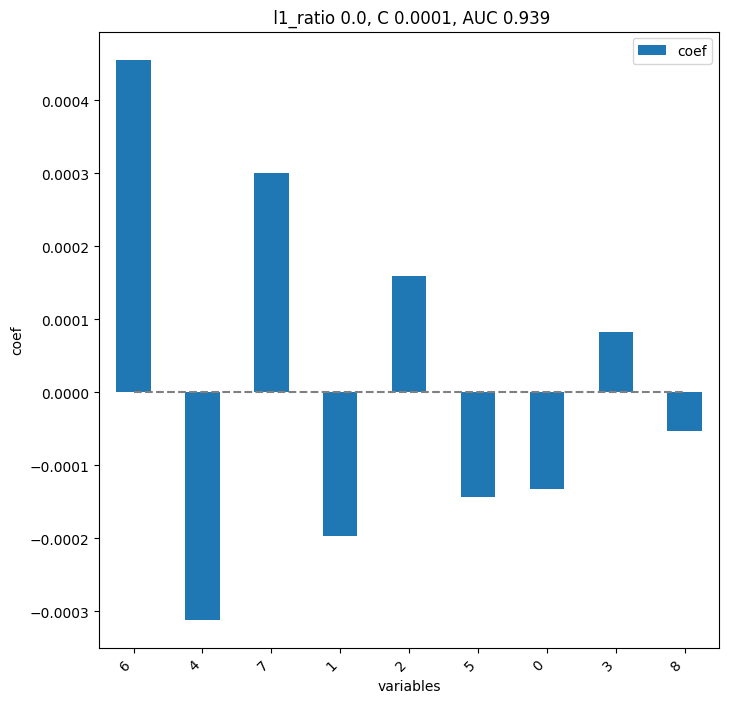

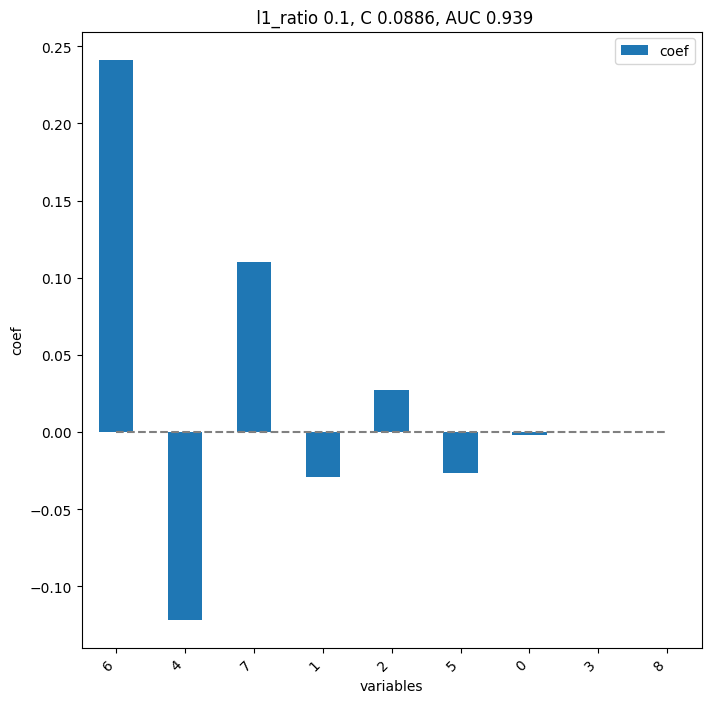

       pval  pval_corr
6  0.002331   0.020979
7  0.128205   0.576923
4  0.208625   0.625874
2  0.317599   0.689161
1  0.382867   0.689161
0  0.534965   0.802448
8  0.710373   0.804779
3  0.804779   0.804779
5  0.804779   0.804779


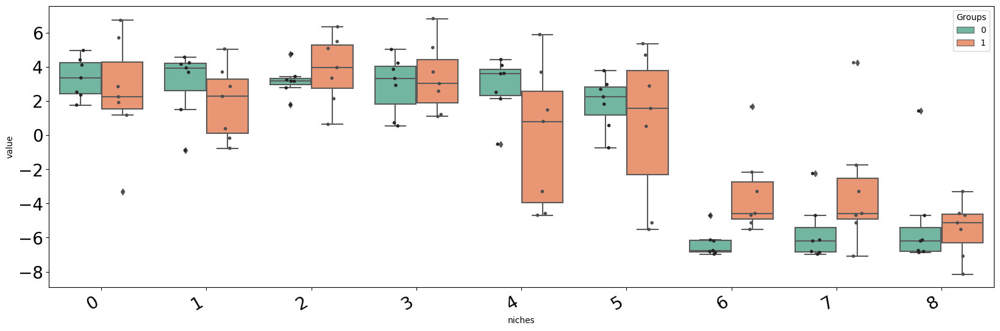

Loading clusterer object and cluster labels
There are 13 clusters
Loading reducer object and reduced coordinates


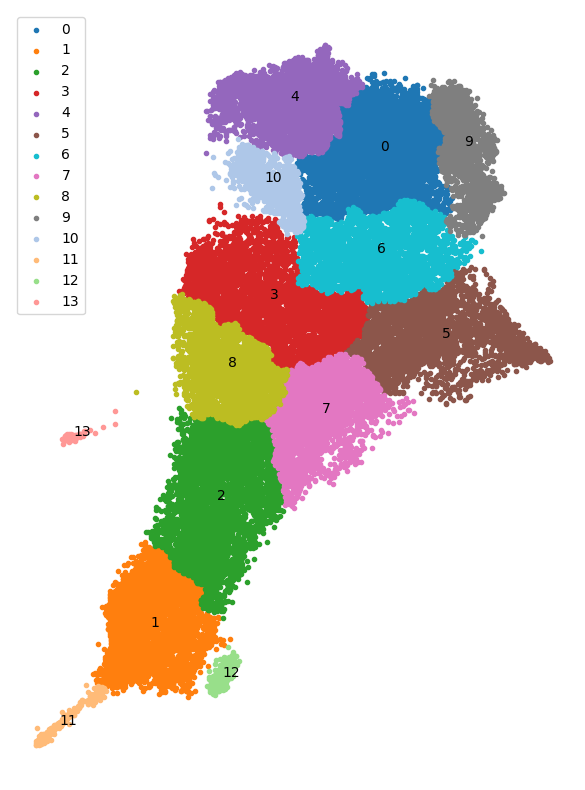

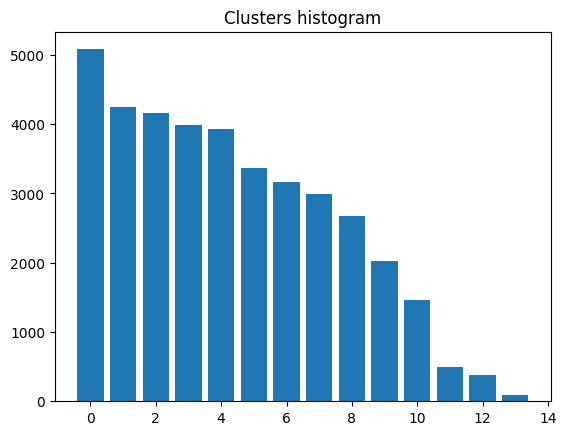

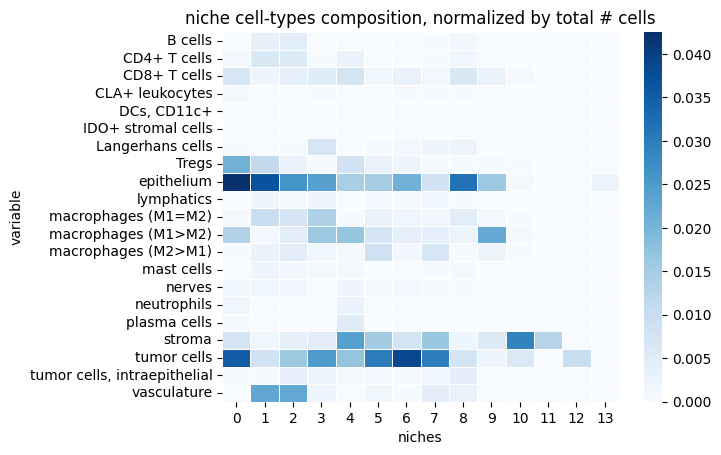

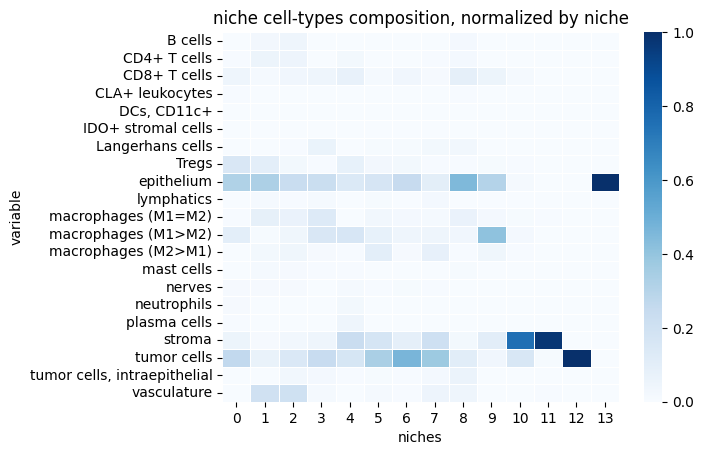

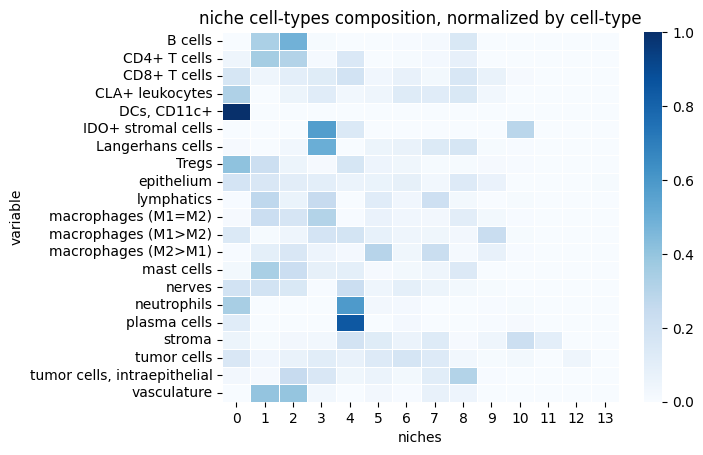

reducer_type-umap_n_neighbors-200_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


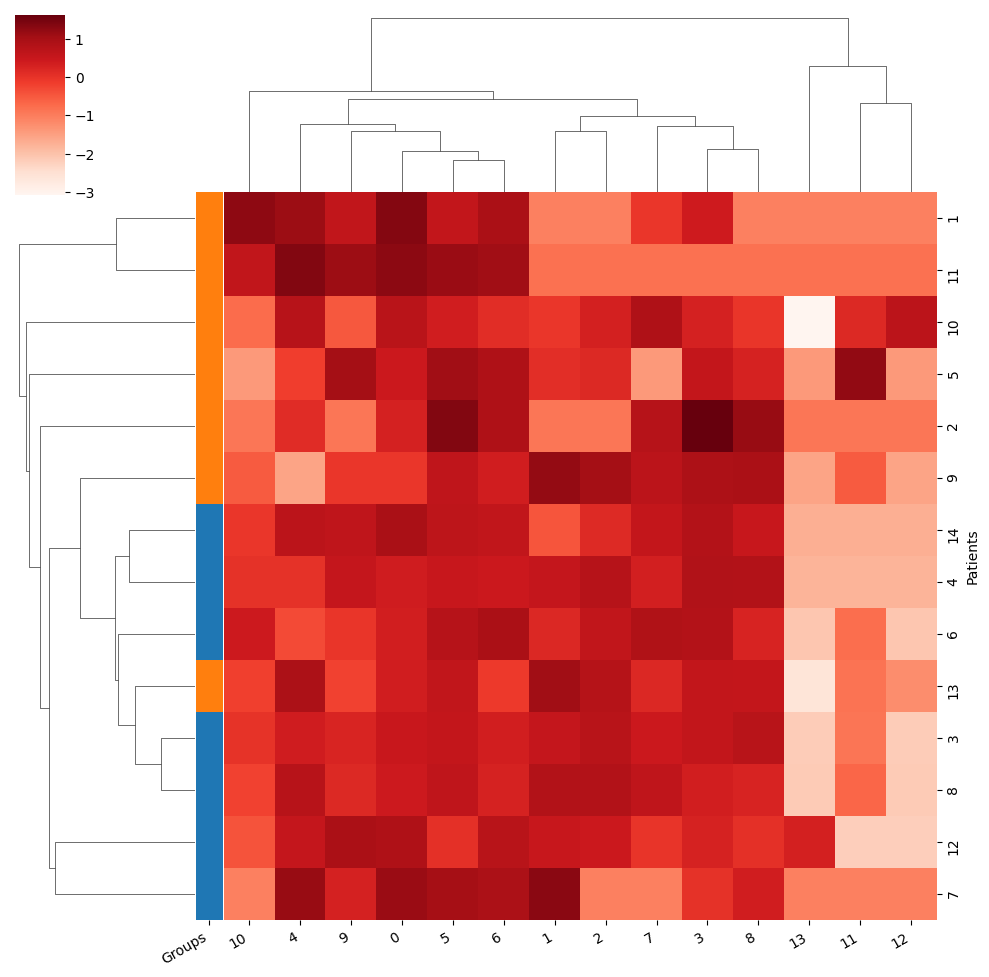

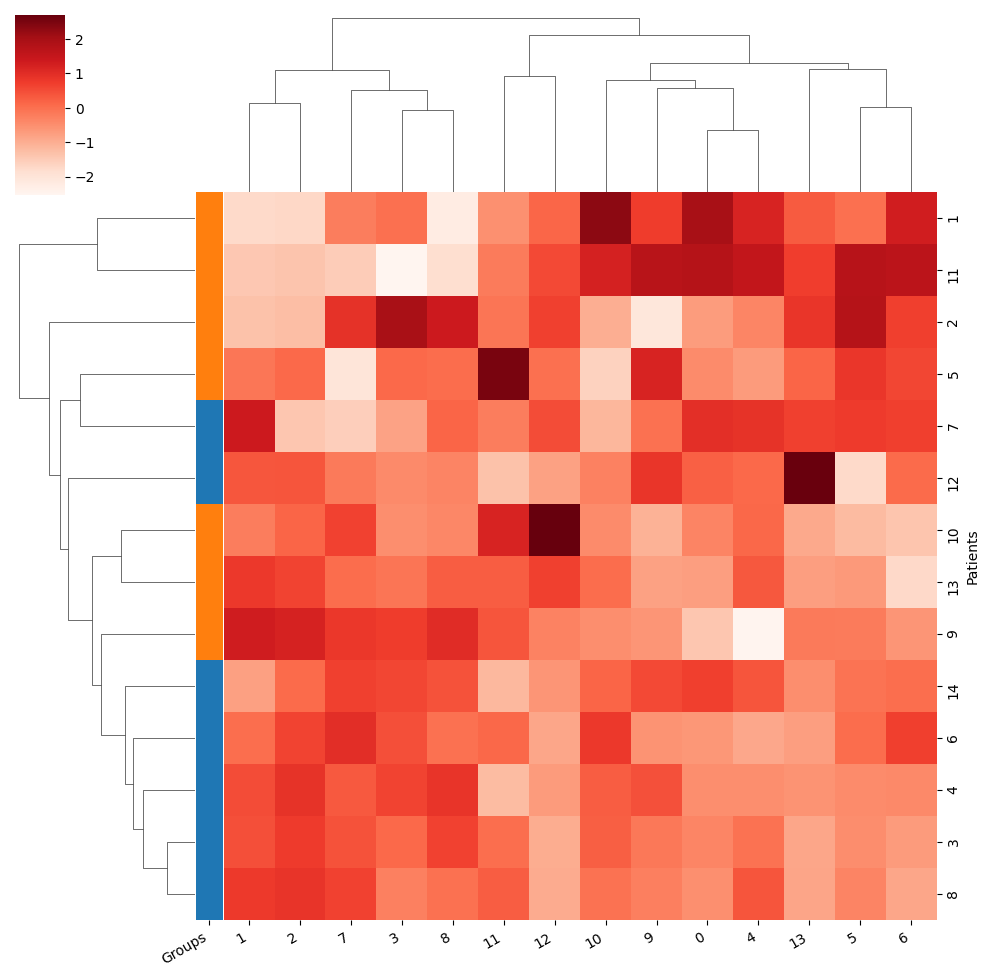

Training took 2.435s


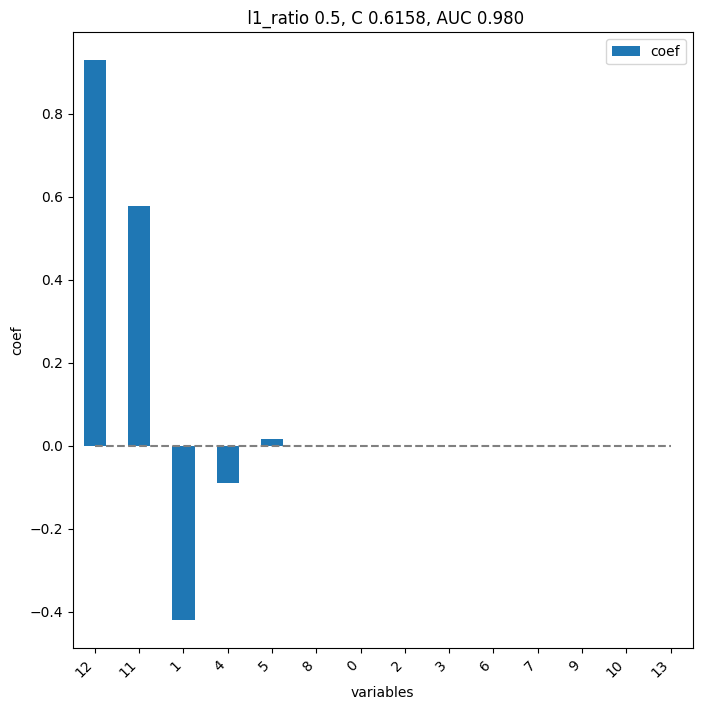

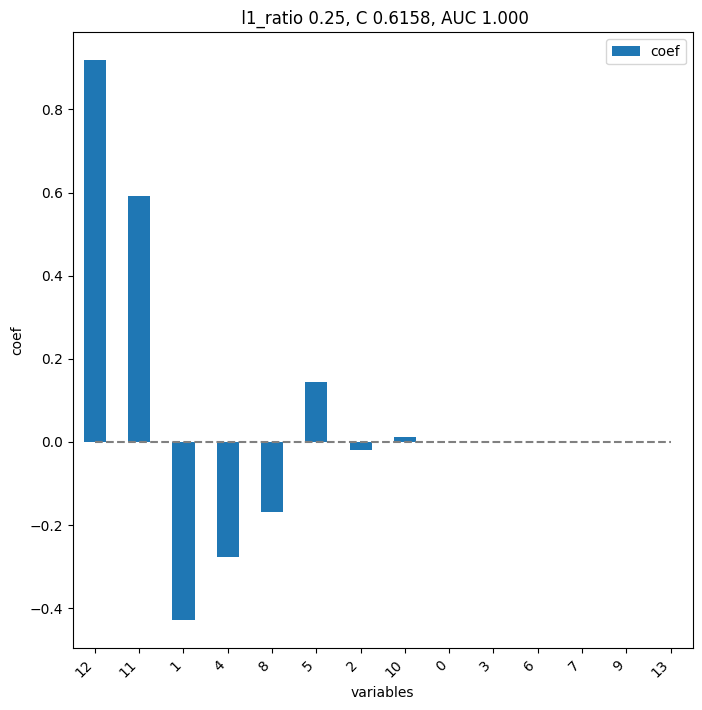

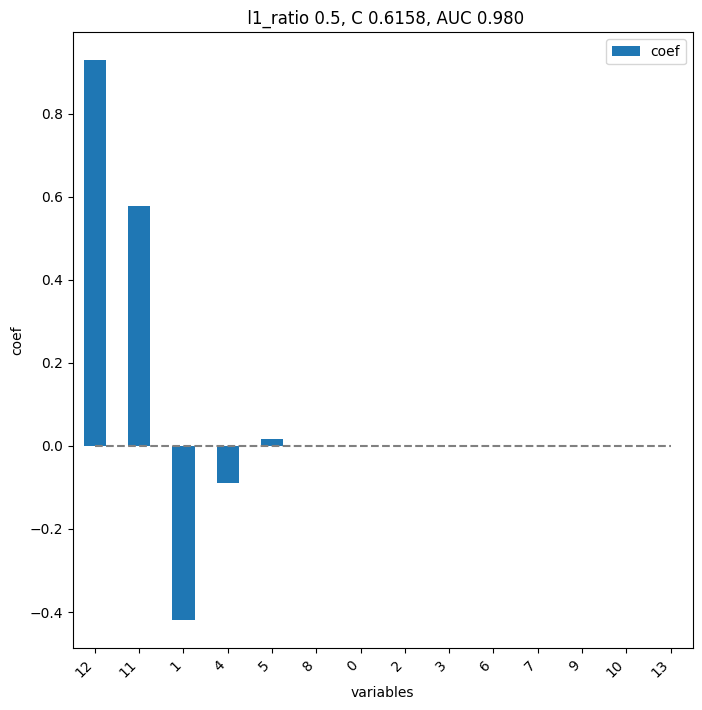

        pval  pval_corr
12  0.004079   0.057110
11  0.097319   0.681235
1   0.208625   0.828768
2   0.382867   0.828768
5   0.382867   0.828768
13  0.534965   0.828768
9   0.620047   0.828768
10  0.620047   0.828768
0   0.710373   0.828768
6   0.710373   0.828768
7   0.710373   0.828768
8   0.710373   0.828768
3   1.000000   1.000000
4   1.000000   1.000000


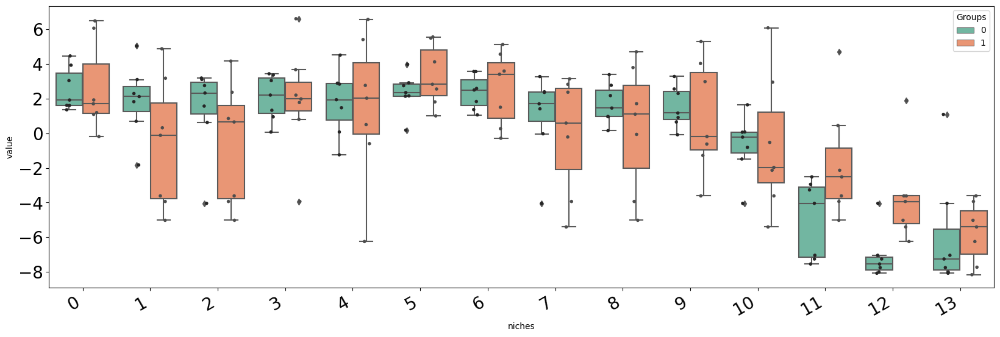

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-200', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 13 clusters
Loading reducer object and reduced coordinates


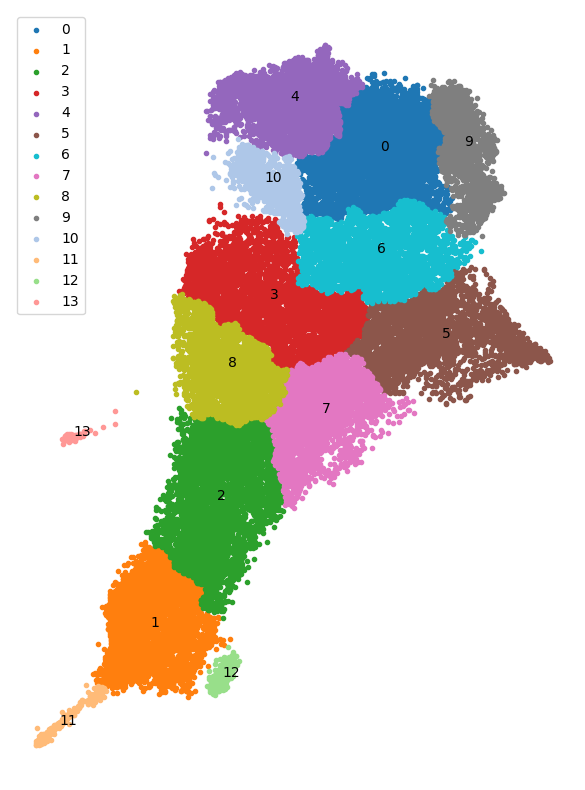

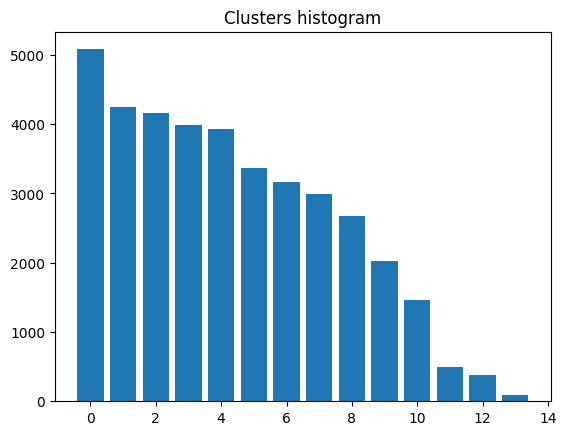

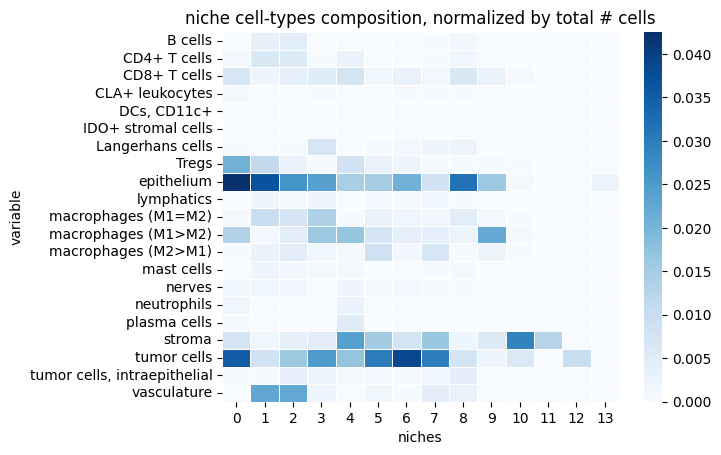

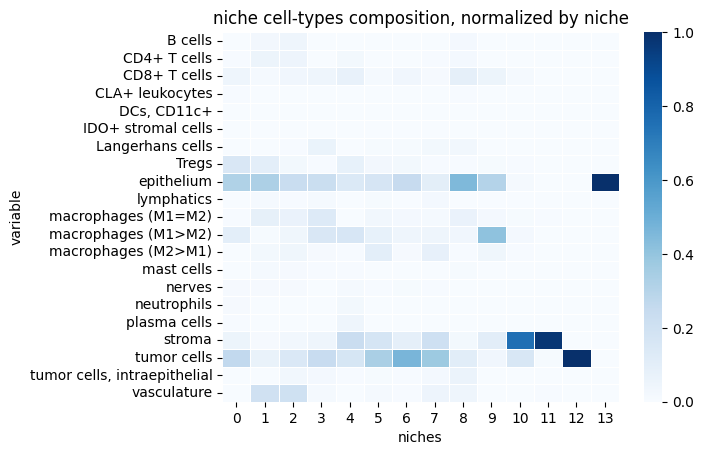

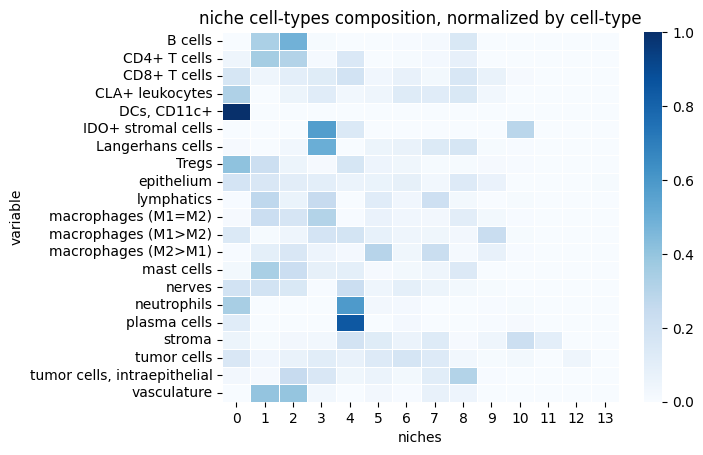

reducer_type-umap_n_neighbors-200_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


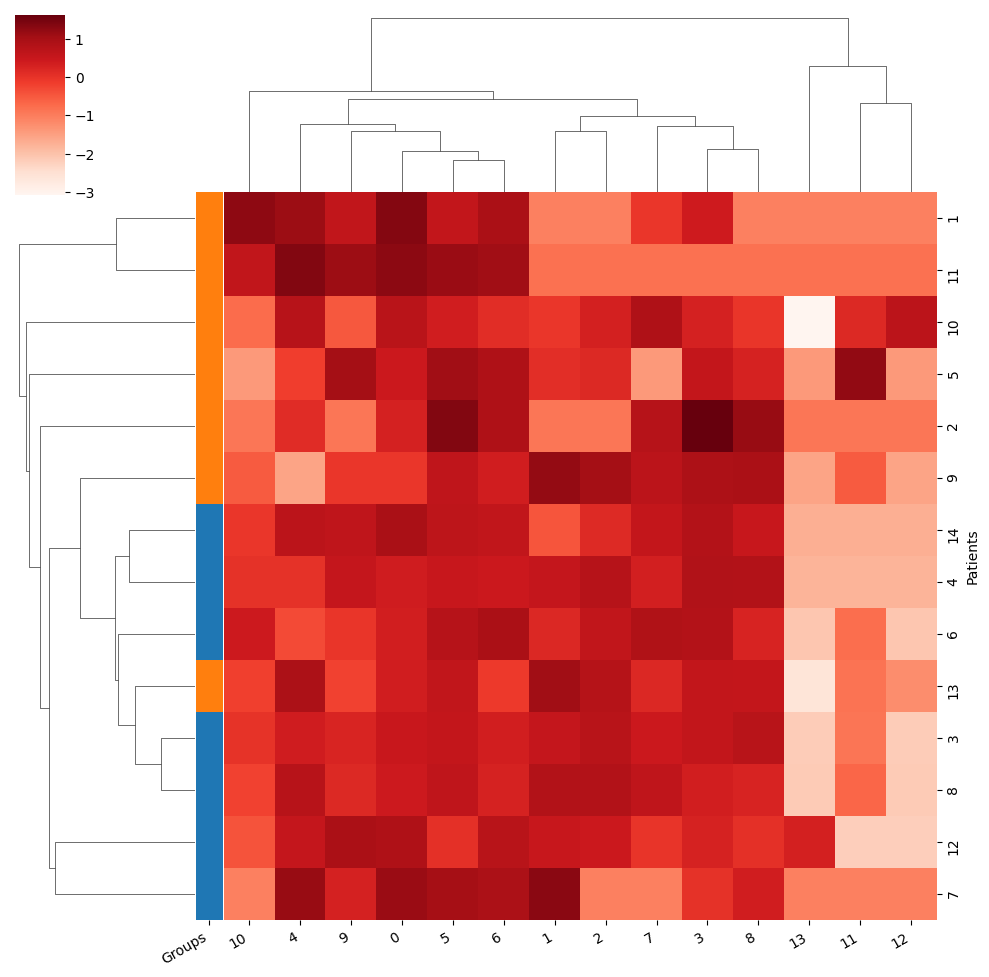

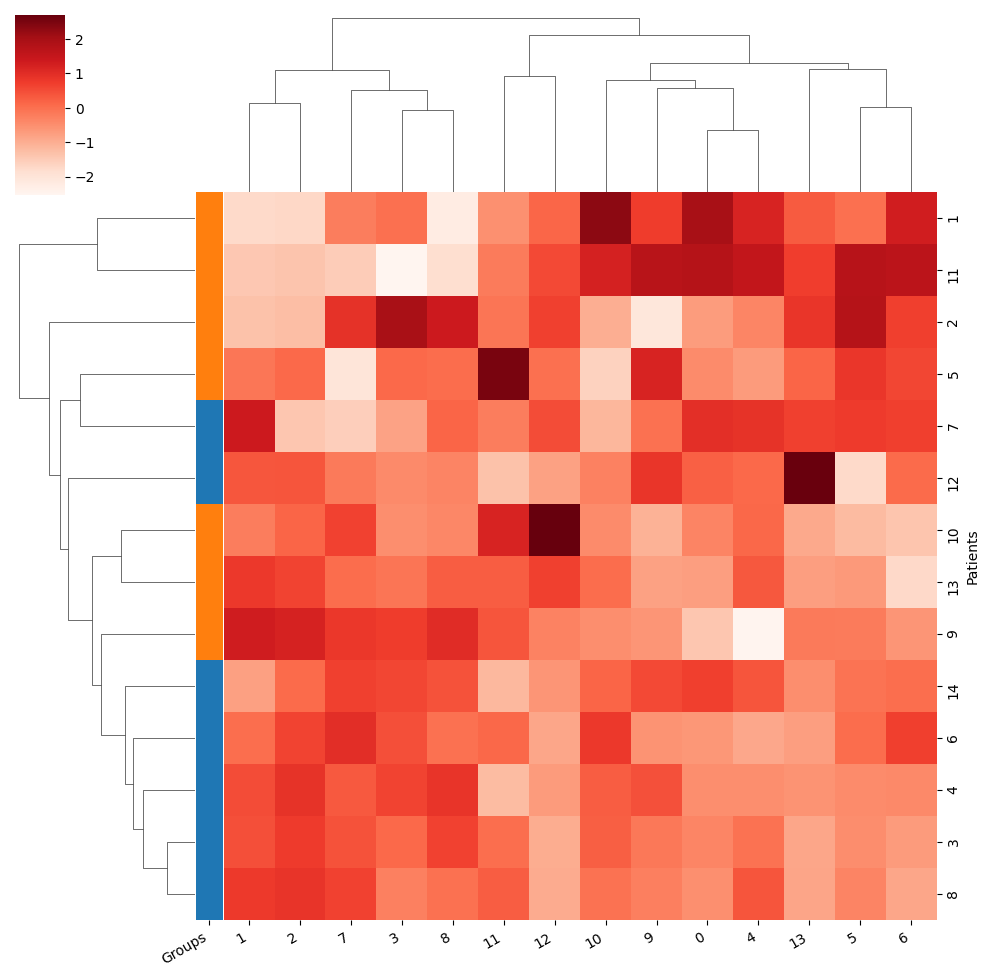

Training took 2.462s


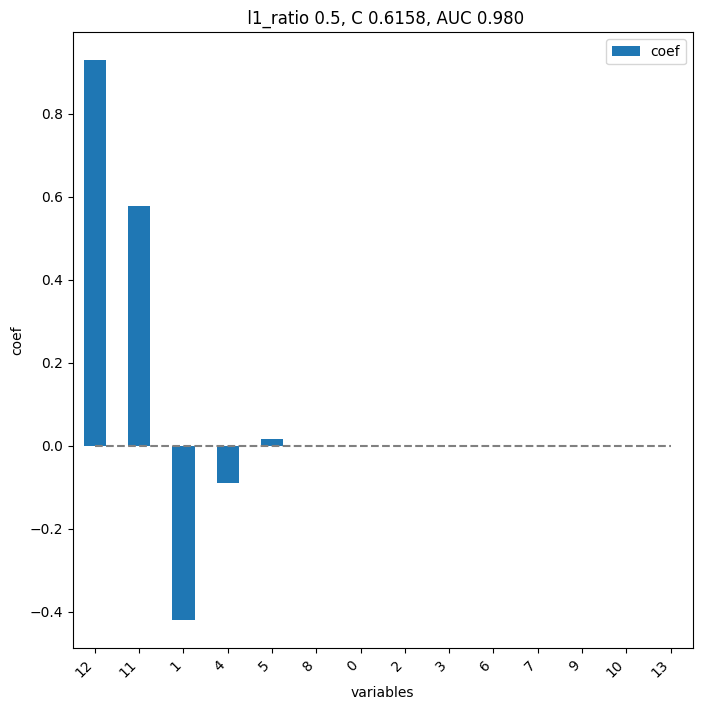

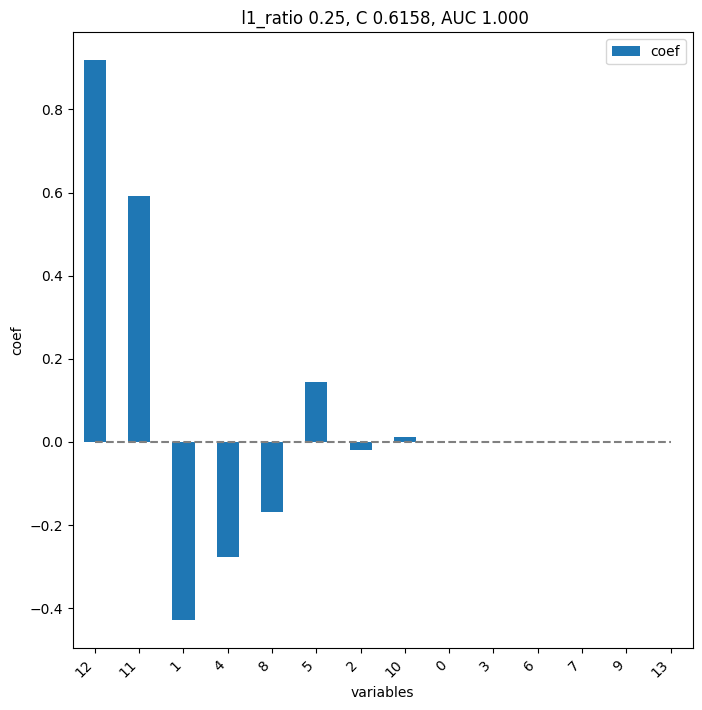

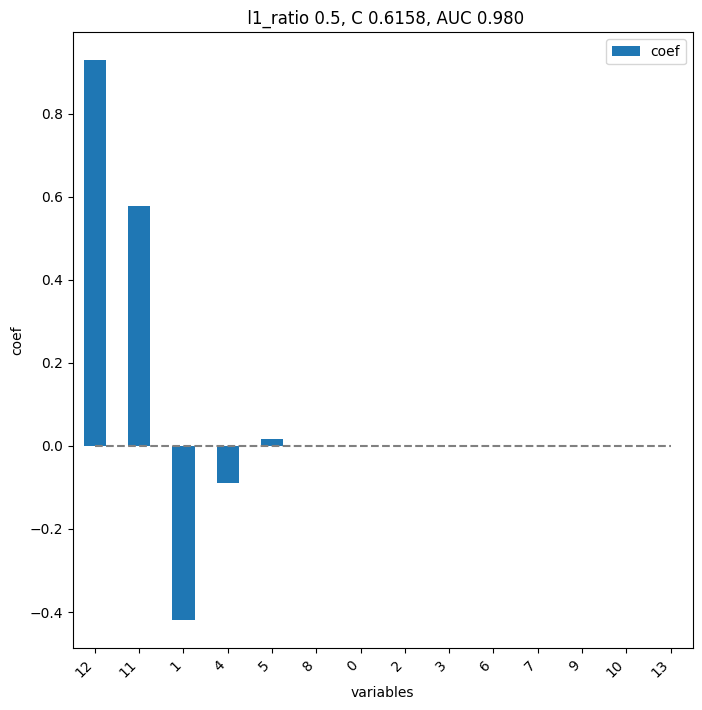

        pval  pval_corr
12  0.004079   0.057110
11  0.097319   0.681235
1   0.208625   0.828768
2   0.382867   0.828768
5   0.382867   0.828768
13  0.534965   0.828768
9   0.620047   0.828768
10  0.620047   0.828768
0   0.710373   0.828768
6   0.710373   0.828768
7   0.710373   0.828768
8   0.710373   0.828768
3   1.000000   1.000000
4   1.000000   1.000000


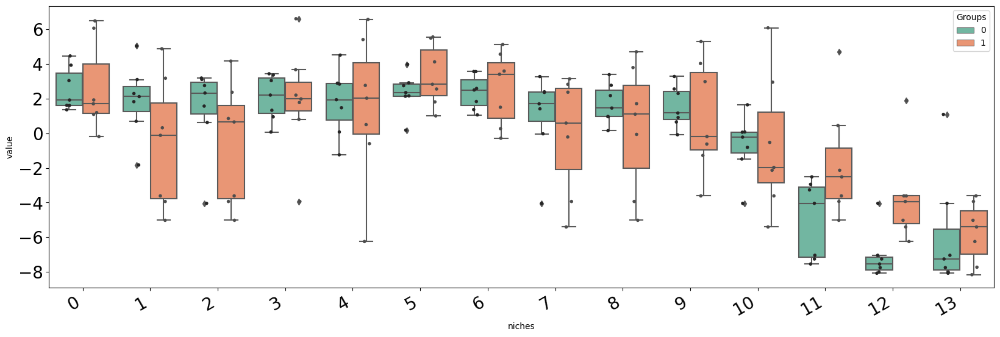

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


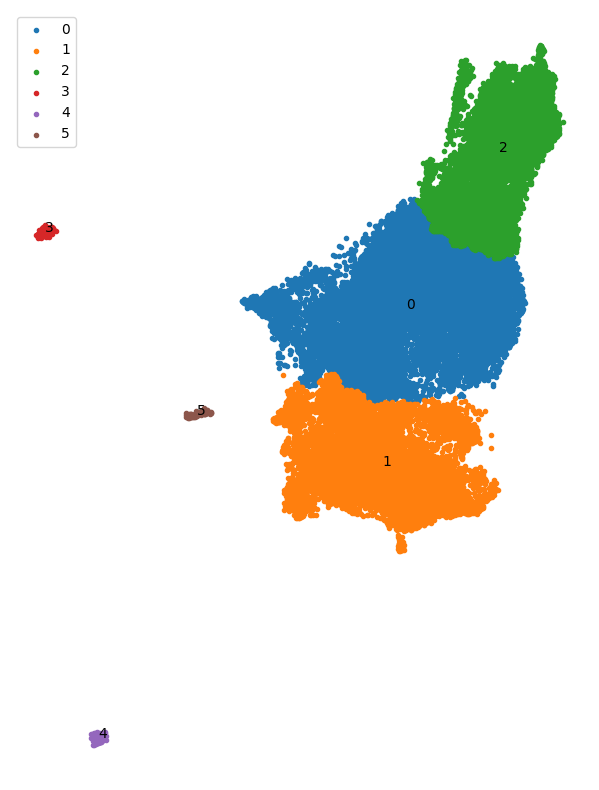

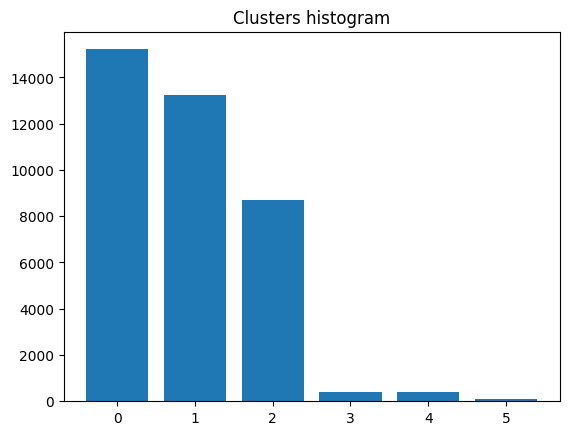

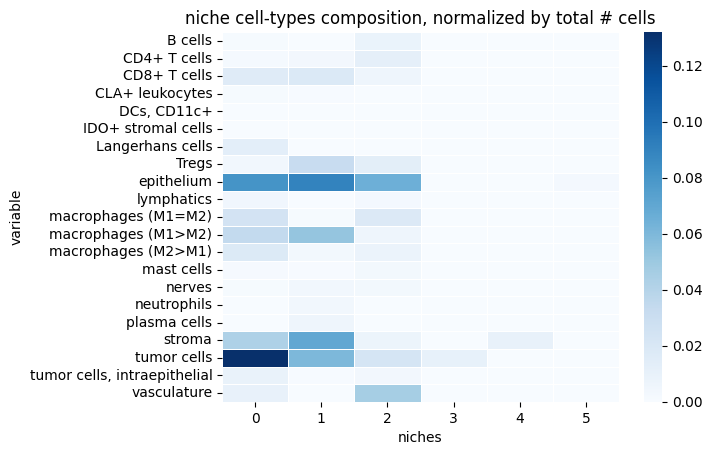

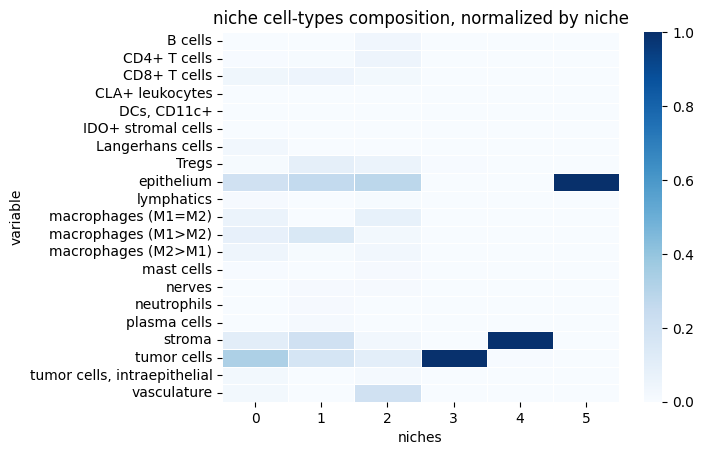

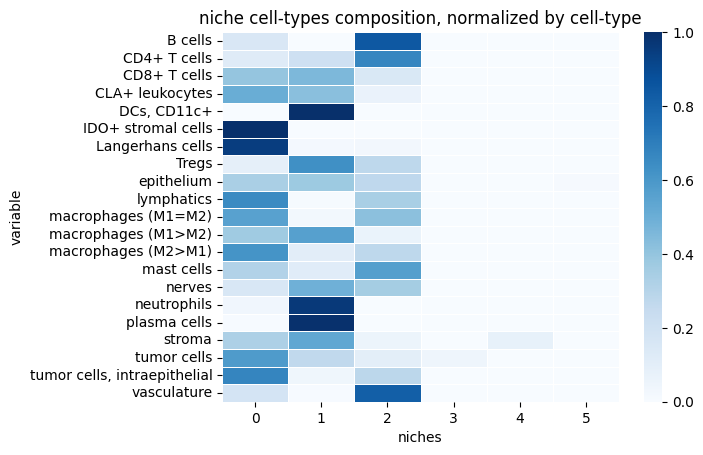

reducer_type-umap_n_neighbors-45_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


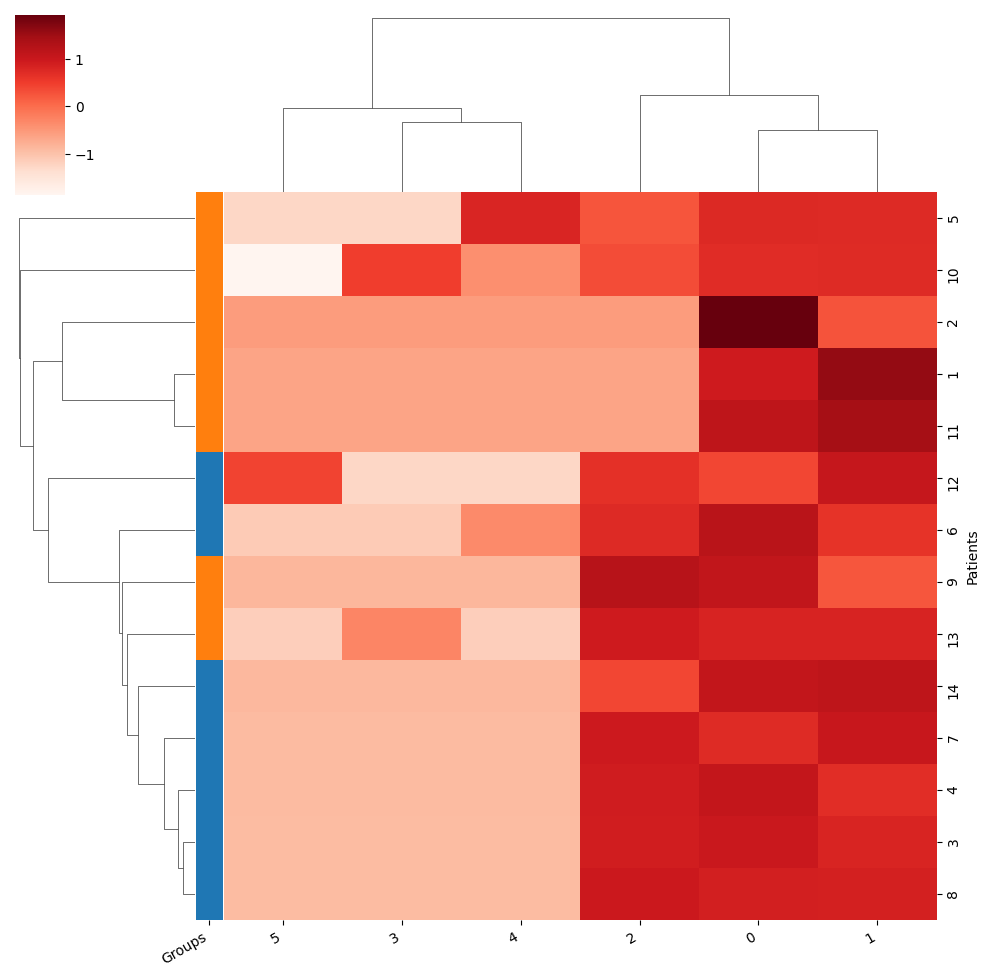

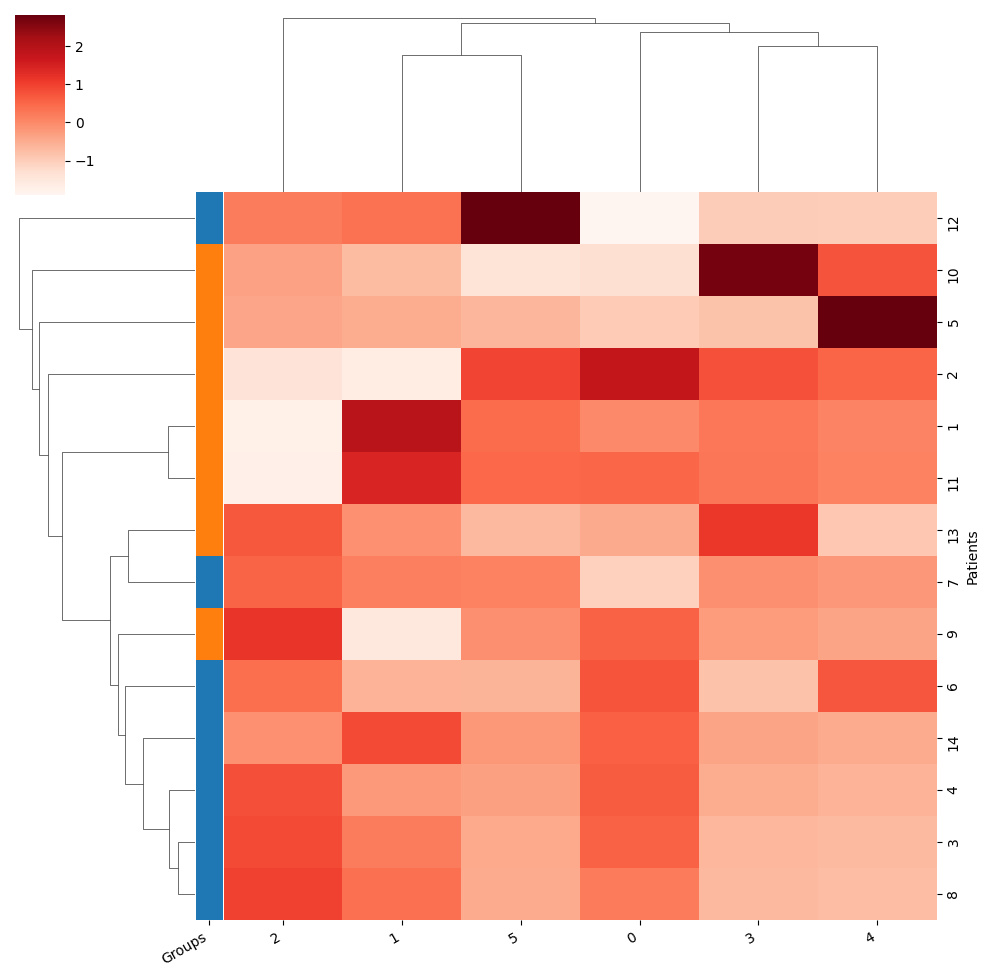

Training took 2.401s


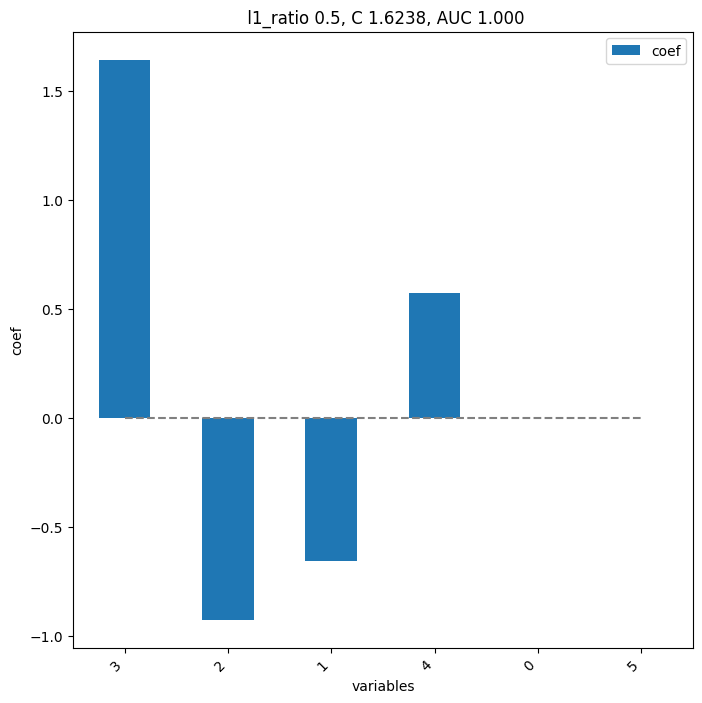

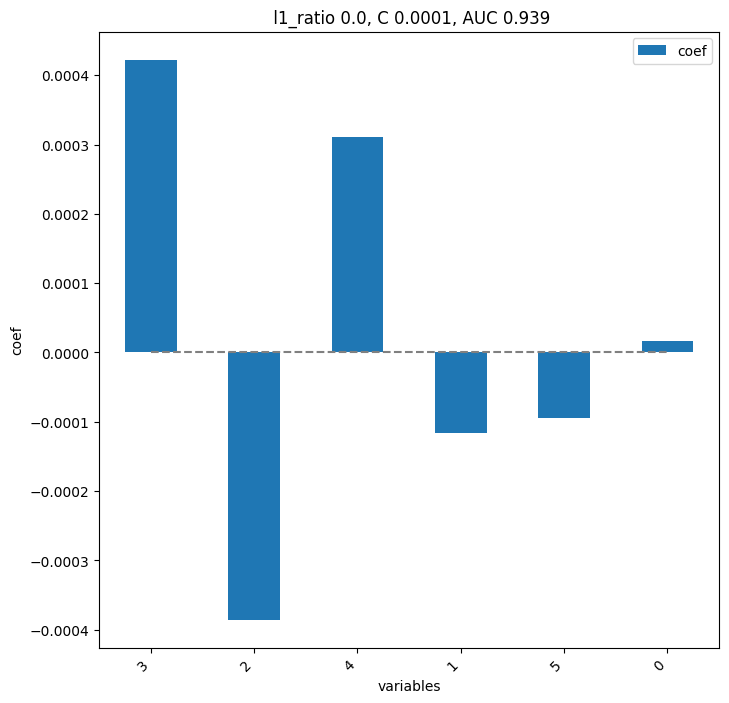

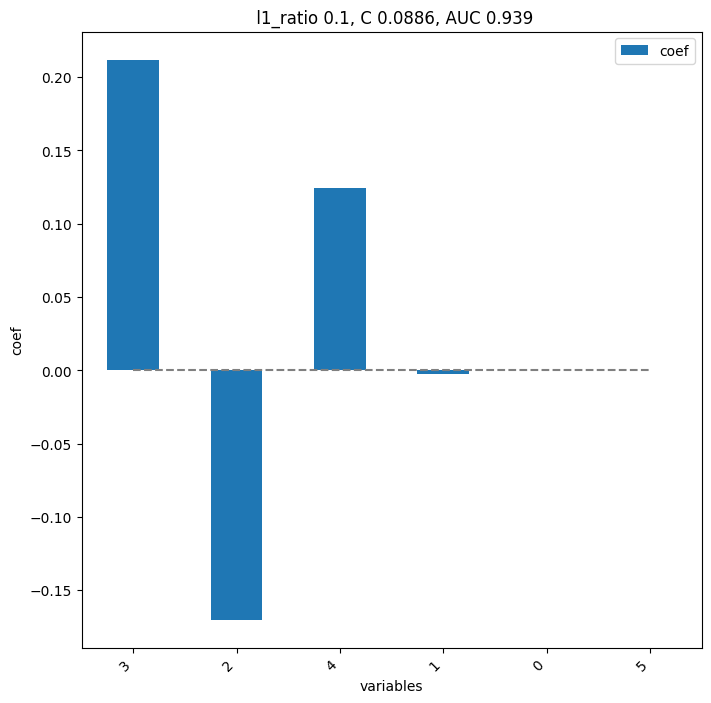

       pval  pval_corr
3  0.026224   0.157343
2  0.097319   0.194639
4  0.097319   0.194639
1  0.382867   0.574301
0  0.620047   0.744056
5  0.901515   0.901515


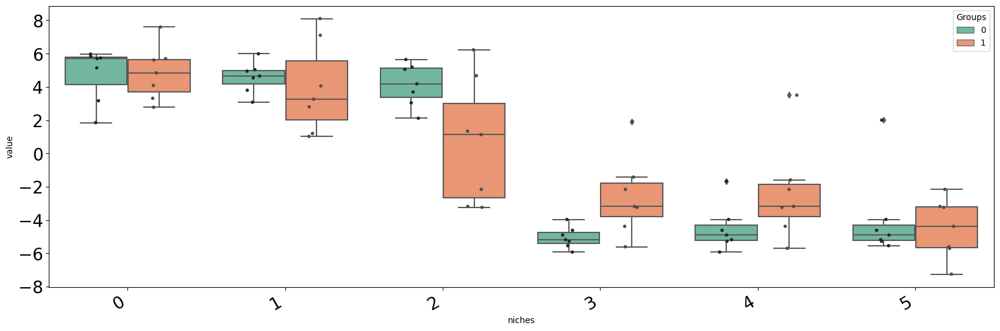

In [62]:
if RUN_LONG:
    for file_name in file_names:
        # extract parameters from file name
        cluster_params, normalize_pred = get_params_from_str(file_name.stem)

        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
        str_params = str_params + f'_normalize-{normalize_pred}'
        print(str_params)

        cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

        embed_viz, _ = mosna.get_reducer(
            var_aggreg, 
            sof_dir, 
            reducer_type=cluster_params['reducer_type'], 
            n_neighbors=cluster_params['n_neighbors'], 
            metric=cluster_params['metric'],
            )

        mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
        figname = f"{str_params}_niches_embedding.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Niches total counts
        class_id, class_count = np.unique(cluster_labels, return_counts=True)
        plt.bar(class_id, class_count, width=0.8);
        plt.title('Clusters histogram');
        figname = f"{str_params}_niches_total_count.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Niches composition
        niches = cluster_labels

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
        title = "niche cell-types composition, normalized by total # cells"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
        title = "niche cell-types composition, normalized by niche"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
        title = "niche cell-types composition, normalized by cell-type"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()


        # Make count table of cells in niches per patient with clinical data

        var_aggreg_niches = var_aggreg_samples_info.copy()
        var_aggreg_niches['niche'] = np.array(niches)

        counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
        counts.index = counts.index.astype(status.index.dtype)
        exo_vars = counts.columns.tolist()
        df_surv = counts.merge(status, how='inner', on=var_label)

        # Biclustering
        g, d = mosna.plot_heatmap(
            df_surv[exo_vars + [group_col]].reset_index(), 
            obs_labels=var_label, 
            group_var=group_col, 
            groups=[0, 1],
            figsize=(10, 10),
            z_score=False,
            cmap=sns.color_palette("Reds", as_cmap=True),
            return_data=True,
            )
        figname = f"{str_params}_biclustering.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        g, d = mosna.plot_heatmap(
            df_surv[exo_vars + [group_col]].reset_index(), 
            obs_labels=var_label, 
            group_var=group_col, 
            groups=[0, 1],
            figsize=(10, 10),
            z_score=1,
            cmap=sns.color_palette("Reds", as_cmap=True),
            return_data=True,
            )
        figname = f"{str_params}_biclustering_col_zscored.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Logistic regression
        split_train_test = False
        models = mosna.logistic_regression(
            df_surv[exo_vars + [group_col]],
            y_name=group_col,
            col_drop=[var_label],
            cv_train=cv_train, 
            cv_adapt=cv_adapt, 
            cv_max=cv_max,
            plot_coefs=True,
            split_train_test=split_train_test,
            save_plot_figures=True,
            save_dir=dir_save,
            str_prefix=str_params,
            )
        plt.show()

        # p-values
        pvals = mosna.find_DE_markers(
            df_surv[exo_vars + [group_col]], 
            group_ref=1, 
            group_tgt=0, 
            group_var=group_col,
            )
        print(pvals.head(20))

        # Proportion of niches per response group
        fig, ax = mosna.plot_distrib_groups(
            df_surv[exo_vars + [group_col]], 
            group_var=group_col,
            groups=[0, 1], 
            pval_data=None, 
            max_cols=20, 
            multi_ind_to_col=True,
            var_name='niches',
            )
            plt.show()


#### Inspect niches from select NAS parameters

In [71]:
# We select the NAS parameters among:
selected_str_params = [
    'reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr',
    'reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr',
    'reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr',
]

best_params_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/select_nas_on-markers_stats-default_order-1')
save_dir = best_params_dir
save_fig = True

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


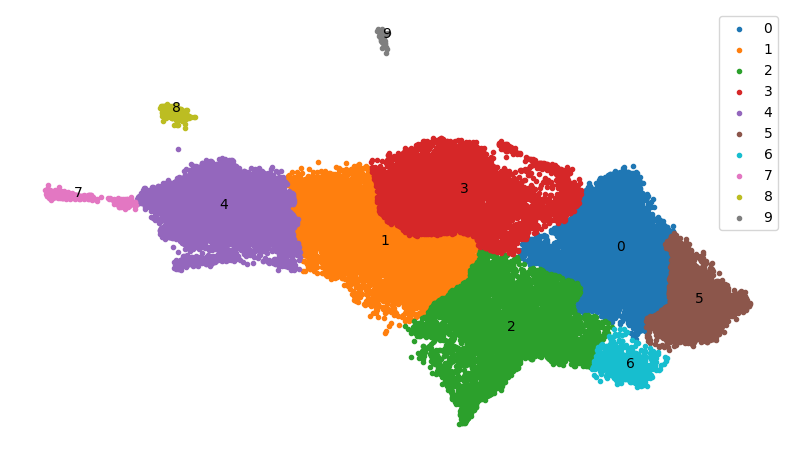

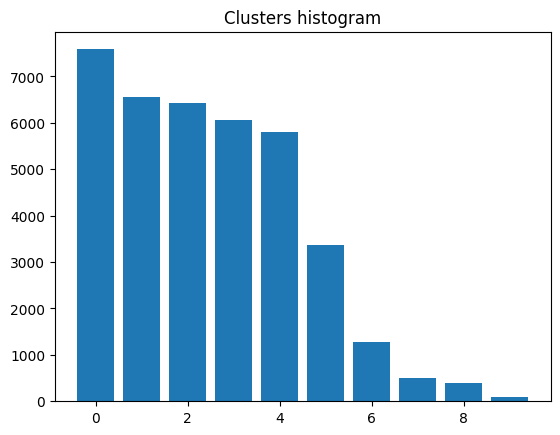

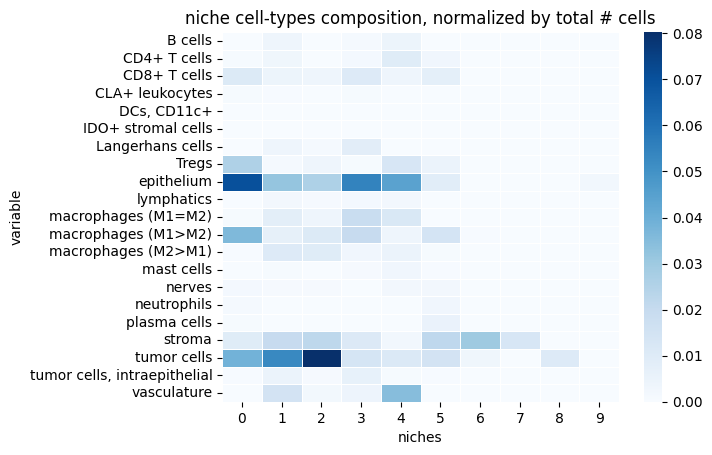

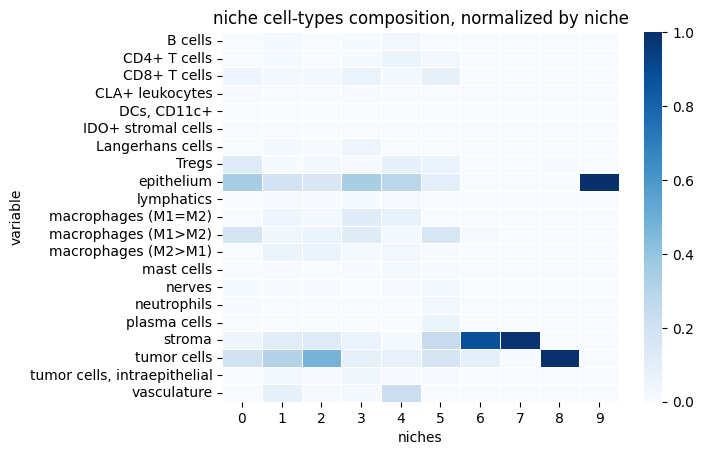

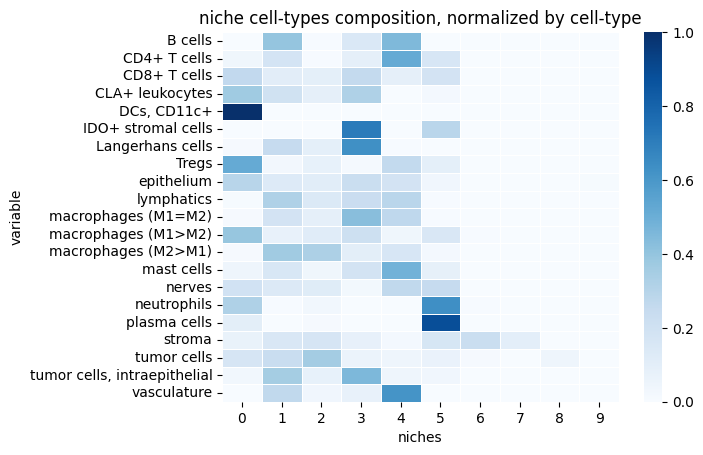

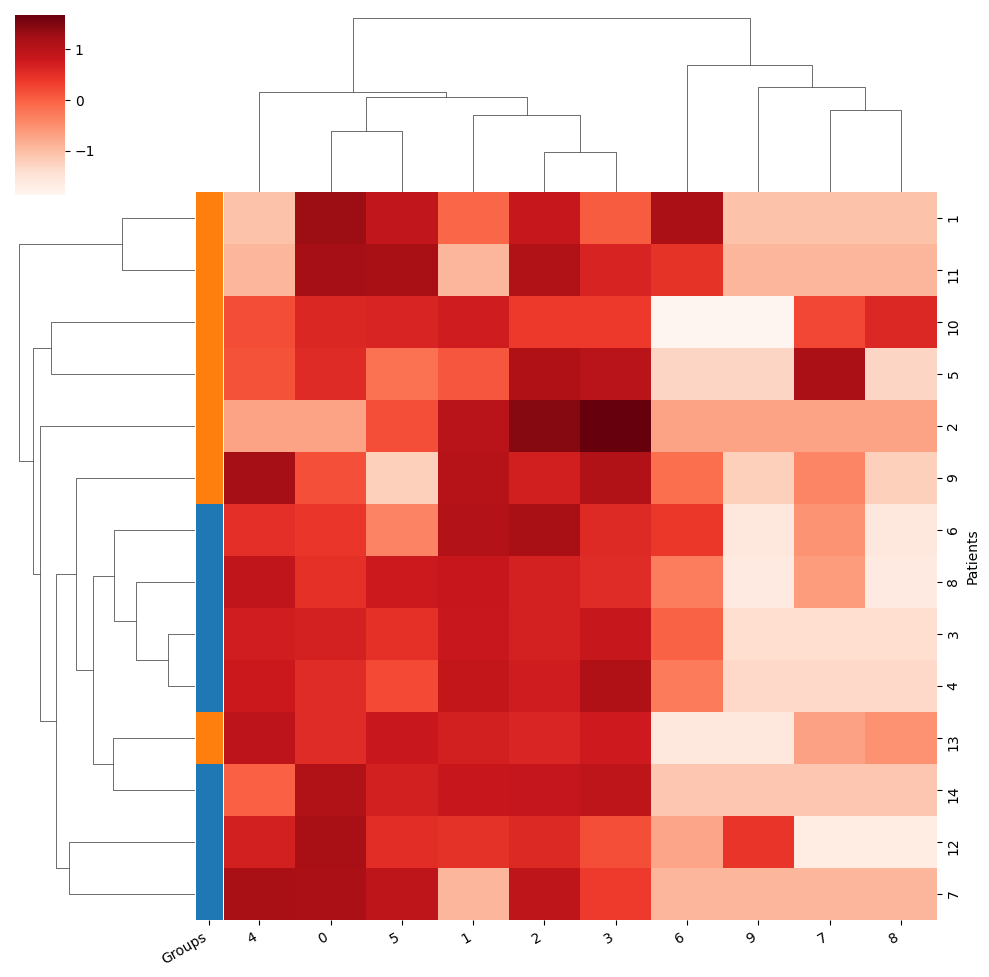

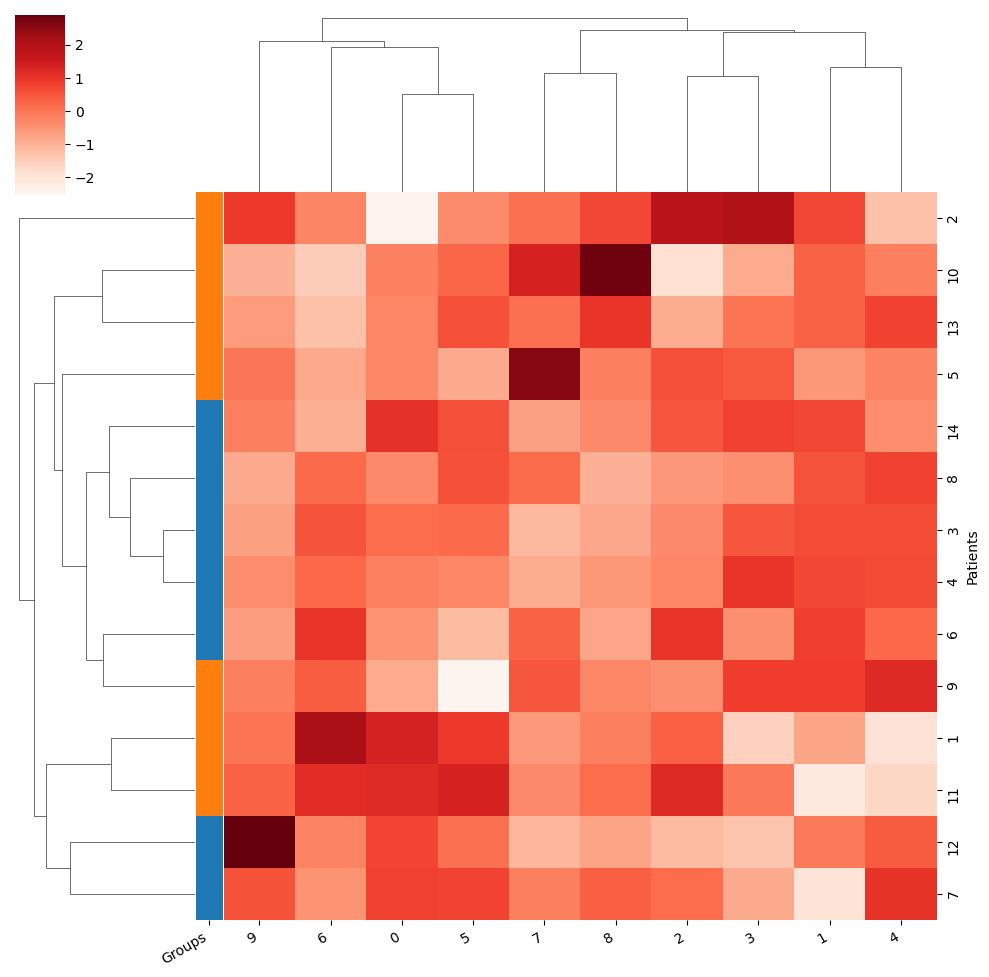

Training took 2.603s


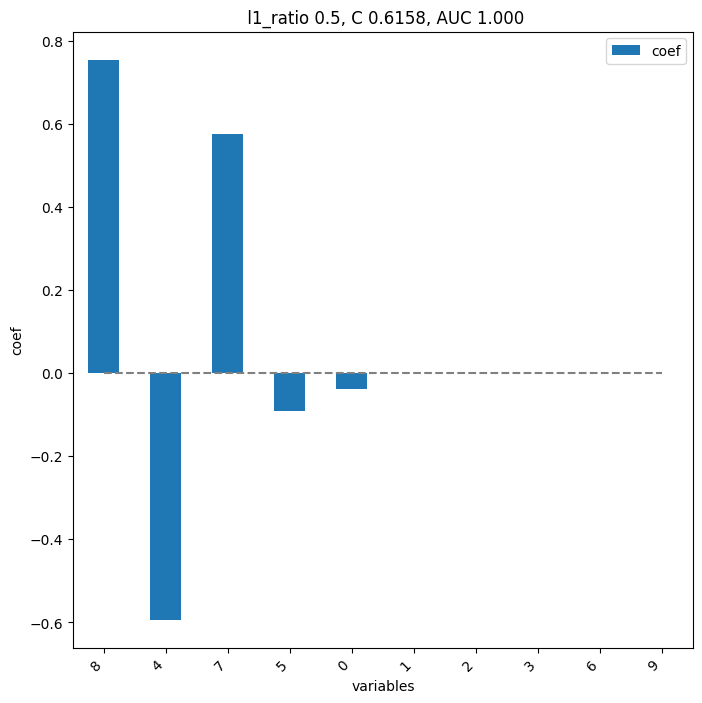

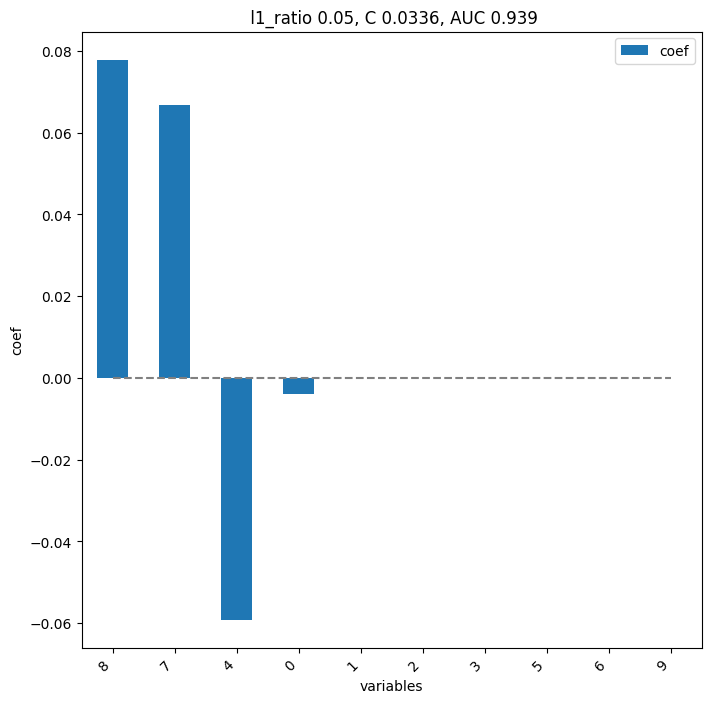

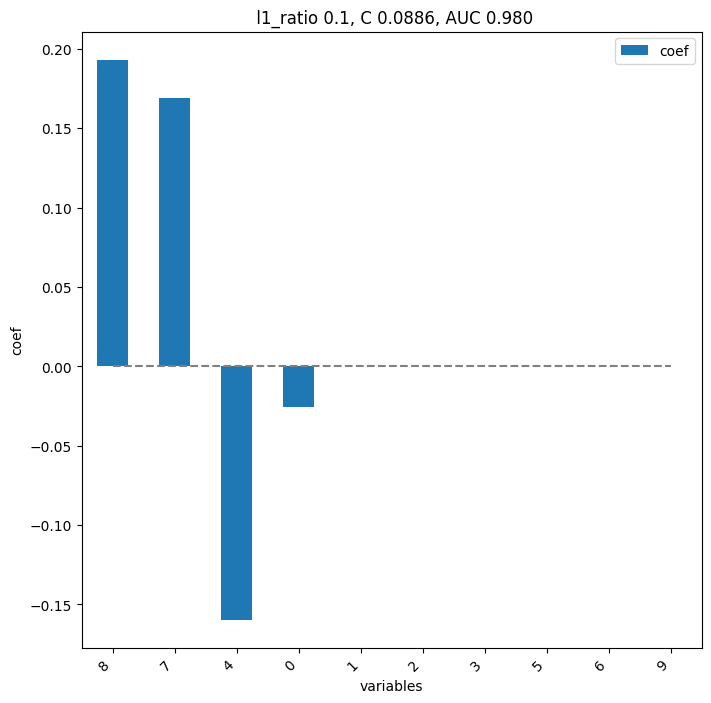

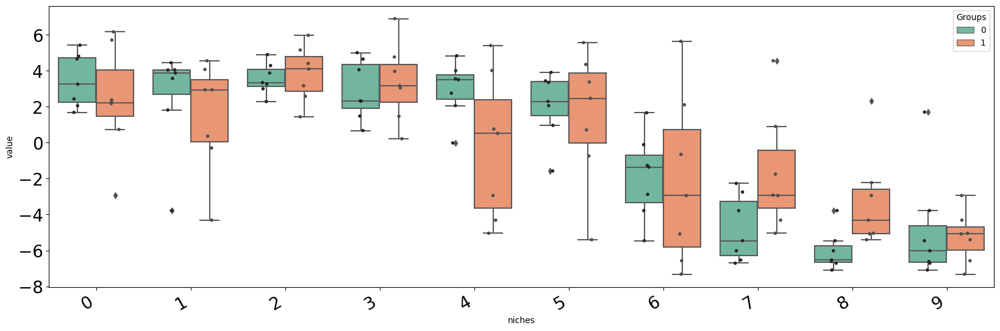

<Figure size 640x480 with 0 Axes>

In [72]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[0])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [73]:
pvals.head(20)

,pval,pval_corr
8,0.006993,0.069930
7,0.072844,0.364219
4,0.259324,0.864413
1,0.534965,1.000000
0,0.620047,1.000000
9,0.620047,1.000000
2,0.710373,1.000000
6,0.804779,1.000000
3,0.901515,1.000000
5,1.000000,1.000000


In [74]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8,9
Patients,,,,,,,,,,
1,6.169745,-0.295362,4.099087,0.215463,-5.045173,4.352228,5.639532,-5.045173,-5.045173,-5.045173
10,2.372413,2.940792,1.439396,1.463206,0.758225,2.465135,-7.323790,0.902119,2.306294,-7.323790
11,5.709252,-4.316971,5.154310,3.047800,-4.316971,5.566676,2.106816,-4.316971,-4.316971,-4.316971
12,4.657550,1.817940,2.287943,0.672808,2.752249,2.059102,-2.882541,-6.533739,-6.533739,1.702427
13,2.218925,2.943729,2.578519,3.166306,4.016515,3.376210,-6.573937,-2.922739,-2.229592,-6.573937
14,5.424759,4.057050,4.288657,4.652050,-0.017658,3.437606,-5.460616,-5.460616,-5.460616,-5.460616
2,-2.943639,4.074855,5.975417,6.904003,-2.943639,0.707559,-2.943639,-2.943639,-2.943639,-2.943639
3,3.254371,3.875220,3.259791,4.057217,3.501854,2.297409,-0.114738,-6.710375,-6.710375,-6.710375
4,2.433867,4.044943,3.340273,5.005728,3.548740,0.962050,-1.271542,-6.021353,-6.021353,-6.021353


Niches 8, 7 and 4 have high importance in predicting response to immunotherapy in all models. They correspond respectively to pure niches of tumor cells, stroma cells, and mixed niche of mostly epithelium, vasculature, tregs, macrophages (M1=M2), termed "EVTM".  
The tumor and stroma niches are associated with response, whereas the EVTM niche is associated with non-response.

Loading reducer object and reduced coordinates


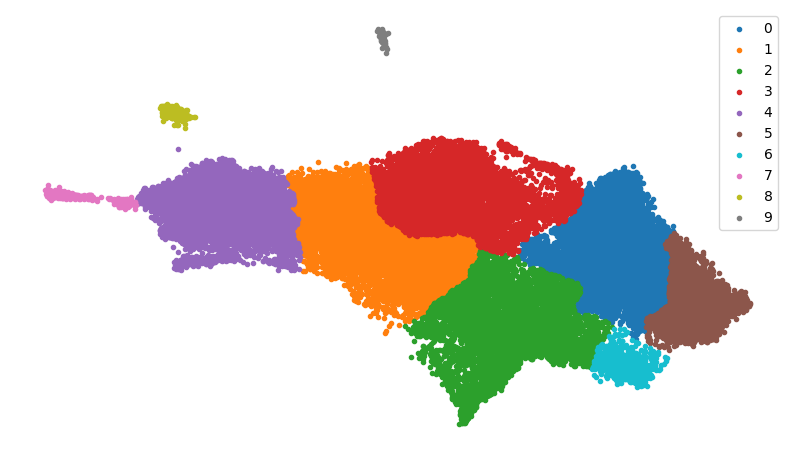

In [78]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
    )

In [ ]:
if RUN_LONG:
    save_dir = cluster_dir / 'spatial_networks_niches'
    save_dir.mkdir(parents=True, exist_ok=True)

    # colormap for cell-types
    n_cell_types = obj[pheno_col].unique().size
    # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
    # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
    niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
    plots_marker = '.'

    id_level_1 = 'patient'
    id_level_2 = 'sample'
    extension = 'parquet'
    read_fct = pd.read_parquet

    # build index of patients and samples files
    data_index = []
    len_ext = len(extension) + 1
    len_l1 = len(id_level_1) + 1
    len_l2 = len(id_level_2) + 1
    files = nodes_dir.glob(f'nodes_*.{extension}')
    for file in files:
        # parse patient and sample description
        file_name = file.name[6:-len_ext]
        patient_info, sample_info = file_name.split('_')
        patient_id = patient_info[len_l1:]
        sample_id = sample_info[len_l2:]
        # add info to data index
        data_index.append((patient_id, sample_id))

    for data_info in data_index:
        # load nodes and edges of a specific sample
        if len(data_info) == 1:
            str_group = f'{id_level_1}-{data_info[0]}'
        elif len(data_info) == 2:
            str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
        nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
        edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
        coords = nodes[pos_cols].values
        pairs = edges.values
        # bolean selector among aggregated data
        sample_id = data_info[1]
        select = (var_aggreg_samples_info['sample'] == sample_id).values

        # Big summary plot
        fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
        i = 0
        ty.plot_network(coords, 
                        pairs,
                        labels=nodes[pheno_col], 
                        color_mapper=celltypes_color_mapper, 
                        marker=plots_marker, 
                        size_nodes=size_points*10, 
                        ax=ax[0])
        ax[i].set_title('Spatial map of phenotypes', fontsize=14);

        i += 1
        ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        ax[i].set_title('Spatial map of detected areas', fontsize=14);
        ax[i].set_aspect('equal')

        i += 1
        ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
        ax[i].set_title("Clustering on NAS", fontsize=14);
        ax[i].set_aspect('equal')

        i += 1
        ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
        ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
        ax[i].set_aspect('equal')
        
        # make plot limits equal
        ax[i-1].set_xlim(ax[i].get_xlim())
        ax[i-1].set_ylim(ax[i].get_ylim())

        suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
        fig.suptitle(suptitle, fontsize=18)

        fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()


        fig, ax = plt.subplots(figsize=(10, 10))
        ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        ax.set_title('Spatial map of detected areas', fontsize=14);
        ax.set_aspect('equal')
        fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels


There are 8 clusters
Loading reducer object and reduced coordinates


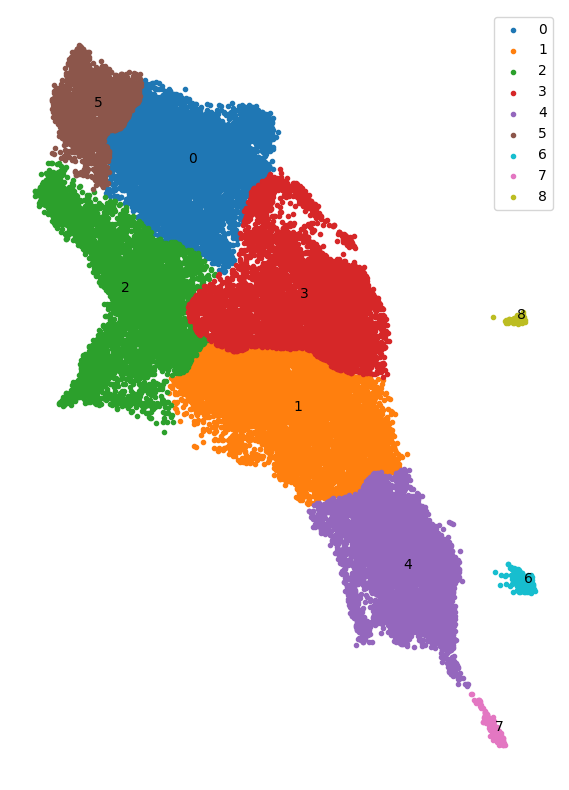

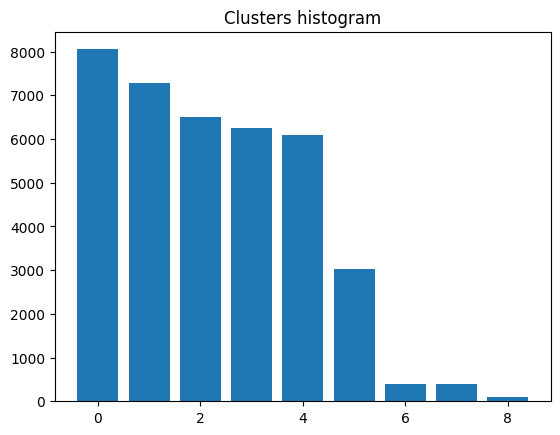

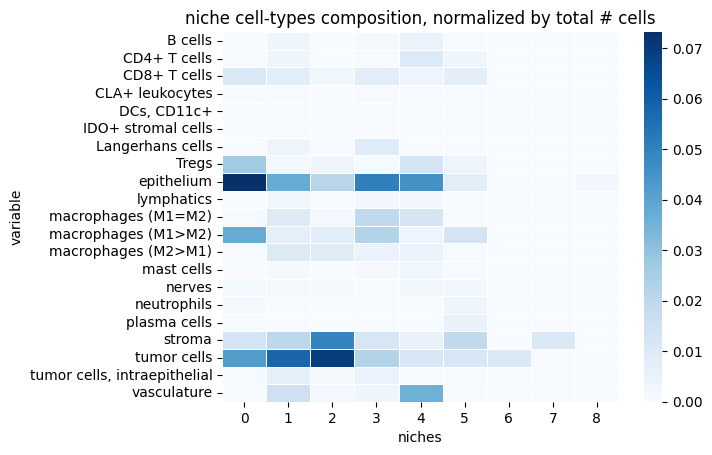

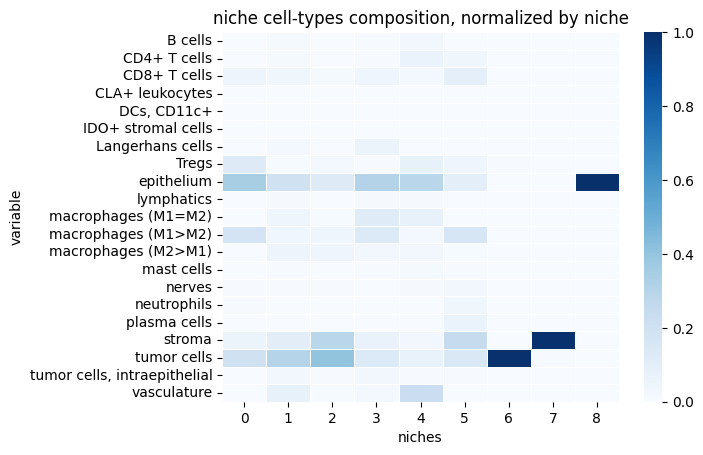

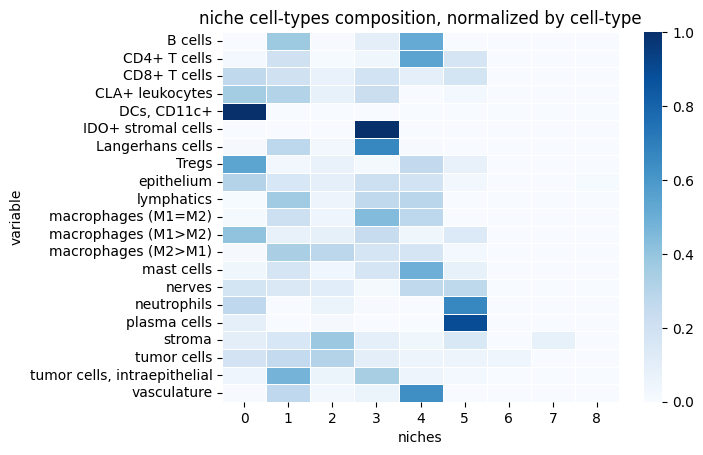

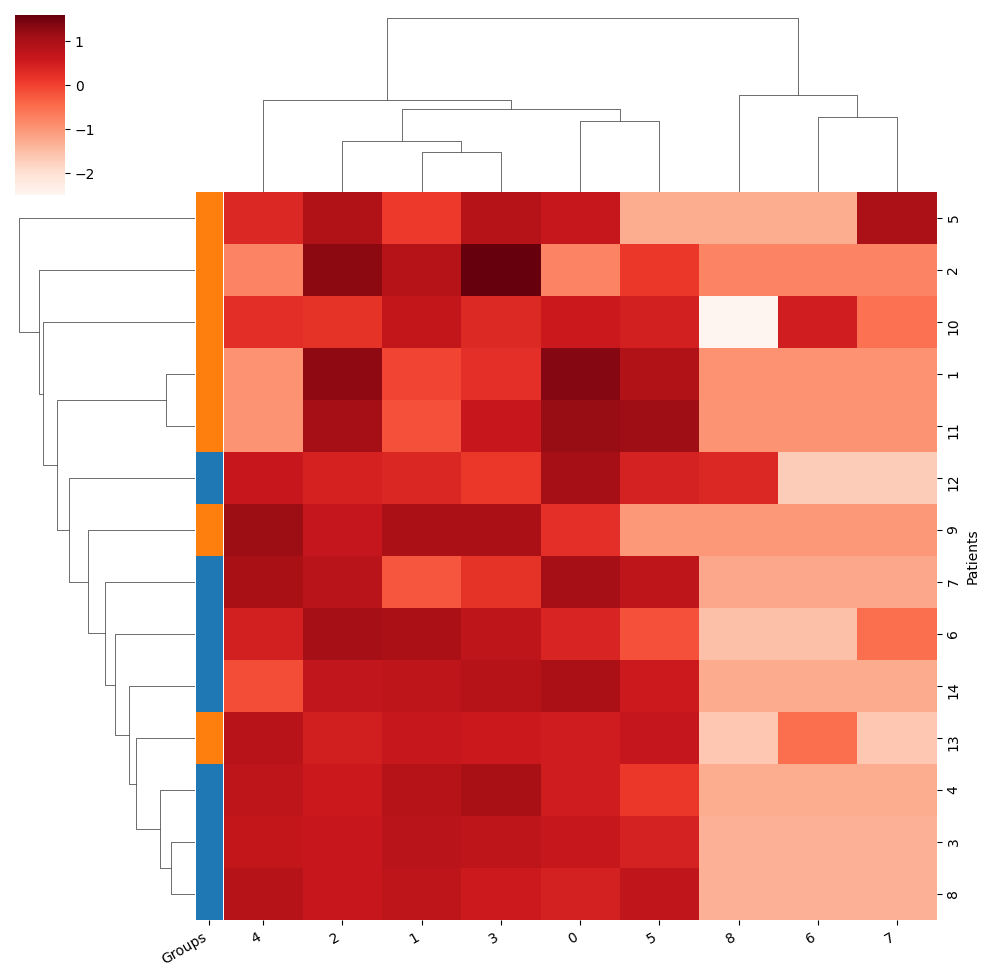

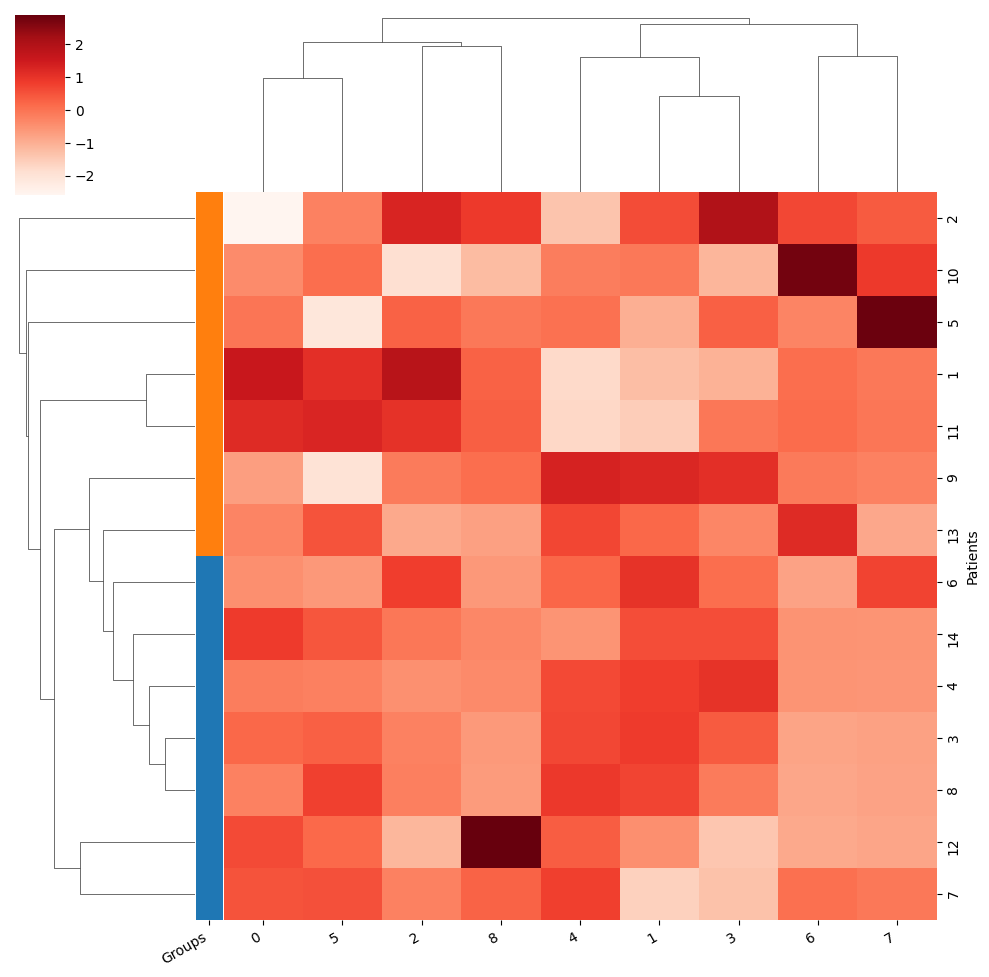

Training took 2.506s


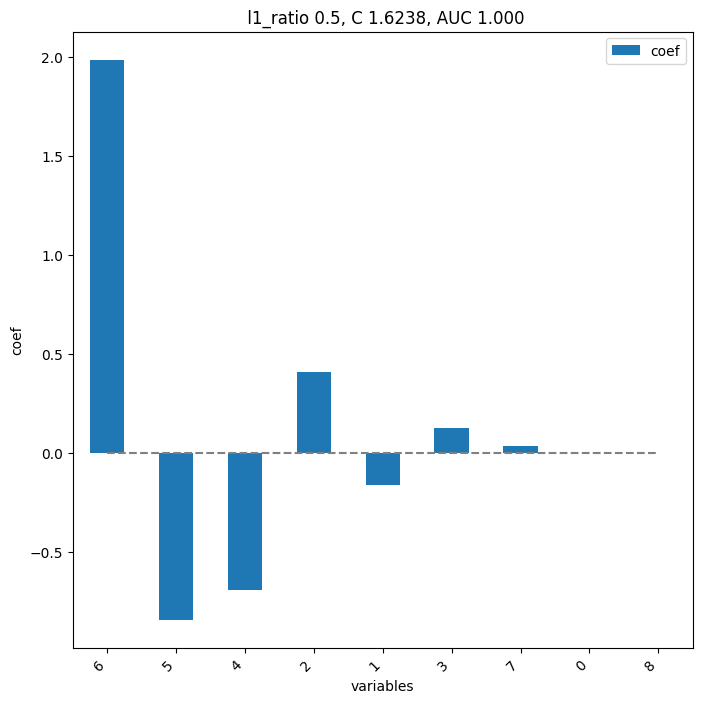

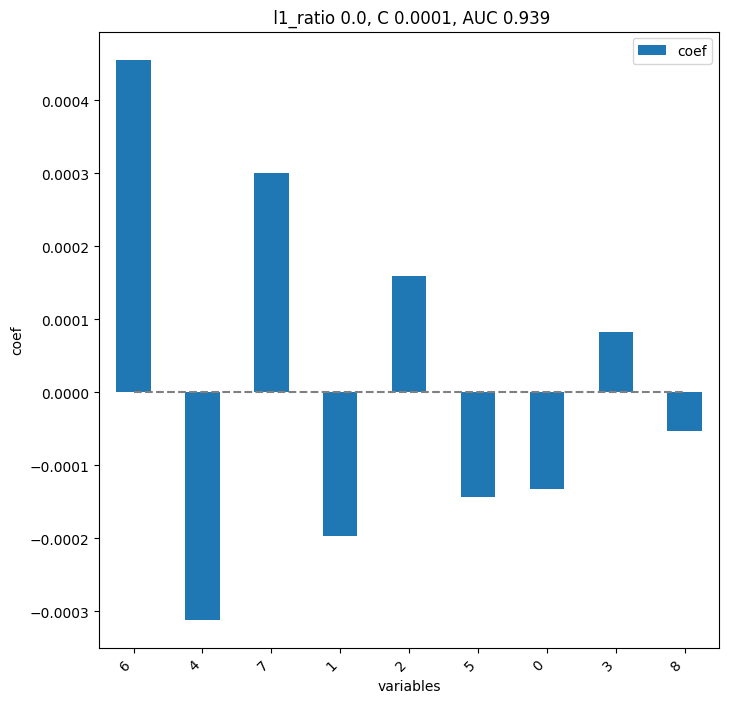

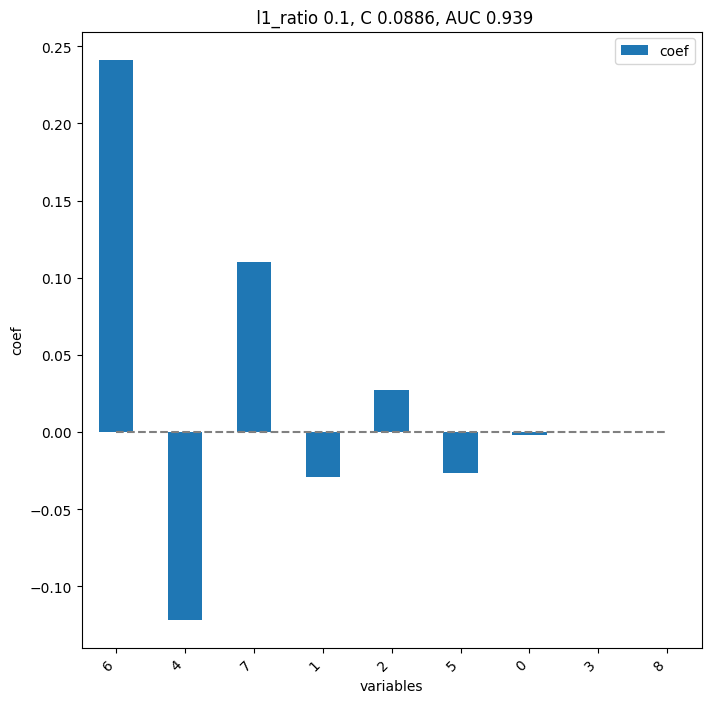

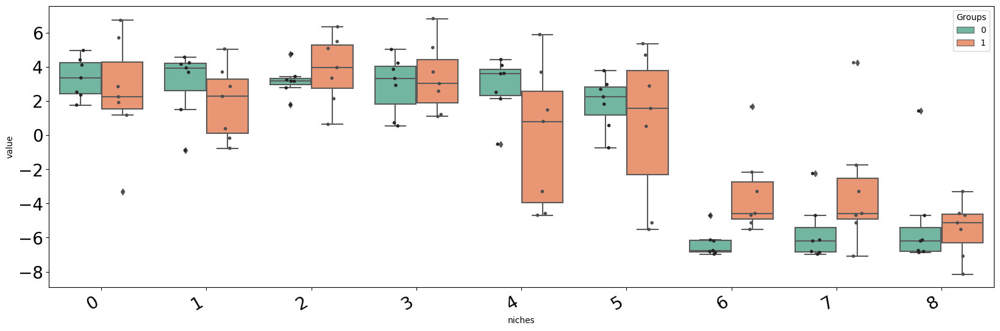

In [119]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[1])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [120]:
pvals.head(20)

,pval,pval_corr
6,0.002331,0.020979
7,0.128205,0.576923
4,0.208625,0.625874
2,0.317599,0.689161
1,0.382867,0.689161
0,0.534965,0.802448
8,0.710373,0.804779
3,0.804779,0.804779
5,0.804779,0.804779


In [121]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8
Patients,,,,,,,,,
1,6.721738,-0.181507,6.343523,1.204787,-4.693642,4.686028,-4.693642,-4.693642,-4.693642
10,1.906377,2.264230,0.629756,1.090029,0.797893,1.560033,1.657865,-1.761122,-8.145059
11,5.694823,-0.771321,5.069320,3.012868,-4.590310,5.355548,-4.590310,-4.590310,-4.590310
12,4.406006,1.492924,1.775786,0.537412,2.504525,1.811377,-6.970455,-6.970455,1.412881
13,2.241901,2.850965,2.131150,2.572017,3.683111,2.874802,-2.172915,-7.090516,-7.090516
14,4.958061,3.677402,3.431730,4.214127,-0.532253,2.679934,-6.143001,-6.143001,-6.143001
2,-3.302367,3.694675,5.479466,6.821070,-3.302367,0.516621,-3.302367,-3.302367,-3.302367
3,3.352307,4.231985,3.160517,3.852606,3.612117,2.243168,-6.817567,-6.817567,-6.817567
4,2.516263,4.152212,2.765917,5.014758,3.589685,0.562862,-6.200565,-6.200565,-6.200565


reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels


There are 16 clusters
Loading reducer object and reduced coordinates


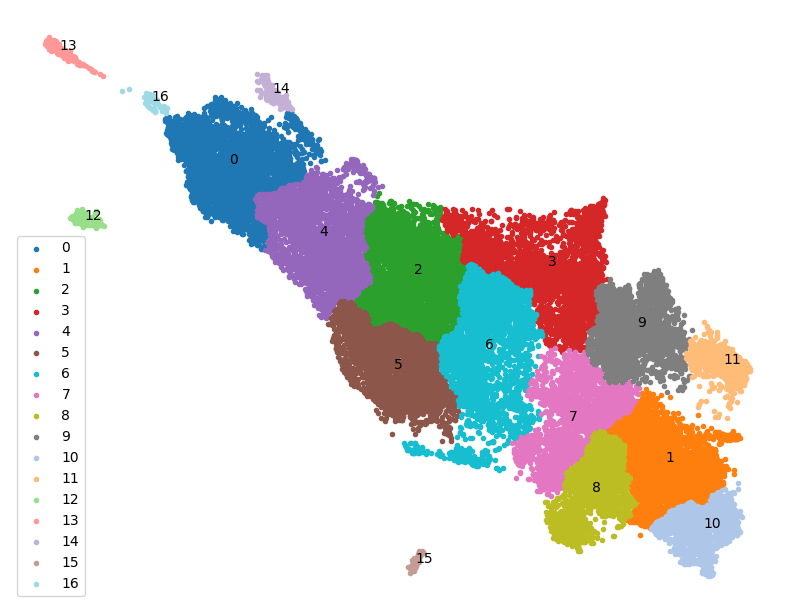

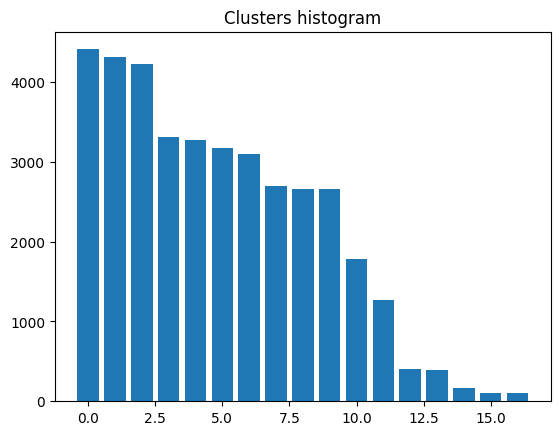

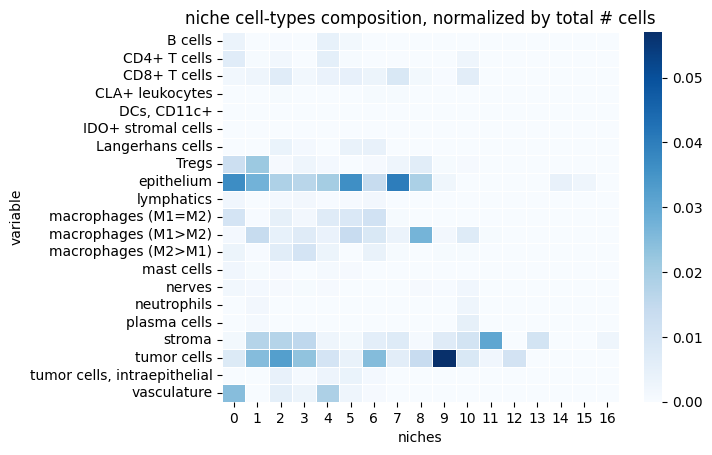

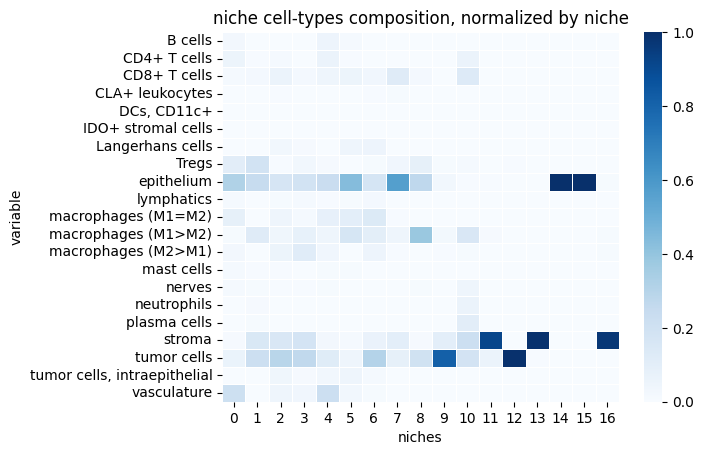

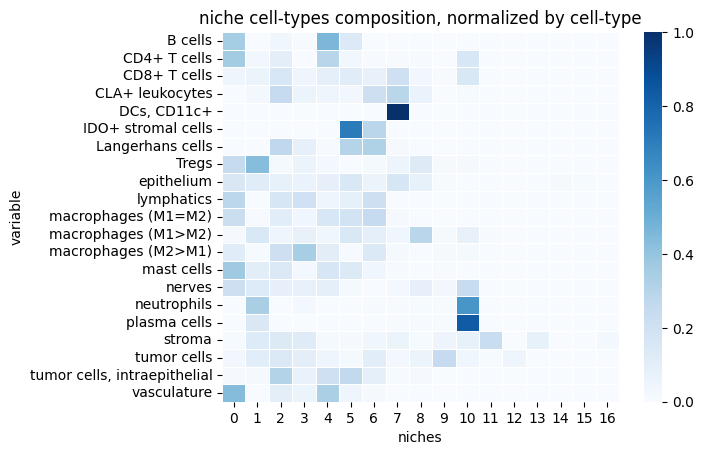

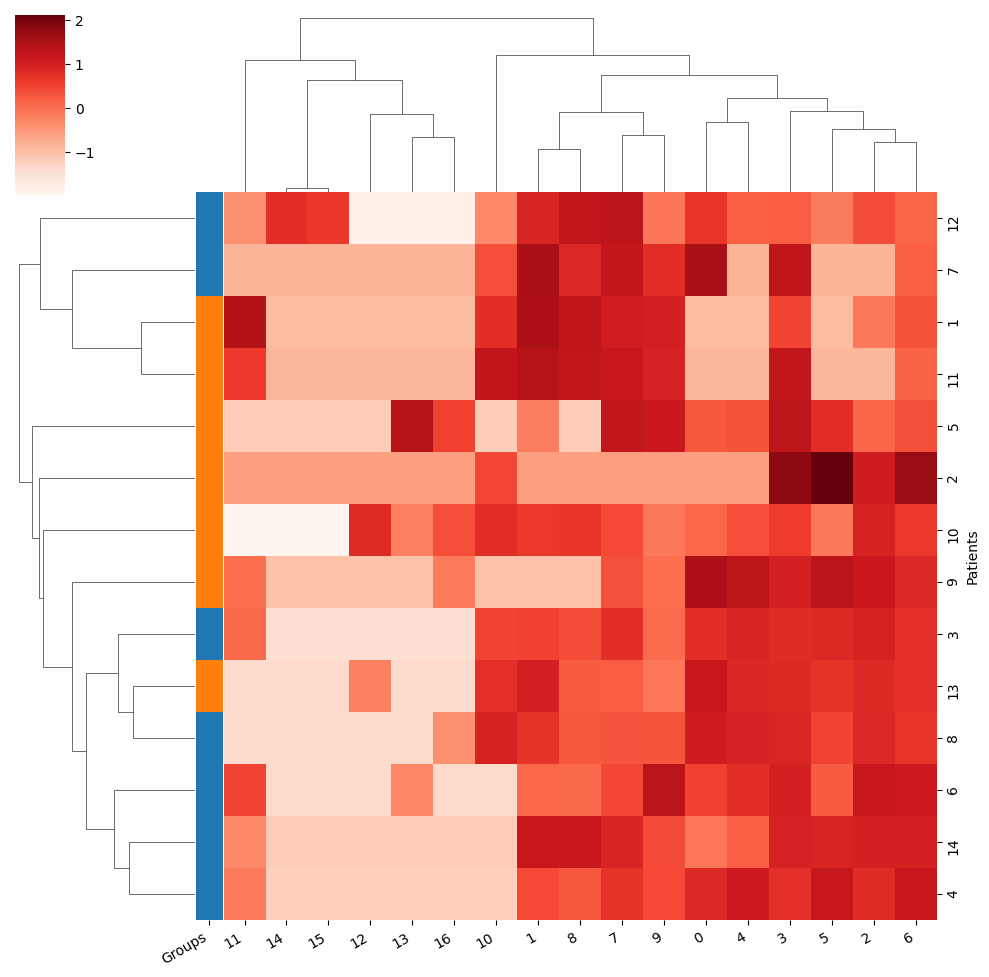

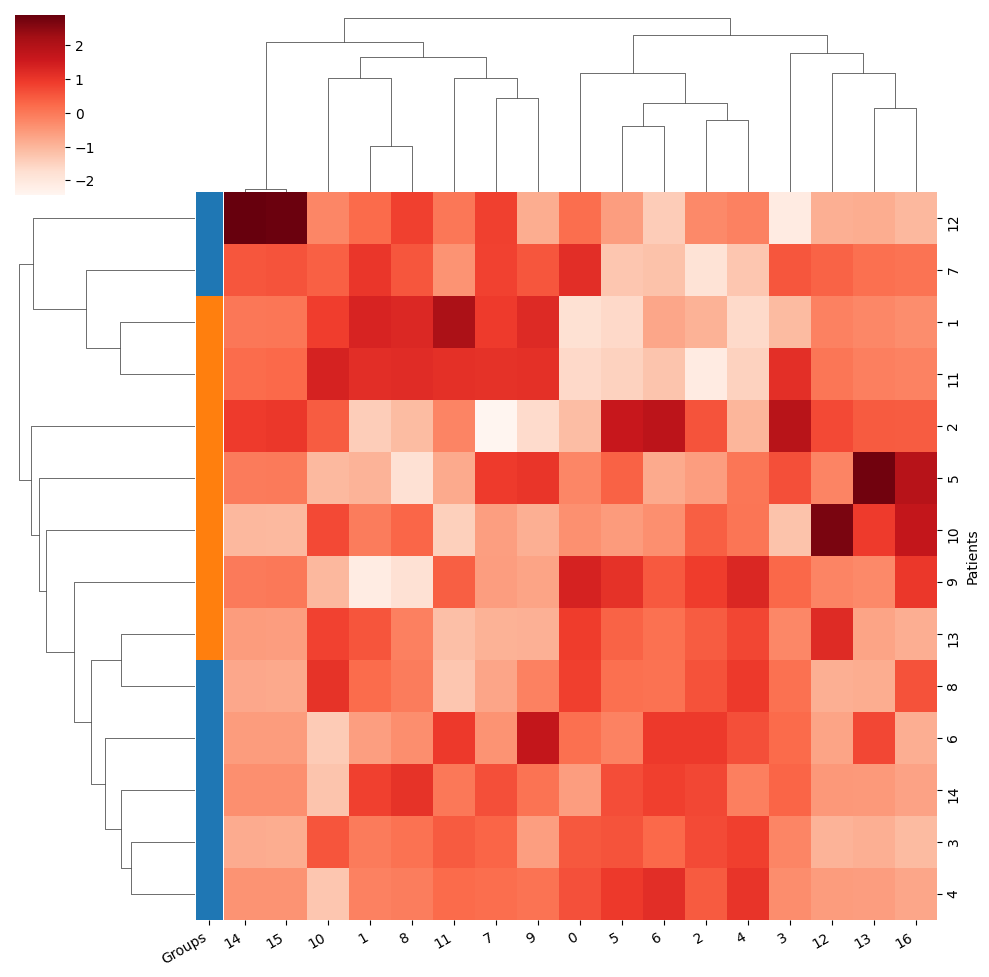

Training took 2.693s


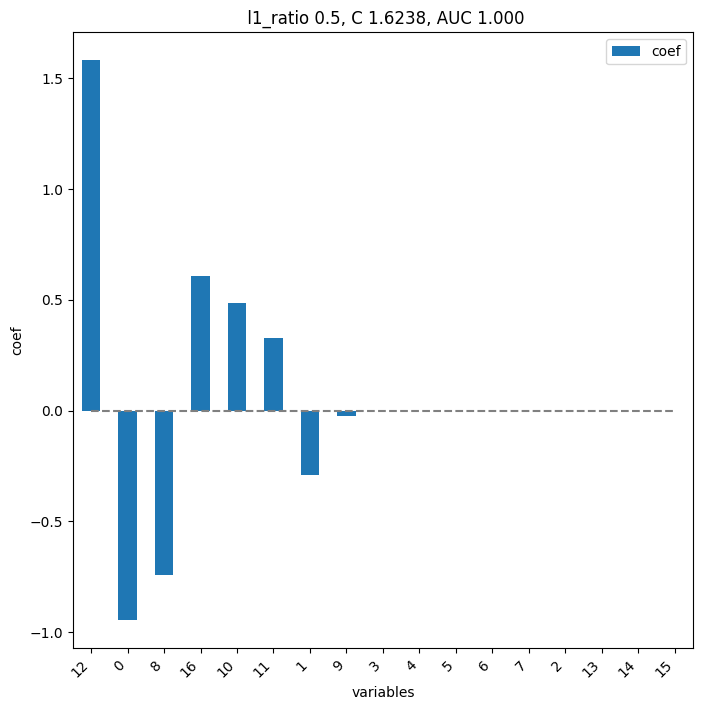

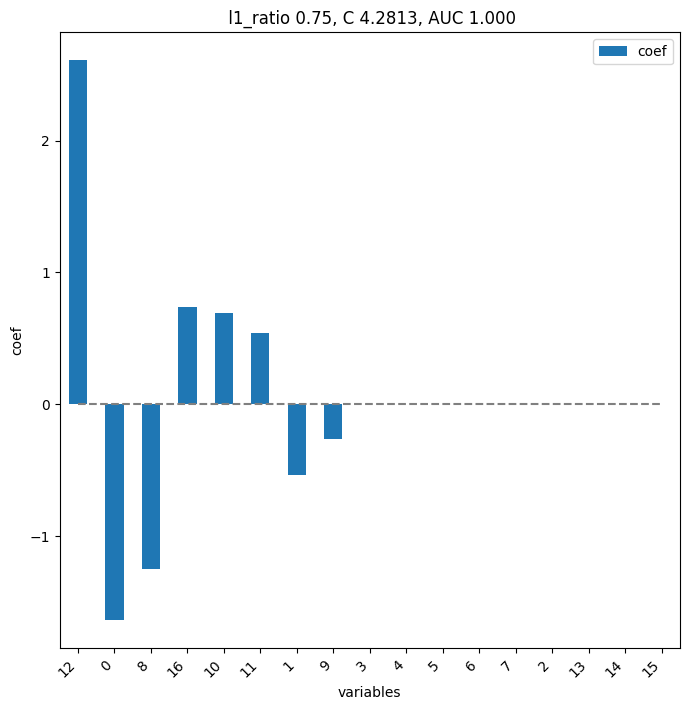

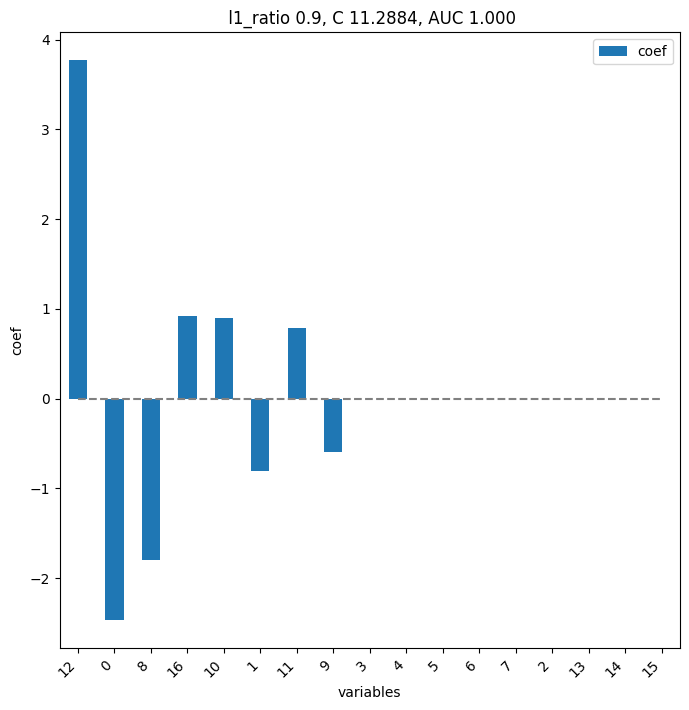

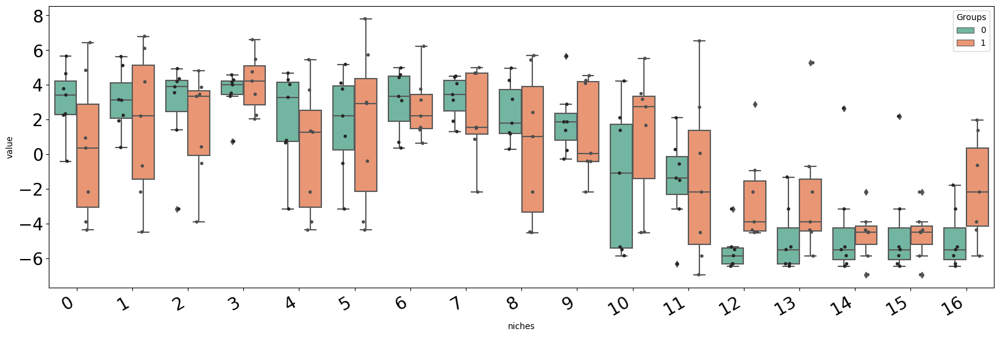

<Figure size 640x480 with 0 Axes>

In [130]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[2])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [131]:
pvals.head(20)

,pval,pval_corr
12,0.006993,0.118881
16,0.072844,0.551476
13,0.097319,0.551476
10,0.164918,0.700903
0,0.259324,0.734751
2,0.259324,0.734751
4,0.455711,0.862596
9,0.534965,0.862596
3,0.534965,0.862596
8,0.534965,0.862596


In [132]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
Patients,,,,,,,,,,,,,,,,,
1,-4.373577,6.803063,-0.530614,2.241975,-4.373577,-4.373577,1.548828,4.673393,5.691963,4.531981,3.494738,6.533290,-4.373577,-4.373577,-4.373577,-4.373577,-4.373577
10,0.358595,2.201127,3.335399,2.028658,1.335510,-0.399091,2.201127,1.498029,2.406288,-0.399091,2.733501,-6.950104,2.889311,-0.709246,-6.950104,-6.950104,1.370196
11,-3.903896,6.104485,-3.903896,5.476401,-3.903896,-3.903896,0.632214,4.995313,5.432128,4.256555,5.526316,2.711656,-3.903896,-3.903896,-3.903896,-3.903896,-3.903896
12,2.328124,3.148120,1.395304,0.742979,0.659597,-0.529987,0.357316,4.500451,4.258695,-0.278673,-1.089603,-1.377285,-6.318861,-6.318861,2.654002,2.187542,-6.318861
13,4.838095,4.174678,3.450759,3.459058,3.700220,2.925948,3.123412,0.860492,1.014643,-0.420442,3.168618,-5.872843,-0.931267,-5.872843,-5.872843,-5.872843,-5.872843
14,-0.403694,5.116433,4.352766,4.284592,0.800279,4.099813,4.421950,4.069848,4.966944,1.864990,-5.345269,-1.502306,-5.345269,-5.345269,-5.345269,-5.345269,-5.345269
2,-2.180508,-2.180508,3.859680,6.604098,-2.180508,7.813058,6.226804,-2.180508,-2.180508,-2.180508,1.662456,-2.180508,-2.180508,-2.180508,-2.180508,-2.180508,-2.180508
3,3.415796,2.242522,4.190645,3.520437,4.017343,3.759437,3.335953,3.439494,1.789429,0.215923,2.101209,0.273082,-6.460254,-6.460254,-6.460254,-6.460254,-6.460254
4,3.777435,1.922874,3.548842,3.343302,4.677949,5.179902,4.976613,3.118479,1.172569,1.865716,-5.503608,-0.562032,-5.503608,-5.503608,-5.503608,-5.503608,-5.503608


Niches 16, 11 and 13 are similar, as they are mainly composed of stroma cells, though only niches 16 and 11 are informative of response to therapy. We can notice that niche 11 is made of stroma cells and a little proportion of tumor cells, whereas niche 16 is made of stroma cells only. As niche 13 is also made only of stroma cells, why isn't it selected to model response to therapy? To answer this question, we need to compare niches 16 and 13.

In [133]:
# save_dir = cluster_dir / (clusterer_name + "_spatial_networks_figures")
# save_dir.mkdir(parents=True, exist_ok=True)

# sample_ids = [
#     "reg001",
#     "reg003",
#     "reg005",
#     "reg006",
#     "reg037",
#     "reg040",
#     "reg042",
#     "reg051",
#     "reg054",
#     "reg055",
#     "reg016",
#     "reg058",
#     "reg060",
#     "reg019",
# ]

# # choose colormap
# if nb_clust <= 20:
#     clusters_cmap = sns.color_palette('Paired', 20)
#     cluster_colors = [clusters_cmap[x] if x >= 0
#                       else (0.5, 0.5, 0.5)
#                       for x in cluster_labels]
# else:
#     clusters_cmap = cc.palette["glasbey"]
#     # make color mapper
#     # series to sort by decreasing order
#     uniq = pd.Series(cluster_labels).value_counts().index.astype(int)
#     n_colors = len(clusters_cmap)
#     labels_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}
#     labels_color_mapper[-1] = (0.5, 0.5, 0.5)
#     cluster_colors = np.array([labels_color_mapper[x] for x in cluster_labels])

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]

# plots_marker = '.'
# for sample in sample_ids:
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values

#     # Big summary plot
#     fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
#     i = 0
#     ty.plot_network(coords, pairs, labels=obj.loc[select, pheno_col], cmap_nodes=palette, marker=plots_marker, size_nodes=size_points, ax=ax[0])
#     ax[i].set_title('Spatial map of phenotypes', fontsize=14);

#     i += 1
#     ax[i].scatter(coords[:, 0], coords[:, 1], c=cluster_colors[select], marker=plots_marker, s=size_points)
#     ax[i].set_title('Spatial map of detected areas', fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=cluster_colors[select], s=5);
#     ax[i].set_title("HDBSCAN clustering on NAS", fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=cluster_colors);
#     ax[i].set_title("HDBSCAN clustering on NAS of all samples", fontsize=14);
#     ax[i].set_aspect('equal')
    
#     # make plot limits equal
#     ax[i-1].set_xlim(ax[i].get_xlim())
#     ax[i-1].set_ylim(ax[i].get_ylim())

#     suptitle = f"Spatial omics data and detected areas - sample {sample}";
#     fig.suptitle(suptitle, fontsize=18)

#     fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)

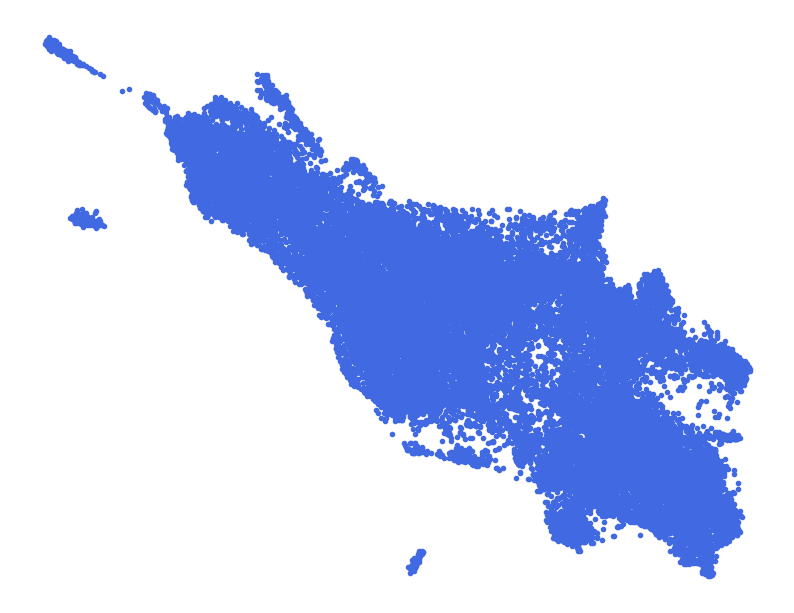

In [126]:
fig, ax = mosna.plot_clusters(embed_viz, save_dir=sof_dir, extra_str='_no_clustering', show_id=False, cluster_params=cluster_params, return_cmap=False)

Loading reducer object and reduced coordinates


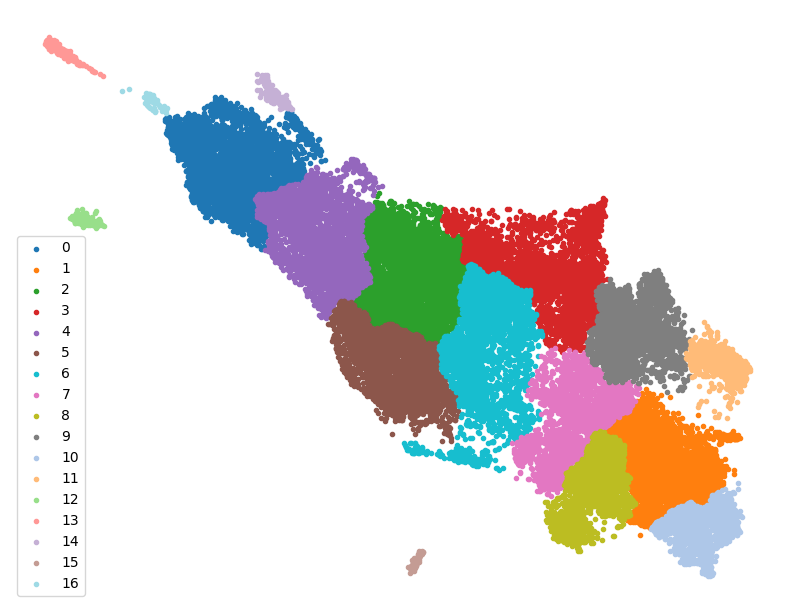

In [46]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
    )

In [ ]:
save_dir = cluster_dir / 'spatial_networks_niches'
save_dir.mkdir(parents=True, exist_ok=True)

# colormap for cell-types
n_cell_types = obj[pheno_col].unique().size
# palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
plots_marker = '.'

id_level_1 = 'patient'
id_level_2 = 'sample'
extension = 'parquet'
read_fct = pd.read_parquet

# build index of patients and samples files
data_index = []
len_ext = len(extension) + 1
len_l1 = len(id_level_1) + 1
len_l2 = len(id_level_2) + 1
files = nodes_dir.glob(f'nodes_*.{extension}')
for file in files:
    # parse patient and sample description
    file_name = file.name[6:-len_ext]
    patient_info, sample_info = file_name.split('_')
    patient_id = patient_info[len_l1:]
    sample_id = sample_info[len_l2:]
    # add info to data index
    data_index.append((patient_id, sample_id))

for data_info in data_index:
    # load nodes and edges of a specific sample
    if len(data_info) == 1:
        str_group = f'{id_level_1}-{data_info[0]}'
    elif len(data_info) == 2:
        str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
    nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
    edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
    coords = nodes[pos_cols].values
    pairs = edges.values
    # bolean selector among aggregated data
    sample_id = data_info[1]
    select = (var_aggreg_samples_info['sample'] == sample_id).values

    # Big summary plot
    fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
    i = 0
    ty.plot_network(coords, 
                    pairs,
                    labels=nodes[pheno_col], 
                    color_mapper=celltypes_color_mapper, 
                    marker=plots_marker, 
                    size_nodes=size_points*10, 
                    ax=ax[0])
    ax[i].set_title('Spatial map of phenotypes', fontsize=14);

    i += 1
    ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
    ax[i].set_title('Spatial map of detected areas', fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
    ax[i].set_title("Clustering on NAS", fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
    ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
    ax[i].set_aspect('equal')
    
    # make plot limits equal
    ax[i-1].set_xlim(ax[i].get_xlim())
    ax[i-1].set_ylim(ax[i].get_ylim())

    suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
    fig.suptitle(suptitle, fontsize=18)

    fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
    plt.show()


    fig, ax = plt.subplots(figsize=(10, 10))
    ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
    ax.set_title('Spatial map of detected areas', fontsize=14);
    ax.set_aspect('equal')
    fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
    plt.show()

across all models, predictive niches are:
  - pure tumor
  - pure stroma
  - EVTM: epithelium, vasculature, tregs, macrophages (M1=M2)
  - ETMTS: epithelium, tregs, M1, tumor, stroma
across models EVTM and ETLTS are exclusive, one is enough for prediction, and with contrary effect on response.

### Differential niche analysis

Niches 11 and 13 are apparently made of the same unique cell type: stroma cells. What are the differences between these niches?  

Loading reducer object and reduced coordinates


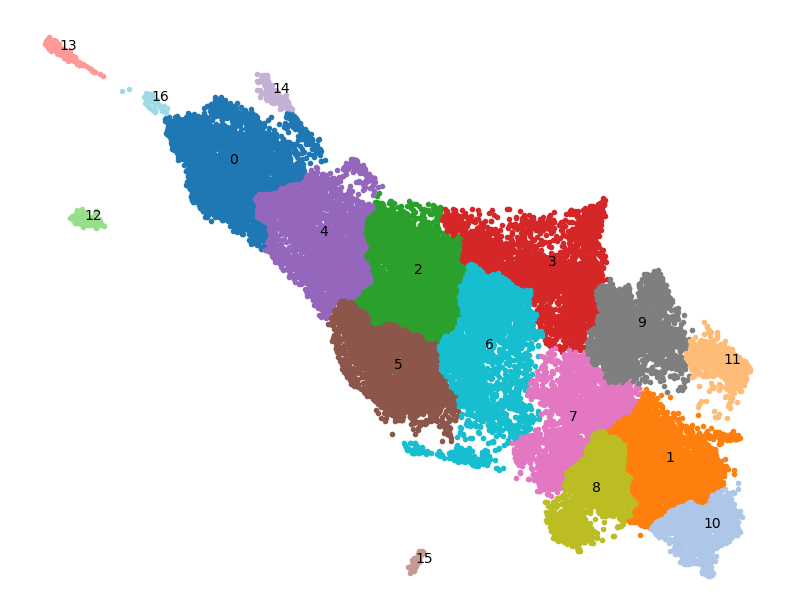

In [134]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    cluster_params=cluster_params, 
    return_cmap=True,
    show_id=True,
    legend=False
    )

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

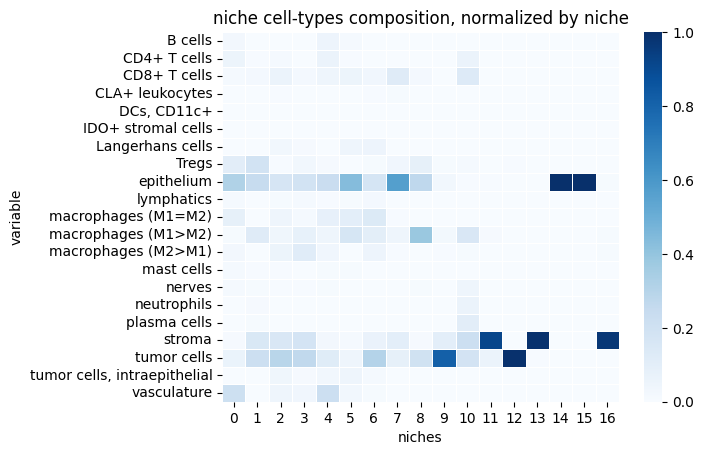

In [135]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

#### Differences in cell types composition

In [136]:
niche_compo = mosna.make_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')

In [137]:
import seaborn as sns
df_show = niche_compo[[11, 13, 16]]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

niches,11,13,16
cell-types,,,
B cells,0.000000,0.000000,0.000000
CD4+ T cells,0.000000,0.000000,0.000000
CD8+ T cells,0.000000,0.000000,0.000000
CLA+ leukocytes,0.000000,0.000000,0.000000
"DCs, CD11c+",0.000000,0.000000,0.000000
IDO+ stromal cells,0.000000,0.000000,0.000000
Langerhans cells,0.000000,0.000000,0.000000
Tregs,0.000786,0.000000,0.000000
epithelium,0.004713,0.000000,0.009524


### Differences in aggregation statistics

In [138]:
var_aggreg_niches = var_aggreg.copy()
var_aggreg_niches['niche'] = niches

In [153]:
pvals = mosna.find_DE_markers(
    var_aggreg_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD69 mean,3.754754e-54,4.280419e-52
MUC-1 mean,3.207939e-50,1.828525e-48
EGFR mean,9.740530e-44,3.701402e-42
CD163 std,1.453617e-43,4.142809e-42
Ki-67 mean,6.624367e-39,1.510356e-37
CD164 mean,4.816696e-38,9.151723e-37
CD11c mean,7.640553e-37,1.244319e-35
Vimentin mean,1.178947e-36,1.679999e-35
PD-L1 std,5.672421e-36,7.185066e-35
CD38 mean,1.524009e-35,1.737370e-34


There are 102 significant variables in `pval_corr`


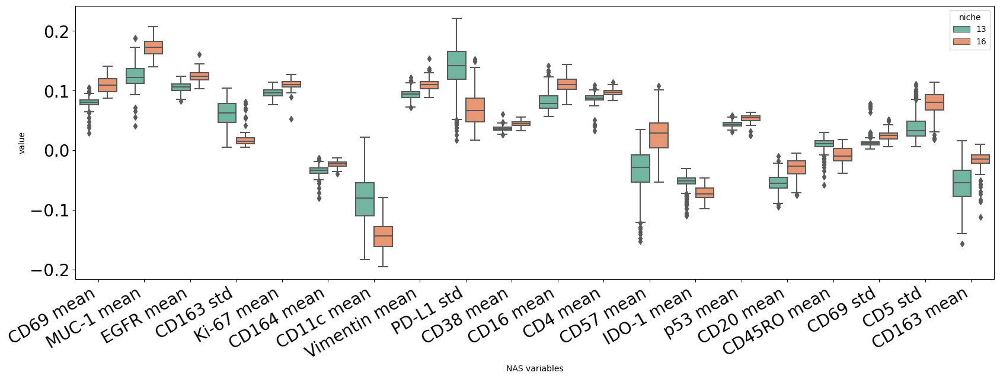

In [141]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    var_aggreg_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of NAS variables between niches 16 and 13.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

#### Extract a single cell type for comparison

We've seen that niches 13 and 16 are slightly different in cell types composition.  
What fi we compare the same cell type between groups? The amount of tumor cells in niche 13 is so low that differences should be due to a different environment (chemokines, mechanics, ...) and not direct signaling.

In [142]:
select = cell_types == 'stroma'
single_pheno_niches = var_aggreg_niches.loc[select, :]

In [154]:
pvals = mosna.find_DE_markers(
    single_pheno_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD69 mean,4.611678e-53,5.257313e-51
MUC-1 mean,6.644503e-49,3.787367e-47
CD163 std,1.211288e-42,4.602893e-41
EGFR mean,2.315610e-42,6.599489e-41
CD164 mean,2.251752e-38,5.133994e-37
Ki-67 mean,1.250449e-37,2.375852e-36
p53 mean,8.478759e-37,1.380827e-35
CD11c mean,1.388259e-35,1.978269e-34
Vimentin mean,2.811828e-35,3.561648e-34
CD38 mean,7.498478e-35,8.548265e-34


There are 102 significant variables in `pval_corr`


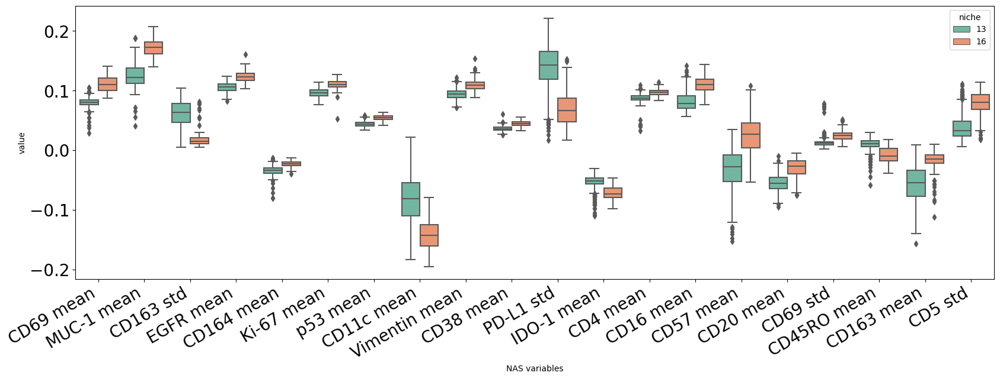

In [144]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    single_pheno_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of NAS variables between niches 16 and 13 - stroma cells only.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

### Differences in raw marker levels

In [147]:
aggreg_vars = marker_cols

In [148]:
markers_niches = obj[aggreg_vars].copy()
markers_niches['niche'] = niches

In [155]:
pvals = mosna.find_DE_markers(
    markers_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD57,8.473347e-20,4.829808e-18
BCL-2,3.898819e-19,7.992422e-18
CCR6,4.206538e-19,7.992422e-18
PD-L1,6.340212e-17,9.034802e-16
CD8,2.665806e-14,3.039019e-13
MMP12,1.247690e-11,1.185305e-10
CD45RO,2.007935e-11,1.635033e-10
CD34,2.233850e-10,1.547578e-09
CD69,2.443544e-10,1.547578e-09
CD56,4.490674e-10,2.559684e-09


There are 35 significant variables in `pval_corr`


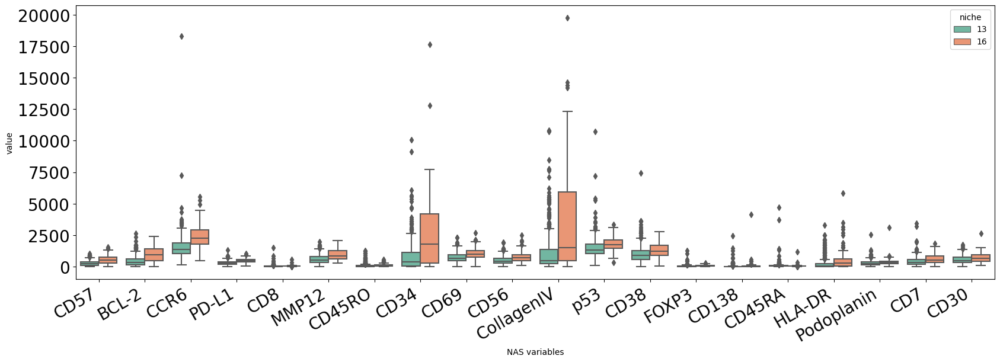

In [157]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of raw markers between niches 16 and 13.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

#### select stroma cells only

In [158]:
select = cell_types == 'stroma'
single_pheno_niches_raw = markers_niches.loc[select, :]

In [159]:
pvals = mosna.find_DE_markers(
    single_pheno_niches_raw, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD57,4.214546e-20,2.335874e-18
BCL-2,8.196049e-20,2.335874e-18
CCR6,5.387411e-19,1.023608e-17
PD-L1,3.525450e-16,5.023766e-15
CD8,1.205868e-15,1.374690e-14
CD45RO,5.927010e-12,5.630659e-11
MMP12,1.185957e-11,9.657079e-11
CD34,8.829877e-11,6.291288e-10
CollagenIV,1.860349e-10,1.178221e-09
CD69,3.505432e-10,1.998096e-09


There are 35 significant variables in `pval_corr`


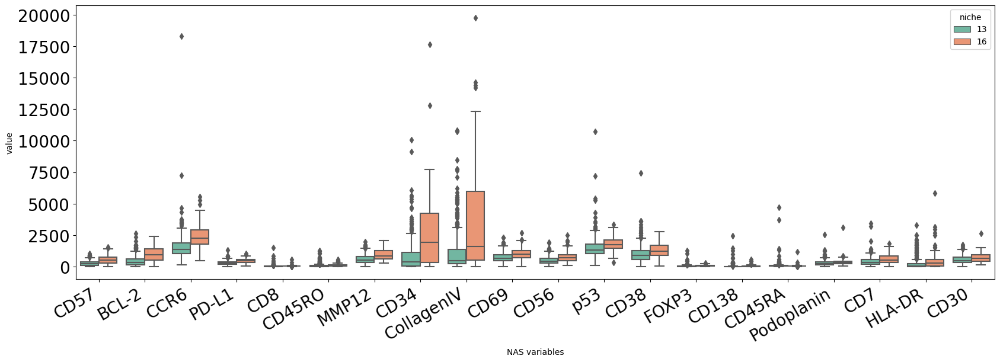

In [160]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    single_pheno_niches_raw, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of raw markers between niches 16 and 13 - stroma cells only.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

## On markers, order 2

## On markers, order 3